In [1]:
# In your Jupyter Notebook
import sys
import os
import numpy as np # For averaging metrics if needed

# Add project root to Python path
notebook_dir = os.getcwd()
project_root = os.path.abspath(os.path.join(notebook_dir, '..'))
if project_root not in sys.path:
    sys.path.append(project_root)
    print(f"Added project root to sys.path: {project_root}")

from src.xgb_local_pipeline import XGBoostLocalPipeline # Assuming saved as xgb_local_pipeline.py

# Adjust path to your config.yaml from the notebook's location
config_file_for_local_pipeline = "../config_XGBoostLocal_SPEI.yaml"

local_pipeline = XGBoostLocalPipeline(config_path=config_file_for_local_pipeline)
all_location_metrics_results = local_pipeline.run_pipeline()

print("\n--- Local Pipeline Execution Finished ---")
if all_location_metrics_results and isinstance(all_location_metrics_results, list):
    print(f"Processed {len(all_location_metrics_results)} locations.")

    # Example: Calculate and print average Test RMSE
    valid_test_rmses = []
    for loc_metrics in all_location_metrics_results:
        if loc_metrics and loc_metrics.get('test') and isinstance(loc_metrics['test'], dict) and 'rmse' in loc_metrics['test']:
            valid_test_rmses.append(loc_metrics['test']['rmse'])

    if valid_test_rmses:
        average_test_rmse = np.mean(valid_test_rmses)
        print(f"\nAverage Test RMSE across all processed locations: {average_test_rmse:.4f}")
    else:
        print("\nNo valid Test RMSE metrics found to average.")

elif isinstance(all_location_metrics_results, str): # Error string returned
    print(f"Pipeline execution failed: {all_location_metrics_results}")
else:
    print("No metrics returned or an unexpected result from the pipeline.")

Added project root to sys.path: c:\Users\peera\Desktop\DroughtLSTM_oneday
Local Pipeline Class: Successfully imported utility functions.
Local Pipeline Class: Attempting to load config from: c:\Users\peera\Desktop\DroughtLSTM_oneday\config_XGBoostLocal_SPEI.yaml
Configuration loaded from c:\Users\peera\Desktop\DroughtLSTM_oneday\config_XGBoostLocal_SPEI.yaml
Local Pipeline Class: Artifacts for experiment 'SPEI_XGB_Local_Run_local' will be saved under various subdirectories of 'c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local' and 'c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local'
Local Pipeline: Loading full raw data...
Successfully loaded data from c:\Users\peera\Desktop\DroughtLSTM_oneday\data\full.csv. Shape: (264201, 19)
Converted column 'time' to datetime.
Data sorted by ['time', 'lat', 'lon'].
Local Pipeline: Found 179 unique locations.

--- Processing Location: lat6.25_lon101.25 ---
Splitting data: Train ends 2018-12-3

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon   lat       time   tmp        dtr   cld        tmx   tmn  \
253461  101.25  6.25 2019-01-16  27.0   9.900001  62.8  32.000000  22.1   
253640  101.25  6.25 2019-02-15  27.5  12.200000  58.8  33.600002  21.4   
253819  101.25  6.25 2019-03-16  28.1  11.100000  60.0  33.700000  22.6   

          pre        wet        vap      spei    soi    dmi       pdo  nino4  \
253461  130.6  14.099999  27.200000  0.556417 -0.160  0.387 -0.381584   0.50   
253640   18.2   5.720000  26.800001 -1.698709 -1.434  0.416 -0.496707   0.67   
253819   29.9   5.820000  28.600000 -1.845414 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253461    0.51   0.59  114.700000  
253640    0.62   0.59  117.600008  
253819    0.81   0.62  130.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat6.25_lon101.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat6.25_lon101.25 - Train Set: RMSE=0.0566, MAE=0.0443, R2=0.9967
  lat6.25_lon101.25 - Validation Set: RMSE=0.3228, MAE=0.2658, R2=0.9389
  lat6.25_lon101.25 - Test Set: RMSE=0.2673, MAE=0.2194, R2=0.9356
  Generating full predictions for lat6.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx  \
0    101.25  6.25 1901-01-16  25.300001   9.300000  62.5  30.000000   
179  101.25  6.25 1901-02-15  26.000000  10.500000  58.8  31.300001   
358  101.25  6.25 1901-03-16  26.600000  10.900001  60.0  32.100002   

           tmn        pre    wet        vap      spei    soi    dmi       pdo  \
0    20.700000  84.600000  10.28  25.200000 -0.384595 -0.090 -0.540  1.114457   
179  20.800001  17.900000   4.24  25.800001 -1.361671  0.205 -0.868  0.872915   
358  21.200000  65.700005   6.81  26.900000 -0.830862  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
0     0.59 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat6.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat6.25_lon101.25_full_pred.csv

--- Processing Location: lat6.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time        tmp       dtr   cld        tmx        tmn  \
1    101.75  6.25 1901-01-16  25.800001  8.000000  65.1  29.800001  21.800001   
180  101.75  6.25 1901-02-15  26.300001  8.900001  58.8  30.800001  21.900000   
359  101.75  6.25 1901-03-16  27.100000  9.500000  58.8  31.900000  22.400000   

            pre  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon   lat       time   tmp   dtr        cld        tmx   tmn  \
257758  101.75  6.25 2021-01-16  26.2   9.1  66.200005  30.800001  21.7   
257937  101.75  6.25 2021-02-15  27.1  10.3  58.800000  32.300000  22.0   
258116  101.75  6.25 2021-03-16  28.1  10.8  58.800000  33.500000  22.7   

               pre    wet        vap      spei    soi    dmi       pdo  nino4  \
257758  193.100000  18.58  26.800001  0.532890  1.640  0.051 -0.750839  -0.93   
257937   12.000000   2.54  27.000000 -1.864957  1.017  0.243 -1.111553  -0.76   
258116  115.700005   9.75  28.400000  0.319050 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257758   -1.04  -0.80  105.400000  
257937   -0.94  -0.80  112.000000  
258116   -0.72  -0.64  130.200009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat6.25_lon101.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat6.25_lon101.75 - Train Set: RMSE=0.0634, MAE=0.0498, R2=0.9959
  lat6.25_lon101.75 - Validation Set: RMSE=0.3171, MAE=0.2634, R2=0.9411
  lat6.25_lon101.75 - Test Set: RMSE=0.2227, MAE=0.1638, R2=0.9542
  Generating full predictions for lat6.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp       dtr   cld        tmx        tmn  \
1    101.75  6.25 1901-01-16  25.800001  8.000000  65.1  29.800001  21.800001   
180  101.75  6.25 1901-02-15  26.300001  8.900001  58.8  30.800001  21.900000   
359  101.75  6.25 1901-03-16  27.100000  9.500000  58.8  31.900000  22.400000   

            pre    wet        vap      spei    soi    dmi       pdo  nino4  \
1    131.500000  13.08  26.700000 -0.324920 -0.090 -0.540  1.114457   0.59   
180   22.700000   5.13  27.200000 -1.271964  0.205 -0.868  0.872915   0.24   
359   62.600002   6.77  28.300001 -0.785248  0.880 -0.720  0.439477   0.12   

     nino34  nino3

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat6.25_lon101.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat6.25_lon101.75_full_pred.csv

--- Processing Location: lat6.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
2    99.75  6.75 1901-01-16  27.800001   9.8  55.0  32.700000  22.9   
181  99.75  6.75 1901-02-15  28.700000  11.5  50.0  34.500000  23.0   
360  99.75  6.75 1901-03-16  28.800001  11.5  55.0  34.600002  23.1 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp   dtr   cld   tmx        tmn    pre  \
253463  99.75  6.75 2019-01-16  28.9  10.0  55.0  33.9  23.900000  106.5   
253642  99.75  6.75 2019-02-15  29.7  12.6  50.0  36.0  23.400000   11.1   
253821  99.75  6.75 2019-03-16  30.0  11.5  55.0  35.8  24.300001   27.4   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253463  4.88  28.100000  1.212613 -0.160  0.387 -0.381584   0.50    0.51   
253642  3.17  27.700000 -1.325092 -1.434  0.416 -0.496707   0.67    0.62   
253821  6.37  29.800001 -1.323278 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253463   0.59  136.400000  
253642   0.59  140.000000  
253821   0.62  145.700009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
257759  99.75  6.75 2021-01-16  27.6  10.1  55.0  32.7  22.6  42.900000  5.53   
257938  99.75  6.75 2021-02-15  28.6  12.5  50.0  34.9  22.4  15.800000  1.74   
258117  99.75  6.75 2021-03-16  29.7  12.5  55.0  36.0  23.5  82.200005  7.57   

         vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257759  26.2 -0.297032  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257938  26.5 -0.868522  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258117  28.4 -0.166572 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257759  130.200009  
257938  134.400000  
258117  148.800000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat6.75_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat6.75_lon99.75 - Train Set: RMSE=0.0861, MAE=0.0658, R2=0.9925
  lat6.75_lon99.75 - Validation Set: RMSE=0.3235, MAE=0.2037, R2=0.9131
  lat6.75_lon99.75 - Test Set: RMSE=0.2444, MAE=0.2024, R2=0.9264
  Generating full predictions for lat6.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
2    99.75  6.75 1901-01-16  27.800001   9.8  55.0  32.700000  22.9   
181  99.75  6.75 1901-02-15  28.700000  11.5  50.0  34.500000  23.0   
360  99.75  6.75 1901-03-16  28.800001  11.5  55.0  34.600002  23.1   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
2    37.400000  4.00  26.0 -0.612856 -0.090 -0.540  1.114457   0.59    0.82   
181  15.500000  2.11  26.5 -0.881096  0.205 -0.868  0.872915   0.24    0.29   
360  65.200005  6.77  28.1 -0.397570  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
2     0.46  133.3  
181   0.03  134.4 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat6.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat6.75_lon99.75_full_pred.csv

--- Processing Location: lat6.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx   tmn  \
3    100.25  6.75 1901-01-16  26.900000   9.800000  58.8  31.800001  22.0   
182  100.25  6.75 1901-02-15  27.900000  11.400001  55.0  33.600002  22.2   
361  100.25  6.75 1901-03-16  28.300001  11.700000  60.0  34.200000  22.5   

      pre   wet        vap      spe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon   lat       time        tmp   dtr   cld        tmx        tmn  \
257760  100.25  6.75 2021-01-16  26.800001  10.2  58.9  31.900000  21.700000   
257939  100.25  6.75 2021-02-15  27.900000  12.6  55.0  34.200000  21.600000   
258118  100.25  6.75 2021-03-16  29.200000  12.8  60.0  35.600002  22.800001   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257760  51.000000  8.22  26.000000  0.029194  1.640  0.051 -0.750839  -0.93   
257939   8.400001  1.46  26.300001 -1.158181  1.017  0.243 -1.111553  -0.76   
258118  91.700005  7.42  28.200000  0.042083 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257760   -1.04  -0.80  120.9  
257939   -0.94  -0.80  126.0  
258118   -0.72  -0.64  142.6  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat6.75_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat6.75_lon100.25 - Train Set: RMSE=0.0798, MAE=0.0609, R2=0.9935
  lat6.75_lon100.25 - Validation Set: RMSE=0.4020, MAE=0.2812, R2=0.8875
  lat6.75_lon100.25 - Test Set: RMSE=0.2260, MAE=0.1750, R2=0.9488
  Generating full predictions for lat6.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx   tmn  \
3    100.25  6.75 1901-01-16  26.900000   9.800000  58.8  31.800001  22.0   
182  100.25  6.75 1901-02-15  27.900000  11.400001  55.0  33.600002  22.2   
361  100.25  6.75 1901-03-16  28.300001  11.700000  60.0  34.200000  22.5   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
3    37.8  5.36  25.800001 -0.581451 -0.090 -0.540  1.114457   0.59    0.82   
182  12.2  2.17  26.400000 -0.994444  0.205 -0.868  0.872915   0.24    0.29   
361  69.3  6.40  27.900000 -0.218895  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
3     0.46

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat6.75_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat6.75_lon100.25_full_pred.csv

--- Processing Location: lat6.75_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
4    100.75  6.75 1901-01-16  26.1   9.0  62.5  30.600000  21.6  52.100002   
183  100.75  6.75 1901-02-15  27.0  10.3  57.5  32.200000  21.9   9.400001   
362  100.75  6.75 1901-03-16  27.6  11.0  61.3

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon   lat       time        tmp        dtr   cld        tmx   tmn  \
253465  100.75  6.75 2019-01-16  27.400000   9.400001  62.8  32.100002  22.7   
253644  100.75  6.75 2019-02-15  28.300001  11.700000  57.5  34.200000  22.5   
253823  100.75  6.75 2019-03-16  29.100000  11.100000  61.3  34.700000  23.6   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253465  97.8  9.69  28.200000  0.759340 -0.160  0.387 -0.381584   0.50   
253644   8.7  3.91  27.800001 -1.554138 -1.434  0.416 -0.496707   0.67   
253823  21.0  4.39  29.600000 -1.547218 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253465    0.51   0.59  117.8  
253644    0.62   0.59  126.0  
253823    0.81   0.62  136.4  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon   lat       time        tmp   dtr   cld   tmx   tmn        pre  \
257761  100.75  6.75 2021-01-16  26.300001   9.7  63.0  31.2  21.5  66.600000   
257940  100.75  6.75 2021-02-15  27.500000  11.7  57.5  33.4  21.7   7.100000   
258119  100.75  6.75 2021-03-16  28.500000  12.3  61.3  34.7  22.4  75.200005   

              wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257761  12.059999  26.300001  0.020581  1.640  0.051 -0.750839  -0.93   -1.04   
257940   1.090000  26.600000 -1.492239  1.017  0.243 -1.111553  -0.76   -0.94   
258119   6.030000  28.200000 -0.141553 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257761  -0.80  114.7  
257940  -0.80  123.2  
258119  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat6.75_lon100.75 - Train Set: RMSE=0.0601, MAE=0.0472, R2=0.9963
  lat6.75_lon100.75 - Validation Set: RMSE=0.4554, MAE=0.3944, R2=0.8685
  lat6.75_lon100.75 - Test Set: RMSE=0.3032, MAE=0.2438, R2=0.9145
  Generating full predictions for lat6.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
4    100.75  6.75 1901-01-16  26.1   9.0  62.5  30.600000  21.6  52.100002   
183  100.75  6.75 1901-02-15  27.0  10.3  57.5  32.200000  21.9   9.400001   
362  100.75  6.75 1901-03-16  27.6  11.0  61.3  33.100002  22.1  52.200000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
4    7.28  26.1 -0.330006 -0.090 -0.540  1.114457   0.59    0.82   0.46   
183  2.53  26.7 -1.130994  0.205 -0.868  0.872915   0.24    0.29   0.03   
362  5.12  27.9 -0.512087  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
4    111.600003  
183  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat6.75_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat6.75_lon100.75_full_pred.csv


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame


--- Processing Location: lat6.75_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx   tmn   pre  \
5    101.25  6.75 1901-01-16  25.900000   8.600000  63.9  30.2  21.6  66.4   
184  101.25  6.75 1901-02-15  26.600000   9.900001  58.8  31.6  21.7  11.6   
363  101.25  6.75 1901-03-16  27.300001  10.700000  60.0  32.7  22.0  43.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
5    8.65  26.6 -0.442181 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
184  3.23  27.0 -1.085291  0.205 -0.868  0.872915   0.24    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon   lat       time        tmp   dtr   cld   tmx        tmn  \
253466  101.25  6.75 2019-01-16  27.300001   9.1  64.3  31.9  22.800001   
253645  101.25  6.75 2019-02-15  28.000000  11.5  58.8  33.8  22.300001   
253824  101.25  6.75 2019-03-16  28.800001  10.7  60.0  34.2  23.500000   

               pre    wet   vap      spei    soi    dmi       pdo  nino4  \
253466  128.200000  12.98  28.7  0.696211 -0.160  0.387 -0.381584   0.50   
253645   10.800000   4.84  28.1 -1.512596 -1.434  0.416 -0.496707   0.67   
253824   17.300001   4.16  29.7 -1.578816 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253466    0.51   0.59  111.600003  
253645    0.62   0.59  120.400000  
253824    0.81   0.62  133.300000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon   lat       time   tmp        dtr   cld        tmx   tmn   pre  \
257762  101.25  6.75 2021-01-16  26.1   9.400001  64.8  30.800001  21.4  96.6   
257941  101.25  6.75 2021-02-15  27.2  11.000000  58.8  32.700000  21.7   7.2   
258120  101.25  6.75 2021-03-16  28.2  12.100000  60.0  34.300000  22.2  60.8   

          wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257762  12.55  26.800001  0.161589  1.640  0.051 -0.750839  -0.93   -1.04   
257941   0.82  26.900000 -1.538228  1.017  0.243 -1.111553  -0.76   -0.94   
258120   6.09  28.300001 -0.253070 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257762  -0.80  108.500000  
257941  -0.80  117.600008  
258120  -0.64  136.400000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat6.75_lon101.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat6.75_lon101.25 - Train Set: RMSE=0.0581, MAE=0.0453, R2=0.9965
  lat6.75_lon101.25 - Validation Set: RMSE=0.4282, MAE=0.3476, R2=0.8837
  lat6.75_lon101.25 - Test Set: RMSE=0.2745, MAE=0.2028, R2=0.9385
  Generating full predictions for lat6.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx   tmn   pre  \
5    101.25  6.75 1901-01-16  25.900000   8.600000  63.9  30.2  21.6  66.4   
184  101.25  6.75 1901-02-15  26.600000   9.900001  58.8  31.6  21.7  11.6   
363  101.25  6.75 1901-03-16  27.300001  10.700000  60.0  32.7  22.0  43.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
5    8.65  26.6 -0.442181 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
184  3.23  27.0 -1.085291  0.205 -0.868  0.872915   0.24    0.29   0.03  112.0  
363  4.53  28.0 -0.526769  0.880 -0.720  0.439477   0.12    0.05  -0.25  127.1  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat6.75_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat6.75_lon101.25_full_pred.csv

--- Processing Location: lat7.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx   tmn  \
6    99.75  7.25 1901-01-16  27.0  10.100000  55.0  32.100002  22.0   
185  99.75  7.25 1901-02-15  27.9  11.900001  51.3  33.900000  22.0   
364  99.75  7.25 1901-03-16  28.1  12.300000  57.5  34.300000  22.0   

           pre   wet   vap      spei    soi    dmi       p

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time   tmp        dtr   cld        tmx        tmn  \
257763  99.75  7.25 2021-01-16  26.6  10.400001  55.0  31.800001  21.400000   
257942  99.75  7.25 2021-02-15  27.7  12.900001  51.3  34.200000  21.300001   
258121  99.75  7.25 2021-03-16  29.0  13.200000  57.5  35.600002  22.400000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257763  51.5  5.56  25.6 -0.155871  1.640  0.051 -0.750839  -0.93   -1.04   
257942   8.1  2.31  25.7 -1.111203  1.017  0.243 -1.111553  -0.76   -0.94   
258121  72.6  6.41  27.7 -0.011232 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257763  -0.80  124.000000  
257942  -0.80  131.600008  
258121  -0.64  142.600000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat7.25_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat7.25_lon99.75 - Train Set: RMSE=0.0532, MAE=0.0413, R2=0.9971
  lat7.25_lon99.75 - Validation Set: RMSE=0.3493, MAE=0.2949, R2=0.9078
  lat7.25_lon99.75 - Test Set: RMSE=0.1936, MAE=0.1688, R2=0.9569
  Generating full predictions for lat7.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx   tmn  \
6    99.75  7.25 1901-01-16  27.0  10.100000  55.0  32.100002  22.0   
185  99.75  7.25 1901-02-15  27.9  11.900001  51.3  33.900000  22.0   
364  99.75  7.25 1901-03-16  28.1  12.300000  57.5  34.300000  22.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
6    49.900000  5.29  25.2 -0.389640 -0.090 -0.540  1.114457   0.59    0.82   
185  13.400001  2.29  25.5 -0.880476  0.205 -0.868  0.872915   0.24    0.29   
364  55.200000  5.64  27.1 -0.342113  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
6     0.46  130.200009  
185   0.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat7.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat7.25_lon99.75_full_pred.csv

--- Processing Location: lat7.25_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx        tmn  \
7    100.25  7.25 1901-01-16  26.800001   8.200000  60.0  30.9  22.700000   
186  100.25  7.25 1901-02-15  27.700000   9.600000  56.3  32.5  22.900000   
365  100.25  7.25 1901-03-16  28.000000  10.400001 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon   lat       time        tmp        dtr        cld        tmx  \
253468  100.25  7.25 2019-01-16  28.000000   8.200000  60.100002  32.100002   
253647  100.25  7.25 2019-02-15  28.800001  10.700000  56.300000  34.200000   
253826  100.25  7.25 2019-03-16  29.200000  10.400001  60.000000  34.400000   

         tmn         pre    wet   vap      spei    soi    dmi       pdo  \
253468  23.9  164.100000  11.30  28.4  1.269511 -0.160  0.387 -0.381584   
253647  23.5    6.500000   2.35  27.9 -1.460442 -1.434  0.416 -0.496707   
253826  24.0   15.900001   3.91  29.6 -1.333741 -0.913  0.224 -0.314543   

        nino4  nino34  nino3         pet  
253468   0.50    0.51   0.59  124.000000  
253647   0.67    0.62   0.59  131.600008  
253826   0.68    0.81   0.62  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat7.25_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat7.25_lon100.25 - Train Set: RMSE=0.0711, MAE=0.0556, R2=0.9949
  lat7.25_lon100.25 - Validation Set: RMSE=0.3252, MAE=0.2752, R2=0.9229
  lat7.25_lon100.25 - Test Set: RMSE=0.2033, MAE=0.1526, R2=0.9527
  Generating full predictions for lat7.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx        tmn  \
7    100.25  7.25 1901-01-16  26.800001   8.200000  60.0  30.9  22.700000   
186  100.25  7.25 1901-02-15  27.700000   9.600000  56.3  32.5  22.900000   
365  100.25  7.25 1901-03-16  28.000000  10.400001  60.0  33.2  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
7    63.7  7.44  26.1 -0.281423 -0.090 -0.540  1.114457   0.59    0.82   0.46   
186  10.6  2.35  26.4 -0.992354  0.205 -0.868  0.872915   0.24    0.29   0.03   
365  41.7  5.14  27.7 -0.466928  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
7    120.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat7.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat7.25_lon100.25_full_pred.csv

--- Processing Location: lat7.75_lon98.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp  dtr   cld   tmx        tmn   pre  \
8    98.25  7.75 1901-01-16  28.300001  9.0  51.3  32.8  23.800001  40.5   
187  98.25  7.75 1901-02-15  29.100000  9.6  46.3  33.9  24.300001  26.0   
366  98.25  7.75 1901-03-16  28.400000  9.6  51.3  33

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time        tmp   dtr   cld   tmx   tmn    pre  \
253469  98.25  7.75 2019-01-16  28.600000   8.8  51.3  33.0  24.2  101.4   
253648  98.25  7.75 2019-02-15  29.300001  10.3  46.3  34.5  24.2   20.7   
253827  98.25  7.75 2019-03-16  29.600000   9.5  51.3  34.4  24.9   43.8   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253469  7.21  27.900000  1.302720 -0.160  0.387 -0.381584   0.50    0.51   
253648  3.66  27.500000 -0.689281 -1.434  0.416 -0.496707   0.67    0.62   
253827  5.95  28.800001 -0.835985 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253469   0.59  127.1  
253648   0.59  128.8  
253827   0.62  142.6  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time        tmp   dtr   cld        tmx        tmn  \
257765  98.25  7.75 2021-01-16  27.300001   9.0  51.3  31.800001  22.800001   
257944  98.25  7.75 2021-02-15  28.100000  10.3  46.3  33.300000  23.000000   
258123  98.25  7.75 2021-03-16  29.300001  10.3  51.3  34.500000  24.200000   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257765  42.100002  5.32  26.1 -0.036338  1.640  0.051 -0.750839  -0.93   
257944  12.300000  1.58  26.0 -0.929637  1.017  0.243 -1.111553  -0.76   
258123  61.000000  5.43  27.9 -0.359567 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257765   -1.04  -0.80  120.9  
257944   -0.94  -0.80  126.0  
258123   -0.72  -0.64  142.6  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat7.75_lon98.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat7.75_lon98.25 - Train Set: RMSE=0.1381, MAE=0.1030, R2=0.9810
  lat7.75_lon98.25 - Validation Set: RMSE=0.1992, MAE=0.1584, R2=0.9444
  lat7.75_lon98.25 - Test Set: RMSE=0.1417, MAE=0.1142, R2=0.9712
  Generating full predictions for lat7.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp  dtr   cld   tmx        tmn   pre  \
8    98.25  7.75 1901-01-16  28.300001  9.0  51.3  32.8  23.800001  40.5   
187  98.25  7.75 1901-02-15  29.100000  9.6  46.3  33.9  24.300001  26.0   
366  98.25  7.75 1901-03-16  28.400000  9.6  51.3  33.2  23.600000  58.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
8    4.90  25.500000 -0.468212 -0.090 -0.540  1.114457   0.59    0.82   0.46   
187  3.25  26.800001 -0.451214  0.205 -0.868  0.872915   0.24    0.29   0.03   
366  5.11  27.300001 -0.250010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
8    130.200009 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat7.75_lon98.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat7.75_lon98.25_full_pred.csv

--- Processing Location: lat7.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
9    99.25  7.75 1901-01-16  27.800001   9.5  52.5  32.600002  23.1   
188  99.25  7.75 1901-02-15  28.600000  11.0  47.5  34.100002  23.1   
367  99.25  7.75 1901-03-16  28.500000  11.1  53.8  34.100002  23.0   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time        tmp   dtr   cld   tmx   tmn    pre  \
253470  99.25  7.75 2019-01-16  28.500000   9.3  52.5  33.2  23.9  160.5   
253649  99.25  7.75 2019-02-15  29.300001  11.8  47.5  35.2  23.4    5.0   
253828  99.25  7.75 2019-03-16  29.700000  11.0  53.8  35.2  24.2   11.6   

          wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253470  10.98  28.700000  1.513446 -0.160  0.387 -0.381584   0.50    0.51   
253649   2.20  28.300001 -1.363305 -1.434  0.416 -0.496707   0.67    0.62   
253828   3.91  29.900000 -1.479635 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253470   0.59  127.100000  
253649   0.59  131.600008  
253828   0.62  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat7.75_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat7.75_lon99.25 - Train Set: RMSE=0.0622, MAE=0.0484, R2=0.9961
  lat7.75_lon99.25 - Validation Set: RMSE=0.2418, MAE=0.2045, R2=0.9551
  lat7.75_lon99.25 - Test Set: RMSE=0.1845, MAE=0.1273, R2=0.9704
  Generating full predictions for lat7.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
9    99.25  7.75 1901-01-16  27.800001   9.5  52.5  32.600002  23.1   
188  99.25  7.75 1901-02-15  28.600000  11.0  47.5  34.100002  23.1   
367  99.25  7.75 1901-03-16  28.500000  11.1  53.8  34.100002  23.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
9    56.100002  4.99  26.2 -0.256687 -0.090 -0.540  1.114457   0.59    0.82   
188  19.400000  2.44  26.6 -0.627429  0.205 -0.868  0.872915   0.24    0.29   
367  53.600002  4.49  28.0 -0.241666  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
9     0.46  127.1  
188   0.03  128.8 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat7.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat7.75_lon99.25_full_pred.csv

--- Processing Location: lat7.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
10   99.75  7.75 1901-01-16  26.800001   9.7  56.3  31.7  22.0  76.3  7.05   
189  99.75  7.75 1901-02-15  27.600000  11.5  51.3  33.4  21.9  18.7  2.86   
368  99.75  7.75 1901-03-16  27.900000  12.1  56.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp        dtr   cld   tmx        tmn    pre  \
253471  99.75  7.75 2019-01-16  27.7   9.600000  56.3  32.5  22.900000  231.5   
253650  99.75  7.75 2019-02-15  28.5  12.400001  51.3  34.7  22.300001    8.6   
253829  99.75  7.75 2019-03-16  29.1  12.100000  56.3  35.2  23.100000   17.7   

          wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253471  12.52  28.1  1.561854 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253650   2.56  27.5 -1.251170 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253829   3.97  29.0 -1.255210 -0.913  0.224 -0.314543   0.68    0.81   0.62   

          pet  
253471  120.9  
253650  128.8  
253829  139.5  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time        tmp        dtr   cld   tmx        tmn  \
257767  99.75  7.75 2021-01-16  26.300001   9.800000  56.4  31.2  21.400000   
257946  99.75  7.75 2021-02-15  27.200000  12.400001  51.3  33.4  21.000000   
258125  99.75  7.75 2021-03-16  28.800001  13.000000  56.3  35.3  22.300001   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257767  69.3  7.04  26.0 -0.281377  1.640  0.051 -0.750839  -0.93   -1.04   
257946   7.4  2.30  25.7 -1.174605  1.017  0.243 -1.111553  -0.76   -0.94   
258125  59.3  5.14  28.0 -0.084652 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257767  -0.80  117.8  
257946  -0.80  126.0  
258125  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat7.75_lon99.75 - Train Set: RMSE=0.0575, MAE=0.0449, R2=0.9966
  lat7.75_lon99.75 - Validation Set: RMSE=0.2915, MAE=0.2315, R2=0.9355
  lat7.75_lon99.75 - Test Set: RMSE=0.2210, MAE=0.1767, R2=0.9512
  Generating full predictions for lat7.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
10   99.75  7.75 1901-01-16  26.800001   9.7  56.3  31.7  22.0  76.3  7.05   
189  99.75  7.75 1901-02-15  27.600000  11.5  51.3  33.4  21.9  18.7  2.86   
368  99.75  7.75 1901-03-16  27.900000  12.1  56.3  34.0  21.9  50.3  4.84   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
10   25.6 -0.264813 -0.090 -0.540  1.114457   0.59    0.82   0.46  124.0  
189  25.7 -0.715367  0.205 -0.868  0.872915   0.24    0.29   0.03  126.0  
368  27.1 -0.240267  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat7.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat7.75_lon99.75_full_pred.csv

--- Processing Location: lat8.25_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
11   98.75  8.25 1901-01-16  27.7   9.800000  51.3  32.600002  22.800001   
190  98.75  8.25 1901-02-15  28.6  10.900001  46.3  34.100002  23.200000   
369  98.75  8.25 1901-03-16  28.2  11.100000  51.3  33.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp        dtr   cld   tmx        tmn    pre  \
253472  98.75  8.25 2019-01-16  28.0   9.400001  51.3  32.7  23.300001  174.8   
253651  98.75  8.25 2019-02-15  28.6  11.500000  46.3  34.4  22.900000    7.4   
253830  98.75  8.25 2019-03-16  29.2  11.200000  51.3  34.8  23.600000   17.6   

              wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253472  12.719999  28.4  1.775928 -0.160  0.387 -0.381584   0.50    0.51   
253651   2.910000  28.1 -1.127569 -1.434  0.416 -0.496707   0.67    0.62   
253830   5.100000  29.4 -1.280819 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253472   0.59  117.8  
253651   0.59  123.2  
253830   0.62  139.5  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
257768  98.75  8.25 2021-01-16  26.800001   9.8  51.3  31.7  21.9  33.0  3.83   
257947  98.75  8.25 2021-02-15  27.700000  11.6  46.3  33.5  21.9   5.6  1.82   
258126  98.75  8.25 2021-03-16  28.900000  11.7  51.4  34.8  23.1  58.0  4.91   

              vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257768  26.300001 -0.439039  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257947  26.300001 -1.071837  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258126  28.500000 -0.096409 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

          pet  
257768  114.7  
257947  120.4  
258126  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap',

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat8.25_lon98.75 - Train Set: RMSE=0.1330, MAE=0.0982, R2=0.9820
  lat8.25_lon98.75 - Validation Set: RMSE=0.3180, MAE=0.2340, R2=0.9196
  lat8.25_lon98.75 - Test Set: RMSE=0.2372, MAE=0.1701, R2=0.9556
  Generating full predictions for lat8.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
11   98.75  8.25 1901-01-16  27.7   9.800000  51.3  32.600002  22.800001   
190  98.75  8.25 1901-02-15  28.6  10.900001  46.3  34.100002  23.200000   
369  98.75  8.25 1901-03-16  28.2  11.100000  51.3  33.800000  22.700000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
11   48.8  5.57  25.900000 -0.208042 -0.090 -0.540  1.114457   0.59    0.82   
190  22.2  3.24  26.300001 -0.582265  0.205 -0.868  0.872915   0.24    0.29   
369  49.4  4.78  27.600000 -0.250878  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
11    0.46  124.0 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.25_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.25_lon98.75_full_pred.csv

--- Processing Location: lat8.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
12   99.25  8.25 1901-01-16  27.0   9.6  53.8  31.800001  22.2  73.400000   
191  99.25  8.25 1901-02-15  28.0  11.2  48.8  33.600002  22.4  22.500000   
370  99.25  8.25 1901-03-16  27.9  11.6  52.5  33.70

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp        dtr   cld   tmx        tmn  \
253473  99.25  8.25 2019-01-16  27.6   9.200000  53.8  32.2  23.000000   
253652  99.25  8.25 2019-02-15  28.2  11.900001  48.7  34.2  22.300001   
253831  99.25  8.25 2019-03-16  28.9  11.600000  52.2  34.7  23.100000   

               pre    wet   vap      spei    soi    dmi       pdo  nino4  \
253473  247.800000  15.42  28.6  1.769745 -0.160  0.387 -0.381584   0.50   
253652    8.500000   3.01  27.9 -1.155825 -1.434  0.416 -0.496707   0.67   
253831   17.300001   4.61  29.1 -1.261901 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253473    0.51   0.59  114.7  
253652    0.62   0.59  120.4  
253831    0.81   0.62  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat8.25_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat8.25_lon99.25 - Train Set: RMSE=0.0988, MAE=0.0753, R2=0.9900
  lat8.25_lon99.25 - Validation Set: RMSE=0.3034, MAE=0.2374, R2=0.9286
  lat8.25_lon99.25 - Test Set: RMSE=0.2659, MAE=0.1849, R2=0.9445
  Generating full predictions for lat8.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
12   99.25  8.25 1901-01-16  27.0   9.6  53.8  31.800001  22.2  73.400000   
191  99.25  8.25 1901-02-15  28.0  11.2  48.8  33.600002  22.4  22.500000   
370  99.25  8.25 1901-03-16  27.9  11.6  52.5  33.700000  22.1  46.100002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
12   6.83  26.000000 -0.204517 -0.090 -0.540  1.114457   0.59    0.82   0.46   
191  3.19  26.100000 -0.683467  0.205 -0.868  0.872915   0.24    0.29   0.03   
370  4.37  27.300001 -0.240380  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
12   114.7  
191 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.25_lon99.25_full_pred.csv

--- Processing Location: lat8.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx        tmn  \
13   99.75  8.25 1901-01-16  26.200000   9.000000  57.5  30.7  21.700000   
192  99.75  8.25 1901-02-15  27.100000  10.600000  51.3  32.4  21.800001   
371  99.75  8.25 1901-03-16  27.300001  11.400001  53.8

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time        tmp        dtr        cld   tmx  \
253474  99.75  8.25 2019-01-16  27.100000   8.600000  57.600002  31.4   
253653  99.75  8.25 2019-02-15  27.600000  11.300000  51.000000  33.3   
253832  99.75  8.25 2019-03-16  28.300001  11.400001  52.900000  34.0   

              tmn         pre    wet        vap      spei    soi    dmi  \
253474  22.800001  364.000000  20.52  28.300001  1.625541 -0.160  0.387   
253653  22.000000   12.200000   3.88  27.700000 -1.170454 -1.434  0.416   
253832  22.600000   18.800001   4.65  28.600000 -1.204273 -0.913  0.224   

             pdo  nino4  nino34  nino3         pet  
253474 -0.381584   0.50    0.51   0.59  108.500000  
253653 -0.496707   0.67    0.62   0.59  117.600008  
253832 -0.314543   0.68    0.81   0.62  133.300000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time   tmp   dtr        cld        tmx   tmn   pre  \
257770  99.75  8.25 2021-01-16  25.7   9.1  57.400000  30.300001  21.2  94.4   
257949  99.75  8.25 2021-02-15  26.6  11.2  51.000000  32.200000  21.0   8.7   
258128  99.75  8.25 2021-03-16  28.0  12.1  53.100002  34.100002  22.0  52.3   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257770  8.29  26.100000 -0.420938  1.640  0.051 -0.750839  -0.93   -1.04   
257949  2.25  25.800001 -1.184835  1.017  0.243 -1.111553  -0.76   -0.94   
258128  4.70  27.700000 -0.298793 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257770  -0.80  105.4  
257949  -0.80  114.8  
258128  -0.64  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat8.25_lon99.75 - Train Set: RMSE=0.0702, MAE=0.0549, R2=0.9950
  lat8.25_lon99.75 - Validation Set: RMSE=0.2964, MAE=0.2329, R2=0.9284
  lat8.25_lon99.75 - Test Set: RMSE=0.3357, MAE=0.2663, R2=0.9020
  Generating full predictions for lat8.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx        tmn  \
13   99.75  8.25 1901-01-16  26.200000   9.000000  57.5  30.7  21.700000   
192  99.75  8.25 1901-02-15  27.100000  10.600000  51.3  32.4  21.800001   
371  99.75  8.25 1901-03-16  27.300001  11.400001  53.8  33.0  21.600000   

            pre   wet        vap      spei    soi    dmi       pdo  nino4  \
13   114.900000  9.50  25.700000 -0.181608 -0.090 -0.540  1.114457   0.59   
192   27.800001  3.90  25.800001 -0.503310  0.205 -0.868  0.872915   0.24   
371   47.700000  4.56  26.800001 -0.252910  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
13     0.82  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.25_lon99.75_full_pred.csv

--- Processing Location: lat8.25_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time   tmp       dtr   cld   tmx        tmn    pre  \
14   100.25  8.25 1901-01-16  26.7  7.600000  61.3  30.5  22.900000  139.7   
193  100.25  8.25 1901-02-15  27.5  8.900001  55.0  32.0  23.100000   29.5   
372  100.25  8.25 1901-03-16  27.7  9.900001  56

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon   lat       time        tmp  dtr        cld        tmx   tmn  \
253475  100.25  8.25 2019-01-16  27.600000  7.3  61.600002  31.300001  24.0   
253654  100.25  8.25 2019-02-15  28.200000  9.6  54.500000  33.000000  23.4   
253833  100.25  8.25 2019-03-16  28.800001  9.8  54.500000  33.700000  23.9   

               pre        wet        vap      spei    soi    dmi       pdo  \
253475  404.000000  21.869999  29.600000  1.535828 -0.160  0.387 -0.381584   
253654   14.300000   4.450000  29.100000 -1.068924 -1.434  0.416 -0.496707   
253833   16.300001   4.410000  29.800001 -1.318763 -0.913  0.224 -0.314543   

        nino4  nino34  nino3    pet  
253475   0.50    0.51   0.59  105.4  
253654   0.67    0.62   0.59  114.8  
253833   0.68    0.81   0.62  133.3  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon   lat       time        tmp   dtr   cld        tmx   tmn  \
257771  100.25  8.25 2021-01-16  26.300001   7.9  61.4  30.300001  22.4   
257950  100.25  8.25 2021-02-15  27.200000   9.5  54.4  32.000000  22.5   
258129  100.25  8.25 2021-03-16  28.500000  10.6  55.0  33.800000  23.2   

               pre        wet   vap      spei    soi    dmi       pdo  nino4  \
257771  106.900000  11.099999  27.4 -0.518870  1.640  0.051 -0.750839  -0.93   
257950   16.200000   2.620000  27.2 -0.894117  1.017  0.243 -1.111553  -0.76   
258129   35.600002   4.570000  28.9 -0.679633 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257771   -1.04  -0.80  102.3  
257950   -0.94  -0.80  112.0  
258129   -0.72  -0.64  133.3  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat8.25_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat8.25_lon100.25 - Train Set: RMSE=0.1136, MAE=0.0880, R2=0.9871
  lat8.25_lon100.25 - Validation Set: RMSE=0.3615, MAE=0.2936, R2=0.8632
  lat8.25_lon100.25 - Test Set: RMSE=0.3003, MAE=0.2384, R2=0.9045
  Generating full predictions for lat8.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time   tmp       dtr   cld   tmx        tmn    pre  \
14   100.25  8.25 1901-01-16  26.7  7.600000  61.3  30.5  22.900000  139.7   
193  100.25  8.25 1901-02-15  27.5  8.900001  55.0  32.0  23.100000   29.5   
372  100.25  8.25 1901-03-16  27.7  9.900001  56.3  32.7  22.800001   44.7   

       wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
14   11.08  27.0 -0.200781 -0.090 -0.540  1.114457   0.59    0.82   0.46   
193   4.22  27.2 -0.533011  0.205 -0.868  0.872915   0.24    0.29   0.03   
372   4.41  28.0 -0.288542  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
14   108.500000  
19

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.25_lon100.25_full_pred.csv

--- Processing Location: lat8.75_lon98.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx   tmn  \
15   98.25  8.75 1901-01-16  27.800001  11.300000  48.8  33.5  22.2   
194  98.25  8.75 1901-02-15  28.700000  12.000000  45.0  34.7  22.7   
373  98.25  8.75 1901-03-16  28.000000  11.900001  48.8  34.0  22.1 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp        dtr   cld   tmx   tmn    pre  \
253476  98.25  8.75 2019-01-16  28.0  10.700000  48.8  33.4  22.7  149.8   
253655  98.25  8.75 2019-02-15  28.6  12.400001  45.0  34.8  22.4    6.1   
253834  98.25  8.75 2019-03-16  29.0  12.000000  48.8  35.0  23.0   13.1   

          wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253476  10.46  28.7  1.992888 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253655   3.67  28.9 -1.161440 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253834   6.70  29.5 -1.481304 -0.913  0.224 -0.314543   0.68    0.81   0.62   

          pet  
253476  117.8  
253655  120.4  
253834  139.5  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time        tmp        dtr   cld   tmx        tmn  \
257772  98.25  8.75 2021-01-16  26.700000  11.200000  48.8  32.3  21.100000   
257951  98.25  8.75 2021-02-15  27.600000  12.700000  45.0  34.0  21.300001   
258130  98.25  8.75 2021-03-16  28.800001  12.400001  48.8  35.0  22.600000   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257772  17.200000  3.74  26.800001 -0.871876  1.640  0.051 -0.750839  -0.93   
257951   5.700000  1.55  26.900000 -1.181984  1.017  0.243 -1.111553  -0.76   
258130  42.100002  6.10  29.300001 -0.375126 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257772   -1.04  -0.80  114.7  
257951   -0.94  -0.80  120.4  
258130   -0.72  -0.64  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scale

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat8.75_lon98.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat8.75_lon98.25 - Train Set: RMSE=0.1036, MAE=0.0777, R2=0.9890
  lat8.75_lon98.25 - Validation Set: RMSE=0.2603, MAE=0.2121, R2=0.9482
  lat8.75_lon98.25 - Test Set: RMSE=0.2473, MAE=0.2033, R2=0.9643
  Generating full predictions for lat8.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx   tmn  \
15   98.25  8.75 1901-01-16  27.800001  11.300000  48.8  33.5  22.2   
194  98.25  8.75 1901-02-15  28.700000  12.000000  45.0  34.7  22.7   
373  98.25  8.75 1901-03-16  28.000000  11.900001  48.8  34.0  22.1   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
15   37.700000  4.77  26.000000 -0.130836 -0.090 -0.540  1.114457   0.59   
194  21.700000  3.78  28.000000 -0.520161  0.205 -0.868  0.872915   0.24   
373  43.100002  5.77  28.300001 -0.238446  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
15     0.82   0.46  120.9  
194    0.29   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.75_lon98.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.75_lon98.25_full_pred.csv

--- Processing Location: lat8.75_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx        tmn  \
16   98.75  8.75 1901-01-16  26.700000  10.8  51.3  32.100002  21.300001   
195  98.75  8.75 1901-02-15  27.700000  12.1  46.3  33.800000  21.700000   
374  98.75  8.75 1901-03-16  27.300001  12.2  50.0  33.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time        tmp   dtr   cld        tmx   tmn    pre  \
253477  98.75  8.75 2019-01-16  27.200000  10.2  51.4  32.300000  22.1  172.8   
253656  98.75  8.75 2019-02-15  27.800001  12.6  46.2  34.100002  21.5    6.3   
253835  98.75  8.75 2019-03-16  28.300001  12.3  49.5  34.500000  22.2   14.3   

          wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253477  12.12  27.800001  1.892962 -0.160  0.387 -0.381584   0.50    0.51   
253656   3.44  27.600000 -1.125236 -1.434  0.416 -0.496707   0.67    0.62   
253835   5.79  28.200000 -1.393307 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253477   0.59  111.600003  
253656   0.59  117.600008  
253835   0.62  136.400000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat8.75_lon98.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat8.75_lon98.75 - Train Set: RMSE=0.0819, MAE=0.0618, R2=0.9931
  lat8.75_lon98.75 - Validation Set: RMSE=0.2622, MAE=0.2083, R2=0.9471
  lat8.75_lon98.75 - Test Set: RMSE=0.2349, MAE=0.1789, R2=0.9644
  Generating full predictions for lat8.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx        tmn  \
16   98.75  8.75 1901-01-16  26.700000  10.8  51.3  32.100002  21.300001   
195  98.75  8.75 1901-02-15  27.700000  12.1  46.3  33.800000  21.700000   
374  98.75  8.75 1901-03-16  27.300001  12.2  50.0  33.400000  21.200000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
16   46.3  5.70  25.100000 -0.055867 -0.090 -0.540  1.114457   0.59    0.82   
195  20.5  3.48  26.300001 -0.534616  0.205 -0.868  0.872915   0.24    0.29   
374  41.3  4.99  26.900000 -0.197897  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
16    0.46  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.75_lon98.75_full_pred.csv

--- Processing Location: lat8.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
17   99.25  8.75 1901-01-16  26.6   9.900001  53.8  31.600000  21.700000   
196  99.25  8.75 1901-02-15  27.6  11.700000  47.5  33.500000  21.800001   
375  99.25  8.75 1901-03-16  27.5  12.200000  51.3  33.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp        dtr        cld        tmx  \
253478  99.25  8.75 2019-01-16  27.2   9.400001  54.100002  31.900000   
253657  99.25  8.75 2019-02-15  27.9  12.300000  47.100002  34.100002   
253836  99.25  8.75 2019-03-16  28.5  12.300000  49.900000  34.700000   

              tmn    pre        wet   vap      spei    soi    dmi       pdo  \
253478  22.500000  244.5  16.119999  28.5  1.807325 -0.160  0.387 -0.381584   
253657  21.800001    6.8   3.090000  27.9 -1.154654 -1.434  0.416 -0.496707   
253836  22.400000   13.8   4.720000  29.0 -1.353664 -0.913  0.224 -0.314543   

        nino4  nino34  nino3         pet  
253478   0.50    0.51   0.59  108.500000  
253657   0.67    0.62   0.59  117.600008  
253836   0.68    0.81   0.62  136.400000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat8.75_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat8.75_lon99.25 - Train Set: RMSE=0.0865, MAE=0.0674, R2=0.9923
  lat8.75_lon99.25 - Validation Set: RMSE=0.3053, MAE=0.2139, R2=0.9244
  lat8.75_lon99.25 - Test Set: RMSE=0.3370, MAE=0.2424, R2=0.9218
  Generating full predictions for lat8.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
17   99.25  8.75 1901-01-16  26.6   9.900001  53.8  31.600000  21.700000   
196  99.25  8.75 1901-02-15  27.6  11.700000  47.5  33.500000  21.800001   
375  99.25  8.75 1901-03-16  27.5  12.200000  51.3  33.600002  21.400000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
17   70.4  7.14  25.9 -0.063934 -0.090 -0.540  1.114457   0.59    0.82   0.46   
196  19.7  3.20  26.0 -0.492785  0.205 -0.868  0.872915   0.24    0.29   0.03   
375  35.0  4.02  27.2 -0.265514  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
17   108.500

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.75_lon99.25_full_pred.csv

--- Processing Location: lat8.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn  \
18   99.75  8.75 1901-01-16  25.6   8.600000  57.5  29.9  21.300001   
197  99.75  8.75 1901-02-15  26.5   9.900001  51.3  31.5  21.600000   
376  99.75  8.75 1901-03-16  26.6  10.700000  52.5  32.0  21.300001   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp   dtr        cld   tmx        tmn  \
253479  99.75  8.75 2019-01-16  26.4   8.1  58.000000  30.5  22.400000   
253658  99.75  8.75 2019-02-15  26.9  10.5  50.600002  32.2  21.700000   
253837  99.75  8.75 2019-03-16  27.6  10.7  49.800000  33.0  22.300001   

               pre    wet        vap      spei    soi    dmi       pdo  nino4  \
253479  384.700000  21.83  27.800001  1.688718 -0.160  0.387 -0.381584   0.50   
253658   13.000000   4.37  27.100000 -1.071588 -1.434  0.416 -0.496707   0.67   
253837   20.300001   5.12  27.800001 -1.183695 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253479    0.51   0.59  102.3  
253658    0.62   0.59  112.0  
253837    0.81   0.62  133.3  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time        tmp        dtr        cld        tmx  \
257775  99.75  8.75 2021-01-16  25.000000   8.800000  57.300000  29.400000   
257954  99.75  8.75 2021-02-15  25.900000  10.700000  50.400000  31.300001   
258133  99.75  8.75 2021-03-16  27.300001  11.400001  50.600002  33.000000   

         tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257775  20.6  88.4  7.86  25.5 -0.465139  1.640  0.051 -0.750839  -0.93   
257954  20.6  10.0  2.26  25.2 -1.067799  1.017  0.243 -1.111553  -0.76   
258133  21.6  46.7  4.30  27.4 -0.365045 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257775   -1.04  -0.80   99.2  
257954   -0.94  -0.80  109.2  
258133   -0.72  -0.64  133.3  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat8.75_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat8.75_lon99.75 - Train Set: RMSE=0.1131, MAE=0.0866, R2=0.9870
  lat8.75_lon99.75 - Validation Set: RMSE=0.2716, MAE=0.2065, R2=0.9308
  lat8.75_lon99.75 - Test Set: RMSE=0.4086, MAE=0.3242, R2=0.8641
  Generating full predictions for lat8.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn  \
18   99.75  8.75 1901-01-16  25.6   8.600000  57.5  29.9  21.300001   
197  99.75  8.75 1901-02-15  26.5   9.900001  51.3  31.5  21.600000   
376  99.75  8.75 1901-03-16  26.6  10.700000  52.5  32.0  21.300001   

            pre        wet   vap      spei    soi    dmi       pdo  nino4  \
18   122.000000  10.099999  25.0 -0.087703 -0.090 -0.540  1.114457   0.59   
197   31.100000   4.370000  25.2 -0.399360  0.205 -0.868  0.872915   0.24   
376   45.100002   4.420000  26.1 -0.319629  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
18     0.82   0.46  105.400000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat8.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat8.75_lon99.75_full_pred.csv

--- Processing Location: lat9.25_lon98.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx        tmn  \
19   98.25  9.25 1901-01-16  27.700000  11.1  47.5  33.3  22.200000   
198  98.25  9.25 1901-02-15  28.800001  11.8  45.0  34.7  22.900000   
377  98.25  9.25 1901-03-16  28.100000  11.7  48.8  34.0  22.300001   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time        tmp   dtr        cld   tmx        tmn  \
257776  98.25  9.25 2021-01-16  26.800001  11.0  47.600002  32.3  21.300001   
257955  98.25  9.25 2021-02-15  27.700000  12.5  44.900000  34.0  21.500000   
258134  98.25  9.25 2021-03-16  28.800001  12.2  48.700000  34.9  22.700000   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257776  14.300000  3.36  26.5 -0.862462  1.640  0.051 -0.750839  -0.93   
257955  10.600000  1.47  26.5 -0.850918  1.017  0.243 -1.111553  -0.76   
258134  45.100002  5.40  29.0 -0.006558 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257776   -1.04  -0.80  114.700000  
257955   -0.94  -0.80  117.600008  
258134   -0.72  -0.64  136.400000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scale

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat9.25_lon98.25 - Train Set: RMSE=0.1073, MAE=0.0815, R2=0.9882
  lat9.25_lon98.25 - Validation Set: RMSE=0.2527, MAE=0.2087, R2=0.9573
  lat9.25_lon98.25 - Test Set: RMSE=0.2853, MAE=0.2068, R2=0.9437
  Generating full predictions for lat9.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx        tmn  \
19   98.25  9.25 1901-01-16  27.700000  11.1  47.5  33.3  22.200000   
198  98.25  9.25 1901-02-15  28.800001  11.8  45.0  34.7  22.900000   
377  98.25  9.25 1901-03-16  28.100000  11.7  48.8  34.0  22.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
19   31.300001  4.42  25.7 -0.207070 -0.090 -0.540  1.114457   0.59    0.82   
198  19.900000  3.45  27.7 -0.505455  0.205 -0.868  0.872915   0.24    0.29   
377  36.600002  5.38  28.1 -0.199084  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
19    0.46  120.9  
198   0.03  120.4 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat9.25_lon98.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat9.25_lon98.25_full_pred.csv

--- Processing Location: lat9.25_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn   pre  \
20   98.75  9.25 1901-01-16  26.2  10.800000  50.0  31.6  20.800001  40.5   
199  98.75  9.25 1901-02-15  27.2  11.900001  45.0  33.2  21.300001  20.7   
378  98.75  9.25 1901-03-16  26.9  12.100000  48.8  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp   dtr        cld        tmx        tmn  \
253481  98.75  9.25 2019-01-16  26.7  10.1  50.300000  31.800001  21.700000   
253660  98.75  9.25 2019-02-15  27.2  12.3  44.900000  33.400000  21.100000   
253839  98.75  9.25 2019-03-16  27.9  12.3  47.600002  34.100002  21.800001   

          pre        wet        vap      spei    soi    dmi       pdo  nino4  \
253481  170.5  11.929999  27.500000  2.019038 -0.160  0.387 -0.381584   0.50   
253660    4.0   3.570000  27.100000 -1.227107 -1.434  0.416 -0.496707   0.67   
253839   15.3   6.120000  27.300001 -1.145096 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253481    0.51   0.59  108.5  
253660    0.62   0.59  114.8  
253839    0.81   0.62  136.4  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time   tmp   dtr        cld        tmx        tmn  \
257777  98.75  9.25 2021-01-16  25.2  10.7  50.200000  30.600000  19.900000   
257956  98.75  9.25 2021-02-15  26.2  12.7  44.700000  32.600002  19.900000   
258135  98.75  9.25 2021-03-16  27.6  12.6  48.100002  33.900000  21.300001   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257777  21.7  4.42  24.800001 -0.474853  1.640  0.051 -0.750839  -0.93   
257956  10.8  1.35  24.700000 -0.852686  1.017  0.243 -1.111553  -0.76   
258135  46.3  5.13  27.600000  0.063335 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257777   -1.04  -0.80  105.4  
257956   -0.94  -0.80  114.8  
258135   -0.72  -0.64  133.3  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', '

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat9.25_lon98.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat9.25_lon98.75 - Train Set: RMSE=0.0840, MAE=0.0645, R2=0.9928
  lat9.25_lon98.75 - Validation Set: RMSE=0.2973, MAE=0.2257, R2=0.9363
  lat9.25_lon98.75 - Test Set: RMSE=0.2454, MAE=0.1899, R2=0.9537
  Generating full predictions for lat9.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn   pre  \
20   98.75  9.25 1901-01-16  26.2  10.800000  50.0  31.6  20.800001  40.5   
199  98.75  9.25 1901-02-15  27.2  11.900001  45.0  33.2  21.300001  20.7   
378  98.75  9.25 1901-03-16  26.9  12.100000  48.8  33.0  20.900000  38.2   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
20   5.53  24.0 -0.057090 -0.090 -0.540  1.114457   0.59    0.82   0.46   
199  3.48  25.5 -0.482950  0.205 -0.868  0.872915   0.24    0.29   0.03   
378  5.01  25.9 -0.205935  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
20   114.700000  
199  117.60000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat9.25_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat9.25_lon98.75_full_pred.csv

--- Processing Location: lat9.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx        tmn  \
21   99.25  9.25 1901-01-16  26.6  10.0  53.8  31.600000  21.600000   
200  99.25  9.25 1901-02-15  27.7  11.8  46.3  33.600002  21.800001   
379  99.25  9.25 1901-03-16  27.7  12.2  50.0  33.800000  21.600000   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time   tmp   dtr   cld   tmx        tmn    pre  \
253482  99.25  9.25 2019-01-16  27.2   9.3  54.5  31.9  22.600000  209.2   
253661  99.25  9.25 2019-02-15  27.9  12.2  45.9  34.0  21.800001    4.0   
253840  99.25  9.25 2019-03-16  28.7  12.3  47.5  34.9  22.600000   13.1   

          wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253482  13.46  29.300001  2.008281 -0.160  0.387 -0.381584   0.50    0.51   
253661   3.04  28.700000 -1.178257 -1.434  0.416 -0.496707   0.67    0.62   
253840   4.65  29.300001 -1.155897 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253482   0.59  105.4  
253661   0.59  114.8  
253840   0.62  136.4  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   lat       time        tmp        dtr   cld        tmx   tmn  \
257778  99.25  9.25 2021-01-16  25.800001   9.900001  54.0  30.800001  20.9   
257957  99.25  9.25 2021-02-15  26.900000  12.600000  45.5  33.200000  20.6   
258136  99.25  9.25 2021-03-16  28.500000  12.700000  48.5  34.900000  22.2   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257778  33.0  5.40  26.700000 -0.539275  1.640  0.051 -0.750839  -0.93   
257957   8.0  1.00  26.300001 -0.922701  1.017  0.243 -1.111553  -0.76   
258136  34.2  3.95  29.400000 -0.189987 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257778   -1.04  -0.80  102.3  
257957   -0.94  -0.80  114.8  
258136   -0.72  -0.64  136.4  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat9.25_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat9.25_lon99.25 - Train Set: RMSE=0.1265, MAE=0.0945, R2=0.9837
  lat9.25_lon99.25 - Validation Set: RMSE=0.3063, MAE=0.2165, R2=0.9359
  lat9.25_lon99.25 - Test Set: RMSE=0.2467, MAE=0.1930, R2=0.9515
  Generating full predictions for lat9.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx        tmn  \
21   99.25  9.25 1901-01-16  26.6  10.0  53.8  31.600000  21.600000   
200  99.25  9.25 1901-02-15  27.7  11.8  46.3  33.600002  21.800001   
379  99.25  9.25 1901-03-16  27.7  12.2  50.0  33.800000  21.600000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
21   53.200000  6.39  26.100000 -0.075829 -0.090 -0.540  1.114457   0.59   
200  15.500000  2.89  26.300001 -0.640341  0.205 -0.868  0.872915   0.24   
379  28.300001  3.77  27.500000 -0.176618  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
21     0.82   0.46  108.500000  
200 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat9.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat9.25_lon99.25_full_pred.csv

--- Processing Location: lat9.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp       dtr   cld        tmx   tmn  \
22   99.75  9.25 1901-01-16  26.300001  7.900000  57.5  30.300001  22.4   
201  99.75  9.25 1901-02-15  27.300001  8.900001  50.0  31.800001  22.9   
380  99.75  9.25 1901-03-16  27.400000  9.700000  51.3  32

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time        tmp  dtr   cld        tmx   tmn  \
253483  99.75  9.25 2019-01-16  27.200000  7.2  58.5  30.800001  23.6   
253662  99.75  9.25 2019-02-15  27.800001  9.3  49.3  32.500000  23.2   
253841  99.75  9.25 2019-03-16  28.500000  9.8  47.2  33.400000  23.6   

               pre        wet   vap      spei    soi    dmi       pdo  nino4  \
253483  353.500000  20.309999  29.6  1.828601 -0.160  0.387 -0.381584   0.50   
253662    8.900001   3.990000  29.2 -1.152359 -1.434  0.416 -0.496707   0.67   
253841   16.600000   4.880000  29.5 -1.300084 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253483    0.51   0.59  102.3  
253662    0.62   0.59  114.8  
253841    0.81   0.62  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df sh

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat9.25_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat9.25_lon99.75 - Train Set: RMSE=0.1085, MAE=0.0829, R2=0.9880
  lat9.25_lon99.75 - Validation Set: RMSE=0.4121, MAE=0.3364, R2=0.8550
  lat9.25_lon99.75 - Test Set: RMSE=0.5062, MAE=0.3720, R2=0.8354
  Generating full predictions for lat9.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp       dtr   cld        tmx   tmn  \
22   99.75  9.25 1901-01-16  26.300001  7.900000  57.5  30.300001  22.4   
201  99.75  9.25 1901-02-15  27.300001  8.900001  50.0  31.800001  22.9   
380  99.75  9.25 1901-03-16  27.400000  9.700000  51.3  32.300000  22.6   

            pre   wet        vap      spei    soi    dmi       pdo  nino4  \
22   106.600000  9.12  26.300001  0.005095 -0.090 -0.540  1.114457   0.59   
201   25.300001  3.88  26.700000 -0.383943  0.205 -0.868  0.872915   0.24   
380   37.700000  3.88  27.700000 -0.254623  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
22     0.82   0.4

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat9.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat9.25_lon99.75_full_pred.csv

--- Processing Location: lat9.75_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx   tmn        pre  \
23   98.75  9.75 1901-01-16  26.6  10.100000  48.8  31.7  21.6  34.800000   
202  98.75  9.75 1901-02-15  27.9  10.900001  45.0  33.4  22.5  23.800001   
381  98.75  9.75 1901-03-16  27.4  10.900001  47.5  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon   lat       time        tmp   dtr        cld        tmx  \
253484  98.75  9.75 2019-01-16  27.100000   9.2  49.500000  31.700000   
253663  98.75  9.75 2019-02-15  28.000000  11.1  45.000000  33.600002   
253842  98.75  9.75 2019-03-16  28.300001  11.1  45.600002  33.900000   

              tmn    pre    wet        vap      spei    soi    dmi       pdo  \
253484  22.500000  134.2  11.67  27.600000  2.087362 -0.160  0.387 -0.381584   
253663  22.500000    5.6   3.69  27.600000 -1.313340 -1.434  0.416 -0.496707   
253842  22.800001   12.3   6.30  27.800001 -1.470426 -0.913  0.224 -0.314543   

        nino4  nino34  nino3         pet  
253484   0.50    0.51   0.59  111.600003  
253663   0.67    0.62   0.59  117.600008  
253842   0.68    0.81   0.62  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (cr

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat9.75_lon98.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat9.75_lon98.75 - Train Set: RMSE=0.1155, MAE=0.0853, R2=0.9862
  lat9.75_lon98.75 - Validation Set: RMSE=0.3139, MAE=0.2301, R2=0.9248
  lat9.75_lon98.75 - Test Set: RMSE=0.3296, MAE=0.2233, R2=0.9383
  Generating full predictions for lat9.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx   tmn        pre  \
23   98.75  9.75 1901-01-16  26.6  10.100000  48.8  31.7  21.6  34.800000   
202  98.75  9.75 1901-02-15  27.9  10.900001  45.0  33.4  22.5  23.800001   
381  98.75  9.75 1901-03-16  27.4  10.900001  47.5  32.9  22.0  37.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
23   5.21  24.1  0.063192 -0.090 -0.540  1.114457   0.59    0.82   0.46   
202  3.51  26.1 -0.266987  0.205 -0.868  0.872915   0.24    0.29   0.03   
381  4.93  26.4 -0.125014  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
23   114.700000  
202  117.60000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat9.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat9.75_lon98.75_full_pred.csv

--- Processing Location: lat10.25_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
24   98.75  10.25 1901-01-16  26.700000  10.1  47.5  31.800001  21.700000   
203  98.75  10.25 1901-02-15  28.100000  10.6  45.0  33.400000  22.800001   
382  98.75  10.25 1901-03-16  27.800001  10.6  46.3

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp   dtr        cld        tmx        tmn  \
253485  98.75  10.25 2019-01-16  27.2   9.1  48.600002  31.800001  22.700000   
253664  98.75  10.25 2019-02-15  28.1  10.6  45.200000  33.400000  22.800001   
253843  98.75  10.25 2019-03-16  28.6  10.8  43.300000  34.000000  23.200000   

          pre    wet        vap      spei    soi    dmi       pdo  nino4  \
253485  153.0  13.50  27.900000  2.061055 -0.160  0.387 -0.381584   0.50   
253664    8.2   4.48  28.500000 -1.221574 -1.434  0.416 -0.496707   0.67   
253843   21.0   6.90  28.300001 -1.136484 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253485    0.51   0.59  111.600003  
253664    0.62   0.59  114.800000  
253843    0.81   0.62  142.600000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld   tmx   tmn  \
257781  98.75  10.25 2021-01-16  25.6   9.800000  49.100002  30.5  20.7   
257960  98.75  10.25 2021-02-15  26.7  11.400001  44.200000  32.4  21.0   
258139  98.75  10.25 2021-03-16  28.5  10.700000  45.000000  33.9  23.2   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257781  18.200000  3.79  25.100000 -0.523429  1.640  0.051 -0.750839  -0.93   
257960  24.800001  1.46  25.400000 -0.453907  1.017  0.243 -1.111553  -0.76   
258139  37.300000  4.60  28.800001 -0.398317 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257781   -1.04  -0.80  108.5  
257960   -0.94  -0.80  114.8  
258139   -0.72  -0.64  139.5  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat10.25_lon98.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat10.25_lon98.75 - Train Set: RMSE=0.0956, MAE=0.0724, R2=0.9907
  lat10.25_lon98.75 - Validation Set: RMSE=0.2090, MAE=0.1710, R2=0.9667
  lat10.25_lon98.75 - Test Set: RMSE=0.3297, MAE=0.2572, R2=0.9277
  Generating full predictions for lat10.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
24   98.75  10.25 1901-01-16  26.700000  10.1  47.5  31.800001  21.700000   
203  98.75  10.25 1901-02-15  28.100000  10.6  45.0  33.400000  22.800001   
382  98.75  10.25 1901-03-16  27.800001  10.6  46.3  33.100002  22.500000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
24   37.7  5.24  24.5 -0.023529 -0.090 -0.540  1.114457   0.59    0.82   0.46   
203  32.8  4.08  26.9 -0.236561  0.205 -0.868  0.872915   0.24    0.29   0.03   
382  41.2  5.10  27.1 -0.144152  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
24  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat10.25_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat10.25_lon98.75_full_pred.csv

--- Processing Location: lat10.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp       dtr   cld   tmx   tmn        pre  \
25   99.25  10.75 1901-01-16  25.9  9.600000  48.8  30.7  21.1  63.200000   
204  99.25  10.75 1901-02-15  27.4  9.700000  46.3  32.3  22.6  49.900000   
383  99.25  10.75 1901-03-16  27.4  9.900001  46.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp   dtr   cld   tmx   tmn    pre    wet  \
253486  99.25  10.75 2019-01-16  26.6   8.2  50.9  30.7  22.5  205.6  13.00   
253665  99.25  10.75 2019-02-15  27.6   9.3  46.4  32.3  23.0    9.5   4.27   
253844  99.25  10.75 2019-03-16  28.2  10.0  40.9  33.2  23.2   23.5   7.45   

         vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
253486  28.1  1.818707 -0.160  0.387 -0.381584   0.50    0.51   0.59  108.5  
253665  29.5 -1.286355 -1.434  0.416 -0.496707   0.67    0.62   0.59  112.0  
253844  29.1 -1.282877 -0.913  0.224 -0.314543   0.68    0.81   0.62  142.6  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr   cld   tmx        tmn   pre  \
257782  99.25  10.75 2021-01-16  24.9   9.0  51.3  29.4  20.400000  18.4   
257961  99.25  10.75 2021-02-15  26.2  10.3  44.8  31.4  21.100000  35.5   
258140  99.25  10.75 2021-03-16  28.1   9.7  43.7  33.0  23.300001  27.0   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257782  4.34  25.300001 -0.801000  1.640  0.051 -0.750839  -0.93   -1.04   
257961  3.59  26.300001 -0.352604  1.017  0.243 -1.111553  -0.76   -0.94   
258140  3.55  29.800001 -1.074734 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257782  -0.80  102.3  
257961  -0.80  112.0  
258140  -0.64  139.5  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat10.75_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat10.75_lon99.25 - Train Set: RMSE=0.1112, MAE=0.0836, R2=0.9872
  lat10.75_lon99.25 - Validation Set: RMSE=0.2144, MAE=0.1555, R2=0.9547
  lat10.75_lon99.25 - Test Set: RMSE=0.3995, MAE=0.3316, R2=0.9102
  Generating full predictions for lat10.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp       dtr   cld   tmx   tmn        pre  \
25   99.25  10.75 1901-01-16  25.9  9.600000  48.8  30.7  21.1  63.200000   
204  99.25  10.75 1901-02-15  27.4  9.700000  46.3  32.3  22.6  49.900000   
383  99.25  10.75 1901-03-16  27.4  9.900001  46.3  32.4  22.5  52.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
25   6.15  25.1  0.248002 -0.090 -0.540  1.114457   0.59    0.82   0.46   
204  5.29  27.6 -0.003089  0.205 -0.868  0.872915   0.24    0.29   0.03   
383  5.23  28.0 -0.197690  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
25   111.600003  
204  114.8

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat10.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat10.75_lon99.25_full_pred.csv

--- Processing Location: lat11.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx  \
26   99.25  11.25 1901-01-16  25.300001  10.000000  45.0  30.300001   
205  99.25  11.25 1901-02-15  26.900000   9.800000  43.8  31.800001   
384  99.25  11.25 1901-03-16  26.800001   9.900001  43.8  31.800001

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp        dtr        cld        tmx  \
253487  99.25  11.25 2019-01-16  26.0   8.500000  47.600002  30.300001   
253666  99.25  11.25 2019-02-15  27.0   9.400001  43.900000  31.700000   
253845  99.25  11.25 2019-03-16  27.6  10.000000  37.100002  32.600002   

              tmn        pre   wet        vap      spei    soi    dmi  \
253487  21.800001  146.90001  9.22  26.800001  1.704016 -0.160  0.387   
253666  22.300001   10.80000  3.80  28.300001 -1.263555 -1.434  0.416   
253845  22.600000   25.40000  7.12  27.900000 -1.266930 -0.913  0.224   

             pdo  nino4  nino34  nino3         pet  
253487 -0.381584   0.50    0.51   0.59  108.500000  
253666 -0.496707   0.67    0.62   0.59  112.000000  
253845 -0.314543   0.68    0.81   0.62  145.700009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp        dtr   cld        tmx   tmn  \
257783  99.25  11.25 2021-01-16  24.300001   9.400001  47.8  29.000000  19.6   
257962  99.25  11.25 2021-02-15  25.600000  10.400001  41.7  30.800001  20.4   
258141  99.25  11.25 2021-03-16  27.500000   9.600000  40.8  32.300000  22.7   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257783  13.100000  3.02  23.800001 -0.787292  1.640  0.051 -0.750839  -0.93   
257962  46.100002  3.95  25.000000 -0.019464  1.017  0.243 -1.111553  -0.76   
258141  25.200000  3.73  28.700000 -1.061349 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257783   -1.04  -0.80  105.4  
257962   -0.94  -0.80  112.0  
258141   -0.72  -0.64  139.5  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat11.25_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat11.25_lon99.25 - Train Set: RMSE=0.1249, MAE=0.0924, R2=0.9839
  lat11.25_lon99.25 - Validation Set: RMSE=0.2317, MAE=0.1692, R2=0.9389
  lat11.25_lon99.25 - Test Set: RMSE=0.3930, MAE=0.3202, R2=0.9067
  Generating full predictions for lat11.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx  \
26   99.25  11.25 1901-01-16  25.300001  10.000000  45.0  30.300001   
205  99.25  11.25 1901-02-15  26.900000   9.800000  43.8  31.800001   
384  99.25  11.25 1901-03-16  26.800001   9.900001  43.8  31.800001   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
26   20.300001  49.600002  4.76  23.900000  0.299220 -0.090 -0.540  1.114457   
205  22.000000  52.500000  4.96  26.500000  0.075806  0.205 -0.868  0.872915   
384  21.900000  51.700000  5.13  26.800001 -0.098947  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
26    0.59

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat11.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat11.25_lon99.25_full_pred.csv

--- Processing Location: lat11.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
27   99.75  11.75 1901-01-16  24.9  10.1  43.8  30.0  19.9  40.000000  3.40   
206  99.75  11.75 1901-02-15  26.2   9.7  43.8  31.1  21.4  52.300000  4.46   
385  99.75  11.75 1901-03-16  26.6   9.5  4

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp       dtr        cld   tmx        tmn  \
253488  99.75  11.75 2019-01-16  25.5  8.400001  47.600002  29.7  21.300001   
253667  99.75  11.75 2019-02-15  26.6  9.100000  43.300000  31.2  22.100000   
253846  99.75  11.75 2019-03-16  27.5  9.600000  37.100002  32.3  22.700000   

          pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253488  112.1  4.32  26.000000  1.532832 -0.160  0.387 -0.381584   0.50   
253667    3.8  4.01  27.800001 -1.427354 -1.434  0.416 -0.496707   0.67   
253846   42.0  6.28  27.500000 -0.546120 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253488    0.51   0.59  105.400000  
253667    0.62   0.59  109.200000  
253846    0.81   0.62  145.700009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp   dtr   cld        tmx   tmn   pre  \
257784  99.75  11.75 2021-01-16  23.800001   9.5  45.8  28.600000  19.1   5.4   
257963  99.75  11.75 2021-02-15  25.200000  10.3  40.7  30.400000  20.1  91.8   
258142  99.75  11.75 2021-03-16  27.200000   9.1  41.5  31.800001  22.7  41.2   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257784  1.32  22.400000 -0.948785  1.640  0.051 -0.750839  -0.93   -1.04   
257963  4.24  24.300001  1.048589  1.017  0.243 -1.111553  -0.76   -0.94   
258142  3.93  28.100000 -0.250260 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257784  -0.80  105.4  
257963  -0.80  112.0  
258142  -0.64  136.4  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat11.75_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat11.75_lon99.75 - Train Set: RMSE=0.1075, MAE=0.0823, R2=0.9882
  lat11.75_lon99.75 - Validation Set: RMSE=0.1891, MAE=0.1667, R2=0.9503
  lat11.75_lon99.75 - Test Set: RMSE=0.3835, MAE=0.2912, R2=0.8893
  Generating full predictions for lat11.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
27   99.75  11.75 1901-01-16  24.9  10.1  43.8  30.0  19.9  40.000000  3.40   
206  99.75  11.75 1901-02-15  26.2   9.7  43.8  31.1  21.4  52.300000  4.46   
385  99.75  11.75 1901-03-16  26.6   9.5  43.8  31.4  21.9  47.100002  4.30   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
27   23.0  0.143870 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
206  24.9  0.089289  0.205 -0.868  0.872915   0.24    0.29   0.03  114.800000  
385  26.4 -0.055533  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.400000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat11.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat11.75_lon99.75_full_pred.csv

--- Processing Location: lat11.75_lon102.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx   tmn  \
28   102.75  11.75 1901-01-16  25.4  10.600000  47.600002  30.700000  20.1   
207  102.75  11.75 1901-02-15  26.1   9.400001  46.300000  30.800001  21.4   
386  102.75  11.75 1901-03-16  27.1   9.10000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp       dtr        cld        tmx  \
253489  102.75  11.75 2019-01-16  26.800001  9.100000  50.600002  31.400000   
253668  102.75  11.75 2019-02-15  27.700000  8.400001  46.600002  31.900000   
253847  102.75  11.75 2019-03-16  28.200000  8.700000  48.100002  32.600002   

              tmn         pre    wet        vap      spei    soi    dmi  \
253489  22.300001   29.400000   0.63  25.900000  0.089674 -0.160  0.387   
253668  23.500000   44.100002   3.35  28.300001 -0.452750 -1.434  0.416   
253847  23.900000  124.200005  10.84  28.800001  0.176408 -0.913  0.224   

             pdo  nino4  nino34  nino3         pet  
253489 -0.381584   0.50    0.51   0.59  111.600003  
253668 -0.496707   0.67    0.62   0.59  109.200000  
253847 -0.314543   0.68    0.81   0.62  133.300000  
Dropped 12 rows due to NaNs a

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat11.75_lon102.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat11.75_lon102.75 - Train Set: RMSE=0.2323, MAE=0.1740, R2=0.9463
  lat11.75_lon102.75 - Validation Set: RMSE=0.3229, MAE=0.2469, R2=0.8151
  lat11.75_lon102.75 - Test Set: RMSE=0.3103, MAE=0.2568, R2=0.8649
  Generating full predictions for lat11.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx   tmn  \
28   102.75  11.75 1901-01-16  25.4  10.600000  47.600002  30.700000  20.1   
207  102.75  11.75 1901-02-15  26.1   9.400001  46.300000  30.800001  21.4   
386  102.75  11.75 1901-03-16  27.1   9.100000  52.500000  31.700000  22.6   

       pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
28    35.5  3.75  22.4  0.308388 -0.090 -0.540  1.114457   0.59    0.82   
207   63.0  5.54  25.4  0.261808  0.205 -0.868  0.872915   0.24    0.29   
386  102.3  7.97  27.2 -0.139617  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
28    0.46  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat11.75_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat11.75_lon102.75_full_pred.csv

--- Processing Location: lat12.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx   tmn   pre   wet  \
29   99.75  12.25 1901-01-16  25.300001  9.5  41.3  30.1  20.6  24.6  2.37   
208  99.75  12.25 1901-02-15  26.700000  9.3  41.3  31.4  22.1  39.7  3.60   
387  99.75  12.25 1901-03-16  27.100000  9.2

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp       dtr   cld        tmx   tmn  \
253490  99.75  12.25 2019-01-16  25.900000  7.800000  45.7  29.800001  22.0   
253669  99.75  12.25 2019-02-15  27.200000  8.700000  40.2  31.600000  22.9   
253848  99.75  12.25 2019-03-16  27.800001  9.400001  35.3  32.500000  23.1   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253490  38.400000  2.59  25.7  0.916874 -0.160  0.387 -0.381584   0.50   
253669  16.300001  3.13  27.6 -0.732091 -1.434  0.416 -0.496707   0.67   
253848  31.100000  4.78  27.5 -0.626900 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253490    0.51   0.59  108.5  
253669    0.62   0.59  114.8  
253848    0.81   0.62  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df sh

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat12.25_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat12.25_lon99.75 - Train Set: RMSE=0.0739, MAE=0.0574, R2=0.9945
  lat12.25_lon99.75 - Validation Set: RMSE=0.1815, MAE=0.1513, R2=0.9059
  lat12.25_lon99.75 - Test Set: RMSE=0.3217, MAE=0.2573, R2=0.8918
  Generating full predictions for lat12.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx   tmn   pre   wet  \
29   99.75  12.25 1901-01-16  25.300001  9.5  41.3  30.1  20.6  24.6  2.37   
208  99.75  12.25 1901-02-15  26.700000  9.3  41.3  31.4  22.1  39.7  3.60   
387  99.75  12.25 1901-03-16  27.100000  9.2  41.3  31.7  22.5  40.3  3.56   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
29   22.700000  0.194568 -0.090 -0.540  1.114457   0.59    0.82   0.46   
208  24.800001  0.194922  0.205 -0.868  0.872915   0.24    0.29   0.03   
387  26.500000  0.004904  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
29   114.700000  
208  117.6

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat12.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat12.25_lon99.75_full_pred.csv

--- Processing Location: lat12.25_lon102.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
30   102.25  12.25 1901-01-16  26.200000  11.0  46.3  31.700000  20.700000   
209  102.25  12.25 1901-02-15  26.900000   9.7  53.8  31.800001  22.100000   
388  102.25  12.25 1901-03-16  27.800001   9.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp  dtr   cld   tmx        tmn        pre  \
253491  102.25  12.25 2019-01-16  27.5  9.5  50.0  32.3  22.800001  15.700000   
253670  102.25  12.25 2019-02-15  28.4  9.0  54.5  32.9  23.900000  11.500000   
253849  102.25  12.25 2019-03-16  28.7  9.0  54.4  33.2  24.200000  92.200005   

             wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253491  0.640000  27.000000 -0.094666 -0.160  0.387 -0.381584   0.50    0.51   
253670  2.970000  29.800001 -1.418737 -1.434  0.416 -0.496707   0.67    0.62   
253849  8.179999  30.100000  0.113897 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253491   0.59  108.5  
253670   0.59  103.6  
253849   0.62  124.0  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr   cld        tmx   tmn  \
257787  102.25  12.25 2021-01-16  25.600000  10.300000  50.4  30.800001  20.5   
257966  102.25  12.25 2021-02-15  26.800001  10.300000  50.0  32.000000  21.7   
258145  102.25  12.25 2021-03-16  28.600000   8.400001  60.2  32.800000  24.4   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257787   1.9  0.10  23.400000 -0.679056  1.640  0.051 -0.750839  -0.93   
257966  68.4  5.33  26.300001  0.690423  1.017  0.243 -1.111553  -0.76   
258145  74.3  7.42  30.500000 -0.145035 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257787   -1.04  -0.80  105.4  
257966   -0.94  -0.80  103.6  
258145   -0.72  -0.64  117.8  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat12.25_lon102.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat12.25_lon102.25 - Train Set: RMSE=0.2780, MAE=0.2092, R2=0.9223
  lat12.25_lon102.25 - Validation Set: RMSE=0.3741, MAE=0.3324, R2=0.6963
  lat12.25_lon102.25 - Test Set: RMSE=0.4257, MAE=0.3598, R2=0.8041
  Generating full predictions for lat12.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
30   102.25  12.25 1901-01-16  26.200000  11.0  46.3  31.700000  20.700000   
209  102.25  12.25 1901-02-15  26.900000   9.7  53.8  31.800001  22.100000   
388  102.25  12.25 1901-03-16  27.800001   9.0  58.8  32.300000  23.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
30   23.9  2.56  23.5  0.142556 -0.090 -0.540  1.114457   0.59    0.82   0.46   
209  53.4  4.80  26.9  0.361622  0.205 -0.868  0.872915   0.24    0.29   0.03   
388  75.3  6.39  28.6 -0.122263  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat12.25_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat12.25_lon102.25_full_pred.csv

--- Processing Location: lat12.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
31   99.25  12.75 1901-01-16  24.4  11.200000  38.8  30.0  18.800001  12.0   
210  99.25  12.75 1901-02-15  25.7  10.900001  38.8  31.2  20.300001  39.5   
389  99.25  12.75 1901-03-16  26.0  10.70000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr   cld   tmx        tmn  \
253492  99.25  12.75 2019-01-16  24.800001   9.300000  43.3  29.5  20.200000   
253671  99.25  12.75 2019-02-15  26.000000  10.200000  37.5  31.1  20.900000   
253850  99.25  12.75 2019-03-16  26.700000  10.900001  33.8  32.2  21.300001   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253492  19.6  2.00  23.000000  0.923480 -0.160  0.387 -0.381584   0.50   
253671  26.1  3.05  24.700000 -0.311574 -1.434  0.416 -0.496707   0.67   
253850  33.2  5.39  24.300001 -0.750240 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253492    0.51   0.59  108.5  
253671    0.62   0.59  114.8  
253850    0.81   0.62  148.8  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr        cld   tmx        tmn   pre  \
257788  99.25  12.75 2021-01-16  23.1  10.6  39.600002  28.4  17.800001   2.7   
257967  99.25  12.75 2021-02-15  24.4  11.5  34.500000  30.2  18.700000  33.9   
258146  99.25  12.75 2021-03-16  26.6  10.1  38.700000  31.7  21.600000  26.7   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257788  0.64  20.0 -0.136328  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257967  3.63  21.6  0.052245  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258146  3.86  25.5 -0.761735 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

          pet  
257788  105.4  
257967  114.8  
258146  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'v

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat12.75_lon99.25 - Train Set: RMSE=0.0914, MAE=0.0707, R2=0.9916
  lat12.75_lon99.25 - Validation Set: RMSE=0.2877, MAE=0.2364, R2=0.8768
  lat12.75_lon99.25 - Test Set: RMSE=0.3890, MAE=0.2940, R2=0.8907
  Generating full predictions for lat12.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
31   99.25  12.75 1901-01-16  24.4  11.200000  38.8  30.0  18.800001  12.0   
210  99.25  12.75 1901-02-15  25.7  10.900001  38.8  31.2  20.300001  39.5   
389  99.25  12.75 1901-03-16  26.0  10.700000  38.8  31.4  20.700000  45.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
31   1.91  20.500000  0.164134 -0.090 -0.540  1.114457   0.59    0.82   0.46   
210  3.32  22.800001  0.157547  0.205 -0.868  0.872915   0.24    0.29   0.03   
389  4.42  23.500000 -0.050313  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
31  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat12.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat12.75_lon99.25_full_pred.csv

--- Processing Location: lat12.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx        tmn   pre  \
32   99.75  12.75 1901-01-16  25.800001  9.6  40.0  30.6  21.000000  11.7   
211  99.75  12.75 1901-02-15  27.300001  9.1  40.0  31.9  22.800001  27.2   
390  99.75  12.75 1901-03-16  27.800001  9.0  41.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp       dtr        cld        tmx  \
253493  99.75  12.75 2019-01-16  26.300001  7.700000  44.900000  30.200000   
253672  99.75  12.75 2019-02-15  27.800001  8.400001  38.300000  32.000000   
253851  99.75  12.75 2019-03-16  28.500000  9.200000  35.600002  33.100002   

         tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253493  22.5  20.6  1.33  25.7  1.030904 -0.160  0.387 -0.381584   0.50   
253672  23.6  17.4  2.38  27.6 -0.539821 -1.434  0.416 -0.496707   0.67   
253851  23.9  24.4  3.61  27.6 -0.916039 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253493    0.51   0.59  108.5  
253672    0.62   0.59  120.4  
253851    0.81   0.62  155.0  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp  dtr   cld   tmx   tmn   pre   wet  \
257789  99.75  12.75 2021-01-16  24.6  9.0  40.0  29.1  20.1   2.2  0.37   
257968  99.75  12.75 2021-02-15  26.2  9.7  35.3  31.1  21.4  28.9  2.87   
258147  99.75  12.75 2021-03-16  28.4  8.5  40.7  32.7  24.2  22.9  2.69   

         vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257789  22.0 -0.342983  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257968  24.4  0.204672  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258147  28.6 -0.522258 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257789  108.500000  
257968  120.400000  
258147  145.700009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat12.75_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat12.75_lon99.75 - Train Set: RMSE=0.0946, MAE=0.0727, R2=0.9910
  lat12.75_lon99.75 - Validation Set: RMSE=0.1896, MAE=0.1602, R2=0.9489
  lat12.75_lon99.75 - Test Set: RMSE=0.3220, MAE=0.2432, R2=0.9201
  Generating full predictions for lat12.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx        tmn   pre  \
32   99.75  12.75 1901-01-16  25.800001  9.6  40.0  30.6  21.000000  11.7   
211  99.75  12.75 1901-02-15  27.300001  9.1  40.0  31.9  22.800001  27.2   
390  99.75  12.75 1901-03-16  27.800001  9.0  41.3  32.3  23.300001  33.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
32   1.52  22.800001 -0.011247 -0.090 -0.540  1.114457   0.59    0.82   0.46   
211  2.62  24.900000  0.107334  0.205 -0.868  0.872915   0.24    0.29   0.03   
390  2.93  26.700000  0.007760  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
32   114

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat12.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat12.75_lon99.75_full_pred.csv

--- Processing Location: lat12.75_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
33   101.25  12.75 1901-01-16  26.7  10.5  42.5  32.000000  21.500000  19.5   
212  101.25  12.75 1901-02-15  28.2   7.9  48.8  32.200000  24.300001  46.2   
391  101.25  12.75 1901-03-16  29.1   7.0 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp  dtr   cld        tmx   tmn   pre  \
253494  101.25  12.75 2019-01-16  27.700000  8.7  47.7  32.100002  23.4  21.1   
253673  101.25  12.75 2019-02-15  29.300001  7.2  47.8  32.900000  25.7  21.6   
253852  101.25  12.75 2019-03-16  30.000000  7.2  46.3  33.600002  26.4  47.7   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253494  0.69  27.400000  0.407819 -0.160  0.387 -0.381584   0.50    0.51   
253673  2.69  30.800001 -0.623845 -1.434  0.416 -0.496707   0.67    0.62   
253852  4.67  31.100000 -0.517436 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253494   0.59  114.700000  
253673   0.59  114.800000  
253852   0.62  145.700009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp  dtr        cld        tmx   tmn  \
257790  101.25  12.75 2021-01-16  25.900000  9.8  42.900000  30.800001  21.0   
257969  101.25  12.75 2021-02-15  27.700000  8.5  44.300000  32.000000  23.5   
258148  101.25  12.75 2021-03-16  29.800001  6.4  51.600002  33.000000  26.6   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257790   2.7  0.13  23.500000 -0.648722  1.640  0.051 -0.750839  -0.93   
257969  61.5  4.60  27.300001  0.701856  1.017  0.243 -1.111553  -0.76   
258148  48.5  4.25  31.800001 -0.197761 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257790   -1.04  -0.80  114.700000  
257969   -0.94  -0.80  117.600008  
258148   -0.72  -0.64  136.400000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat12.75_lon101.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat12.75_lon101.25 - Train Set: RMSE=0.1034, MAE=0.0786, R2=0.9892
  lat12.75_lon101.25 - Validation Set: RMSE=0.3330, MAE=0.2772, R2=0.8621
  lat12.75_lon101.25 - Test Set: RMSE=0.2832, MAE=0.2215, R2=0.9328
  Generating full predictions for lat12.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
33   101.25  12.75 1901-01-16  26.7  10.5  42.5  32.000000  21.500000  19.5   
212  101.25  12.75 1901-02-15  28.2   7.9  48.8  32.200000  24.300001  46.2   
391  101.25  12.75 1901-03-16  29.1   7.0  51.3  32.600002  25.600000  53.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
33   1.76  24.1  0.033377 -0.090 -0.540  1.114457   0.59    0.82   0.46  120.9  
212  3.77  27.9  0.341532  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
391  3.96  29.9 -0.054653  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat12.75_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat12.75_lon101.25_full_pred.csv

--- Processing Location: lat12.75_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
34   101.75  12.75 1901-01-16  26.600000  11.500000  45.0  32.400000  20.9   
213  101.75  12.75 1901-02-15  27.900000   9.400001  51.3  32.600002  23.2   
392  101.75  12.75 1901-03-16  28.800001   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp       dtr        cld        tmx  \
253495  101.75  12.75 2019-01-16  27.7  9.900001  50.100002  32.700000   
253674  101.75  12.75 2019-02-15  29.2  8.700000  50.800000  33.600002   
253853  101.75  12.75 2019-03-16  29.6  8.600000  49.800000  33.900000   

              tmn        pre   wet        vap      spei    soi    dmi  \
253495  22.800001   8.800000  0.40  27.300001 -0.111502 -0.160  0.387   
253674  24.900000  13.600000  2.51  30.400000 -1.064483 -1.434  0.416   
253853  25.300001  61.100002  5.67  30.900000 -0.174215 -0.913  0.224   

             pdo  nino4  nino34  nino3         pet  
253495 -0.381584   0.50    0.51   0.59  111.600003  
253674 -0.496707   0.67    0.62   0.59  109.200000  
253853 -0.314543   0.68    0.81   0.62  136.400000  
Dropped 12 rows due to NaNs after feature engineering (la

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat12.75_lon101.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat12.75_lon101.75 - Train Set: RMSE=0.2236, MAE=0.1670, R2=0.9498
  lat12.75_lon101.75 - Validation Set: RMSE=0.3068, MAE=0.2449, R2=0.8035
  lat12.75_lon101.75 - Test Set: RMSE=0.3892, MAE=0.3251, R2=0.8391
  Generating full predictions for lat12.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
34   101.75  12.75 1901-01-16  26.600000  11.500000  45.0  32.400000  20.9   
213  101.75  12.75 1901-02-15  27.900000   9.400001  51.3  32.600002  23.2   
392  101.75  12.75 1901-03-16  28.800001   8.500000  55.0  33.100002  24.6   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
34   14.900001  1.57  23.800001  0.094633 -0.090 -0.540  1.114457   0.59   
213  43.300000  3.93  27.500000  0.411348  0.205 -0.868  0.872915   0.24   
392  54.900000  4.83  29.600000 -0.085872  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
34    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat12.75_lon101.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat12.75_lon101.75_full_pred.csv

--- Processing Location: lat12.75_lon102.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
35   102.25  12.75 1901-01-16  25.7  11.900001  45.0  31.700000  19.800001   
214  102.25  12.75 1901-02-15  26.7  10.800000  52.5  32.100002  21.300001   
393  102.25  12.75 1901-03-16  27.7  10.100000  56.3  32.800000  22.700000   

           pre   wet      

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx        tmn  \
253496  102.25  12.75 2019-01-16  27.0  10.400001  49.3  32.2  21.800001   
253675  102.25  12.75 2019-02-15  28.2  10.100000  52.9  33.3  23.200000   
253854  102.25  12.75 2019-03-16  28.6  10.100000  50.5  33.7  23.600000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253496   5.0  0.47  25.7 -0.397392 -0.160  0.387 -0.381584   0.50    0.51   
253675  13.0  2.72  28.5 -1.085897 -1.434  0.416 -0.496707   0.67    0.62   
253854  77.5  6.12  29.2  0.103673 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253496   0.59  108.5  
253675   0.59  103.6  
253854   0.62  127.1  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr   cld   tmx        tmn   pre  \
257792  102.25  12.75 2021-01-16  25.1  11.2  47.9  30.7  19.500000   0.6   
257971  102.25  12.75 2021-02-15  26.6  11.5  48.0  32.4  20.900000  56.7   
258150  102.25  12.75 2021-03-16  28.5   9.5  56.4  33.3  23.800001  66.0   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257792  0.05  22.0 -0.520526  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257971  4.28  25.1  0.703101  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258150  5.68  29.6 -0.027695 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

          pet  
257792  105.4  
257971  106.4  
258150  120.9  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat12.75_lon102.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat12.75_lon102.25 - Train Set: RMSE=0.0867, MAE=0.0673, R2=0.9924
  lat12.75_lon102.25 - Validation Set: RMSE=0.3619, MAE=0.3014, R2=0.7578
  lat12.75_lon102.25 - Test Set: RMSE=0.3732, MAE=0.3138, R2=0.8514
  Generating full predictions for lat12.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
35   102.25  12.75 1901-01-16  25.7  11.900001  45.0  31.700000  19.800001   
214  102.25  12.75 1901-02-15  26.7  10.800000  52.5  32.100002  21.300001   
393  102.25  12.75 1901-03-16  27.7  10.100000  56.3  32.800000  22.700000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
35   13.400001  1.80  22.400000  0.055759 -0.090 -0.540  1.114457   0.59   
214  42.300000  4.11  25.800001  0.433335  0.205 -0.868  0.872915   0.24   
393  61.500000  5.68  27.700000 -0.142733  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
3

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat12.75_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat12.75_lon102.25_full_pred.csv


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame


--- Processing Location: lat13.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
36   99.25  13.25 1901-01-16  24.4  12.400001  37.5  30.6  18.2   8.200000   
215  99.25  13.25 1901-02-15  26.0  11.900001  37.5  32.0  20.1  32.600002   
394  99.25  13.25 1901-03-16  26.5  11.700000  38.8  32.4  20.7  40.300000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
36   1.51  20.000000 -0.045116 -0.090 -0.540  1.114457   0.59    0.82   0.46   
215  2.71  22.300001  0.245557  0.205 -0.868  0.872915   0.24 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp        dtr   cld   tmx        tmn  \
253497  99.25  13.25 2019-01-16  24.9  10.500000  42.7  30.2  19.700000   
253676  99.25  13.25 2019-02-15  26.4  11.200000  35.9  32.0  20.800001   
253855  99.25  13.25 2019-03-16  27.4  11.900001  33.9  33.4  21.500000   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253497  13.400001  1.24  22.4  1.013597 -0.160  0.387 -0.381584   0.50   
253676  32.600002  2.75  24.1  0.245557 -1.434  0.416 -0.496707   0.67   
253855  23.600000  3.97  24.0 -0.963950 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253497    0.51   0.59  105.400000  
253676    0.62   0.59  117.600008  
253855    0.81   0.62  155.000000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr   cld   tmx   tmn   pre   wet  \
257793  99.25  13.25 2021-01-16  23.1  11.8  38.5  29.0  17.2   2.1  0.32   
257972  99.25  13.25 2021-02-15  24.9  12.5  32.8  31.2  18.7  31.5  3.29   
258151  99.25  13.25 2021-03-16  27.2  11.1  39.0  32.8  21.7  22.4  3.31   

         vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257793  19.4 -0.033046  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257972  21.1  0.196532  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258151  25.2 -0.618094 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257793  105.400000  
257972  117.600008  
258151  145.700009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat13.25_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.25_lon99.25 - Train Set: RMSE=0.0798, MAE=0.0611, R2=0.9936
  lat13.25_lon99.25 - Validation Set: RMSE=0.3556, MAE=0.2975, R2=0.8152
  lat13.25_lon99.25 - Test Set: RMSE=0.3873, MAE=0.3439, R2=0.8705
  Generating full predictions for lat13.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
36   99.25  13.25 1901-01-16  24.4  12.400001  37.5  30.6  18.2   8.200000   
215  99.25  13.25 1901-02-15  26.0  11.900001  37.5  32.0  20.1  32.600002   
394  99.25  13.25 1901-03-16  26.5  11.700000  38.8  32.4  20.7  40.300000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
36   1.51  20.000000 -0.045116 -0.090 -0.540  1.114457   0.59    0.82   0.46   
215  2.71  22.300001  0.245557  0.205 -0.868  0.872915   0.24    0.29   0.03   
394  3.88  23.300001  0.098860  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
36  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat13.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.25_lon99.25_full_pred.csv

--- Processing Location: lat13.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
37   99.75  13.25 1901-01-16  26.100000  11.000000  40.0  31.6  20.6   7.8   
216  99.75  13.25 1901-02-15  27.800001   9.900001  41.3  32.8  22.9  23.5   
395  99.75  13.25 1901-03-16  28.500000   9.70

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp       dtr   cld        tmx        tmn  \
253498  99.75  13.25 2019-01-16  26.7  9.100000  45.5  31.300001  22.200000   
253677  99.75  13.25 2019-02-15  28.4  9.200000  39.2  33.000000  23.800001   
253856  99.75  13.25 2019-03-16  29.4  9.900001  37.0  34.400000  24.500000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253498  10.3  0.73  25.6  0.665406 -0.160  0.387 -0.381584   0.50    0.51   
253677  22.1  2.05  27.7 -0.146066 -1.434  0.416 -0.496707   0.67    0.62   
253856  20.4  2.79  28.0 -1.153635 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253498   0.59  108.500000  
253677   0.59  123.200000  
253856   0.62  161.200009  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
257794  99.75  13.25 2021-01-16  24.9  10.400001  40.000000  30.1  19.7   1.7   
257973  99.75  13.25 2021-02-15  26.9  10.500000  36.100002  32.2  21.7  25.0   
258152  99.75  13.25 2021-03-16  29.2   9.100000  42.300000  33.8  24.7  20.4   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257794  0.15  22.0 -0.275554  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257973  2.43  24.5  0.048461  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258152  2.42  29.0 -0.679600 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

          pet  
257794  108.5  
257973  123.2  
258152  151.9  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat13.25_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.25_lon99.75 - Train Set: RMSE=0.1535, MAE=0.1138, R2=0.9764
  lat13.25_lon99.75 - Validation Set: RMSE=0.2250, MAE=0.1853, R2=0.9342
  lat13.25_lon99.75 - Test Set: RMSE=0.3110, MAE=0.2543, R2=0.9213
  Generating full predictions for lat13.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
37   99.75  13.25 1901-01-16  26.100000  11.000000  40.0  31.6  20.6   7.8   
216  99.75  13.25 1901-02-15  27.800001   9.900001  41.3  32.8  22.9  23.5   
395  99.75  13.25 1901-03-16  28.500000   9.700000  42.5  33.4  23.7  31.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
37   1.08  22.9 -0.288852 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.7  
216  2.03  25.0 -0.050426  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
395  2.67  27.2  0.042127  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat13.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.25_lon99.75_full_pred.csv

--- Processing Location: lat13.25_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
38   101.25  13.25 1901-01-16  26.7  11.400001  40.0  32.400000  21.000000   
217  101.25  13.25 1901-02-15  28.0   9.500000  47.5  32.800000  23.300001   
396  101.25  13.25 1901-03-16  29.1   8.900001  50.0  33.600002  24.700000   

           pre   wet   vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp  dtr        cld   tmx   tmn   pre  \
253499  101.25  13.25 2019-01-16  27.6  9.5  45.600002  32.4  22.9  10.0   
253678  101.25  13.25 2019-02-15  29.4  8.8  46.600002  33.8  25.0  22.7   
253857  101.25  13.25 2019-03-16  30.1  9.1  45.100002  34.7  25.6  36.0   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253499  0.36  26.100000  0.290534 -0.160  0.387 -0.381584   0.50    0.51   
253678  2.40  29.300001 -0.213546 -1.434  0.416 -0.496707   0.67    0.62   
253857  4.17  29.900000 -0.692012 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253499   0.59  117.800000  
253678   0.59  117.600008  
253857   0.62  148.800000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr   cld        tmx        tmn  \
257795  101.25  13.25 2021-01-16  25.800001  10.7  39.5  31.200000  20.500000   
257974  101.25  13.25 2021-02-15  27.800001  10.2  42.7  32.900000  22.700000   
258153  101.25  13.25 2021-03-16  29.900000   8.3  50.4  34.100002  25.800001   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257795   1.300000  0.05  22.2 -0.802762  1.640  0.051 -0.750839  -0.93   
257974  40.700000  3.96  25.9  0.524944  1.017  0.243 -1.111553  -0.76   
258153  40.100002  4.21  30.6 -0.295530 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257795   -1.04  -0.80  120.9  
257974   -0.94  -0.80  120.4  
258153   -0.72  -0.64  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat13.25_lon101.25 - Train Set: RMSE=0.0964, MAE=0.0734, R2=0.9906
  lat13.25_lon101.25 - Validation Set: RMSE=0.2177, MAE=0.1731, R2=0.9460
  lat13.25_lon101.25 - Test Set: RMSE=0.3071, MAE=0.2524, R2=0.9177
  Generating full predictions for lat13.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
38   101.25  13.25 1901-01-16  26.7  11.400001  40.0  32.400000  21.000000   
217  101.25  13.25 1901-02-15  28.0   9.500000  47.5  32.800000  23.300001   
396  101.25  13.25 1901-03-16  29.1   8.900001  50.0  33.600002  24.700000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
38   11.900001  1.33  22.9 -0.040231 -0.090 -0.540  1.114457   0.59    0.82   
217  30.900000  3.08  26.4  0.359494  0.205 -0.868  0.872915   0.24    0.29   
396  43.700000  3.94  28.7 -0.042156  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
38

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat13.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.25_lon101.25_full_pred.csv

--- Processing Location: lat13.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
39   101.75  13.25 1901-01-16  26.2  12.500000  41.3  32.500000  20.000000   
218  101.75  13.25 1901-02-15  27.6  10.900001  48.8  33.100002  22.200000   
397  101.75  13.25 1901-03-16  28.9  10.200

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr   cld        tmx   tmn  \
253500  101.75  13.25 2019-01-16  27.300001  10.900001  46.8  32.800000  21.9   
253679  101.75  13.25 2019-02-15  29.000000  10.200000  48.5  34.100002  23.9   
253858  101.75  13.25 2019-03-16  29.700000  10.200000  47.7  34.800000  24.6   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253500   4.600000  0.23  25.6 -0.091097 -0.160  0.387 -0.381584   0.50   
253679  16.500000  2.42  28.6 -0.624262 -1.434  0.416 -0.496707   0.67   
253858  55.600002  5.09  29.7 -0.159605 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253500    0.51   0.59  111.600003  
253679    0.62   0.59  112.000000  
253858    0.81   0.62  139.500000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx  \
257796  101.75  13.25 2021-01-16  25.400000  11.8  41.000000  31.300001   
257975  101.75  13.25 2021-02-15  27.300001  11.6  44.100002  33.100002   
258154  101.75  13.25 2021-03-16  29.600000   9.6  53.000000  34.400000   

              tmn   pre   wet        vap      spei    soi    dmi       pdo  \
257796  19.500000   0.6  0.01  21.900000 -0.472115  1.640  0.051 -0.750839   
257975  21.500000  48.8  4.27  25.500000  0.879611  1.017  0.243 -1.111553   
258154  24.800001  53.2  5.20  30.300001 -0.045640 -0.197  0.266 -1.601515   

        nino4  nino34  nino3         pet  
257796  -0.93   -1.04  -0.80  111.600003  
257975  -0.76   -0.94  -0.80  112.000000  
258154  -0.53   -0.72  -0.64  133.300000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat13.25_lon101.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.25_lon101.75 - Train Set: RMSE=0.0886, MAE=0.0682, R2=0.9921
  lat13.25_lon101.75 - Validation Set: RMSE=0.2479, MAE=0.1872, R2=0.8879
  lat13.25_lon101.75 - Test Set: RMSE=0.2923, MAE=0.2293, R2=0.9135
  Generating full predictions for lat13.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
39   101.75  13.25 1901-01-16  26.2  12.500000  41.3  32.500000  20.000000   
218  101.75  13.25 1901-02-15  27.6  10.900001  48.8  33.100002  22.200000   
397  101.75  13.25 1901-03-16  28.9  10.200000  52.5  34.000000  23.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
39   11.200000  1.32  22.300001 -0.055439 -0.090 -0.540  1.114457   0.59   
218  34.100002  3.31  25.900000  0.447539  0.205 -0.868  0.872915   0.24   
397  51.300000  4.68  28.400000 -0.102184  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
39    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr        cld   tmx   tmn  \
253501  102.25  13.25 2019-01-16  26.700000  11.500000  46.600002  32.5  21.0   
253680  102.25  13.25 2019-02-15  28.600000  11.200000  49.100002  34.2  23.0   
253859  102.25  13.25 2019-03-16  29.300001  11.400001  48.300000  35.0  23.6   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253501   4.5  0.43  24.800001 -0.138993 -0.160  0.387 -0.381584   0.50   
253680  16.7  2.11  27.500000 -0.620312 -1.434  0.416 -0.496707   0.67   
253859  50.0  5.84  28.700000 -0.471560 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253501    0.51   0.59  108.5  
253680    0.62   0.59  109.2  
253859    0.81   0.62  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat13.25_lon102.25 - Train Set: RMSE=0.1285, MAE=0.0981, R2=0.9833
  lat13.25_lon102.25 - Validation Set: RMSE=0.2662, MAE=0.1809, R2=0.9120
  lat13.25_lon102.25 - Test Set: RMSE=0.3570, MAE=0.2900, R2=0.8761
  Generating full predictions for lat13.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx   tmn   pre  \
40   102.25  13.25 1901-01-16  25.5  12.800000  41.3  31.900000  19.1  10.0   
219  102.25  13.25 1901-02-15  27.1  11.900001  48.8  33.100002  21.2  32.5   
398  102.25  13.25 1901-03-16  28.5  11.300000  53.8  34.200000  22.9  54.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
40   1.42  21.200000  0.116886 -0.090 -0.540  1.114457   0.59    0.82   0.46   
219  3.41  24.800001  0.263867  0.205 -0.868  0.872915   0.24    0.29   0.03   
398  5.21  27.100000 -0.125369  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat13.25_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.25_lon102.25_full_pred.csv

--- Processing Location: lat13.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
41   99.25  13.75 1901-01-16  25.5  13.6  36.3  32.3  18.7   6.000000  1.02   
220  99.25  13.75 1901-02-15  27.6  13.3  37.5  34.3  21.0  24.000000  1.99   
399  99.25  13.75 1901-03-16  28.4  13.0  38.8  34.9  21.9  32.100002  3.12   

      vap      spei    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld        tmx   tmn  \
257798  99.25  13.75 2021-01-16  24.2  13.000000  37.100002  30.700000  17.7   
257977  99.25  13.75 2021-02-15  26.6  14.000000  32.700000  33.600002  19.6   
258156  99.25  13.75 2021-03-16  29.2  12.400001  39.200000  35.400000  23.0   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257798   2.1  0.11  20.300001 -0.052382  1.640  0.051 -0.750839  -0.93   
257977  25.2  2.75  22.100000  0.165761  1.017  0.243 -1.111553  -0.76   
258156  20.6  2.69  26.500000 -0.573709 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257798   -1.04  -0.80  108.5  
257977   -0.94  -0.80  123.2  
258156   -0.72  -0.64  155.0  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.75_lon99.25 - Train Set: RMSE=0.1503, MAE=0.1111, R2=0.9775
  lat13.75_lon99.25 - Validation Set: RMSE=0.2577, MAE=0.2073, R2=0.8862
  lat13.75_lon99.25 - Test Set: RMSE=0.4208, MAE=0.3345, R2=0.8173
  Generating full predictions for lat13.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
41   99.25  13.75 1901-01-16  25.5  13.6  36.3  32.3  18.7   6.000000  1.02   
220  99.25  13.75 1901-02-15  27.6  13.3  37.5  34.3  21.0  24.000000  1.99   
399  99.25  13.75 1901-03-16  28.4  13.0  38.8  34.9  21.9  32.100002  3.12   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
41   21.0  0.061769 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
220  23.2  0.093654  0.205 -0.868  0.872915   0.24    0.29   0.03  123.200000  
399  24.6  0.124668  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.900000  
Dropped 12 rows due

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr   cld   tmx   tmn   pre  \
257799  99.75  13.75 2021-01-16  25.4  11.900001  39.7  31.4  19.5   1.8   
257978  99.75  13.75 2021-02-15  27.9  12.600000  36.0  34.2  21.6  18.4   
258157  99.75  13.75 2021-03-16  30.6  11.100000  43.9  36.2  25.1  21.1   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257799  0.05  21.700000 -0.362402  1.640  0.051 -0.750839  -0.93   -1.04   
257978  2.32  24.300001 -0.050332  1.017  0.243 -1.111553  -0.76   -0.94   
258157  2.21  29.000000 -0.395243 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257799  -0.80  111.600003  
257978  -0.80  126.000000  
258157  -0.64  158.100000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tm

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.75_lon99.75 - Train Set: RMSE=0.0891, MAE=0.0695, R2=0.9921
  lat13.75_lon99.75 - Validation Set: RMSE=0.1843, MAE=0.1530, R2=0.9455
  lat13.75_lon99.75 - Test Set: RMSE=0.2653, MAE=0.2214, R2=0.9222
  Generating full predictions for lat13.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn  \
42   99.75  13.75 1901-01-16  26.7  12.500000  40.0  33.0  20.500000   
221  99.75  13.75 1901-02-15  28.7  11.900001  41.3  34.7  22.800001   
400  99.75  13.75 1901-03-16  29.9  11.700000  43.8  35.8  24.100000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
42    6.000000  0.90  22.7 -0.201101 -0.090 -0.540  1.114457   0.59    0.82   
221  18.000000  1.72  24.7 -0.082599  0.205 -0.868  0.872915   0.24    0.29   
400  28.300001  2.43  27.2 -0.017003  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
42    0.46  114.7  
221   0.03

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr   cld        tmx        tmn  \
257800  100.25  13.75 2021-01-16  26.0  10.6  42.8  31.300001  20.700000   
257979  100.25  13.75 2021-02-15  28.1  10.7  42.2  33.500000  22.800001   
258158  100.25  13.75 2021-03-16  30.4   9.1  50.0  35.000000  25.900000   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257800   0.6  0.03  23.200000 -0.306466  1.640  0.051 -0.750839  -0.93   
257979  28.6  2.64  26.500000  0.674124  1.017  0.243 -1.111553  -0.76   
258158  20.0  2.22  31.300001 -0.484047 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257800   -1.04  -0.80  108.5  
257979   -0.94  -0.80  120.4  
258158   -0.72  -0.64  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.75_lon100.25 - Train Set: RMSE=0.0977, MAE=0.0756, R2=0.9904
  lat13.75_lon100.25 - Validation Set: RMSE=0.2691, MAE=0.2024, R2=0.8959
  lat13.75_lon100.25 - Test Set: RMSE=0.3124, MAE=0.2647, R2=0.9124
  Generating full predictions for lat13.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
43   100.25  13.75 1901-01-16  27.1  11.2  43.8  32.700000  21.5   7.2  1.00   
222  100.25  13.75 1901-02-15  28.7  10.0  47.5  33.700000  23.7  18.9  2.00   
401  100.25  13.75 1901-03-16  29.7   9.7  50.0  34.600002  24.9  28.7  2.33   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
43   24.1  0.130650 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
222  26.9  0.062548  0.205 -0.868  0.872915   0.24    0.29   0.03  120.400000  
401  29.5  0.076398  0.880 -0.720  0.439477   0.12    0.05  -0.25  145.700009  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat13.75_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.75_lon100.25_full_pred.csv

--- Processing Location: lat13.75_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
44   100.75  13.75 1901-01-16  27.300001  11.200000  45.0  32.9  21.700000   
223  100.75  13.75 1901-02-15  28.700000   9.900001  50.0  33.7  23.800001   
402  100.75  13.75 1901-03-16  29.700000   9.400001  55.0  34.4  25.000000   

      pre   wet   vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr   cld        tmx   tmn  \
257801  100.75  13.75 2021-01-16  26.300001  10.5  44.3  31.600000  21.1   
257980  100.75  13.75 2021-02-15  28.300001  10.6  45.2  33.600002  23.0   
258159  100.75  13.75 2021-03-16  30.400000   8.8  54.8  34.800000  26.0   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257801   1.5  0.01  23.100000 -0.419490  1.640  0.051 -0.750839  -0.93   
257980  23.2  3.18  26.800001  0.071617  1.017  0.243 -1.111553  -0.76   
258159  29.7  2.98  31.600000 -0.223203 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257801   -1.04  -0.80  111.600003  
257980   -0.94  -0.80  117.600008  
258159   -0.72  -0.64  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.75_lon100.75 - Train Set: RMSE=0.0864, MAE=0.0657, R2=0.9926
  lat13.75_lon100.75 - Validation Set: RMSE=0.3159, MAE=0.2798, R2=0.8539
  lat13.75_lon100.75 - Test Set: RMSE=0.3183, MAE=0.2576, R2=0.8871
  Generating full predictions for lat13.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
44   100.75  13.75 1901-01-16  27.300001  11.200000  45.0  32.9  21.700000   
223  100.75  13.75 1901-02-15  28.700000   9.900001  50.0  33.7  23.800001   
402  100.75  13.75 1901-03-16  29.700000   9.400001  55.0  34.4  25.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
44    8.0  1.16  23.9 -0.011820 -0.090 -0.540  1.114457   0.59    0.82   0.46   
223  21.9  2.37  27.2  0.187886  0.205 -0.868  0.872915   0.24    0.29   0.03   
402  33.2  2.92  29.7 -0.064704  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
4

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat13.75_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.75_lon100.75_full_pred.csv

--- Processing Location: lat13.75_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
45   101.25  13.75 1901-01-16  27.1  12.5  40.0  33.400000  20.9   8.7  1.08   
224  101.25  13.75 1901-02-15  28.5  11.2  46.3  34.100002  22.9  24.1  2.41   
403  101.25  13.75 1901-03-16  29.9  10.8  51.3  35.300000  24.5  43.8  3.90   

           vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx        tmn  \
257802  101.25  13.75 2021-01-16  26.2  11.900001  39.0  32.2  20.300001   
257981  101.25  13.75 2021-02-15  28.2  12.000000  41.5  34.2  22.200000   
258160  101.25  13.75 2021-03-16  30.6  10.200000  51.9  35.7  25.500000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257802   1.1  0.01  21.5 -0.523218  1.640  0.051 -0.750839  -0.93   -1.04   
257981  32.7  3.17  25.4  0.533232  1.017  0.243 -1.111553  -0.76   -0.94   
258160  43.7  4.13  30.6 -0.050408 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257802  -0.80  117.8  
257981  -0.80  120.4  
258160  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet'

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.75_lon101.25 - Train Set: RMSE=0.0892, MAE=0.0689, R2=0.9920
  lat13.75_lon101.25 - Validation Set: RMSE=0.3673, MAE=0.3171, R2=0.8494
  lat13.75_lon101.25 - Test Set: RMSE=0.3569, MAE=0.2919, R2=0.8843
  Generating full predictions for lat13.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
45   101.25  13.75 1901-01-16  27.1  12.5  40.0  33.400000  20.9   8.7  1.08   
224  101.25  13.75 1901-02-15  28.5  11.2  46.3  34.100002  22.9  24.1  2.41   
403  101.25  13.75 1901-03-16  29.9  10.8  51.3  35.300000  24.5  43.8  3.90   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
45   22.200000  0.022806 -0.090 -0.540  1.114457   0.59    0.82   0.46   
224  25.900000  0.228411  0.205 -0.868  0.872915   0.24    0.29   0.03   
403  28.800001 -0.046647  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
45   120.900000 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat13.75_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.75_lon101.25_full_pred.csv

--- Processing Location: lat13.75_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
46   101.75  13.75 1901-01-16  26.500000  13.5  38.8  33.300000  19.800001   
225  101.75  13.75 1901-02-15  28.300001  12.5  45.0  34.600002  22.100000   
404  101.75  13.75 1901-03-16  29.900000  12.0  51.3  35.900000  23.900000   

      pre   wet   vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat13.75_lon101.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.75_lon101.75 - Train Set: RMSE=0.1042, MAE=0.0794, R2=0.9891
  lat13.75_lon101.75 - Validation Set: RMSE=0.3309, MAE=0.2620, R2=0.8587
  lat13.75_lon101.75 - Test Set: RMSE=0.3259, MAE=0.2379, R2=0.8975
  Generating full predictions for lat13.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
46   101.75  13.75 1901-01-16  26.500000  13.5  38.8  33.300000  19.800001   
225  101.75  13.75 1901-02-15  28.300001  12.5  45.0  34.600002  22.100000   
404  101.75  13.75 1901-03-16  29.900000  12.0  51.3  35.900000  23.900000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
46    8.7  0.98  22.2  0.251046 -0.090 -0.540  1.114457   0.59    0.82   0.46   
225  26.0  2.53  26.0  0.319571  0.205 -0.868  0.872915   0.24    0.29   0.03   
404  49.2  4.43  29.0 -0.103837  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
4

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat13.75_lon101.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.75_lon101.75_full_pred.csv

--- Processing Location: lat13.75_lon102.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx   tmn        pre  \
47   102.25  13.75 1901-01-16  25.900000  13.7  38.8  32.8  19.1   8.300000   
226  102.25  13.75 1901-02-15  28.000000  12.8  43.8  34.4  21.6  24.400000   
405  102.25  13.75 1901-03-16  29.800001  12.3  52.5  36.0  23.7  48.100002   

      wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx   tmn  \
257804  102.25  13.75 2021-01-16  25.200000  13.0  39.300000  31.700000  18.7   
257983  102.25  13.75 2021-02-15  27.800001  13.5  39.100002  34.600002  21.1   
258162  102.25  13.75 2021-03-16  30.400000  11.6  53.500000  36.200000  24.6   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257804   0.2  0.05  21.0 -0.390074  1.640  0.051 -0.750839  -0.93   -1.04   
257983  32.8  3.46  24.5  0.475351  1.017  0.243 -1.111553  -0.76   -0.94   
258162  46.4  5.26  30.2 -0.127533 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257804  -0.80  108.500000  
257983  -0.80  117.600008  
258162  -0.64  133.300000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat13.75_lon102.25 - Train Set: RMSE=0.1563, MAE=0.1164, R2=0.9755
  lat13.75_lon102.25 - Validation Set: RMSE=0.3599, MAE=0.2777, R2=0.7707
  lat13.75_lon102.25 - Test Set: RMSE=0.3149, MAE=0.2493, R2=0.8936
  Generating full predictions for lat13.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx   tmn        pre  \
47   102.25  13.75 1901-01-16  25.900000  13.7  38.8  32.8  19.1   8.300000   
226  102.25  13.75 1901-02-15  28.000000  12.8  43.8  34.4  21.6  24.400000   
405  102.25  13.75 1901-03-16  29.800001  12.3  52.5  36.0  23.7  48.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
47   1.07  21.5  0.182868 -0.090 -0.540  1.114457   0.59    0.82   0.46   
226  2.78  25.0  0.360320  0.205 -0.868  0.872915   0.24    0.29   0.03   
405  4.88  28.1 -0.073876  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
47   111.600003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat13.75_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat13.75_lon102.25_full_pred.csv

--- Processing Location: lat14.25_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
48   98.75  14.25 1901-01-16  24.7  14.900001  33.7  32.200000  17.300001   
227  98.75  14.25 1901-02-15  26.4  14.800000  32.5  33.800000  19.000000   
406  98.75  14.25 1901-03-16  26.9  14.300000  35.0  34.100002  19.800001   

           pre   wet        vap

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp   dtr        cld        tmx   tmn  \
257805  98.75  14.25 2021-01-16  23.300001  14.3  35.200000  30.500000  16.2   
257984  98.75  14.25 2021-02-15  25.200000  15.5  28.800001  33.000000  17.5   
258163  98.75  14.25 2021-03-16  27.700000  13.7  35.700000  34.600002  20.9   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257805   2.4  0.17  19.9  0.182638  1.640  0.051 -0.750839  -0.93   -1.04   
257984  27.1  2.88  21.1  0.328137  1.017  0.243 -1.111553  -0.76   -0.94   
258163  18.5  2.75  25.2 -0.544045 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257805  -0.80  102.300000  
257984  -0.80  114.800000  
258163  -0.64  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.25_lon98.75 - Train Set: RMSE=0.1387, MAE=0.1039, R2=0.9808
  lat14.25_lon98.75 - Validation Set: RMSE=0.3065, MAE=0.2184, R2=0.8430
  lat14.25_lon98.75 - Test Set: RMSE=0.2988, MAE=0.2546, R2=0.8992
  Generating full predictions for lat14.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
48   98.75  14.25 1901-01-16  24.7  14.900001  33.7  32.200000  17.300001   
227  98.75  14.25 1901-02-15  26.4  14.800000  32.5  33.800000  19.000000   
406  98.75  14.25 1901-03-16  26.9  14.300000  35.0  34.100002  19.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
48    6.300000  1.01  20.600000 -0.096763 -0.090 -0.540  1.114457   0.59   
227  25.100000  1.87  22.300001  0.048709  0.205 -0.868  0.872915   0.24   
406  28.800001  3.33  23.400000 -0.015734  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
48     0.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr        cld        tmx  \
253510  99.25  14.25 2019-01-16  25.800001  12.600000  41.600002  32.100002   
253689  99.25  14.25 2019-02-15  28.200000  13.900001  33.200000  35.200000   
253868  99.25  14.25 2019-03-16  29.600000  14.700000  32.100002  37.000000   

              tmn        pre   wet   vap      spei    soi    dmi       pdo  \
253510  19.500000   9.200000  0.87  23.4  0.910870 -0.160  0.387 -0.381584   
253689  21.300001  29.800001  2.06  24.5  0.630034 -1.434  0.416 -0.496707   
253868  22.300001  14.900001  1.85  25.0 -1.271106 -0.913  0.224 -0.314543   

        nino4  nino34  nino3    pet  
253510   0.50    0.51   0.59  105.4  
253689   0.67    0.62   0.59  123.2  
253868   0.68    0.81   0.62  164.3  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.25_lon99.25 - Train Set: RMSE=0.0874, MAE=0.0670, R2=0.9923
  lat14.25_lon99.25 - Validation Set: RMSE=0.2012, MAE=0.1658, R2=0.9431
  lat14.25_lon99.25 - Test Set: RMSE=0.3150, MAE=0.2457, R2=0.8996
  Generating full predictions for lat14.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
49   99.25  14.25 1901-01-16  25.4  14.600000  35.0  32.7  18.100000   6.2   
228  99.25  14.25 1901-02-15  27.6  14.600000  35.0  34.9  20.300001  19.4   
407  99.25  14.25 1901-03-16  28.6  14.400001  37.5  35.8  21.400000  30.0   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
49   1.01  20.900000 -0.118297 -0.090 -0.540  1.114457   0.59    0.82   0.46   
228  1.78  21.900000 -0.032573  0.205 -0.868  0.872915   0.24    0.29   0.03   
407  2.90  24.300001  0.128336  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
49  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.25_lon99.25_full_pred.csv

--- Processing Location: lat14.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
50   99.75  14.25 1901-01-16  26.6  13.500000  37.5  33.4  19.9   5.900000   
229  99.75  14.25 1901-02-15  28.7  13.400001  40.0  35.4  22.0  13.900001   
408  99.75  14.25 1901-03-16  30.1  13.300000  43.8  36.8  23.5  27.000000   

      wet        vap      spe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.25_lon99.75 - Train Set: RMSE=0.0739, MAE=0.0575, R2=0.9945
  lat14.25_lon99.75 - Validation Set: RMSE=0.2496, MAE=0.2067, R2=0.9195
  lat14.25_lon99.75 - Test Set: RMSE=0.2422, MAE=0.1973, R2=0.9461
  Generating full predictions for lat14.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
50   99.75  14.25 1901-01-16  26.6  13.500000  37.5  33.4  19.9   5.900000   
229  99.75  14.25 1901-02-15  28.7  13.400001  40.0  35.4  22.0  13.900001   
408  99.75  14.25 1901-03-16  30.1  13.300000  43.8  36.8  23.5  27.000000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
50   0.86  22.100000 -0.151900 -0.090 -0.540  1.114457   0.59    0.82   0.46   
229  1.54  24.200000  0.058888  0.205 -0.868  0.872915   0.24    0.29   0.03   
408  2.32  26.800001  0.021392  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
50   114.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.25_lon99.75_full_pred.csv

--- Processing Location: lat14.25_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
51   100.25  14.25 1901-01-16  27.0  12.2  41.3  33.100002  20.900000   6.7   
230  100.25  14.25 1901-02-15  28.7  11.6  45.0  34.500000  22.900000  14.8   
409  100.25  14.25 1901-03-16  30.0  11.5  47.5  35.800000  24.300001  27.5   

      wet        vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.25_lon100.25 - Train Set: RMSE=0.0741, MAE=0.0575, R2=0.9945
  lat14.25_lon100.25 - Validation Set: RMSE=0.2536, MAE=0.2038, R2=0.9103
  lat14.25_lon100.25 - Test Set: RMSE=0.2378, MAE=0.1932, R2=0.9433
  Generating full predictions for lat14.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
51   100.25  14.25 1901-01-16  27.0  12.2  41.3  33.100002  20.900000   6.7   
230  100.25  14.25 1901-02-15  28.7  11.6  45.0  34.500000  22.900000  14.8   
409  100.25  14.25 1901-03-16  30.0  11.5  47.5  35.800000  24.300001  27.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
51   0.92  22.900000  0.018152 -0.090 -0.540  1.114457   0.59    0.82   0.46   
230  1.60  25.800001  0.114853  0.205 -0.868  0.872915   0.24    0.29   0.03   
409  2.19  28.400000 -0.079334  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
5

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.25_lon100.25_full_pred.csv

--- Processing Location: lat14.25_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
52   100.75  14.25 1901-01-16  27.0  12.1  40.0  33.100002  21.000000   7.5   
231  100.75  14.25 1901-02-15  28.6  11.3  45.0  34.300000  23.000000  20.1   
410  100.75  14.25 1901-03-16  29.9  11.2  51.3  35.500000  24.300001  33.9   

      wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat14.25_lon100.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.25_lon100.75 - Train Set: RMSE=0.1504, MAE=0.1139, R2=0.9773
  lat14.25_lon100.75 - Validation Set: RMSE=0.3375, MAE=0.2878, R2=0.8649
  lat14.25_lon100.75 - Test Set: RMSE=0.2555, MAE=0.2009, R2=0.9396
  Generating full predictions for lat14.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
52   100.75  14.25 1901-01-16  27.0  12.1  40.0  33.100002  21.000000   7.5   
231  100.75  14.25 1901-02-15  28.6  11.3  45.0  34.300000  23.000000  20.1   
410  100.75  14.25 1901-03-16  29.9  11.2  51.3  35.500000  24.300001  33.9   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
52   1.02  22.2 -0.075053 -0.090 -0.540  1.114457   0.59    0.82   0.46   
231  1.89  25.6  0.217327  0.205 -0.868  0.872915   0.24    0.29   0.03   
410  2.79  28.6 -0.023599  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
52   117.800000 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat14.25_lon101.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.25_lon101.25 - Train Set: RMSE=0.0990, MAE=0.0746, R2=0.9902
  lat14.25_lon101.25 - Validation Set: RMSE=0.2840, MAE=0.2392, R2=0.8385
  lat14.25_lon101.25 - Test Set: RMSE=0.3113, MAE=0.2558, R2=0.8939
  Generating full predictions for lat14.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
53   101.25  14.25 1901-01-16  25.700000  13.100000  37.5  32.300000  19.2   
232  101.25  14.25 1901-02-15  27.300001  12.400001  42.5  33.500000  21.1   
411  101.25  14.25 1901-03-16  29.000000  12.200000  50.0  35.100002  22.9   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
53    8.200000  1.19  20.000000  0.081593 -0.090 -0.540  1.114457   0.59   
232  23.300001  2.29  23.300001  0.227858  0.205 -0.868  0.872915   0.24   
411  47.000000  4.13  26.300001 -0.135702  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
53    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx   tmn   pre  \
257811  101.75  14.25 2021-01-16  23.9  13.400001  35.9  30.6  17.2   0.3   
257990  101.75  14.25 2021-02-15  26.6  14.200000  35.5  33.7  19.5  38.5   
258169  101.75  14.25 2021-03-16  29.1  12.400001  49.2  35.3  22.9  67.0   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257811  0.06  19.4 -0.616964  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257990  3.24  22.5  0.902504  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258169  5.16  27.5  0.412846 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

          pet  
257811  108.5  
257990  114.8  
258169  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.25_lon101.75 - Train Set: RMSE=0.0799, MAE=0.0620, R2=0.9936
  lat14.25_lon101.75 - Validation Set: RMSE=0.3002, MAE=0.2412, R2=0.8440
  lat14.25_lon101.75 - Test Set: RMSE=0.2676, MAE=0.2245, R2=0.9243
  Generating full predictions for lat14.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
54   101.75  14.25 1901-01-16  24.7  14.000000  36.3  31.7  17.7   7.9  1.23   
233  101.75  14.25 1901-02-15  26.7  13.400001  40.0  33.4  20.0  23.0  2.54   
412  101.75  14.25 1901-03-16  28.4  13.100000  48.8  35.0  21.9  49.9  4.81   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
54   19.600000 -0.036712 -0.090 -0.540  1.114457   0.59    0.82   0.46   
233  22.800001  0.312876  0.205 -0.868  0.872915   0.24    0.29   0.03   
412  25.700000 -0.073338  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
54   111.600003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.25_lon101.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.25_lon101.75_full_pred.csv

--- Processing Location: lat14.25_lon102.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
55   102.25  14.25 1901-01-16  23.7  14.2  35.0  30.800001  16.600000   7.7   
234  102.25  14.25 1901-02-15  25.9  13.7  37.5  32.800000  19.100000  20.6   
413  102.25  14.25 1901-03-16  27.9  13.2  48.8  34.500000  21.300001  47.7   

      wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr   cld        tmx  \
257812  102.25  14.25 2021-01-16  23.000000  13.700000  35.4  29.900000   
257991  102.25  14.25 2021-02-15  25.800001  14.500000  32.9  33.100002   
258170  102.25  14.25 2021-03-16  28.500000  12.400001  49.9  34.700000   

              tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257812  16.200000   0.0  0.00  18.6 -0.521333  1.640  0.051 -0.750839  -0.93   
257991  18.600000  29.1  3.53  21.4  0.685214  1.017  0.243 -1.111553  -0.76   
258170  22.300001  55.4  5.51  26.7  0.244141 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257812   -1.04  -0.80  102.300000  
257991   -0.94  -0.80  112.000000  
258170   -0.72  -0.64  130.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robu

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.25_lon102.25 - Train Set: RMSE=0.1364, MAE=0.1036, R2=0.9813
  lat14.25_lon102.25 - Validation Set: RMSE=0.2723, MAE=0.2492, R2=0.8868
  lat14.25_lon102.25 - Test Set: RMSE=0.4054, MAE=0.3372, R2=0.8451
  Generating full predictions for lat14.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
55   102.25  14.25 1901-01-16  23.7  14.2  35.0  30.800001  16.600000   7.7   
234  102.25  14.25 1901-02-15  25.9  13.7  37.5  32.800000  19.100000  20.6   
413  102.25  14.25 1901-03-16  27.9  13.2  48.8  34.500000  21.300001  47.7   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
55   1.30  19.2  0.098773 -0.090 -0.540  1.114457   0.59    0.82   0.46   
234  2.76  21.9  0.359344  0.205 -0.868  0.872915   0.24    0.29   0.03   
413  5.17  24.7 -0.000574  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
55   105.400000 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr        cld   tmx   tmn  \
257813  102.75  14.25 2021-01-16  23.7  13.400001  35.100002  30.4  17.0   
257992  102.75  14.25 2021-02-15  26.7  14.400001  31.800001  33.9  19.5   
258171  102.75  14.25 2021-03-16  29.6  12.300000  50.100002  35.8  23.5   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257813   0.0  0.00  19.5 -0.327214  1.640  0.051 -0.750839  -0.93   -1.04   
257992  20.4  3.12  22.4  0.518723  1.017  0.243 -1.111553  -0.76   -0.94   
258171  52.8  5.23  27.6  0.154293 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257813  -0.80  102.3  
257992  -0.80  114.8  
258171  -0.64  133.3  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet'

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.25_lon102.75 - Train Set: RMSE=0.1679, MAE=0.1273, R2=0.9717
  lat14.25_lon102.75 - Validation Set: RMSE=0.3642, MAE=0.3176, R2=0.8425
  lat14.25_lon102.75 - Test Set: RMSE=0.3386, MAE=0.2640, R2=0.8848
  Generating full predictions for lat14.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
56   102.75  14.25 1901-01-16  24.300001  13.900001  33.8  31.300001  17.4   
235  102.75  14.25 1901-02-15  26.800001  13.600000  36.3  33.600002  20.0   
414  102.75  14.25 1901-03-16  28.900000  13.100000  48.8  35.500000  22.4   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
56    6.8  1.02  19.800001  0.188987 -0.090 -0.540  1.114457   0.59    0.82   
235  15.2  2.42  22.900000  0.334345  0.205 -0.868  0.872915   0.24    0.29   
414  40.3  4.84  25.400000 -0.160008  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
56

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.25_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.25_lon102.75_full_pred.csv

--- Processing Location: lat14.75_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn   pre  \
57   98.75  14.75 1901-01-16  24.1  15.7  32.400000  32.0  16.300001   5.8   
236  98.75  14.75 1901-02-15  25.7  16.0  31.300001  33.7  17.700000  20.4   
415  98.75  14.75 1901-03-16  26.2  15.5  32.500000  34.0  18.500000  27.7   

      wet   vap      spei  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat14.75_lon98.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon98.75 - Train Set: RMSE=0.0880, MAE=0.0678, R2=0.9922
  lat14.75_lon98.75 - Validation Set: RMSE=0.1949, MAE=0.1591, R2=0.9180
  lat14.75_lon98.75 - Test Set: RMSE=0.3183, MAE=0.2680, R2=0.8752
  Generating full predictions for lat14.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn   pre  \
57   98.75  14.75 1901-01-16  24.1  15.7  32.400000  32.0  16.300001   5.8   
236  98.75  14.75 1901-02-15  25.7  16.0  31.300001  33.7  17.700000  20.4   
415  98.75  14.75 1901-03-16  26.2  15.5  32.500000  34.0  18.500000  27.7   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
57   1.06  21.0 -0.291425 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
236  1.86  21.9  0.055855  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
415  3.52  23.0  0.033967  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon98.75_full_pred.csv

--- Processing Location: lat14.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
58   99.25  14.75 1901-01-16  24.5  15.400001  33.7  32.200000  16.800001   
237  99.25  14.75 1901-02-15  26.4  15.600000  33.8  34.200000  18.600000   
416  99.25  14.75 1901-03-16  27.4  15.300000  36.3  35.100002  19.800001   

           pre   wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr   cld   tmx   tmn   pre   wet  \
257815  99.25  14.75 2021-01-16  23.0  14.7  35.3  30.4  15.7   1.1  0.17   
257994  99.25  14.75 2021-02-15  25.2  16.0  28.9  33.2  17.2  34.0  2.84   
258173  99.25  14.75 2021-03-16  28.1  14.5  36.8  35.4  20.9  30.2  2.70   

         vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257815  19.5 -0.067143  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257994  21.0  1.008438  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258173  25.2  0.077337 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257815  102.300000  
257994  117.600008  
258173  148.800000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', '

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon99.25 - Train Set: RMSE=0.1524, MAE=0.1171, R2=0.9766
  lat14.75_lon99.25 - Validation Set: RMSE=0.2875, MAE=0.2046, R2=0.8477
  lat14.75_lon99.25 - Test Set: RMSE=0.3453, MAE=0.2893, R2=0.8767
  Generating full predictions for lat14.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
58   99.25  14.75 1901-01-16  24.5  15.400001  33.7  32.200000  16.800001   
237  99.25  14.75 1901-02-15  26.4  15.600000  33.8  34.200000  18.600000   
416  99.25  14.75 1901-03-16  27.4  15.300000  36.3  35.100002  19.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
58    6.800000  1.14  20.5 -0.132218 -0.090 -0.540  1.114457   0.59    0.82   
237  18.300001  1.88  21.2  0.116407  0.205 -0.868  0.872915   0.24    0.29   
416  31.600000  3.18  23.5  0.134214  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
58   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon99.25_full_pred.csv

--- Processing Location: lat14.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
59   99.75  14.75 1901-01-16  26.2  14.000000  36.3  33.2  19.2   6.8  0.86   
238  99.75  14.75 1901-02-15  28.4  13.900001  37.5  35.4  21.5  13.3  1.52   
417  99.75  14.75 1901-03-16  29.6  13.800000  40.0  36.5  22.7  27.9  2.40   

      vap      spei    so

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp   dtr   cld   tmx   tmn   pre  \
257816  99.75  14.75 2021-01-16  24.800001  13.6  37.4  31.6  18.0   0.5   
257995  99.75  14.75 2021-02-15  27.400000  14.8  32.0  34.8  20.0  23.7   
258174  99.75  14.75 2021-03-16  30.300001  13.3  40.3  37.0  23.7  27.6   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257816  0.09  21.0 -0.165152  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
257995  2.23  23.6  0.879710  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258174  2.20  28.2 -0.022836 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

          pet  
257816  108.5  
257995  123.2  
258174  158.1  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', '

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon99.75 - Train Set: RMSE=0.0933, MAE=0.0710, R2=0.9913
  lat14.75_lon99.75 - Validation Set: RMSE=0.3015, MAE=0.2351, R2=0.8479
  lat14.75_lon99.75 - Test Set: RMSE=0.2304, MAE=0.1820, R2=0.9511
  Generating full predictions for lat14.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
59   99.75  14.75 1901-01-16  26.2  14.000000  36.3  33.2  19.2   6.8  0.86   
238  99.75  14.75 1901-02-15  28.4  13.900001  37.5  35.4  21.5  13.3  1.52   
417  99.75  14.75 1901-03-16  29.6  13.800000  40.0  36.5  22.7  27.9  2.40   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
59   22.0 -0.151110 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.7  
238  23.9  0.114790  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
417  26.5 -0.009077  0.880 -0.720  0.439477   0.12    0.05  -0.25  158.1  
Dropped 12 rows due to NaNs after featu

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon99.75_full_pred.csv

--- Processing Location: lat14.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
60   100.25  14.75 1901-01-16  26.800001  13.000000  37.5  33.300000   
239  100.25  14.75 1901-02-15  28.800001  12.500000  40.0  35.100002   
418  100.25  14.75 1901-03-16  30.200000  12.400001  42.5  36.400000   

           tmn        pre   wet        vap      spei

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr        cld        tmx   tmn  \
257817  100.25  14.75 2021-01-16  25.5  12.600000  38.100002  31.800001  19.2   
257996  100.25  14.75 2021-02-15  28.1  13.400001  35.200000  34.800000  21.4   
258175  100.25  14.75 2021-03-16  30.9  11.900001  42.300000  36.900000  25.0   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257817   0.4  0.07  20.9 -0.197660  1.640  0.051 -0.750839  -0.93   -1.04   
257996  22.2  2.14  24.6  0.793564  1.017  0.243 -1.111553  -0.76   -0.94   
258175  31.9  2.12  29.5  0.109238 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257817  -0.80  114.700000  
257996  -0.80  126.000000  
258175  -0.64  161.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon100.25 - Train Set: RMSE=0.0888, MAE=0.0689, R2=0.9921
  lat14.75_lon100.25 - Validation Set: RMSE=0.3328, MAE=0.2486, R2=0.8059
  lat14.75_lon100.25 - Test Set: RMSE=0.2681, MAE=0.1939, R2=0.9314
  Generating full predictions for lat14.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
60   100.25  14.75 1901-01-16  26.800001  13.000000  37.5  33.300000   
239  100.25  14.75 1901-02-15  28.800001  12.500000  40.0  35.100002   
418  100.25  14.75 1901-03-16  30.200000  12.400001  42.5  36.400000   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
60   20.300001   7.200000  0.88  21.900000 -0.089465 -0.090 -0.540  1.114457   
239  22.600000  12.900001  1.51  24.900000  0.052971  0.205 -0.868  0.872915   
418  24.000000  26.700000  2.21  27.800001  0.009658  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
60    0

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon100.25_full_pred.csv

--- Processing Location: lat14.75_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
61   100.75  14.75 1901-01-16  26.6  13.0  36.3  33.100002  20.1   7.5  0.99   
240  100.75  14.75 1901-02-15  28.6  12.3  40.0  34.800000  22.5  16.6  1.74   
419  100.75  14.75 1901-03-16  30.1  12.2  45.0  36.200000  24.0  31.7  2.78   

           vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr        cld   tmx        tmn  \
257818  100.75  14.75 2021-01-16  25.6  12.6  36.100002  31.9  19.300001   
257997  100.75  14.75 2021-02-15  28.2  13.2  35.400000  34.8  21.600000   
258176  100.75  14.75 2021-03-16  30.9  11.6  44.900000  36.7  25.100000   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257818   0.5  0.06  20.000000 -0.528474  1.640  0.051 -0.750839  -0.93   
257997  23.4  2.40  23.900000  0.452180  1.017  0.243 -1.111553  -0.76   
258176  31.0  2.78  29.300001 -0.150712 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257818   -1.04  -0.80  117.8  
257997   -0.94  -0.80  126.0  
258176   -0.72  -0.64  155.0  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon100.75 - Train Set: RMSE=0.0777, MAE=0.0604, R2=0.9939
  lat14.75_lon100.75 - Validation Set: RMSE=0.3937, MAE=0.3045, R2=0.8127
  lat14.75_lon100.75 - Test Set: RMSE=0.2348, MAE=0.1663, R2=0.9490
  Generating full predictions for lat14.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
61   100.75  14.75 1901-01-16  26.6  13.0  36.3  33.100002  20.1   7.5  0.99   
240  100.75  14.75 1901-02-15  28.6  12.3  40.0  34.800000  22.5  16.6  1.74   
419  100.75  14.75 1901-03-16  30.1  12.2  45.0  36.200000  24.0  31.7  2.78   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
61   20.900000 -0.035030 -0.090 -0.540  1.114457   0.59    0.82   0.46  120.9  
240  24.300001  0.185735  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
419  27.500000  0.020421  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.9  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon100.75_full_pred.csv

--- Processing Location: lat14.75_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
62   101.25  14.75 1901-01-16  25.000000  13.8  35.0  31.9  18.100000   6.8   
241  101.25  14.75 1901-02-15  27.000000  13.3  37.5  33.7  20.400000  19.2   
420  101.25  14.75 1901-03-16  28.800001  13.1  45.0  35.4  22.300001  42.3   

      wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx        tmn  \
257819  101.25  14.75 2021-01-16  24.0  13.400001  35.3  30.7  17.300001   
257998  101.25  14.75 2021-02-15  26.6  14.100000  32.9  33.7  19.600000   
258177  101.25  14.75 2021-03-16  29.4  12.500000  45.2  35.7  23.200000   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257819   0.100000  0.01  19.000000 -0.141743  1.640  0.051 -0.750839  -0.93   
257998  32.700000  3.00  22.100000  0.941015  1.017  0.243 -1.111553  -0.76   
258177  31.800001  4.20  27.300001 -0.408920 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257819   -1.04  -0.80  108.500000  
257998   -0.94  -0.80  117.600008  
258177   -0.72  -0.64  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robu

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon101.25 - Train Set: RMSE=0.1958, MAE=0.1439, R2=0.9616
  lat14.75_lon101.25 - Validation Set: RMSE=0.2985, MAE=0.2294, R2=0.8301
  lat14.75_lon101.25 - Test Set: RMSE=0.3156, MAE=0.2566, R2=0.8948
  Generating full predictions for lat14.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
62   101.25  14.75 1901-01-16  25.000000  13.8  35.0  31.9  18.100000   6.8   
241  101.25  14.75 1901-02-15  27.000000  13.3  37.5  33.7  20.400000  19.2   
420  101.25  14.75 1901-03-16  28.800001  13.1  45.0  35.4  22.300001  42.3   

      wet        vap     spei    soi    dmi       pdo  nino4  nino34  nino3  \
62   1.16  19.400000 -0.04881 -0.090 -0.540  1.114457   0.59    0.82   0.46   
241  2.17  22.300001  0.22979  0.205 -0.868  0.872915   0.24    0.29   0.03   
420  4.06  25.600000 -0.04306  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon101.25_full_pred.csv

--- Processing Location: lat14.75_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
63   101.75  14.75 1901-01-16  24.200000  14.100000  33.8  31.300001  17.2   
242  101.75  14.75 1901-02-15  26.300001  13.700000  36.3  33.200000  19.5   
421  101.75  14.75 1901-03-16  28.400000  13.400001  46.3  35.100002  21.7   

      pre   wet        vap

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr   cld        tmx   tmn  \
257820  101.75  14.75 2021-01-16  23.700000  13.7  34.3  30.600000  16.9   
257999  101.75  14.75 2021-02-15  26.600000  14.5  31.9  33.900000  19.4   
258178  101.75  14.75 2021-03-16  29.300001  12.6  46.8  35.600002  23.0   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257820   0.0  0.00  18.300001 -0.644262  1.640  0.051 -0.750839  -0.93   
257999  27.2  3.27  21.400000  0.505901  1.017  0.243 -1.111553  -0.76   
258178  47.4  5.16  26.700000 -0.040400 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257820   -1.04  -0.80  105.4  
257999   -0.94  -0.80  114.8  
258178   -0.72  -0.64  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.75_lon101.75 - Train Set: RMSE=0.0892, MAE=0.0688, R2=0.9921
  lat14.75_lon101.75 - Validation Set: RMSE=0.4845, MAE=0.3531, R2=0.6489
  lat14.75_lon101.75 - Test Set: RMSE=0.3435, MAE=0.2537, R2=0.8953
  Generating full predictions for lat14.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
63   101.75  14.75 1901-01-16  24.200000  14.100000  33.8  31.300001  17.2   
242  101.75  14.75 1901-02-15  26.300001  13.700000  36.3  33.200000  19.5   
421  101.75  14.75 1901-03-16  28.400000  13.400001  46.3  35.100002  21.7   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
63    5.7  1.21  19.100000  0.288919 -0.090 -0.540  1.114457   0.59    0.82   
242  18.7  2.43  21.800001  0.137251  0.205 -0.868  0.872915   0.24    0.29   
421  44.9  4.86  25.000000 -0.127594  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
63

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr        cld   tmx   tmn  \
253525  102.25  14.75 2019-01-16  25.300001  12.800000  38.900000  31.7  18.9   
253704  102.25  14.75 2019-02-15  28.300001  12.900001  34.100002  34.8  21.9   
253883  102.25  14.75 2019-03-16  29.600000  13.200000  40.800000  36.2  23.0   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253525   1.7  0.33  23.0 -0.070708 -0.160  0.387 -0.381584   0.50    0.51   
253704  16.4  2.41  25.5 -0.070613 -1.434  0.416 -0.496707   0.67    0.62   
253883  40.7  4.73  26.7 -0.323230 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253525   0.59   99.2  
253704   0.59  114.8  
253883   0.62  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.75_lon102.25 - Train Set: RMSE=0.0694, MAE=0.0535, R2=0.9952
  lat14.75_lon102.25 - Validation Set: RMSE=0.3064, MAE=0.2508, R2=0.8695
  lat14.75_lon102.25 - Test Set: RMSE=0.3197, MAE=0.2331, R2=0.9086
  Generating full predictions for lat14.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
64   102.25  14.75 1901-01-16  24.100000  14.0  32.5  31.1  17.100000   
243  102.25  14.75 1901-02-15  26.600000  13.6  33.8  33.4  19.800001   
422  102.25  14.75 1901-03-16  28.800001  13.1  46.3  35.4  22.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
64    5.200000  1.01  20.0 -0.004517 -0.090 -0.540  1.114457   0.59    0.82   
243  15.400001  2.41  22.6  0.378276  0.205 -0.868  0.872915   0.24    0.29   
422  41.100002  4.97  25.6 -0.064972  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
64    0.46  102.3  
24

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon102.25_full_pred.csv

--- Processing Location: lat14.75_lon102.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
65   102.75  14.75 1901-01-16  24.300001  13.8  31.300001  31.2  17.4   5.9   
244  102.75  14.75 1901-02-15  26.800001  13.7  32.500000  33.7  20.0  12.1   
423  102.75  14.75 1901-03-16  29.100000  13.2  45.000000  35.7  22.5  35.9   

      wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat14.75_lon102.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon102.75 - Train Set: RMSE=0.0839, MAE=0.0648, R2=0.9929
  lat14.75_lon102.75 - Validation Set: RMSE=0.2842, MAE=0.2273, R2=0.8729
  lat14.75_lon102.75 - Test Set: RMSE=0.3592, MAE=0.2771, R2=0.8851
  Generating full predictions for lat14.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
65   102.75  14.75 1901-01-16  24.300001  13.8  31.300001  31.2  17.4   5.9   
244  102.75  14.75 1901-02-15  26.800001  13.7  32.500000  33.7  20.0  12.1   
423  102.75  14.75 1901-03-16  29.100000  13.2  45.000000  35.7  22.5  35.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
65   0.80  20.300001  0.363514 -0.090 -0.540  1.114457   0.59    0.82   0.46   
244  2.12  22.900000  0.011185  0.205 -0.868  0.872915   0.24    0.29   0.03   
423  4.59  25.500000 -0.040651  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
6

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon102.75_full_pred.csv

--- Processing Location: lat14.75_lon103.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
66   103.25  14.75 1901-01-16  24.300001  14.0  32.5  31.300001  17.300001   
245  103.25  14.75 1901-02-15  26.600000  13.7  33.8  33.500000  19.800001   
424  103.25  14.75 1901-03-16  29.000000  13.2  46.3  35.600002  22.400000   

      pre   wet        vap

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr        cld   tmx   tmn  \
257823  103.25  14.75 2021-01-16  23.800001  13.500000  33.800000  30.6  17.1   
258002  103.25  14.75 2021-02-15  26.600000  14.400001  29.300001  33.8  19.4   
258181  103.25  14.75 2021-03-16  29.700000  12.400001  47.900000  35.9  23.5   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257823   0.2  0.03  19.1  0.073761  1.640  0.051 -0.750839  -0.93   -1.04   
258002  12.8  2.48  21.7  0.104734  1.017  0.243 -1.111553  -0.76   -0.94   
258181  30.5  4.30  26.9  0.066585 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257823  -0.80  102.3  
258002  -0.80  114.8  
258181  -0.64  133.3  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon103.25 - Train Set: RMSE=0.0885, MAE=0.0687, R2=0.9922
  lat14.75_lon103.25 - Validation Set: RMSE=0.2926, MAE=0.2578, R2=0.8631
  lat14.75_lon103.25 - Test Set: RMSE=0.2280, MAE=0.1800, R2=0.9472
  Generating full predictions for lat14.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
66   103.25  14.75 1901-01-16  24.300001  14.0  32.5  31.300001  17.300001   
245  103.25  14.75 1901-02-15  26.600000  13.7  33.8  33.500000  19.800001   
424  103.25  14.75 1901-03-16  29.000000  13.2  46.3  35.600002  22.400000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
66    3.8  0.62  19.700000  0.161085 -0.090 -0.540  1.114457   0.59    0.82   
245  11.3  1.92  22.300001  0.262297  0.205 -0.868  0.872915   0.24    0.29   
424  28.5  4.09  24.700000 -0.185217  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
66

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon103.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon103.25_full_pred.csv

--- Processing Location: lat14.75_lon103.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
67   103.75  14.75 1901-01-16  24.300001  14.0  32.500000  31.300001   
246  103.75  14.75 1901-02-15  26.600000  13.7  35.100002  33.500000   
425  103.75  14.75 1901-03-16  29.000000  13.1  45.000000  35.600002   

           tmn   pre   wet   vap      spei    soi 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat14.75_lon103.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon103.75 - Train Set: RMSE=0.0969, MAE=0.0758, R2=0.9905
  lat14.75_lon103.75 - Validation Set: RMSE=0.2610, MAE=0.2093, R2=0.9077
  lat14.75_lon103.75 - Test Set: RMSE=0.3260, MAE=0.2582, R2=0.9042
  Generating full predictions for lat14.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
67   103.75  14.75 1901-01-16  24.300001  14.0  32.500000  31.300001   
246  103.75  14.75 1901-02-15  26.600000  13.7  35.100002  33.500000   
425  103.75  14.75 1901-03-16  29.000000  13.1  45.000000  35.600002   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
67   17.300001   1.9  0.54  19.7  0.113408 -0.090 -0.540  1.114457   0.59   
246  19.800001  10.8  1.74  22.1  0.145057  0.205 -0.868  0.872915   0.24   
425  22.500000  25.5  3.71  24.5 -0.047147  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
67     0.82   0.46  108.5 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat14.75_lon103.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon103.75_full_pred.csv

--- Processing Location: lat14.75_lon104.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
68   104.25  14.75 1901-01-16  24.4  13.900001  33.8  31.4  17.5   0.9  0.59   
247  104.25  14.75 1901-02-15  26.6  13.800000  37.5  33.5  19.7  10.1  1.56   
426  104.25  14.75 1901-03-16  29.2  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx        tmn  \
257825  104.25  14.75 2021-01-16  23.7  13.400001  36.2  30.4  17.000000   
258004  104.25  14.75 2021-02-15  26.6  14.500000  32.9  33.9  19.400000   
258183  104.25  14.75 2021-03-16  29.9  12.200000  47.8  36.0  23.800001   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257825   0.2  0.00  18.7  0.701222  1.640  0.051 -0.750839  -0.93   -1.04   
258004   9.3  1.95  21.1 -0.405606  1.017  0.243 -1.111553  -0.76   -0.94   
258183  33.5  3.62  26.7  0.410837 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257825  -0.80  108.5  
258004  -0.80  120.4  
258183  -0.64  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet'

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.75_lon104.25 - Train Set: RMSE=0.0883, MAE=0.0678, R2=0.9922
  lat14.75_lon104.25 - Validation Set: RMSE=0.2755, MAE=0.2170, R2=0.8958
  lat14.75_lon104.25 - Test Set: RMSE=0.2799, MAE=0.2345, R2=0.8918
  Generating full predictions for lat14.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
68   104.25  14.75 1901-01-16  24.4  13.900001  33.8  31.4  17.5   0.9  0.59   
247  104.25  14.75 1901-02-15  26.6  13.800000  37.5  33.5  19.7  10.1  1.56   
426  104.25  14.75 1901-03-16  29.2  13.000000  45.0  35.7  22.7  26.4  3.51   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
68   19.800001  0.242246 -0.090 -0.540  1.114457   0.59    0.82   0.46   
247  22.100000  0.260080  0.205 -0.868  0.872915   0.24    0.29   0.03   
426  24.700000 -0.115836  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
68   111.600003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon104.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon104.25_full_pred.csv

--- Processing Location: lat14.75_lon104.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
69   104.75  14.75 1901-01-16  24.300001  14.0  36.3  31.300001  17.300001   
248  104.75  14.75 1901-02-15  26.700000  13.6  38.8  33.500000  19.900000   
427  104.75  14.75 1901-03-16  29.100000  12.7  46.3  35.500000  22.800001   

      pre   wet   vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr        cld        tmx  \
257826  104.75  14.75 2021-01-16  23.600000  13.500000  39.600002  30.400000   
258005  104.75  14.75 2021-02-15  26.900000  14.300000  34.400000  34.100002   
258184  104.75  14.75 2021-03-16  30.300001  11.900001  50.000000  36.300000   

              tmn   pre   wet        vap      spei    soi    dmi       pdo  \
257826  16.900000   0.0  0.00  18.600000  0.674106  1.640  0.051 -0.750839   
258005  19.800001   7.6  1.90  21.100000 -0.645085  1.017  0.243 -1.111553   
258184  24.400000  23.7  3.46  26.300001 -0.163259 -0.197  0.266 -1.601515   

        nino4  nino34  nino3         pet  
257826  -0.93   -1.04  -0.80  111.600003  
258005  -0.76   -0.94  -0.80  126.000000  
258184  -0.53   -0.72  -0.64  148.800000  
Dropped 12 rows due to NaNs after feature engineering

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat14.75_lon104.75 - Train Set: RMSE=0.1197, MAE=0.0907, R2=0.9855
  lat14.75_lon104.75 - Validation Set: RMSE=0.3359, MAE=0.2725, R2=0.8393
  lat14.75_lon104.75 - Test Set: RMSE=0.3556, MAE=0.2800, R2=0.8874
  Generating full predictions for lat14.75_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
69   104.75  14.75 1901-01-16  24.300001  14.0  36.3  31.300001  17.300001   
248  104.75  14.75 1901-02-15  26.700000  13.6  38.8  33.500000  19.900000   
427  104.75  14.75 1901-03-16  29.100000  12.7  46.3  35.500000  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
69    0.6  0.86  19.7  0.240152 -0.090 -0.540  1.114457   0.59    0.82   0.46   
248   9.5  1.53  22.0  0.164518  0.205 -0.868  0.872915   0.24    0.29   0.03   
427  26.4  3.44  24.5 -0.028365  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
6

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmen

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat14.75_lon104.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon104.75_full_pred.csv

--- Processing Location: lat14.75_lon105.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
70   105.25  14.75 1901-01-16  24.0  14.200000  37.5  31.100000  16.900000   
249  105.25  14.75 1901-02-15  26.7  12.900001  41.3  33.200000  20.300001   
428  105.25  14.75 1901-03-16  29.2  11.800

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr        cld        tmx        tmn  \
253531  105.25  14.75 2019-01-16  25.7  13.3  43.200000  32.400000  19.100000   
253710  105.25  14.75 2019-02-15  28.6  12.2  45.100002  34.700000  22.500000   
253889  105.25  14.75 2019-03-16  30.2  11.8  46.600002  36.100002  24.300001   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253531   0.2  0.01  22.200000 -0.028335 -0.160  0.387 -0.381584   0.50   
253710   9.6  1.86  24.600000  0.190934 -1.434  0.416 -0.496707   0.67   
253889  28.7  4.11  25.800001 -0.082502 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253531    0.51   0.59  117.8  
253710    0.62   0.59  123.2  
253889    0.81   0.62  158.1  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat14.75_lon105.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat14.75_lon105.25 - Train Set: RMSE=0.0965, MAE=0.0733, R2=0.9906
  lat14.75_lon105.25 - Validation Set: RMSE=0.4209, MAE=0.3093, R2=0.8343
  lat14.75_lon105.25 - Test Set: RMSE=0.3930, MAE=0.3096, R2=0.7639
  Generating full predictions for lat14.75_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
70   105.25  14.75 1901-01-16  24.0  14.200000  37.5  31.100000  16.900000   
249  105.25  14.75 1901-02-15  26.7  12.900001  41.3  33.200000  20.300001   
428  105.25  14.75 1901-03-16  29.2  11.800000  47.5  35.100002  23.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
70    0.8  1.58  19.300001  0.078377 -0.090 -0.540  1.114457   0.59    0.82   
249   9.0  1.91  21.700000  0.127954  0.205 -0.868  0.872915   0.24    0.29   
428  25.1  3.58  24.300001 -0.113686  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
70

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
257828  98.25  15.25 2021-01-16  22.6  15.100000  31.500000  30.2  15.1   3.3   
258007  98.25  15.25 2021-02-15  24.0  16.800001  21.400000  32.4  15.6  23.4   
258186  98.25  15.25 2021-03-16  26.5  15.000000  30.300001  34.0  19.0  27.0   

        wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257828  0.3  20.4  0.209888  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
258007  2.5  20.5  1.024038  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258186  2.7  24.1  0.202994 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257828   96.100003  
258007  109.200000  
258186  136.400000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon98.25 - Train Set: RMSE=0.2931, MAE=0.2160, R2=0.9153
  lat15.25_lon98.25 - Validation Set: RMSE=0.3599, MAE=0.2655, R2=0.6860
  lat15.25_lon98.25 - Test Set: RMSE=0.4314, MAE=0.3394, R2=0.7036
  Generating full predictions for lat15.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx        tmn  \
71   98.25  15.25 1901-01-16  24.2  15.900001  29.800001  32.2  16.300001   
250  98.25  15.25 1901-02-15  25.4  16.700000  24.900000  33.8  17.100000   
429  98.25  15.25 1901-03-16  25.7  16.000000  28.800001  33.7  17.700000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
71    2.9  0.84  21.2 -0.376173 -0.090 -0.540  1.114457   0.59    0.82   0.46   
250  13.0  1.64  21.4  0.210048  0.205 -0.868  0.872915   0.24    0.29   0.03   
429  18.5  3.78  22.4 -0.273403  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
71    99.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon98.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon98.25_full_pred.csv

--- Processing Location: lat15.25_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx        tmn  \
72   98.75  15.25 1901-01-16  22.0  16.800001  29.900000  30.4  13.600000   
251  98.75  15.25 1901-02-15  23.4  17.700000  28.800001  32.3  14.600000   
430  98.75  15.25 1901-03-16  24.0  17.300001  31.300001  32.7  15.400001   

           pre   wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp        dtr        cld   tmx   tmn  \
257829  98.75  15.25 2021-01-16  20.500000  16.000000  31.700000  28.5  12.5   
258008  98.75  15.25 2021-02-15  22.100000  17.900000  24.300001  31.1  13.2   
258187  98.75  15.25 2021-03-16  24.800001  16.300001  32.500000  33.0  16.7   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257829   3.400000  0.37  17.200000  0.222188  1.640  0.051 -0.750839  -0.93   
258008  37.600002  3.59  17.500000  1.215678  1.017  0.243 -1.111553  -0.76   
258187  35.900000  3.33  21.300001  0.053865 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257829   -1.04  -0.80   93.0  
258008   -0.94  -0.80  106.4  
258187   -0.72  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust s

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon98.75 - Train Set: RMSE=0.1260, MAE=0.0968, R2=0.9842
  lat15.25_lon98.75 - Validation Set: RMSE=0.3336, MAE=0.2373, R2=0.7853
  lat15.25_lon98.75 - Test Set: RMSE=0.3588, MAE=0.2797, R2=0.8513
  Generating full predictions for lat15.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx        tmn  \
72   98.75  15.25 1901-01-16  22.0  16.800001  29.900000  30.4  13.600000   
251  98.75  15.25 1901-02-15  23.4  17.700000  28.800001  32.3  14.600000   
430  98.75  15.25 1901-03-16  24.0  17.300001  31.300001  32.7  15.400001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
72    5.800000  1.47  18.2 -0.261332 -0.090 -0.540  1.114457   0.59    0.82   
251  19.800001  2.24  17.6  0.172042  0.205 -0.868  0.872915   0.24    0.29   
430  29.800001  4.31  19.6 -0.072631  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
72    0.46

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat15.25_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon98.75_full_pred.csv

--- Processing Location: lat15.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1415, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1415, 19), head:
       lon    lat       time        tmp        dtr        cld   tmx   tmn  \
73   99.25  15.25 1901-01-16  23.300001  16.200000  32.400000  31.4  15.2   
252  99.25  15.25 1901-02-15  25.000000  16.800001  31.300001  33.4  16.6   
431  99.25  15.25 1901-03-16  26.100000  16.50000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld   tmx   tmn  \
257830  99.25  15.25 2021-01-16  21.9  15.400001  34.100002  29.6  14.2   
258009  99.25  15.25 2021-02-15  24.0  17.000000  26.000000  32.5  15.5   
258188  99.25  15.25 2021-03-16  26.9  15.500000  34.800000  34.7  19.2   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257830   1.000000  0.22  18.4  0.194523  1.640  0.051 -0.750839  -0.93   
258009  33.800000  3.35  19.4  0.941655  1.017  0.243 -1.111553  -0.76   
258188  27.300001  3.14  23.4 -0.257181 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257830   -1.04  -0.80   96.100003  
258009   -0.94  -0.80  114.800000  
258188   -0.72  -0.64  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.25_lon99.25 - Train Set: RMSE=0.1215, MAE=0.0935, R2=0.9850
  lat15.25_lon99.25 - Validation Set: RMSE=0.2622, MAE=0.2392, R2=0.8595
  lat15.25_lon99.25 - Test Set: RMSE=0.2913, MAE=0.2211, R2=0.9277
  Generating full predictions for lat15.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
       lon    lat       time        tmp        dtr        cld   tmx   tmn  \
73   99.25  15.25 1901-01-16  23.300001  16.200000  32.400000  31.4  15.2   
252  99.25  15.25 1901-02-15  25.000000  16.800001  31.300001  33.4  16.6   
431  99.25  15.25 1901-03-16  26.100000  16.500000  33.800000  34.4  17.9   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
73    7.200000  1.31  19.4  0.194524 -0.090 -0.540  1.114457   0.59    0.82   
252  18.300001  2.09  19.5  0.031087  0.205 -0.868  0.872915   0.24    0.29   
431  33.400000  3.68  21.7 -0.012622  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
73   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon99.25_full_pred.csv

--- Processing Location: lat15.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
74   99.75  15.25 1901-01-16  26.100000  14.500000  33.7  33.4  18.9   7.5   
253  99.75  15.25 1901-02-15  28.300001  14.400001  36.3  35.5  21.1  14.0   
432  99.75  15.25 1901-03-16  29.700000  14.100000  37.5  36.8  22.7  29.4   

      wet        vap      spe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
257831  99.75  15.25 2021-01-16  24.7  14.1  35.2  31.800001  17.700000   0.5   
258010  99.75  15.25 2021-02-15  27.4  15.3  30.5  35.100002  19.800001  24.6   
258189  99.75  15.25 2021-03-16  30.4  13.6  38.2  37.200000  23.600000  23.4   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257831  0.03  20.800001  0.046177  1.640  0.051 -0.750839  -0.93   -1.04   
258010  2.50  23.300001  0.672976  1.017  0.243 -1.111553  -0.76   -0.94   
258189  2.48  28.000000 -0.322751 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257831  -0.80  105.400000  
258010  -0.80  126.000000  
258189  -0.64  161.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon99.75 - Train Set: RMSE=0.1063, MAE=0.0805, R2=0.9886
  lat15.25_lon99.75 - Validation Set: RMSE=0.1348, MAE=0.1102, R2=0.9694
  lat15.25_lon99.75 - Test Set: RMSE=0.2993, MAE=0.2352, R2=0.9243
  Generating full predictions for lat15.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
74   99.75  15.25 1901-01-16  26.100000  14.500000  33.7  33.4  18.9   7.5   
253  99.75  15.25 1901-02-15  28.300001  14.400001  36.3  35.5  21.1  14.0   
432  99.75  15.25 1901-03-16  29.700000  14.100000  37.5  36.8  22.7  29.4   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
74   0.91  21.800001  0.139265 -0.090 -0.540  1.114457   0.59    0.82   0.46   
253  1.62  23.500000 -0.124681  0.205 -0.868  0.872915   0.24    0.29   0.03   
432  2.65  26.200000 -0.051464  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
74  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat15.25_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon100.25 - Train Set: RMSE=0.0841, MAE=0.0657, R2=0.9930
  lat15.25_lon100.25 - Validation Set: RMSE=0.3961, MAE=0.2908, R2=0.6876
  lat15.25_lon100.25 - Test Set: RMSE=0.2482, MAE=0.1983, R2=0.9402
  Generating full predictions for lat15.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
75   100.25  15.25 1901-01-16  26.4  13.900001  34.9  33.4  19.5   7.9  0.93   
254  100.25  15.25 1901-02-15  28.7  13.200000  36.3  35.3  22.1  13.6  1.59   
433  100.25  15.25 1901-03-16  30.4  13.000000  38.8  36.9  23.9  29.2  2.54   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
75   21.400000  0.080058 -0.090 -0.540  1.114457   0.59    0.82   0.46  117.8  
254  23.800001  0.049565  0.205 -0.868  0.872915   0.24    0.29   0.03  128.8  
433  27.100000  0.142352  0.880 -0.720  0.439477   0.12    0.05  -0.25  164.3  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon100.25_full_pred.csv

--- Processing Location: lat15.25_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
76   100.75  15.25 1901-01-16  25.9  14.100000  33.8  33.0  18.9   7.100000   
255  100.75  15.25 1901-02-15  28.1  13.400001  35.0  34.8  21.4  14.200000   
434  100.75  15.25 1901-03-16  29.9  13.100000  40.0  36.5  23.4  33.600002   

      wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat15.25_lon100.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon100.75 - Train Set: RMSE=0.0705, MAE=0.0549, R2=0.9950
  lat15.25_lon100.75 - Validation Set: RMSE=0.3467, MAE=0.3210, R2=0.8491
  lat15.25_lon100.75 - Test Set: RMSE=0.2416, MAE=0.1854, R2=0.9486
  Generating full predictions for lat15.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
76   100.75  15.25 1901-01-16  25.9  14.100000  33.8  33.0  18.9   7.100000   
255  100.75  15.25 1901-02-15  28.1  13.400001  35.0  34.8  21.4  14.200000   
434  100.75  15.25 1901-03-16  29.9  13.100000  40.0  36.5  23.4  33.600002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
76   0.93  20.500000  0.254808 -0.090 -0.540  1.114457   0.59    0.82   0.46   
255  1.71  23.300001  0.223736  0.205 -0.868  0.872915   0.24    0.29   0.03   
434  3.04  26.800001 -0.002878  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon100.75_full_pred.csv

--- Processing Location: lat15.25_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
77   101.25  15.25 1901-01-16  25.100000  14.400001  32.5  32.300000   
256  101.25  15.25 1901-02-15  27.300001  14.000000  32.5  34.300000   
435  101.25  15.25 1901-03-16  29.300001  13.600000  41.3  36.100002   

           tmn   pre   wet   vap      spei    soi 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr   cld        tmx        tmn  \
257834  101.25  15.25 2021-01-16  24.1  14.0  33.4  31.100000  17.100000   
258013  101.25  15.25 2021-02-15  27.2  14.8  28.4  34.600002  19.800001   
258192  101.25  15.25 2021-03-16  30.2  12.8  41.7  36.600002  23.800001   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257834   0.800000  0.01  19.5 -0.055403  1.640  0.051 -0.750839  -0.93   
258013  25.800001  2.69  22.4  0.847727  1.017  0.243 -1.111553  -0.76   
258192  48.600002  4.04  28.1  0.302570 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257834   -1.04  -0.80  108.5  
258013   -0.94  -0.80  123.2  
258192   -0.72  -0.64  151.9  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon101.25 - Train Set: RMSE=0.1026, MAE=0.0792, R2=0.9895
  lat15.25_lon101.25 - Validation Set: RMSE=0.3177, MAE=0.2522, R2=0.8314
  lat15.25_lon101.25 - Test Set: RMSE=0.3539, MAE=0.2992, R2=0.8563
  Generating full predictions for lat15.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
77   101.25  15.25 1901-01-16  25.100000  14.400001  32.5  32.300000   
256  101.25  15.25 1901-02-15  27.300001  14.000000  32.5  34.300000   
435  101.25  15.25 1901-03-16  29.300001  13.600000  41.3  36.100002   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
77   17.900000   5.5  0.91  20.0  0.178178 -0.090 -0.540  1.114457   0.59   
256  20.300001  15.0  1.90  22.6  0.312336  0.205 -0.868  0.872915   0.24   
435  22.500000  39.3  3.96  26.4  0.092803  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
77     0.82   0.46  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon101.25_full_pred.csv

--- Processing Location: lat15.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
78   101.75  15.25 1901-01-16  24.4  13.900001  32.5  31.4  17.5   4.200000   
257  101.75  15.25 1901-02-15  26.7  13.600000  33.8  33.5  19.9  16.700000   
436  101.75  15.25 1901-03-16  28.9  13.500000  42.5  35.7  22.2  41.600002   

      wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.25_lon101.75 - Train Set: RMSE=0.0908, MAE=0.0696, R2=0.9917
  lat15.25_lon101.75 - Validation Set: RMSE=0.3832, MAE=0.2836, R2=0.7740
  lat15.25_lon101.75 - Test Set: RMSE=0.2910, MAE=0.2174, R2=0.9232
  Generating full predictions for lat15.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
78   101.75  15.25 1901-01-16  24.4  13.900001  32.5  31.4  17.5   4.200000   
257  101.75  15.25 1901-02-15  26.7  13.600000  33.8  33.5  19.9  16.700000   
436  101.75  15.25 1901-03-16  28.9  13.500000  42.5  35.7  22.2  41.600002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
78   1.03  18.800001  0.114674 -0.090 -0.540  1.114457   0.59    0.82   0.46   
257  2.20  21.300001  0.165015  0.205 -0.868  0.872915   0.24    0.29   0.03   
436  4.68  24.600000 -0.047098  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
7

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr        cld   tmx        tmn  \
257836  102.25  15.25 2021-01-16  23.5  13.000000  32.300000  30.0  17.000000   
258015  102.25  15.25 2021-02-15  26.7  13.900001  29.500000  33.7  19.800001   
258194  102.25  15.25 2021-03-16  30.0  12.300000  44.600002  36.2  23.900000   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257836   0.000000  0.00  18.4 -0.046566  1.640  0.051 -0.750839  -0.93   
258015  24.700000  2.94  21.2  0.687281  1.017  0.243 -1.111553  -0.76   
258194  24.300001  4.72  26.6 -0.729914 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257836   -1.04  -0.80  102.3  
258015   -0.94  -0.80  114.8  
258194   -0.72  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon102.25 - Train Set: RMSE=0.0752, MAE=0.0577, R2=0.9943
  lat15.25_lon102.25 - Validation Set: RMSE=0.1840, MAE=0.1610, R2=0.9509
  lat15.25_lon102.25 - Test Set: RMSE=0.2907, MAE=0.2248, R2=0.9234
  Generating full predictions for lat15.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
79   102.25  15.25 1901-01-16  24.300001  13.5  31.300001  31.1  17.6   3.5   
258  102.25  15.25 1901-02-15  26.800001  13.2  33.800000  33.4  20.2  15.5   
437  102.25  15.25 1901-03-16  29.300001  13.2  43.800000  35.9  22.7  39.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
79   0.91  19.2  0.026980 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
258  2.18  21.6  0.249225  0.205 -0.868  0.872915   0.24    0.29   0.03  112.0  
437  4.72  24.6 -0.062332  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon102.25_full_pred.csv

--- Processing Location: lat15.25_lon102.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
80   102.75  15.25 1901-01-16  24.200000  13.700000  30.000000  31.1   
259  102.75  15.25 1901-02-15  26.700000  13.400001  31.300001  33.4   
438  102.75  15.25 1901-03-16  29.300001  13.000000  42.500000  35.8   

           tmn        pre   wet   vap      spei   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.25_lon102.75 - Train Set: RMSE=0.1447, MAE=0.1104, R2=0.9789
  lat15.25_lon102.75 - Validation Set: RMSE=0.3516, MAE=0.2906, R2=0.8630
  lat15.25_lon102.75 - Test Set: RMSE=0.3541, MAE=0.2657, R2=0.8869
  Generating full predictions for lat15.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
80   102.75  15.25 1901-01-16  24.200000  13.700000  30.000000  31.1   
259  102.75  15.25 1901-02-15  26.700000  13.400001  31.300001  33.4   
438  102.75  15.25 1901-03-16  29.300001  13.000000  42.500000  35.8   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
80   17.400000   3.700000  0.69  19.6  0.178782 -0.090 -0.540  1.114457   
259  20.000000  13.500000  2.03  21.9 -0.177890  0.205 -0.868  0.872915   
438  22.800001  35.600002  4.31  24.7 -0.169546  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
80    0.59    0.82   0.46  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon102.75_full_pred.csv

--- Processing Location: lat15.25_lon103.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
81   103.25  15.25 1901-01-16  24.2  13.900001  28.800001  31.2  17.300001   
260  103.25  15.25 1901-02-15  26.6  13.500000  31.300001  33.4  19.900000   
439  103.25  15.25 1901-03-16  29.2  12.900001  42.500000  35.7  22.800001   

           pre   wet      

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat15.25_lon103.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon103.25 - Train Set: RMSE=0.1120, MAE=0.0848, R2=0.9874
  lat15.25_lon103.25 - Validation Set: RMSE=0.3987, MAE=0.2420, R2=0.8408
  lat15.25_lon103.25 - Test Set: RMSE=0.2491, MAE=0.1954, R2=0.9318
  Generating full predictions for lat15.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
81   103.25  15.25 1901-01-16  24.2  13.900001  28.800001  31.2  17.300001   
260  103.25  15.25 1901-02-15  26.6  13.500000  31.300001  33.4  19.900000   
439  103.25  15.25 1901-03-16  29.2  12.900001  42.500000  35.7  22.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
81    2.900000  0.51  19.300001  0.212540 -0.090 -0.540  1.114457   0.59   
260  12.900001  1.93  22.000000  0.130047  0.205 -0.868  0.872915   0.24   
439  31.500000  3.87  24.600000 -0.237609  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
81    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon103.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon103.25_full_pred.csv

--- Processing Location: lat15.25_lon103.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx        tmn  \
82   103.75  15.25 1901-01-16  24.2  13.8  28.800001  31.100000  17.300001   
261  103.75  15.25 1901-02-15  26.6  13.6  31.400000  33.400000  19.800001   
440  103.75  15.25 1901-03-16  29.2  12.8  42.500000  35.600002  22.800001   

      pre   wet   vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat15.25_lon103.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon103.75 - Train Set: RMSE=0.1648, MAE=0.1233, R2=0.9726
  lat15.25_lon103.75 - Validation Set: RMSE=0.2730, MAE=0.1655, R2=0.8953
  lat15.25_lon103.75 - Test Set: RMSE=0.3155, MAE=0.2414, R2=0.8991
  Generating full predictions for lat15.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx        tmn  \
82   103.75  15.25 1901-01-16  24.2  13.8  28.800001  31.100000  17.300001   
261  103.75  15.25 1901-02-15  26.6  13.6  31.400000  33.400000  19.800001   
440  103.75  15.25 1901-03-16  29.2  12.8  42.500000  35.600002  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
82    1.6  0.42  19.5  0.168288 -0.090 -0.540  1.114457   0.59    0.82   0.46   
261  12.7  1.79  22.2  0.208189  0.205 -0.868  0.872915   0.24    0.29   0.03   
440  30.4  3.56  24.9 -0.099271  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
8

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon103.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon103.75_full_pred.csv

--- Processing Location: lat15.25_lon104.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
83   104.25  15.25 1901-01-16  24.2  13.900001  32.5  31.2  17.300001   1.0   
262  104.25  15.25 1901-02-15  26.5  13.800000  36.3  33.4  19.600000  11.7   
441  104.25  15.25 1901-03-16  29.2  13.000000  43.8  35.7  22.700000  29.0   

      wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat15.25_lon104.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.25_lon104.25 - Train Set: RMSE=0.1245, MAE=0.0928, R2=0.9844
  lat15.25_lon104.25 - Validation Set: RMSE=0.3476, MAE=0.2680, R2=0.8355
  lat15.25_lon104.25 - Test Set: RMSE=0.3369, MAE=0.2632, R2=0.8873
  Generating full predictions for lat15.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
83   104.25  15.25 1901-01-16  24.2  13.900001  32.5  31.2  17.300001   1.0   
262  104.25  15.25 1901-02-15  26.5  13.800000  36.3  33.4  19.600000  11.7   
441  104.25  15.25 1901-03-16  29.2  13.000000  43.8  35.7  22.700000  29.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
83   0.41  19.5 -0.146153 -0.090 -0.540  1.114457   0.59    0.82   0.46   
262  1.54  21.9  0.215596  0.205 -0.868  0.872915   0.24    0.29   0.03   
441  3.39  24.6  0.040347  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
83   111.600003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon104.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon104.25_full_pred.csv

--- Processing Location: lat15.25_lon104.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
84   104.75  15.25 1901-01-16  24.2  14.0  36.3  31.2  17.2   0.800000  0.59   
263  104.75  15.25 1901-02-15  26.4  13.8  38.8  33.3  19.5  10.800000  1.41   
442  104.75  15.25 1901-03-16  29.0  13.0  46.3  35.5  22.5  28.800001  3.31   

      vap      spe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.25_lon104.75 - Train Set: RMSE=0.1523, MAE=0.1136, R2=0.9766
  lat15.25_lon104.75 - Validation Set: RMSE=0.3418, MAE=0.2549, R2=0.8397
  lat15.25_lon104.75 - Test Set: RMSE=0.3141, MAE=0.2534, R2=0.9010
  Generating full predictions for lat15.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
84   104.75  15.25 1901-01-16  24.2  14.0  36.3  31.2  17.2   0.800000  0.59   
263  104.75  15.25 1901-02-15  26.4  13.8  38.8  33.3  19.5  10.800000  1.41   
442  104.75  15.25 1901-03-16  29.0  13.0  46.3  35.5  22.5  28.800001  3.31   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
84   19.4  0.139951 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.700000  
263  21.7  0.323530  0.205 -0.868  0.872915   0.24    0.29   0.03  117.600008  
442  24.4 -0.002675  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.800000  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon104.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon104.75_full_pred.csv

--- Processing Location: lat15.25_lon105.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
85   105.25  15.25 1901-01-16  23.800001  14.300000  37.5  31.0  16.7   
264  105.25  15.25 1901-02-15  26.500000  12.900001  41.3  33.0  20.1   
443  105.25  15.25 1901-03-16  29.100000  11.800000  46.3  35.0  23.2   

           pre   wet        vap      spei    s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.25_lon105.25 - Train Set: RMSE=0.1109, MAE=0.0849, R2=0.9876
  lat15.25_lon105.25 - Validation Set: RMSE=0.5088, MAE=0.3929, R2=0.8096
  lat15.25_lon105.25 - Test Set: RMSE=0.3746, MAE=0.3059, R2=0.7818
  Generating full predictions for lat15.25_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
85   105.25  15.25 1901-01-16  23.800001  14.300000  37.5  31.0  16.7   
264  105.25  15.25 1901-02-15  26.500000  12.900001  41.3  33.0  20.1   
443  105.25  15.25 1901-03-16  29.100000  11.800000  46.3  35.0  23.2   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
85    1.800000  1.40  18.800001  0.285733 -0.090 -0.540  1.114457   0.59   
264   9.900001  1.91  21.500000  0.292860  0.205 -0.868  0.872915   0.24   
443  26.700000  3.56  24.200000 -0.077644  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
85     0.82   0.46  117.8 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.25_lon105.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.25_lon105.25_full_pred.csv

--- Processing Location: lat15.75_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
86   98.75  15.75 1901-01-16  22.2  17.5  28.6  31.000000  13.5   4.600000   
265  98.75  15.75 1901-02-15  23.6  18.9  25.0  33.100002  14.2  16.800001   
444  98.75  15.75 1901-03-16  24.5  18.4  30.0  33.700000  15.3  26.700000   

      wet   vap      spei  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp        dtr   cld   tmx        tmn  \
257843  98.75  15.75 2021-01-16  20.700000  16.700000  30.0  29.1  12.400001   
258022  98.75  15.75 2021-02-15  22.500000  18.900000  19.9  32.0  13.100000   
258201  98.75  15.75 2021-03-16  25.300001  17.300001  31.7  34.0  16.700000   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257843   5.900000  0.80  17.5  0.406612  1.640  0.051 -0.750839  -0.93   
258022  19.800001  3.31  17.7  0.364100  1.017  0.243 -1.111553  -0.76   
258201  14.100000  3.37  21.4 -0.696259 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257843   -1.04  -0.80   93.0  
258022   -0.94  -0.80  109.2  
258201   -0.72  -0.64  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.75_lon98.75 - Train Set: RMSE=0.0921, MAE=0.0700, R2=0.9914
  lat15.75_lon98.75 - Validation Set: RMSE=0.1942, MAE=0.1713, R2=0.9438
  lat15.75_lon98.75 - Test Set: RMSE=0.2164, MAE=0.1700, R2=0.9584
  Generating full predictions for lat15.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
86   98.75  15.75 1901-01-16  22.2  17.5  28.6  31.000000  13.5   4.600000   
265  98.75  15.75 1901-02-15  23.6  18.9  25.0  33.100002  14.2  16.800001   
444  98.75  15.75 1901-03-16  24.5  18.4  30.0  33.700000  15.3  26.700000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
86   1.36  18.5 -0.086359 -0.090 -0.540  1.114457   0.59    0.82   0.46   
265  2.07  17.7  0.166490  0.205 -0.868  0.872915   0.24    0.29   0.03   
444  4.34  19.7 -0.178054  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
86    96.100003  
265  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat15.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon98.75_full_pred.csv

--- Processing Location: lat15.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn  \
87   99.25  15.75 1901-01-16  23.0  16.7  31.100000  31.4  14.700000   
266  99.25  15.75 1901-02-15  24.7  17.5  31.300001  33.5  16.000000   
445  99.25  15.75 1901-03-16  25.9  17.2  32.500000  34.5  17.30

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp   dtr        cld        tmx   tmn  \
253548  99.25  15.75 2019-01-16  23.500000  14.6  40.200000  30.800001  16.2   
253727  99.25  15.75 2019-02-15  25.500000  17.0  27.600000  34.000000  17.0   
253906  99.25  15.75 2019-03-16  26.800001  17.5  26.800001  35.600002  18.1   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253548   8.7  2.59  21.4  0.717858 -0.160  0.387 -0.381584   0.50    0.51   
253727  23.2  2.25  21.5  0.352613 -1.434  0.416 -0.496707   0.67    0.62   
253906   6.4  1.38  21.6 -1.479964 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253548   0.59   93.0  
253727   0.59  114.8  
253906   0.62  155.0  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), he

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon99.25 - Train Set: RMSE=0.1618, MAE=0.1226, R2=0.9735
  lat15.75_lon99.25 - Validation Set: RMSE=0.1344, MAE=0.1077, R2=0.9729
  lat15.75_lon99.25 - Test Set: RMSE=0.2251, MAE=0.1825, R2=0.9569
  Generating full predictions for lat15.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn  \
87   99.25  15.75 1901-01-16  23.0  16.7  31.100000  31.4  14.700000   
266  99.25  15.75 1901-02-15  24.7  17.5  31.300001  33.5  16.000000   
445  99.25  15.75 1901-03-16  25.9  17.2  32.500000  34.5  17.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
87    6.900000  1.38  19.1 -0.017962 -0.090 -0.540  1.114457   0.59    0.82   
266  16.800001  2.13  18.9  0.135819  0.205 -0.868  0.872915   0.24    0.29   
445  31.100000  3.89  21.1 -0.021561  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
87    0.46   99.200000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
253549  99.75  15.75 2019-01-16  26.6  12.6  42.5  32.900000  20.300001   5.9   
253728  99.75  15.75 2019-02-15  29.1  13.8  31.0  36.000000  22.200000  20.6   
253907  99.75  15.75 2019-03-16  30.5  14.2  30.2  37.600002  23.400000   6.8   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253549  1.51  24.1  0.463830 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253728  2.02  25.7  0.438211 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253907  1.47  26.5 -1.453241 -0.913  0.224 -0.314543   0.68    0.81   0.62   

          pet  
253549  102.3  
253728  126.0  
253907  170.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon99.75 - Train Set: RMSE=0.0819, MAE=0.0638, R2=0.9932
  lat15.75_lon99.75 - Validation Set: RMSE=0.2366, MAE=0.1877, R2=0.9330
  lat15.75_lon99.75 - Test Set: RMSE=0.2528, MAE=0.1926, R2=0.9471
  Generating full predictions for lat15.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx        tmn  \
88   99.75  15.75 1901-01-16  26.000000  14.7  33.7  33.4  18.700000   
267  99.75  15.75 1901-02-15  28.200000  14.5  35.0  35.5  21.000000   
446  99.75  15.75 1901-03-16  29.800001  14.1  36.3  36.9  22.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
88    7.800000  0.93  21.800001  0.042314 -0.090 -0.540  1.114457   0.59   
267  13.900001  1.76  23.100000  0.187599  0.205 -0.868  0.872915   0.24   
446  29.200000  2.91  25.900000  0.045876  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
88     0.82   0.46  108.50000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon99.75_full_pred.csv

--- Processing Location: lat15.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
89   100.25  15.75 1901-01-16  26.200000  14.200000  33.7  33.300000  19.1   
268  100.25  15.75 1901-02-15  28.800001  13.300000  35.0  35.500000  22.2   
447  100.25  15.75 1901-03-16  30.600000  12.900001  38.8  37.100002  24.2   

      pre   wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx   tmn  \
257846  100.25  15.75 2021-01-16  24.900000  13.6  33.000000  31.700000  18.1   
258025  100.25  15.75 2021-02-15  28.200000  13.7  28.800001  35.100002  21.4   
258204  100.25  15.75 2021-03-16  31.300001  11.8  36.300000  37.200000  25.4   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257846   1.000000  0.00  20.0 -0.199294  1.640  0.051 -0.750839  -0.93   
258025  23.900000  2.60  23.0  0.711920  1.017  0.243 -1.111553  -0.76   
258204  29.800001  2.57  28.4 -0.034388 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257846   -1.04  -0.80  108.500000  
258025   -0.94  -0.80  131.600008  
258204   -0.72  -0.64  170.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robu

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.75_lon100.25 - Train Set: RMSE=0.0992, MAE=0.0761, R2=0.9902
  lat15.75_lon100.25 - Validation Set: RMSE=0.2747, MAE=0.2190, R2=0.8572
  lat15.75_lon100.25 - Test Set: RMSE=0.2791, MAE=0.2318, R2=0.9279
  Generating full predictions for lat15.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
89   100.25  15.75 1901-01-16  26.200000  14.200000  33.7  33.300000  19.1   
268  100.25  15.75 1901-02-15  28.800001  13.300000  35.0  35.500000  22.2   
447  100.25  15.75 1901-03-16  30.600000  12.900001  38.8  37.100002  24.2   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
89    8.7  1.03  21.100000  0.326403 -0.090 -0.540  1.114457   0.59    0.82   
268  14.0  1.73  23.300001  0.222074  0.205 -0.868  0.872915   0.24    0.29   
447  30.7  2.76  26.600000  0.129867  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.75_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon100.25_full_pred.csv

--- Processing Location: lat15.75_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
90   100.75  15.75 1901-01-16  25.400000  14.900001  33.8  32.9  18.0   6.9   
269  100.75  15.75 1901-02-15  27.800001  13.900001  35.0  34.8  20.9  13.5   
448  100.75  15.75 1901-03-16  29.800001  13.300000  38.8  36.5  23.2  36.0   

      wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon100.75 - Train Set: RMSE=0.1342, MAE=0.1030, R2=0.9818
  lat15.75_lon100.75 - Validation Set: RMSE=0.5843, MAE=0.4123, R2=0.5390
  lat15.75_lon100.75 - Test Set: RMSE=0.3708, MAE=0.2908, R2=0.8822
  Generating full predictions for lat15.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
90   100.75  15.75 1901-01-16  25.400000  14.900001  33.8  32.9  18.0   6.9   
269  100.75  15.75 1901-02-15  27.800001  13.900001  35.0  34.8  20.9  13.5   
448  100.75  15.75 1901-03-16  29.800001  13.300000  38.8  36.5  23.2  36.0   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
90   1.02  20.300001 -0.005386 -0.090 -0.540  1.114457   0.59    0.82   0.46   
269  1.83  22.500000  0.232575  0.205 -0.868  0.872915   0.24    0.29   0.03   
448  3.24  25.800001  0.029937  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr   cld   tmx   tmn  \
253552  101.25  15.75 2019-01-16  25.300001  13.400001  40.3  32.0  18.6   
253731  101.25  15.75 2019-02-15  28.000000  13.700000  32.0  34.9  21.2   
253910  101.25  15.75 2019-03-16  29.500000  13.900001  32.7  36.5  22.6   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253552   4.8  0.83  22.100000  0.597314 -0.160  0.387 -0.381584   0.50   
253731  29.5  3.03  23.700000  0.806364 -1.434  0.416 -0.496707   0.67   
253910  25.5  2.93  25.300001 -0.886119 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253552    0.51   0.59  102.3  
253731    0.62   0.59  123.2  
253910    0.81   0.62  158.1  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.75_lon101.25 - Train Set: RMSE=0.0902, MAE=0.0682, R2=0.9918
  lat15.75_lon101.25 - Validation Set: RMSE=0.3310, MAE=0.2827, R2=0.8668
  lat15.75_lon101.25 - Test Set: RMSE=0.2459, MAE=0.1956, R2=0.9434
  Generating full predictions for lat15.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
91   101.25  15.75 1901-01-16  24.4  15.1  32.5  32.000000  16.9   5.3  1.07   
270  101.25  15.75 1901-02-15  26.6  14.3  32.5  33.800000  19.5  15.0  2.02   
449  101.25  15.75 1901-03-16  28.7  13.7  38.8  35.600002  21.9  41.5  3.98   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
91   19.000000  0.301985 -0.090 -0.540  1.114457   0.59    0.82   0.46   
270  21.000000  0.220558  0.205 -0.868  0.872915   0.24    0.29   0.03   
449  24.300001 -0.015314  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
91   105.400000 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat15.75_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon101.25_full_pred.csv

--- Processing Location: lat15.75_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
92   101.75  15.75 1901-01-16  24.1  13.900001  32.5  31.1  17.2   4.1  1.07   
271  101.75  15.75 1901-02-15  26.1  13.500000  33.8  32.9  19.4  18.5  2.19   
450  101.75  15.75 1901-03-16  28.6  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp        dtr        cld        tmx   tmn  \
253553  101.75  15.75 2019-01-16  25.1  12.400001  40.400000  31.300001  18.9   
253732  101.75  15.75 2019-02-15  28.0  12.900001  33.600002  34.500000  21.6   
253911  101.75  15.75 2019-03-16  29.4  13.500000  34.000000  36.200000  22.7   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253553   4.000000  0.69  21.1  0.710183 -0.160  0.387 -0.381584   0.50   
253732  38.600002  3.26  22.4  0.978824 -1.434  0.416 -0.496707   0.67   
253911  37.500000  3.46  24.1 -0.564137 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253553    0.51   0.59  102.3  
253732    0.62   0.59  120.4  
253911    0.81   0.62  155.0  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon101.75 - Train Set: RMSE=0.0909, MAE=0.0692, R2=0.9917
  lat15.75_lon101.75 - Validation Set: RMSE=0.3227, MAE=0.2222, R2=0.8622
  lat15.75_lon101.75 - Test Set: RMSE=0.2595, MAE=0.2120, R2=0.9362
  Generating full predictions for lat15.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
92   101.75  15.75 1901-01-16  24.1  13.900001  32.5  31.1  17.2   4.1  1.07   
271  101.75  15.75 1901-02-15  26.1  13.500000  33.8  32.9  19.4  18.5  2.19   
450  101.75  15.75 1901-03-16  28.6  13.300000  40.0  35.3  22.0  42.5  4.52   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
92   17.9 -0.139692 -0.090 -0.540  1.114457   0.59    0.82   0.46  108.5  
271  19.7  0.197103  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
450  23.0 -0.109346  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due to NaNs aft

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr        cld   tmx        tmn  \
253554  102.25  15.75 2019-01-16  25.2  11.8  38.800000  31.1  19.300001   
253733  102.25  15.75 2019-02-15  28.1  12.3  32.600002  34.3  22.000000   
253912  102.25  15.75 2019-03-16  29.7  13.0  34.500000  36.2  23.200000   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253554   2.2  0.44  21.300001  0.462529 -0.160  0.387 -0.381584   0.50   
253733  31.0  3.02  22.800001  0.667216 -1.434  0.416 -0.496707   0.67   
253912  19.6  3.66  24.300001 -1.255828 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253554    0.51   0.59  102.300000  
253733    0.62   0.59  117.600008  
253912    0.81   0.62  151.900000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon102.25 - Train Set: RMSE=0.1012, MAE=0.0775, R2=0.9897
  lat15.75_lon102.25 - Validation Set: RMSE=0.1834, MAE=0.1179, R2=0.9531
  lat15.75_lon102.25 - Test Set: RMSE=0.2084, MAE=0.1760, R2=0.9580
  Generating full predictions for lat15.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx   tmn  \
93   102.25  15.75 1901-01-16  24.300001  13.200000  31.300001  30.9  17.7   
272  102.25  15.75 1901-02-15  26.400000  12.900001  32.500000  32.9  20.0   
451  102.25  15.75 1901-03-16  29.000000  12.800000  40.000000  35.4  22.6   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
93    3.4  0.88  18.1  0.171514 -0.090 -0.540  1.114457   0.59    0.82   0.46   
272  17.9  2.12  20.0  0.238139  0.205 -0.868  0.872915   0.24    0.29   0.03   
451  40.3  4.44  23.1 -0.061010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.75_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon102.25_full_pred.csv

--- Processing Location: lat15.75_lon102.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
94   102.75  15.75 1901-01-16  24.1  13.7  30.0  31.000000  17.300001   
273  102.75  15.75 1901-02-15  26.4  13.2  32.5  33.000000  19.800001   
452  102.75  15.75 1901-03-16  29.2  12.8  40.0  35.600002  22.800001   

           pre   wet   vap      spei    soi   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat15.75_lon102.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.75_lon102.75 - Train Set: RMSE=0.1196, MAE=0.0908, R2=0.9856
  lat15.75_lon102.75 - Validation Set: RMSE=0.3784, MAE=0.2611, R2=0.8439
  lat15.75_lon102.75 - Test Set: RMSE=0.3020, MAE=0.2519, R2=0.8987
  Generating full predictions for lat15.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
94   102.75  15.75 1901-01-16  24.1  13.7  30.0  31.000000  17.300001   
273  102.75  15.75 1901-02-15  26.4  13.2  32.5  33.000000  19.800001   
452  102.75  15.75 1901-03-16  29.2  12.8  40.0  35.600002  22.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
94    3.100000  0.67  18.9  0.129915 -0.090 -0.540  1.114457   0.59    0.82   
273  15.200000  2.07  21.1  0.257561  0.205 -0.868  0.872915   0.24    0.29   
452  38.100002  4.02  24.0 -0.126667  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
94    0.46  102.3  
27

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.75_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon102.75_full_pred.csv

--- Processing Location: lat15.75_lon103.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
95   103.25  15.75 1901-01-16  23.9  13.8  27.500000  30.800001  17.0   2.7   
274  103.25  15.75 1901-02-15  26.2  13.3  31.300001  32.900000  19.6  15.0   
453  103.25  15.75 1901-03-16  29.0  12.7  41.300000  35.400000  22.7  35.5   

      wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx  \
257852  103.25  15.75 2021-01-16  23.100000  13.3  28.500000  29.800001   
258031  103.25  15.75 2021-02-15  26.300001  14.0  26.300001  33.300000   
258210  103.25  15.75 2021-03-16  29.700000  11.8  43.000000  35.600002   

              tmn   pre   wet        vap      spei    soi    dmi       pdo  \
257852  16.500000   0.0  0.01  18.300001  0.080058  1.640  0.051 -0.750839   
258031  19.300001  20.0  2.67  20.800001  0.305295  1.017  0.243 -1.111553   
258210  23.800001  41.2  3.54  26.400000  0.183030 -0.197  0.266 -1.601515   

        nino4  nino34  nino3    pet  
257852  -0.93   -1.04  -0.80   99.2  
258031  -0.76   -0.94  -0.80  112.0  
258210  -0.53   -0.72  -0.64  133.3  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robu

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat15.75_lon103.25 - Train Set: RMSE=0.0832, MAE=0.0638, R2=0.9930
  lat15.75_lon103.25 - Validation Set: RMSE=0.4574, MAE=0.3163, R2=0.8038
  lat15.75_lon103.25 - Test Set: RMSE=0.3130, MAE=0.2361, R2=0.8963
  Generating full predictions for lat15.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
95   103.25  15.75 1901-01-16  23.9  13.8  27.500000  30.800001  17.0   2.7   
274  103.25  15.75 1901-02-15  26.2  13.3  31.300001  32.900000  19.6  15.0   
453  103.25  15.75 1901-03-16  29.0  12.7  41.300000  35.400000  22.7  35.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
95   0.52  18.800001  0.006423 -0.090 -0.540  1.114457   0.59    0.82   0.46   
274  1.99  21.300001  0.164960  0.205 -0.868  0.872915   0.24    0.29   0.03   
453  3.68  23.900000 -0.197262  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
9

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr   cld   tmx        tmn  \
253557  103.75  15.75 2019-01-16  25.2  12.7  34.4  31.6  18.900000   
253736  103.75  15.75 2019-02-15  28.6  12.7  35.5  35.0  22.300001   
253915  103.75  15.75 2019-03-16  30.0  12.7  38.5  36.4  23.700000   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253557   0.200000  0.02  21.7 -0.223558 -0.160  0.387 -0.381584   0.50   
253736  19.800001  2.42  23.5  0.185155 -1.434  0.416 -0.496707   0.67   
253915  19.500000  3.48  25.1 -1.109973 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253557    0.51   0.59  105.400000  
253736    0.62   0.59  114.800000  
253915    0.81   0.62  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon103.75 - Train Set: RMSE=0.0850, MAE=0.0647, R2=0.9927
  lat15.75_lon103.75 - Validation Set: RMSE=0.2712, MAE=0.1665, R2=0.8919
  lat15.75_lon103.75 - Test Set: RMSE=0.3098, MAE=0.2235, R2=0.9057
  Generating full predictions for lat15.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
96   103.75  15.75 1901-01-16  23.800001  13.7  28.800001  30.7  17.0   2.2   
275  103.75  15.75 1901-02-15  26.100000  13.3  33.800000  32.8  19.5  15.7   
454  103.75  15.75 1901-03-16  28.900000  12.6  42.500000  35.2  22.6  32.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
96   0.43  18.800001  0.135200 -0.090 -0.540  1.114457   0.59    0.82   0.46   
275  1.91  21.300001  0.315970  0.205 -0.868  0.872915   0.24    0.29   0.03   
454  3.49  24.000000  0.049767  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
9

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

    Full predictions for lat15.75_lon103.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon103.75_full_pred.csv

--- Processing Location: lat15.75_lon104.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx   tmn  \
97   104.25  15.75 1901-01-16  23.600000  13.900001  31.300001  30.6  16.7   
276  104.25  15.75 1901-02-15  26.000000  13.600000  36.400000  32.8  19.2   
455  104.25  15.75 1901-03-16  28.800001  12.800000  43.800000  35.2  22.4   

      pre   wet        vap

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr        cld        tmx   tmn  \
257854  104.25  15.75 2021-01-16  22.9  13.500000  33.100002  29.700000  16.2   
258033  104.25  15.75 2021-02-15  26.1  14.400001  31.300001  33.300000  18.9   
258212  104.25  15.75 2021-03-16  29.6  12.000000  46.700000  35.600002  23.6   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257854   0.0  0.00  17.6  0.114608  1.640  0.051 -0.750839  -0.93   -1.04   
258033  13.8  2.53  20.5 -0.075749  1.017  0.243 -1.111553  -0.76   -0.94   
258212  26.9  3.33  25.7 -0.150264 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257854  -0.80  108.500000  
258033  -0.80  117.600008  
258212  -0.64  142.600000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon104.25 - Train Set: RMSE=0.0873, MAE=0.0667, R2=0.9923
  lat15.75_lon104.25 - Validation Set: RMSE=0.2016, MAE=0.1515, R2=0.9450
  lat15.75_lon104.25 - Test Set: RMSE=0.2841, MAE=0.1922, R2=0.9169
  Generating full predictions for lat15.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx   tmn  \
97   104.25  15.75 1901-01-16  23.600000  13.900001  31.300001  30.6  16.7   
276  104.25  15.75 1901-02-15  26.000000  13.600000  36.400000  32.8  19.2   
455  104.25  15.75 1901-03-16  28.800001  12.800000  43.800000  35.2  22.4   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
97    1.4  0.40  18.800001  0.375875 -0.090 -0.540  1.114457   0.59    0.82   
276  13.5  1.79  21.300001  0.364650  0.205 -0.868  0.872915   0.24    0.29   
455  30.7  3.43  24.000000  0.028000  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
97

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.75_lon104.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon104.25_full_pred.csv

--- Processing Location: lat15.75_lon104.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
98   104.75  15.75 1901-01-16  23.300001  14.0  33.8  30.300001  16.300001   
277  104.75  15.75 1901-02-15  25.700000  13.5  38.8  32.500000  19.000000   
456  104.75  15.75 1901-03-16  28.500000  12.7  45.0  34.900000  22.200000   

      pre   wet   vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp        dtr        cld   tmx        tmn  \
253559  104.75  15.75 2019-01-16  24.9  13.200000  39.800000  31.5  18.300001   
253738  104.75  15.75 2019-02-15  27.7  12.900001  42.100002  34.2  21.300001   
253917  104.75  15.75 2019-03-16  29.5  12.800000  42.500000  35.9  23.100000   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253559   0.0  0.00  21.100000  0.199514 -0.160  0.387 -0.381584   0.50   
253738  11.8  2.13  23.400000  0.057289 -1.434  0.416 -0.496707   0.67   
253917  22.4  3.56  24.800001 -0.581434 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253559    0.51   0.59  111.600003  
253738    0.62   0.59  117.600008  
253917    0.81   0.62  151.900000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon104.75 - Train Set: RMSE=0.0817, MAE=0.0618, R2=0.9933
  lat15.75_lon104.75 - Validation Set: RMSE=0.3410, MAE=0.2634, R2=0.8578
  lat15.75_lon104.75 - Test Set: RMSE=0.2783, MAE=0.2197, R2=0.9194
  Generating full predictions for lat15.75_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
98   104.75  15.75 1901-01-16  23.300001  14.0  33.8  30.300001  16.300001   
277  104.75  15.75 1901-02-15  25.700000  13.5  38.8  32.500000  19.000000   
456  104.75  15.75 1901-03-16  28.500000  12.7  45.0  34.900000  22.200000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
98    1.8  0.66  18.5  0.001927 -0.090 -0.540  1.114457   0.59    0.82   0.46   
277  11.7  1.83  21.0  0.284137  0.205 -0.868  0.872915   0.24    0.29   0.03   
456  30.0  3.53  23.6  0.068487  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp   dtr   cld   tmx   tmn  \
253560  105.25  15.75 2019-01-16  24.700000  13.0  42.3  31.2  18.2   
253739  105.25  15.75 2019-02-15  27.500000  12.0  46.0  33.5  21.5   
253918  105.25  15.75 2019-03-16  29.300001  11.8  45.7  35.2  23.4   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253560   0.000000  0.00  20.6 -0.176870 -0.160  0.387 -0.381584   0.50   
253739  10.000000  2.40  23.2 -0.080479 -1.434  0.416 -0.496707   0.67   
253918  20.800001  3.78  24.7 -0.593301 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253560    0.51   0.59  114.7  
253739    0.62   0.59  120.4  
253918    0.81   0.62  155.0  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           l

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat15.75_lon105.25 - Train Set: RMSE=0.0823, MAE=0.0630, R2=0.9932
  lat15.75_lon105.25 - Validation Set: RMSE=0.3255, MAE=0.2421, R2=0.9031
  lat15.75_lon105.25 - Test Set: RMSE=0.2882, MAE=0.2166, R2=0.9193
  Generating full predictions for lat15.75_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
99   105.25  15.75 1901-01-16  23.000000  13.8  36.3  29.9  16.100000   7.5   
278  105.25  15.75 1901-02-15  25.600000  12.7  41.3  32.0  19.300001  12.0   
457  105.25  15.75 1901-03-16  28.300001  11.8  46.3  34.2  22.400000  29.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
99   1.30  18.200000  0.504908 -0.090 -0.540  1.114457   0.59    0.82   0.46   
278  2.17  20.800001  0.314149  0.205 -0.868  0.872915   0.24    0.29   0.03   
457  3.73  23.500000  0.109667  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr   cld   tmx        tmn  \
253561  99.25  16.25 2019-01-16  23.700000  13.900001  41.3  30.7  16.800001   
253740  99.25  16.25 2019-02-15  25.900000  16.600000  26.5  34.2  17.600000   
253919  99.25  16.25 2019-03-16  27.300001  16.700000  28.0  35.7  19.000000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253561  14.3  3.12  21.1  1.033546 -0.160  0.387 -0.381584   0.50    0.51   
253740  18.7  2.13  21.4  0.392692 -1.434  0.416 -0.496707   0.67    0.62   
253919   4.4  1.09  21.2 -1.500460 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253561   0.59   93.0  
253740   0.59  114.8  
253919   0.62  155.0  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), he

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon99.25 - Train Set: RMSE=0.1451, MAE=0.1091, R2=0.9788
  lat16.25_lon99.25 - Validation Set: RMSE=0.2114, MAE=0.1757, R2=0.9231
  lat16.25_lon99.25 - Test Set: RMSE=0.3094, MAE=0.2080, R2=0.9173
  Generating full predictions for lat16.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
100  99.25  16.25 1901-01-16  23.2  16.400000  32.300000  31.4  15.0   6.0   
279  99.25  16.25 1901-02-15  25.0  17.300001  31.300001  33.7  16.4  13.3   
458  99.25  16.25 1901-03-16  26.4  16.700000  33.800000  34.8  18.1  25.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
100  1.36  19.100000 -0.191522 -0.090 -0.540  1.114457   0.59    0.82   0.46   
279  2.03  18.800001  0.222354  0.205 -0.868  0.872915   0.24    0.29   0.03   
458  3.77  21.000000  0.064570  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
100 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld   tmx        tmn  \
257858  99.75  16.25 2021-01-16  24.7  13.500000  34.300000  31.5  18.000000   
258037  99.75  16.25 2021-02-15  27.5  14.000000  27.400000  34.5  20.500000   
258216  99.75  16.25 2021-03-16  30.5  12.400001  39.100002  36.7  24.300001   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257858   5.9  0.61  20.7  0.515060  1.640  0.051 -0.750839  -0.93   -1.04   
258037  14.2  3.08  22.5  0.240818  1.017  0.243 -1.111553  -0.76   -0.94   
258216  16.4  2.90  27.0 -0.392949 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257858  -0.80   99.2  
258037  -0.80  120.4  
258216  -0.64  155.0  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tm

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.25_lon99.75 - Train Set: RMSE=0.1170, MAE=0.0903, R2=0.9861
  lat16.25_lon99.75 - Validation Set: RMSE=0.1967, MAE=0.1454, R2=0.9466
  lat16.25_lon99.75 - Test Set: RMSE=0.2561, MAE=0.1890, R2=0.9449
  Generating full predictions for lat16.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld        tmx  \
101  99.75  16.25 1901-01-16  26.1  14.400001  33.600002  33.300000   
280  99.75  16.25 1901-02-15  28.2  14.400001  35.000000  35.400000   
459  99.75  16.25 1901-03-16  29.7  13.800000  37.500000  36.600002   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
101  18.900000   7.100000  0.98  22.2  0.012944 -0.090 -0.540  1.114457   
280  21.000000  11.900001  1.94  23.1  0.304985  0.205 -0.868  0.872915   
459  22.800001  26.600000  3.12  25.7  0.074273  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
101   0.59    0.82   0.46  105

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr        cld        tmx  \
253563  100.25  16.25 2019-01-16  26.800001  11.800000  42.000000  32.700000   
253742  100.25  16.25 2019-02-15  29.500000  12.900001  33.200000  36.000000   
253921  100.25  16.25 2019-03-16  31.000000  13.100000  31.800001  37.600002   

         tmn   pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253563  20.9  12.6  1.78  23.900000  1.039675 -0.160  0.387 -0.381584   0.50   
253742  23.1  24.4  2.71  25.800001  0.711519 -1.434  0.416 -0.496707   0.67   
253921  24.5   6.8  1.58  26.900000 -1.334767 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253563    0.51   0.59   99.2  
253742    0.62   0.59  123.2  
253921    0.81   0.62  167.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon100.25 - Train Set: RMSE=0.1134, MAE=0.0859, R2=0.9870
  lat16.25_lon100.25 - Validation Set: RMSE=0.2921, MAE=0.2411, R2=0.8196
  lat16.25_lon100.25 - Test Set: RMSE=0.3983, MAE=0.2945, R2=0.8518
  Generating full predictions for lat16.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
102  100.25  16.25 1901-01-16  26.100000  14.200000  33.7  33.2  19.0   7.8   
281  100.25  16.25 1901-02-15  28.400000  13.500000  35.0  35.2  21.7  13.2   
460  100.25  16.25 1901-03-16  30.300001  12.900001  37.5  36.8  23.9  30.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
102  1.17  21.4  0.187552 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
281  1.98  23.2  0.190355  0.205 -0.868  0.872915   0.24    0.29   0.03  120.4  
460  3.01  26.2  0.106415  0.880 -0.720  0.439477   0.12    0.05  -0.25  158.1  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr   cld   tmx   tmn   pre   wet  \
253564  100.75  16.25 2019-01-16  25.7  13.1  41.9  32.3  19.2   9.0  1.49   
253743  100.75  16.25 2019-02-15  28.4  13.8  33.9  35.3  21.5  32.4  3.36   
253922  100.75  16.25 2019-03-16  29.9  13.8  31.4  36.8  23.0  11.8  2.16   

              vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253564  22.500000  0.726170 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253743  24.300001  0.857398 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253922  25.200000 -1.470809 -0.913  0.224 -0.314543   0.68    0.81   0.62   

               pet  
253564   99.200000  
253743  120.400000  
253922  161.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           l

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon100.75 - Train Set: RMSE=0.0959, MAE=0.0734, R2=0.9907
  lat16.25_lon100.75 - Validation Set: RMSE=0.4339, MAE=0.3511, R2=0.7797
  lat16.25_lon100.75 - Test Set: RMSE=0.2611, MAE=0.1946, R2=0.9379
  Generating full predictions for lat16.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
103  100.75  16.25 1901-01-16  24.9  15.100000  33.7  32.5  17.400000   6.9   
282  100.75  16.25 1901-02-15  27.0  14.400001  35.0  34.2  19.800001  15.7   
461  100.75  16.25 1901-03-16  29.2  13.600000  37.5  36.0  22.400000  37.4   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
103  1.27  19.800001  0.226160 -0.090 -0.540  1.114457   0.59    0.82   0.46   
282  2.20  21.600000  0.213975  0.205 -0.868  0.872915   0.24    0.29   0.03   
461  3.54  24.700000  0.054024  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.25_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon100.75_full_pred.csv

--- Processing Location: lat16.25_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
104  101.25  16.25 1901-01-16  23.6  15.6  33.8  31.400000  15.8   5.900000   
283  101.25  16.25 1901-02-15  25.6  15.0  35.0  33.100002  18.1  18.800001   
462  101.25  16.25 1901-03-16  28.0  14.3  38.8  35.200000  20.9  43.300000   

      wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr        cld   tmx   tmn  \
257861  101.25  16.25 2021-01-16  22.500000  14.900001  34.800000  30.0  15.1   
258040  101.25  16.25 2021-02-15  25.300001  15.200000  31.500000  32.9  17.7   
258219  101.25  16.25 2021-03-16  28.700000  13.200000  39.600002  35.3  22.1   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257861   1.100000  0.04  17.600000  0.209033  1.640  0.051 -0.750839  -0.93   
258040  29.700000  3.74  19.600000  0.763667  1.017  0.243 -1.111553  -0.76   
258219  42.600002  4.08  24.800001  0.068510 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257861   -1.04  -0.80   96.100003  
258040   -0.94  -0.80  112.000000  
258219   -0.72  -0.64  142.600000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon101.25 - Train Set: RMSE=0.1162, MAE=0.0890, R2=0.9864
  lat16.25_lon101.25 - Validation Set: RMSE=0.1891, MAE=0.1566, R2=0.9334
  lat16.25_lon101.25 - Test Set: RMSE=0.2283, MAE=0.1930, R2=0.9477
  Generating full predictions for lat16.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
104  101.25  16.25 1901-01-16  23.6  15.6  33.8  31.400000  15.8   5.900000   
283  101.25  16.25 1901-02-15  25.6  15.0  35.0  33.100002  18.1  18.800001   
462  101.25  16.25 1901-03-16  28.0  14.3  38.8  35.200000  20.9  43.300000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
104  1.32  18.1  0.055764 -0.090 -0.540  1.114457   0.59    0.82   0.46   
283  2.51  19.6  0.188018  0.205 -0.868  0.872915   0.24    0.29   0.03   
462  4.19  22.6 -0.006499  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
104  102.300000 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon101.25_full_pred.csv

--- Processing Location: lat16.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
105  101.75  16.25 1901-01-16  22.6  14.8  32.5  30.000000  15.200000   
284  101.75  16.25 1901-02-15  24.5  14.5  33.8  31.800001  17.300001   
463  101.75  16.25 1901-03-16  27.0  14.0  38.8  34.000000  20.000000   

           pre   wet   vap      spei    soi   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.25_lon101.75 - Train Set: RMSE=0.0753, MAE=0.0584, R2=0.9942
  lat16.25_lon101.75 - Validation Set: RMSE=0.2107, MAE=0.1710, R2=0.9425
  lat16.25_lon101.75 - Test Set: RMSE=0.2182, MAE=0.1612, R2=0.9581
  Generating full predictions for lat16.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
105  101.75  16.25 1901-01-16  22.6  14.8  32.5  30.000000  15.200000   
284  101.75  16.25 1901-02-15  24.5  14.5  33.8  31.800001  17.300001   
463  101.75  16.25 1901-03-16  27.0  14.0  38.8  34.000000  20.000000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
105   5.300000  1.41  16.7  0.031337 -0.090 -0.540  1.114457   0.59    0.82   
284  20.800001  2.69  18.1  0.236663  0.205 -0.868  0.872915   0.24    0.29   
463  45.300000  4.67  20.9 -0.085450  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
105   0.46  102.3  
28

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.25_lon101.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon101.75_full_pred.csv

--- Processing Location: lat16.25_lon102.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
106  102.25  16.25 1901-01-16  23.6  13.900001  30.0  30.600000  16.700000   
285  102.25  16.25 1901-02-15  25.6  13.600000  32.5  32.400000  18.800001   
464  102.25  16.25 1901-03-16  28.5  13.200000  38.8  35.100002  21.900000   

      pre   wet        vap

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr        cld        tmx  \
257863  102.25  16.25 2021-01-16  22.500000  13.500000  31.200000  29.300001   
258042  102.25  16.25 2021-02-15  25.600000  14.300000  27.900000  32.800000   
258221  102.25  16.25 2021-03-16  29.300001  12.400001  40.100002  35.500000   

         tmn        pre   wet        vap      spei    soi    dmi       pdo  \
257863  15.8   0.000000  0.00  17.100000  0.060753  1.640  0.051 -0.750839   
258042  18.5  28.100000  3.39  19.300001  0.627556  1.017  0.243 -1.111553   
258221  23.1  43.100002  4.16  24.700000 -0.044144 -0.197  0.266 -1.601515   

        nino4  nino34  nino3    pet  
257863  -0.93   -1.04  -0.80   99.2  
258042  -0.76   -0.94  -0.80  112.0  
258221  -0.53   -0.72  -0.64  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon102.25 - Train Set: RMSE=0.0996, MAE=0.0759, R2=0.9899
  lat16.25_lon102.25 - Validation Set: RMSE=0.2523, MAE=0.1804, R2=0.9280
  lat16.25_lon102.25 - Test Set: RMSE=0.2826, MAE=0.1769, R2=0.9315
  Generating full predictions for lat16.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
106  102.25  16.25 1901-01-16  23.6  13.900001  30.0  30.600000  16.700000   
285  102.25  16.25 1901-02-15  25.6  13.600000  32.5  32.400000  18.800001   
464  102.25  16.25 1901-03-16  28.5  13.200000  38.8  35.100002  21.900000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
106   4.0  1.00  17.800001  0.197508 -0.090 -0.540  1.114457   0.59    0.82   
285  18.4  2.38  19.500000  0.217096  0.205 -0.868  0.872915   0.24    0.29   
464  41.9  4.30  22.700000 -0.091990  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
10

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr   cld        tmx   tmn  \
257864  102.75  16.25 2021-01-16  22.9  13.6  30.0  29.700000  16.1   
258043  102.75  16.25 2021-02-15  26.0  14.1  26.4  33.100002  19.0   
258222  102.75  16.25 2021-03-16  29.7  12.1  40.5  35.800000  23.7   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257864   0.000000  0.00  17.800001  0.248758  1.640  0.051 -0.750839  -0.93   
258043  20.600000  3.07  20.400000  0.301356  1.017  0.243 -1.111553  -0.76   
258222  41.100002  3.72  25.700000  0.034369 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257864   -1.04  -0.80   96.100003  
258043   -0.94  -0.80  112.000000  
258222   -0.72  -0.64  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon102.75 - Train Set: RMSE=0.0838, MAE=0.0645, R2=0.9929
  lat16.25_lon102.75 - Validation Set: RMSE=0.2608, MAE=0.1852, R2=0.9281
  lat16.25_lon102.75 - Test Set: RMSE=0.2600, MAE=0.2013, R2=0.9347
  Generating full predictions for lat16.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
107  102.75  16.25 1901-01-16  23.9  14.000000  28.800001  30.9  16.900000   
286  102.75  16.25 1901-02-15  26.0  13.400001  31.300001  32.7  19.300001   
465  102.75  16.25 1901-03-16  29.0  12.900001  38.800000  35.5  22.600000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
107   3.300000  0.74  18.600000  0.333175 -0.090 -0.540  1.114457   0.59   
286  15.200000  2.24  20.700000  0.103587  0.205 -0.868  0.872915   0.24   
465  40.100002  3.81  23.800001 -0.007378  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
107   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.25_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon102.75_full_pred.csv

--- Processing Location: lat16.25_lon103.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
108  103.25  16.25 1901-01-16  23.700000  14.1  27.500000  30.800001   
287  103.25  16.25 1901-02-15  25.900000  13.2  31.300001  32.500000   
466  103.25  16.25 1901-03-16  28.800001  12.7  38.800000  35.200000   

           tmn   pre   wet   vap      spei    soi 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.25_lon103.25 - Train Set: RMSE=0.1205, MAE=0.0909, R2=0.9854
  lat16.25_lon103.25 - Validation Set: RMSE=0.4623, MAE=0.2106, R2=0.6720
  lat16.25_lon103.25 - Test Set: RMSE=0.3016, MAE=0.2514, R2=0.9033
  Generating full predictions for lat16.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
108  103.25  16.25 1901-01-16  23.700000  14.1  27.500000  30.800001   
287  103.25  16.25 1901-02-15  25.900000  13.2  31.300001  32.500000   
466  103.25  16.25 1901-03-16  28.800001  12.7  38.800000  35.200000   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
108  16.700000   3.0  0.54  18.6  0.044613 -0.090 -0.540  1.114457   0.59   
287  19.300001  15.0  2.11  21.1  0.294761  0.205 -0.868  0.872915   0.24   
466  22.500000  38.0  3.57  23.6 -0.095624  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
108    0.82   0.46  102.3 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat16.25_lon103.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon103.25_full_pred.csv

--- Processing Location: lat16.25_lon103.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
109  103.75  16.25 1901-01-16  23.4  13.8  30.0  30.300001  16.5   2.800000   
288  103.75  16.25 1901-02-15  25.5  13.1  35.0  32.100002  19.0  17.000000   
467  103.75  16.25 1901-03-16  28.4  12.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp   dtr        cld   tmx   tmn  \
253570  103.75  16.25 2019-01-16  24.800001  12.8  37.600002  31.2  18.4   
253749  103.75  16.25 2019-02-15  27.600000  12.5  36.300000  33.9  21.4   
253928  103.75  16.25 2019-03-16  29.400000  12.7  37.200000  35.8  23.1   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253570   0.4  0.06  21.000000 -0.126626 -0.160  0.387 -0.381584   0.50   
253749  24.6  2.90  22.700000  0.414782 -1.434  0.416 -0.496707   0.67   
253928  21.2  3.54  24.300001 -1.021425 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253570    0.51   0.59  105.4  
253749    0.62   0.59  114.8  
253928    0.81   0.62  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.25_lon103.75 - Train Set: RMSE=0.1128, MAE=0.0831, R2=0.9872
  lat16.25_lon103.75 - Validation Set: RMSE=0.1783, MAE=0.1484, R2=0.9536
  lat16.25_lon103.75 - Test Set: RMSE=0.2817, MAE=0.2179, R2=0.9155
  Generating full predictions for lat16.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
109  103.75  16.25 1901-01-16  23.4  13.8  30.0  30.300001  16.5   2.800000   
288  103.75  16.25 1901-02-15  25.5  13.1  35.0  32.100002  19.0  17.000000   
467  103.75  16.25 1901-03-16  28.4  12.5  41.3  34.700000  22.2  34.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
109  0.51  18.2  0.260463 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
288  2.11  20.6  0.318822  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
467  3.66  23.2  0.044998  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat16.25_lon103.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon103.75_full_pred.csv

--- Processing Location: lat16.25_lon104.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
110  104.25  16.25 1901-01-16  22.800001  14.2  31.300001  29.900000   
289  104.25  16.25 1901-02-15  25.000000  13.5  36.300000  31.800001   
468  104.25  16.25 1901-03-16  28.000000  12.7  41.300000  34

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr        cld   tmx   tmn  \
253571  104.25  16.25 2019-01-16  24.300001  13.300000  37.600002  31.0  17.7   
253750  104.25  16.25 2019-02-15  27.000000  12.900001  38.700000  33.5  20.6   
253929  104.25  16.25 2019-03-16  28.900000  12.900001  38.000000  35.4  22.5   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253571   0.000000  0.01  20.400000  0.027358 -0.160  0.387 -0.381584   0.50   
253750  25.800001  3.02  22.300001  0.579866 -1.434  0.416 -0.496707   0.67   
253929  28.200000  3.77  24.100000 -0.486751 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253571    0.51   0.59  108.500000  
253750    0.62   0.59  117.600008  
253929    0.81   0.62  148.800000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (cr

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat16.25_lon104.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon104.25 - Train Set: RMSE=0.0850, MAE=0.0636, R2=0.9927
  lat16.25_lon104.25 - Validation Set: RMSE=0.2472, MAE=0.1893, R2=0.9400
  lat16.25_lon104.25 - Test Set: RMSE=0.2767, MAE=0.2174, R2=0.8954
  Generating full predictions for lat16.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
110  104.25  16.25 1901-01-16  22.800001  14.2  31.300001  29.900000   
289  104.25  16.25 1901-02-15  25.000000  13.5  36.300000  31.800001   
468  104.25  16.25 1901-03-16  28.000000  12.7  41.300000  34.400000   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
110  15.700000   2.0  0.51  17.900000  0.340313 -0.090 -0.540  1.114457   
289  18.300001  14.6  2.26  20.300001  0.268098  0.205 -0.868  0.872915   
468  21.700000  33.2  3.82  23.000000 -0.110170  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
110   0.59    0.82   0

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx  \
253572  104.75  16.25 2019-01-16  24.100000  13.3  38.800000  30.800001   
253751  104.75  16.25 2019-02-15  27.300001  12.8  41.100002  33.700000   
253930  104.75  16.25 2019-03-16  29.200000  12.8  42.000000  35.600002   

              tmn        pre   wet   vap      spei    soi    dmi       pdo  \
253572  17.500000   0.000000  0.00  20.2 -0.143462 -0.160  0.387 -0.381584   
253751  20.900000  20.800001  2.89  22.4  0.453111 -1.434  0.416 -0.496707   
253930  22.800001  26.400000  3.83  23.9 -0.642901 -0.913  0.224 -0.314543   

        nino4  nino34  nino3         pet  
253572   0.50    0.51   0.59  111.600003  
253751   0.67    0.62   0.59  120.400000  
253930   0.68    0.81   0.62  155.000000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (cr

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.25_lon104.75 - Train Set: RMSE=0.0820, MAE=0.0632, R2=0.9932
  lat16.25_lon104.75 - Validation Set: RMSE=0.3488, MAE=0.2616, R2=0.8963
  lat16.25_lon104.75 - Test Set: RMSE=0.2585, MAE=0.2199, R2=0.9138
  Generating full predictions for lat16.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld        tmx  \
111  104.75  16.25 1901-01-16  22.400000  14.100000  32.500000  29.500000   
290  104.75  16.25 1901-02-15  24.800001  13.400001  37.600002  31.500000   
469  104.75  16.25 1901-03-16  27.800001  12.600000  43.800000  34.100002   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
111  15.400001   2.400000  0.70  17.800001  0.219937 -0.090 -0.540  1.114457   
290  18.100000  11.900001  2.30  20.100000  0.239821  0.205 -0.868  0.872915   
469  21.500000  31.000000  3.88  22.800001  0.036079  0.880 -0.720  0.439477   

     nino4  nino34  ni

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr        cld        tmx  \
253573  98.75  16.75 2019-01-16  23.100000  13.900001  40.300000  30.100000   
253752  98.75  16.75 2019-02-15  25.400000  16.800001  22.300001  33.800000   
253931  98.75  16.75 2019-03-16  27.300001  16.600000  24.500000  35.600002   

         tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253573  16.2  14.5  4.16  20.2  1.221888 -0.160  0.387 -0.381584   0.50   
253752  17.0   9.6  1.25  19.9 -0.050426 -1.434  0.416 -0.496707   0.67   
253931  19.0   2.8  0.56  19.2 -1.499151 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253573    0.51   0.59   93.000000  
253752    0.62   0.59  117.600008  
253931    0.81   0.62  161.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.75_lon98.75 - Train Set: RMSE=0.0759, MAE=0.0583, R2=0.9942
  lat16.75_lon98.75 - Validation Set: RMSE=0.3155, MAE=0.2479, R2=0.8216
  lat16.75_lon98.75 - Test Set: RMSE=0.2400, MAE=0.1921, R2=0.9500
  Generating full predictions for lat16.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
112  98.75  16.75 1901-01-16  22.6  16.5  31.0  30.9  14.400001   2.8  1.40   
291  98.75  16.75 1901-02-15  24.4  17.5  27.4  33.2  15.700000   7.5  1.32   
470  98.75  16.75 1901-03-16  26.2  16.6  29.9  34.5  17.900000  12.2  3.01   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
112  18.400000 -0.574542 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
291  17.300001  0.065640  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
470  18.800001 -0.119743  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.9  
Dropped 12 rows due

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.75_lon98.75_full_pred.csv

--- Processing Location: lat16.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
113  99.25  16.75 1901-01-16  24.700000  15.500000  33.600002  32.500000   
292  99.25  16.75 1901-02-15  27.100000  15.900001  32.500000  35.100002   
471  99.25  16.75 1901-03-16  29.300001  14.700000  35.000000  36.700000   

      tmn        pre   wet        vap

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr        cld        tmx        tmn  \
257870  99.25  16.75 2021-01-16  23.5  14.5  34.100002  30.800001  16.300001   
258049  99.25  16.75 2021-02-15  26.5  15.2  26.900000  34.100002  18.900000   
258228  99.25  16.75 2021-03-16  30.0  13.2  36.600002  36.600002  23.400000   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257870   9.0  1.58  18.600000  0.667283  1.640  0.051 -0.750839  -0.93   
258049   6.9  2.16  18.800001  0.018152  1.017  0.243 -1.111553  -0.76   
258228  10.3  2.28  23.400000 -0.259848 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257870   -1.04  -0.80   96.100003  
258049   -0.94  -0.80  117.600008  
258228   -0.72  -0.64  158.100000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust s

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.75_lon99.25 - Train Set: RMSE=0.0795, MAE=0.0616, R2=0.9936
  lat16.75_lon99.25 - Validation Set: RMSE=0.3268, MAE=0.2108, R2=0.8443
  lat16.75_lon99.25 - Test Set: RMSE=0.2451, MAE=0.1948, R2=0.9484
  Generating full predictions for lat16.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
113  99.25  16.75 1901-01-16  24.700000  15.500000  33.600002  32.500000   
292  99.25  16.75 1901-02-15  27.100000  15.900001  32.500000  35.100002   
471  99.25  16.75 1901-03-16  29.300001  14.700000  35.000000  36.700000   

      tmn        pre   wet        vap      spei    soi    dmi       pdo  \
113  17.0   4.600000  1.19  20.300001 -0.129759 -0.090 -0.540  1.114457   
292  19.2   7.500000  1.40  19.700000  0.088974  0.205 -0.868  0.872915   
471  22.0  17.800001  2.85  22.000000 -0.005643  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
113   0.59

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.75_lon99.25_full_pred.csv

--- Processing Location: lat16.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
114  99.75  16.75 1901-01-16  25.700000  14.300000  34.8  32.900000  18.6   
293  99.75  16.75 1901-02-15  27.900000  14.400001  35.0  35.100002  20.7   
472  99.75  16.75 1901-03-16  29.800001  13.600000  37.5  36.600002  23.0   

           pre   wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr   cld        tmx   tmn   pre  \
257871  99.75  16.75 2021-01-16  24.5  13.3  35.7  31.200000  17.9   7.0   
258050  99.75  16.75 2021-02-15  27.5  13.8  32.0  34.400000  20.6  13.6   
258229  99.75  16.75 2021-03-16  30.5  12.2  39.0  36.600002  24.4  19.6   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257871  1.16  20.000000  0.614246  1.640  0.051 -0.750839  -0.93   -1.04   
258050  2.84  21.300001  0.486382  1.017  0.243 -1.111553  -0.76   -0.94   
258229  2.81  26.100000 -0.067117 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257871  -0.80   96.100003  
258050  -0.80  114.800000  
258229  -0.64  148.800000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tm

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.75_lon99.75 - Train Set: RMSE=0.0728, MAE=0.0567, R2=0.9946
  lat16.75_lon99.75 - Validation Set: RMSE=0.3138, MAE=0.2564, R2=0.8361
  lat16.75_lon99.75 - Test Set: RMSE=0.2712, MAE=0.2126, R2=0.9387
  Generating full predictions for lat16.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
114  99.75  16.75 1901-01-16  25.700000  14.300000  34.8  32.900000  18.6   
293  99.75  16.75 1901-02-15  27.900000  14.400001  35.0  35.100002  20.7   
472  99.75  16.75 1901-03-16  29.800001  13.600000  37.5  36.600002  23.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
114   6.300000  1.14  21.7  0.261233 -0.090 -0.540  1.114457   0.59    0.82   
293   9.400001  1.82  22.2  0.102579  0.205 -0.868  0.872915   0.24    0.29   
472  23.500000  3.02  24.7 -0.027534  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
114   0.46

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.75_lon99.75_full_pred.csv

--- Processing Location: lat16.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr        cld        tmx  \
115  100.25  16.75 1901-01-16  25.700000  13.900001  33.600002  32.700000   
294  100.25  16.75 1901-02-15  27.800001  13.600000  35.000000  34.600002   
473  100.25  16.75 1901-03-16  29.800001  12.900001  37.500000  36.300000   

           tmn        pre   wet 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr        cld   tmx   tmn   pre  \
257872  100.25  16.75 2021-01-16  24.5  13.1  30.500000  31.1  18.0   0.3   
258051  100.25  16.75 2021-02-15  27.7  13.2  26.800001  34.3  21.1  18.5   
258230  100.25  16.75 2021-03-16  30.7  11.6  34.200000  36.5  24.9  25.7   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257872  0.78  20.5 -0.225013  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
258051  3.36  22.5  0.241720  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258230  3.08  27.6 -0.242740 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257872   96.100003  
258051  114.800000  
258230  148.800000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet'

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.75_lon100.25 - Train Set: RMSE=0.1029, MAE=0.0777, R2=0.9892
  lat16.75_lon100.25 - Validation Set: RMSE=0.3211, MAE=0.2705, R2=0.8815
  lat16.75_lon100.25 - Test Set: RMSE=0.2956, MAE=0.2255, R2=0.9192
  Generating full predictions for lat16.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld        tmx  \
115  100.25  16.75 1901-01-16  25.700000  13.900001  33.600002  32.700000   
294  100.25  16.75 1901-02-15  27.800001  13.600000  35.000000  34.600002   
473  100.25  16.75 1901-03-16  29.800001  12.900001  37.500000  36.300000   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
115  18.800001   7.000000  1.42  21.5  0.234143 -0.090 -0.540  1.114457   
294  21.000000  11.900001  2.10  23.0  0.190408  0.205 -0.868  0.872915   
473  23.400000  28.900000  3.10  25.7  0.051633  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
11

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.75_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.75_lon100.25_full_pred.csv

--- Processing Location: lat16.75_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
116  100.75  16.75 1901-01-16  23.4  15.3  33.7  31.100000  15.8   7.4  1.67   
295  100.75  16.75 1901-02-15  25.1  15.0  33.8  32.600002  17.6  17.7  2.64   
474  100.75  16.75 1901-03-16  27.5  14.3  37.5  34.700000  20.4  38.9  3.94   

           vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr   cld        tmx   tmn  \
257873  100.75  16.75 2021-01-16  22.4  14.5  34.7  29.700000  15.2   
258052  100.75  16.75 2021-02-15  24.9  14.7  30.9  32.300000  17.6   
258231  100.75  16.75 2021-03-16  28.1  13.0  38.7  34.600002  21.6   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257873   3.400000  0.66  17.100000  0.211374  1.640  0.051 -0.750839  -0.93   
258052  30.300001  4.24  18.800001  0.820687  1.017  0.243 -1.111553  -0.76   
258231  40.500000  3.90  24.300001  0.183795 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257873   -1.04  -0.80   93.0  
258052   -0.94  -0.80  106.4  
258231   -0.72  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.75_lon100.75 - Train Set: RMSE=0.0646, MAE=0.0497, R2=0.9958
  lat16.75_lon100.75 - Validation Set: RMSE=0.3314, MAE=0.2634, R2=0.8447
  lat16.75_lon100.75 - Test Set: RMSE=0.2550, MAE=0.1958, R2=0.9381
  Generating full predictions for lat16.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
116  100.75  16.75 1901-01-16  23.4  15.3  33.7  31.100000  15.8   7.4  1.67   
295  100.75  16.75 1901-02-15  25.1  15.0  33.8  32.600002  17.6  17.7  2.64   
474  100.75  16.75 1901-03-16  27.5  14.3  37.5  34.700000  20.4  38.9  3.94   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
116  18.500000  0.305914 -0.090 -0.540  1.114457   0.59    0.82   0.46   
295  19.800001  0.157057  0.205 -0.868  0.872915   0.24    0.29   0.03   
474  22.500000  0.023199  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
116   96.100003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr        cld        tmx        tmn  \
253578  101.25  16.75 2019-01-16  23.7  13.8  44.800000  30.600000  16.800001   
253757  101.25  16.75 2019-02-15  26.1  15.0  34.000000  33.600002  18.600000   
253936  101.25  16.75 2019-03-16  27.6  15.0  33.100002  35.100002  20.100000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253578   9.7  1.89  19.9  0.978896 -0.160  0.387 -0.381584   0.50    0.51   
253757  46.2  4.63  21.5  1.050540 -1.434  0.416 -0.496707   0.67    0.62   
253936  17.4  2.77  21.7 -1.277829 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253578   0.59   89.900000  
253757   0.59  109.200000  
253936   0.62  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.75_lon101.25 - Train Set: RMSE=0.1347, MAE=0.1010, R2=0.9817
  lat16.75_lon101.25 - Validation Set: RMSE=0.2404, MAE=0.1652, R2=0.9059
  lat16.75_lon101.25 - Test Set: RMSE=0.2964, MAE=0.1948, R2=0.9051
  Generating full predictions for lat16.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
117  101.25  16.75 1901-01-16  22.700000  15.7  36.2  30.6  14.900001   
296  101.25  16.75 1901-02-15  24.400000  15.5  35.0  32.2  16.700000   
475  101.25  16.75 1901-03-16  26.800001  14.8  38.8  34.2  19.400000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
117   6.700000  1.61  17.800001  0.173741 -0.090 -0.540  1.114457   0.59   
296  21.200000  2.91  19.000000  0.164765  0.205 -0.868  0.872915   0.24   
475  44.100002  4.44  21.900000  0.054573  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
117    0.82   0.46   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx        tmn  \
253579  101.75  16.75 2019-01-16  22.7  13.600000  40.8  29.5  15.900001   
253758  101.75  16.75 2019-02-15  25.5  14.700000  33.0  32.9  18.200000   
253937  101.75  16.75 2019-03-16  27.0  14.900001  32.0  34.5  19.600000   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253579   9.200000  1.37  18.2  0.868304 -0.160  0.387 -0.381584   0.50   
253758  35.600002  5.17  19.5  0.724043 -1.434  0.416 -0.496707   0.67   
253937  24.400000  3.52  19.7 -0.995994 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253579    0.51   0.59   93.000000  
253758    0.62   0.59  109.200000  
253937    0.81   0.62  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat16.75_lon101.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.75_lon101.75 - Train Set: RMSE=0.1048, MAE=0.0795, R2=0.9889
  lat16.75_lon101.75 - Validation Set: RMSE=0.2100, MAE=0.1674, R2=0.9486
  lat16.75_lon101.75 - Test Set: RMSE=0.3029, MAE=0.2477, R2=0.9147
  Generating full predictions for lat16.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
118  101.75  16.75 1901-01-16  21.800001  15.400001  32.5  29.5  14.100000   
297  101.75  16.75 1901-02-15  23.500000  15.200000  33.8  31.1  15.900001   
476  101.75  16.75 1901-03-16  26.300001  14.700000  37.5  33.7  19.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
118   6.2  1.67  16.5  0.311559 -0.090 -0.540  1.114457   0.59    0.82   0.46   
297  21.2  3.02  17.6  0.299992  0.205 -0.868  0.872915   0.24    0.29   0.03   
476  44.9  4.86  20.4 -0.005149  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr        cld   tmx   tmn  \
253580  102.25  16.75 2019-01-16  24.5  13.2  38.500000  31.1  17.9   
253759  102.25  16.75 2019-02-15  27.2  13.5  32.100002  34.0  20.5   
253938  102.25  16.75 2019-03-16  29.1  13.8  32.300000  36.0  22.2   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253580   5.000000  0.67  20.4  0.414980 -0.160  0.387 -0.381584   0.50   
253759  24.800001  4.51  21.7  0.283904 -1.434  0.416 -0.496707   0.67   
253938  27.800001  3.39  23.1 -0.862696 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253580    0.51   0.59   99.2  
253759    0.62   0.59  112.0  
253938    0.81   0.62  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           l

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.75_lon102.25 - Train Set: RMSE=0.1356, MAE=0.1022, R2=0.9814
  lat16.75_lon102.25 - Validation Set: RMSE=0.3336, MAE=0.2418, R2=0.8436
  lat16.75_lon102.25 - Test Set: RMSE=0.2920, MAE=0.2071, R2=0.9217
  Generating full predictions for lat16.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
119  102.25  16.75 1901-01-16  23.300001  14.5  30.0  30.600000  16.100000   
298  102.25  16.75 1901-02-15  25.300001  14.1  32.5  32.400000  18.300001   
477  102.25  16.75 1901-03-16  28.300001  13.6  37.5  35.100002  21.500000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
119   4.9  1.11  18.1  0.403123 -0.090 -0.540  1.114457   0.59    0.82   0.46   
298  17.5  2.64  19.7  0.213315  0.205 -0.868  0.872915   0.24    0.29   0.03   
477  40.2  4.39  22.9 -0.036363  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr        cld        tmx        tmn  \
253581  102.75  16.75 2019-01-16  24.7  12.8  37.200000  31.100000  18.300001   
253760  102.75  16.75 2019-02-15  27.6  13.0  32.600002  34.100002  21.100000   
253939  102.75  16.75 2019-03-16  29.5  13.1  32.600002  36.100002  23.000000   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253581   3.300000  0.37  20.700000  0.528775 -0.160  0.387 -0.381584   0.50   
253760  18.800001  4.09  22.300001 -0.165117 -1.434  0.416 -0.496707   0.67   
253939  26.200000  3.39  23.800001 -0.871814 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253581    0.51   0.59   96.100003  
253760    0.62   0.59  112.000000  
253939    0.81   0.62  148.800000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (cr

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat16.75_lon102.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.75_lon102.75 - Train Set: RMSE=0.0842, MAE=0.0646, R2=0.9929
  lat16.75_lon102.75 - Validation Set: RMSE=0.1832, MAE=0.1300, R2=0.9497
  lat16.75_lon102.75 - Test Set: RMSE=0.3040, MAE=0.2448, R2=0.9037
  Generating full predictions for lat16.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx  \
120  102.75  16.75 1901-01-16  23.5  14.000000  28.800001  30.500000   
299  102.75  16.75 1901-02-15  25.5  13.500000  32.500000  32.300000   
478  102.75  16.75 1901-03-16  28.6  12.900001  37.500000  35.100002   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
120  16.500000   4.500000  0.91  18.300001 -0.134382 -0.090 -0.540  1.114457   
299  18.800001  15.400001  2.51  20.200000  0.310233  0.205 -0.868  0.872915   
478  22.200000  38.800000  4.06  23.400000  0.085764  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
120   0

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx        tmn  \
257878  103.25  16.75 2021-01-16  22.2  13.600000  30.2  29.0  15.400001   
258057  103.25  16.75 2021-02-15  25.5  13.900001  28.0  32.5  18.600000   
258236  103.25  16.75 2021-03-16  29.0  11.800000  41.2  34.9  23.100000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257878   0.4  0.00  17.4  0.027783  1.640  0.051 -0.750839  -0.93   -1.04   
258057  15.8  3.71  20.1 -0.072278  1.017  0.243 -1.111553  -0.76   -0.94   
258236  47.4  3.86  25.1  0.397845 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257878  -0.80   99.2  
258057  -0.80  112.0  
258236  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet'

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.75_lon103.25 - Train Set: RMSE=0.0702, MAE=0.0538, R2=0.9950
  lat16.75_lon103.25 - Validation Set: RMSE=0.1716, MAE=0.1327, R2=0.9644
  lat16.75_lon103.25 - Test Set: RMSE=0.2068, MAE=0.1646, R2=0.9506
  Generating full predictions for lat16.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx   tmn  \
121  103.25  16.75 1901-01-16  23.100000  14.0  28.800001  30.100000  16.1   
300  103.25  16.75 1901-02-15  25.300001  13.2  32.500000  31.900000  18.7   
479  103.25  16.75 1901-03-16  28.300001  12.6  38.800000  34.600002  22.0   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
121   4.000000  0.78  17.900000  0.098820 -0.090 -0.540  1.114457   0.59   
300  15.400001  2.43  20.300001  0.349545  0.205 -0.868  0.872915   0.24   
479  38.700000  4.06  23.000000  0.023127  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
121   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.75_lon103.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat16.75_lon103.25_full_pred.csv

--- Processing Location: lat16.75_lon103.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
122  103.75  16.75 1901-01-16  22.5  14.0  28.800001  29.500000  15.5   3.5   
301  103.75  16.75 1901-02-15  24.7  13.2  33.800000  31.300001  18.1  16.5   
480  103.75  16.75 1901-03-16  27.7  12.5  38.800000  34.000000  21.5  39.0   

      wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr   cld        tmx  \
257879  103.75  16.75 2021-01-16  21.500000  13.600000  30.2  28.300001   
258058  103.75  16.75 2021-02-15  24.800001  13.900001  28.9  31.800001   
258237  103.75  16.75 2021-03-16  28.600000  11.700000  41.7  34.500000   

              tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257879  14.700000   0.2  0.01  16.4  0.029770  1.640  0.051 -0.750839  -0.93   
258058  17.900000  21.2  3.83  19.4  0.159296  1.017  0.243 -1.111553  -0.76   
258237  22.800001  33.0  4.14  24.1 -0.186504 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257879   -1.04  -0.80  102.3  
258058   -0.94  -0.80  114.8  
258237   -0.72  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat16.75_lon103.75 - Train Set: RMSE=0.0817, MAE=0.0629, R2=0.9933
  lat16.75_lon103.75 - Validation Set: RMSE=0.2367, MAE=0.1912, R2=0.9324
  lat16.75_lon103.75 - Test Set: RMSE=0.2798, MAE=0.2014, R2=0.9221
  Generating full predictions for lat16.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
122  103.75  16.75 1901-01-16  22.5  14.0  28.800001  29.500000  15.5   3.5   
301  103.75  16.75 1901-02-15  24.7  13.2  33.800000  31.300001  18.1  16.5   
480  103.75  16.75 1901-03-16  27.7  12.5  38.800000  34.000000  21.5  39.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
122  0.77  17.5  0.072354 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
301  2.48  19.7  0.239344  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
480  4.34  22.4 -0.058110  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr        cld        tmx  \
253584  104.25  16.75 2019-01-16  23.300001  13.500000  37.300000  30.100000   
253763  104.25  16.75 2019-02-15  26.300001  12.900001  37.700000  32.800000   
253942  104.25  16.75 2019-03-16  28.100000  12.900001  37.600002  34.600002   

         tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253584  16.6   0.0  0.02  19.5  0.137273 -0.160  0.387 -0.381584   0.50   
253763  19.9  25.2  3.92  21.7  0.539828 -1.434  0.416 -0.496707   0.67   
253942  21.7  28.0  4.45  23.1 -0.684345 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253584    0.51   0.59  105.4  
253763    0.62   0.59  114.8  
253942    0.81   0.62  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat16.75_lon104.25 - Train Set: RMSE=0.0795, MAE=0.0603, R2=0.9936
  lat16.75_lon104.25 - Validation Set: RMSE=0.2516, MAE=0.2024, R2=0.9302
  lat16.75_lon104.25 - Test Set: RMSE=0.2708, MAE=0.2157, R2=0.9225
  Generating full predictions for lat16.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
123  104.25  16.75 1901-01-16  21.800001  14.400001  30.0  29.000000   
302  104.25  16.75 1901-02-15  24.100000  13.400001  35.0  30.800001   
481  104.25  16.75 1901-03-16  27.100000  12.700000  40.0  33.500000   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
123  14.600000   2.600000  0.76  17.0  0.063567 -0.090 -0.540  1.114457   
302  17.400000  15.900001  2.67  19.4  0.362178  0.205 -0.868  0.872915   
481  20.800001  38.800000  4.56  22.0  0.031642  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
123   0.59    0.82   0.46  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.25_lon98.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon98.25 - Train Set: RMSE=0.1607, MAE=0.1189, R2=0.9739
  lat17.25_lon98.25 - Validation Set: RMSE=0.2634, MAE=0.2058, R2=0.8944
  lat17.25_lon98.25 - Test Set: RMSE=0.3112, MAE=0.2346, R2=0.9035
  Generating full predictions for lat17.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn  pre  \
124  98.25  17.25 1901-01-16  22.2  15.900001  29.7  30.2  14.300000  1.6   
303  98.25  17.25 1901-02-15  23.5  17.300001  23.5  32.2  14.900001  5.5   
482  98.25  17.25 1901-03-16  25.5  16.300001  24.9  33.7  17.400000  6.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
124  1.32  18.000000 -0.407275 -0.090 -0.540  1.114457   0.59    0.82   0.46   
303  1.04  16.500000 -0.095517  0.205 -0.868  0.872915   0.24    0.29   0.03   
482  2.61  17.800001 -0.149036  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
124   96

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp   dtr        cld        tmx        tmn  \
253586  98.75  17.25 2019-01-16  22.6  13.3  41.100002  29.300001  16.000000   
253765  98.75  17.25 2019-02-15  25.0  16.4  24.100000  33.200000  16.800001   
253944  98.75  17.25 2019-03-16  27.0  16.4  23.500000  35.200000  18.800001   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253586  24.300001  4.98  19.100000  1.570903 -0.160  0.387 -0.381584   0.50   
253765   6.900000  1.04  18.800001 -0.248805 -1.434  0.416 -0.496707   0.67   
253944   2.300000  0.54  17.600000 -1.464365 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253586    0.51   0.59   89.900000  
253765    0.62   0.59  114.800000  
253944    0.81   0.62  161.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.25_lon98.75 - Train Set: RMSE=0.1669, MAE=0.1228, R2=0.9718
  lat17.25_lon98.75 - Validation Set: RMSE=0.2133, MAE=0.1945, R2=0.9255
  lat17.25_lon98.75 - Test Set: RMSE=0.2874, MAE=0.1911, R2=0.9295
  Generating full predictions for lat17.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx        tmn  \
125  98.75  17.25 1901-01-16  22.100000  15.900001  31.0  30.1  14.200000   
304  98.75  17.25 1901-02-15  23.800001  17.100000  27.4  32.4  15.300000   
483  98.75  17.25 1901-03-16  26.000000  16.400000  28.7  34.2  17.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
125   3.300000  1.51  17.5 -0.360102 -0.090 -0.540  1.114457   0.59    0.82   
304   5.900000  1.23  16.1  0.035409  0.205 -0.868  0.872915   0.24    0.29   
483  11.900001  2.93  17.4 -0.039469  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
125  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp   dtr   cld        tmx        tmn  \
257883  99.25  17.25 2021-01-16  23.200000  13.8  32.5  30.100000  16.300001   
258062  99.25  17.25 2021-02-15  26.300001  14.7  26.4  33.700000  19.000000   
258241  99.25  17.25 2021-03-16  30.000000  13.2  34.3  36.600002  23.400000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257883  10.8  2.03  18.0  0.840204  1.640  0.051 -0.750839  -0.93   -1.04   
258062   6.3  1.73  17.7  0.188995  1.017  0.243 -1.111553  -0.76   -0.94   
258241   8.7  2.11  22.0 -0.540628 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257883  -0.80   96.100003  
258062  -0.80  117.600008  
258241  -0.64  161.200009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.25_lon99.25 - Train Set: RMSE=0.0842, MAE=0.0655, R2=0.9928
  lat17.25_lon99.25 - Validation Set: RMSE=0.2964, MAE=0.2453, R2=0.8216
  lat17.25_lon99.25 - Test Set: RMSE=0.3287, MAE=0.2658, R2=0.9075
  Generating full predictions for lat17.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
126  99.25  17.25 1901-01-16  24.4  14.8  32.2  31.800001  17.0   4.8  1.29   
305  99.25  17.25 1901-02-15  26.7  15.5  30.0  34.500000  19.0   5.0  1.12   
484  99.25  17.25 1901-03-16  29.2  14.7  32.5  36.600002  21.9  16.0  2.63   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
126  19.700000  0.013079 -0.090 -0.540  1.114457   0.59    0.82   0.46   
305  18.600000  0.011648  0.205 -0.868  0.872915   0.24    0.29   0.03   
484  20.300001 -0.066642  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
126   99.200000  
305  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat17.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon99.25_full_pred.csv

--- Processing Location: lat17.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
127  99.75  17.25 1901-01-16  25.400000  14.700000  32.3  32.800000  18.1   
306  99.75  17.25 1901-02-15  27.500000  15.100000  32.5  35.100002  20.0   
485  99.75  17.25 1901-03-16  29.800001  14.40000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp        dtr   cld   tmx   tmn   pre  \
253588  99.75  17.25 2019-01-16  26.1  12.200000  41.7  32.2  20.0  13.5   
253767  99.75  17.25 2019-02-15  28.6  14.400001  29.4  35.8  21.4  12.0   
253946  99.75  17.25 2019-03-16  30.6  14.500000  29.0  37.9  23.4   5.6   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253588  3.14  23.2  1.119566 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253767  1.70  24.2  0.145608 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253946  0.86  24.1 -1.422756 -0.913  0.224 -0.314543   0.68    0.81   0.62   

          pet  
253588   93.0  
253767  114.8  
253946  158.1  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time     

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon99.75 - Train Set: RMSE=0.1654, MAE=0.1257, R2=0.9723
  lat17.25_lon99.75 - Validation Set: RMSE=0.3072, MAE=0.2500, R2=0.8521
  lat17.25_lon99.75 - Test Set: RMSE=0.3810, MAE=0.2763, R2=0.8745
  Generating full predictions for lat17.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
127  99.75  17.25 1901-01-16  25.400000  14.700000  32.3  32.800000  18.1   
306  99.75  17.25 1901-02-15  27.500000  15.100000  32.5  35.100002  20.0   
485  99.75  17.25 1901-03-16  29.800001  14.400001  35.0  37.000000  22.6   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
127   6.3  1.20  21.4 -0.054977 -0.090 -0.540  1.114457   0.59    0.82   0.46   
306   7.6  1.48  21.5  0.337010  0.205 -0.868  0.872915   0.24    0.29   0.03   
485  20.7  2.63  23.9  0.083029  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
127   99.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.25_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon100.25 - Train Set: RMSE=0.0792, MAE=0.0606, R2=0.9936
  lat17.25_lon100.25 - Validation Set: RMSE=0.4051, MAE=0.2778, R2=0.8082
  lat17.25_lon100.25 - Test Set: RMSE=0.2909, MAE=0.2136, R2=0.9258
  Generating full predictions for lat17.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
128  100.25  17.25 1901-01-16  25.100000  14.800000  33.600002  32.5   
307  100.25  17.25 1901-02-15  26.800001  15.000000  33.800000  34.3   
486  100.25  17.25 1901-03-16  29.100000  14.400001  35.000000  36.3   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
128  17.700000   7.2  1.37  21.1  0.145025 -0.090 -0.540  1.114457   0.59   
307  19.300001  11.2  1.98  22.0  0.160717  0.205 -0.868  0.872915   0.24   
486  21.900000  27.0  2.97  24.6  0.040206  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
128    0.82   0.46   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon100.25_full_pred.csv

--- Processing Location: lat17.25_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
129  100.75  17.25 1901-01-16  22.700000  15.7  33.7  30.6  14.900001   
308  100.75  17.25 1901-02-15  24.300001  15.8  32.5  32.2  16.400000   
487  100.75  17.25 1901-03-16  26.700000  15.2  35.0  34.3  19.100000   

           pre   wet   vap      spei    soi   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.25_lon100.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon100.75 - Train Set: RMSE=0.0784, MAE=0.0604, R2=0.9938
  lat17.25_lon100.75 - Validation Set: RMSE=0.2321, MAE=0.1643, R2=0.9216
  lat17.25_lon100.75 - Test Set: RMSE=0.2278, MAE=0.1741, R2=0.9540
  Generating full predictions for lat17.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
129  100.75  17.25 1901-01-16  22.700000  15.7  33.7  30.6  14.900001   
308  100.75  17.25 1901-02-15  24.300001  15.8  32.5  32.2  16.400000   
487  100.75  17.25 1901-03-16  26.700000  15.2  35.0  34.3  19.100000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
129   7.700000  1.78  18.2  0.356439 -0.090 -0.540  1.114457   0.59    0.82   
308  16.600000  2.64  19.0  0.146990  0.205 -0.868  0.872915   0.24    0.29   
487  36.600002  3.97  21.6  0.114413  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
129   0.46   93.0  
30

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr   cld   tmx        tmn   pre  \
253591  101.25  17.25 2019-01-16  22.4  14.0  41.0  29.4  15.400001  14.7   
253770  101.25  17.25 2019-02-15  25.1  15.6  31.0  32.9  17.300001  47.3   
253949  101.25  17.25 2019-03-16  26.5  15.7  30.7  34.4  18.700000  18.1   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253591  2.82  18.7  1.084246 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253770  4.68  19.9  1.079922 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253949  2.85  20.1 -1.076897 -0.913  0.224 -0.314543   0.68    0.81   0.62   

          pet  
253591   89.9  
253770  109.2  
253949  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon101.25 - Train Set: RMSE=0.0761, MAE=0.0585, R2=0.9941
  lat17.25_lon101.25 - Validation Set: RMSE=0.2574, MAE=0.1849, R2=0.9084
  lat17.25_lon101.25 - Test Set: RMSE=0.2298, MAE=0.1786, R2=0.9534
  Generating full predictions for lat17.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
130  101.25  17.25 1901-01-16  21.4  16.1  32.5  29.5  13.400001   7.5  1.96   
309  101.25  17.25 1901-02-15  23.1  16.2  32.5  31.2  15.000000  20.0  3.09   
488  101.25  17.25 1901-03-16  25.7  15.5  36.3  33.5  18.000000  41.7  4.72   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
130  16.800001  0.339260 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
309  17.600000  0.169600  0.205 -0.868  0.872915   0.24    0.29   0.03  103.6  
488  20.200000  0.035328  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon101.25_full_pred.csv

--- Processing Location: lat17.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
131  101.75  17.25 1901-01-16  21.9  15.900001  32.5  29.9  14.0   6.6  1.71   
310  101.75  17.25 1901-02-15  23.7  15.900001  32.5  31.7  15.8  19.1  3.11   
489  101.75  17.25 1901-03-16  26.6  15.200000  36.3  34.2  19.0  40.5  4.99   

           vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp   dtr        cld   tmx        tmn  \
257888  101.75  17.25 2021-01-16  20.800001  15.2  33.100002  28.4  13.200000   
258067  101.75  17.25 2021-02-15  23.700000  15.7  28.800001  31.6  15.900001   
258246  101.75  17.25 2021-03-16  27.200000  14.0  38.300000  34.2  20.200000   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257888   3.8  0.68  15.5  0.262596  1.640  0.051 -0.750839  -0.93   -1.04   
258067  30.1  5.05  17.1  0.810695  1.017  0.243 -1.111553  -0.76   -0.94   
258246  53.9  4.99  22.5  0.538888 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257888  -0.80   93.0  
258067  -0.80  106.4  
258246  -0.64  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon101.75 - Train Set: RMSE=0.0648, MAE=0.0497, R2=0.9958
  lat17.25_lon101.75 - Validation Set: RMSE=0.2045, MAE=0.1603, R2=0.9516
  lat17.25_lon101.75 - Test Set: RMSE=0.2602, MAE=0.2099, R2=0.9335
  Generating full predictions for lat17.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
131  101.75  17.25 1901-01-16  21.9  15.900001  32.5  29.9  14.0   6.6  1.71   
310  101.75  17.25 1901-02-15  23.7  15.900001  32.5  31.7  15.8  19.1  3.11   
489  101.75  17.25 1901-03-16  26.6  15.200000  36.3  34.2  19.0  40.5  4.99   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
131  17.300001  0.231105 -0.090 -0.540  1.114457   0.59    0.82   0.46   
310  18.300001  0.387571  0.205 -0.868  0.872915   0.24    0.29   0.03   
489  21.100000  0.074939  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
131   96.100003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon101.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon101.75_full_pred.csv

--- Processing Location: lat17.25_lon102.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx        tmn  \
132  102.25  17.25 1901-01-16  22.700000  14.8  31.300001  30.1  15.300000   
311  102.25  17.25 1901-02-15  24.700000  14.5  33.800000  32.0  17.500000   
490  102.25  17.25 1901-03-16  27.800001  14.0  37.500000  34.8  20.800001   

      pre   wet   vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.25_lon102.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon102.25 - Train Set: RMSE=0.0993, MAE=0.0742, R2=0.9900
  lat17.25_lon102.25 - Validation Set: RMSE=0.1899, MAE=0.1622, R2=0.9642
  lat17.25_lon102.25 - Test Set: RMSE=0.2547, MAE=0.1719, R2=0.9424
  Generating full predictions for lat17.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx        tmn  \
132  102.25  17.25 1901-01-16  22.700000  14.8  31.300001  30.1  15.300000   
311  102.25  17.25 1901-02-15  24.700000  14.5  33.800000  32.0  17.500000   
490  102.25  17.25 1901-03-16  27.800001  14.0  37.500000  34.8  20.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
132   6.2  1.47  18.1  0.356190 -0.090 -0.540  1.114457   0.59    0.82   0.46   
311  16.4  2.93  19.4  0.073515  0.205 -0.868  0.872915   0.24    0.29   0.03   
490  37.3  4.81  22.6 -0.006910  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon102.25_full_pred.csv

--- Processing Location: lat17.25_lon102.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
133  102.75  17.25 1901-01-16  22.9  13.7  30.0  29.800001  16.1   6.2  1.20   
312  102.75  17.25 1901-02-15  25.0  13.3  33.8  31.700000  18.4  14.8  2.78   
491  102.75  17.25 1901-03-16  28.1  12.8  37.5  34.500000  21.7  35.7  4.53   

           vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.25_lon102.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon102.75 - Train Set: RMSE=0.0750, MAE=0.0571, R2=0.9943
  lat17.25_lon102.75 - Validation Set: RMSE=0.2138, MAE=0.1676, R2=0.9536
  lat17.25_lon102.75 - Test Set: RMSE=0.2645, MAE=0.1898, R2=0.9271
  Generating full predictions for lat17.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
133  102.75  17.25 1901-01-16  22.9  13.7  30.0  29.800001  16.1   6.2  1.20   
312  102.75  17.25 1901-02-15  25.0  13.3  33.8  31.700000  18.4  14.8  2.78   
491  102.75  17.25 1901-03-16  28.1  12.8  37.5  34.500000  21.7  35.7  4.53   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
133  18.200000 -0.135610 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
312  19.800001  0.195206  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
491  23.000000 -0.149804  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon102.75_full_pred.csv

--- Processing Location: lat17.25_lon103.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
134  103.25  17.25 1901-01-16  22.800001  13.500000  30.0  29.6  16.1   
313  103.25  17.25 1901-02-15  24.900000  12.900001  35.0  31.4  18.5   
492  103.25  17.25 1901-03-16  28.100000  12.400001  38.8  34.3  21.9   

           pre   wet        vap      spei    s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.25_lon103.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon103.25 - Train Set: RMSE=0.0694, MAE=0.0539, R2=0.9951
  lat17.25_lon103.25 - Validation Set: RMSE=0.1800, MAE=0.1520, R2=0.9652
  lat17.25_lon103.25 - Test Set: RMSE=0.2957, MAE=0.2258, R2=0.9056
  Generating full predictions for lat17.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
134  103.25  17.25 1901-01-16  22.800001  13.500000  30.0  29.6  16.1   
313  103.25  17.25 1901-02-15  24.900000  12.900001  35.0  31.4  18.5   
492  103.25  17.25 1901-03-16  28.100000  12.400001  38.8  34.3  21.9   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
134   5.400000  1.13  17.800001  0.360374 -0.090 -0.540  1.114457   0.59   
313  15.300000  2.73  20.000000  0.221662  0.205 -0.868  0.872915   0.24   
492  37.600002  4.63  22.900000  0.067701  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
134    0.82   0.46   99.2 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr   cld   tmx        tmn   pre  \
253596  103.75  17.25 2019-01-16  23.7  12.5  38.2  30.0  17.500000   0.9   
253775  103.75  17.25 2019-02-15  26.7  12.3  36.4  32.9  20.600000  17.6   
253954  103.75  17.25 2019-03-16  28.5  12.5  35.5  34.8  22.300001  32.5   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
253596  0.23  20.000000  0.127076 -0.160  0.387 -0.381584   0.50    0.51   
253775  4.47  21.800001 -0.098816 -1.434  0.416 -0.496707   0.67    0.62   
253954  4.79  23.600000 -0.639225 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253596   0.59   99.2  
253775   0.59  114.8  
253954   0.62  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           l

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon103.75 - Train Set: RMSE=0.0983, MAE=0.0736, R2=0.9903
  lat17.25_lon103.75 - Validation Set: RMSE=0.3118, MAE=0.2323, R2=0.9048
  lat17.25_lon103.75 - Test Set: RMSE=0.2918, MAE=0.2067, R2=0.8928
  Generating full predictions for lat17.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
135  103.75  17.25 1901-01-16  22.300001  13.700000  30.0  29.2  15.500000   
314  103.75  17.25 1901-02-15  24.500000  12.900001  35.0  31.0  18.100000   
493  103.75  17.25 1901-03-16  27.500000  12.400001  38.8  33.7  21.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
135   4.6  1.17  17.4  0.216050 -0.090 -0.540  1.114457   0.59    0.82   0.46   
314  16.9  2.81  19.6  0.254226  0.205 -0.868  0.872915   0.24    0.29   0.03   
493  41.2  5.04  22.5 -0.031604  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr   cld        tmx  \
257893  104.25  17.25 2021-01-16  21.300001  13.400001  31.2  28.000000   
258072  104.25  17.25 2021-02-15  24.500000  13.400001  32.3  31.200000   
258251  104.25  17.25 2021-03-16  28.300001  11.600000  44.0  34.100002   

              tmn        pre   wet        vap      spei    soi    dmi  \
257893  14.600000   0.400000  0.08  16.100000  0.284738  1.640  0.051   
258072  17.800001  24.200000  4.57  19.600000  0.469862  1.017  0.243   
258251  22.500000  37.100002  4.95  24.300001 -0.203877 -0.197  0.266   

             pdo  nino4  nino34  nino3    pet  
257893 -0.750839  -0.93   -1.04  -0.80  102.3  
258072 -1.111553  -0.76   -0.94  -0.80  112.0  
258251 -1.601515  -0.53   -0.72  -0.64  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.25_lon104.25 - Train Set: RMSE=0.0857, MAE=0.0668, R2=0.9926
  lat17.25_lon104.25 - Validation Set: RMSE=0.3177, MAE=0.2654, R2=0.8988
  lat17.25_lon104.25 - Test Set: RMSE=0.2979, MAE=0.2442, R2=0.9057
  Generating full predictions for lat17.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx   tmn  \
136  104.25  17.25 1901-01-16  22.2  13.800000  30.0  29.100000  15.3   
315  104.25  17.25 1901-02-15  24.4  12.900001  36.3  30.900000  18.0   
494  104.25  17.25 1901-03-16  27.4  12.400001  40.0  33.600002  21.2   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
136   3.700000  1.04  17.300001  0.310079 -0.090 -0.540  1.114457   0.59   
315  17.700000  2.83  19.700000  0.287489  0.205 -0.868  0.872915   0.24   
494  43.100002  5.19  22.600000  0.021354  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
136    0.82   0.46  105.4 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon104.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon104.25_full_pred.csv

--- Processing Location: lat17.25_lon104.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1415, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1415, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
137  104.75  17.25 1901-01-16  22.1  13.7  31.300001  29.0  15.3   3.7  1.00   
316  104.75  17.25 1901-02-15  24.2  12.7  37.500000  30.6  17.9  18.2  2.99   
495  104.75  17.25 1901-03-16  27.1  12.2  41.300000  33.2  21.0  42.7  5.04   

           vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time        tmp        dtr        cld   tmx   tmn  \
257894  104.75  17.25 2021-01-16  21.200000  13.300000  33.600002  27.9  14.6   
258073  104.75  17.25 2021-02-15  24.300001  13.300000  34.200000  31.0  17.7   
258252  104.75  17.25 2021-03-16  28.100000  11.400001  46.300000  33.8  22.4   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
257894   0.1  0.02  15.8 -0.053367  1.640  0.051 -0.750839  -0.93   -1.04   
258073  24.5  4.86  19.6  0.450466  1.017  0.243 -1.111553  -0.76   -0.94   
258252  37.0  4.79  24.4 -0.132142 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3    pet  
257894  -0.80  105.4  
258073  -0.80  112.0  
258252  -0.64  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.25_lon104.75 - Train Set: RMSE=0.0952, MAE=0.0728, R2=0.9908
  lat17.25_lon104.75 - Validation Set: RMSE=0.3776, MAE=0.2966, R2=0.8420
  lat17.25_lon104.75 - Test Set: RMSE=0.2562, MAE=0.1942, R2=0.9194
  Generating full predictions for lat17.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
137  104.75  17.25 1901-01-16  22.1  13.7  31.300001  29.0  15.3   3.7  1.00   
316  104.75  17.25 1901-02-15  24.2  12.7  37.500000  30.6  17.9  18.2  2.99   
495  104.75  17.25 1901-03-16  27.1  12.2  41.300000  33.2  21.0  42.7  5.04   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
137  17.100000  0.029590 -0.090 -0.540  1.114457   0.59    0.82   0.46  108.5  
316  19.700000  0.282849  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
495  22.800001  0.091893  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon104.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon104.75_full_pred.csv

--- Processing Location: lat17.75_lon97.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn  pre   wet  \
138  97.75  17.75 1901-01-16  22.7  16.300001  29.6  30.9  14.6  1.2  1.04   
317  97.75  17.75 1901-02-15  23.7  18.500000  19.2  33.0  14.5  4.0  0.73   
496  97.75  17.75 1901-03-16  26.1  17.300001  21.2  34.8  17.5  3.8  1.91   

           vap      spei   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.75_lon97.75 - Train Set: RMSE=0.2660, MAE=0.1965, R2=0.9312
  lat17.75_lon97.75 - Validation Set: RMSE=0.1771, MAE=0.1445, R2=0.8268
  lat17.75_lon97.75 - Test Set: RMSE=0.2899, MAE=0.2399, R2=0.6559
  Generating full predictions for lat17.75_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn  pre   wet  \
138  97.75  17.75 1901-01-16  22.7  16.300001  29.6  30.9  14.6  1.2  1.04   
317  97.75  17.75 1901-02-15  23.7  18.500000  19.2  33.0  14.5  4.0  0.73   
496  97.75  17.75 1901-03-16  26.1  17.300001  21.2  34.8  17.5  3.8  1.91   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
138  19.300001 -0.509011 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
317  17.600000  0.200101  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
496  18.900000 -0.279610  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due to 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.75_lon97.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon97.75_full_pred.csv

--- Processing Location: lat17.75_lon98.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn  pre   wet  \
139  98.25  17.75 1901-01-16  20.0  16.7  28.4  28.4  11.700000  2.7  1.68   
318  98.25  17.75 1901-02-15  21.2  18.6  22.0  30.5  11.900001  6.8  1.37   
497  98.25  17.75 1901-03-16  23.5  17.7  23.7  32.4  14.700000  9.5  3.02   

           vap      spei    s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.75_lon98.25 - Train Set: RMSE=0.0816, MAE=0.0631, R2=0.9934
  lat17.75_lon98.25 - Validation Set: RMSE=0.2874, MAE=0.2079, R2=0.7874
  lat17.75_lon98.25 - Test Set: RMSE=0.2977, MAE=0.2323, R2=0.8143
  Generating full predictions for lat17.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn  pre   wet  \
139  98.25  17.75 1901-01-16  20.0  16.7  28.4  28.4  11.700000  2.7  1.68   
318  98.25  17.75 1901-02-15  21.2  18.6  22.0  30.5  11.900001  6.8  1.37   
497  98.25  17.75 1901-03-16  23.5  17.7  23.7  32.4  14.700000  9.5  3.02   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
139  15.900001 -0.375119 -0.090 -0.540  1.114457   0.59    0.82   0.46   89.9  
318  14.300000  0.108413  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
497  15.400001 -0.086261  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due to 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.75_lon98.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon98.25_full_pred.csv

--- Processing Location: lat17.75_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp   dtr        cld        tmx  \
140  98.75  17.75 1901-01-16  21.800001  16.0  29.700000  29.800001   
319  98.75  17.75 1901-02-15  23.300001  17.6  24.800001  32.100002   
498  98.75  17.75 1901-03-16  25.800001  17.0  26.200000  34.300000   

           tmn   pre   wet        vap      spei    soi   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.75_lon98.75 - Train Set: RMSE=0.0898, MAE=0.0691, R2=0.9920
  lat17.75_lon98.75 - Validation Set: RMSE=0.2945, MAE=0.2769, R2=0.6810
  lat17.75_lon98.75 - Test Set: RMSE=0.2452, MAE=0.2044, R2=0.8965
  Generating full predictions for lat17.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr        cld        tmx  \
140  98.75  17.75 1901-01-16  21.800001  16.0  29.700000  29.800001   
319  98.75  17.75 1901-02-15  23.300001  17.6  24.800001  32.100002   
498  98.75  17.75 1901-03-16  25.800001  17.0  26.200000  34.300000   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
140  13.800000   4.1  1.46  17.700000 -0.040874 -0.090 -0.540  1.114457   
319  14.500000   5.5  1.16  16.300001  0.133767  0.205 -0.868  0.872915   
498  17.300001  11.7  2.66  17.400000  0.024474  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
140   0.59    0.82   0.46   93.0  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon98.75_full_pred.csv

--- Processing Location: lat17.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
141  99.25  17.75 1901-01-16  22.800001  15.600000  31.0  30.6  15.0   5.5   
320  99.25  17.75 1901-02-15  24.600000  16.800001  27.5  33.0  16.2   5.8   
499  99.25  17.75 1901-03-16  27.200000  16.300001  28.7  35.4  19.1  16.6   

      wet   vap      spei    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.75_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.75_lon99.25 - Train Set: RMSE=0.1030, MAE=0.0792, R2=0.9892
  lat17.75_lon99.25 - Validation Set: RMSE=0.3621, MAE=0.2773, R2=0.8211
  lat17.75_lon99.25 - Test Set: RMSE=0.3070, MAE=0.2564, R2=0.9289
  Generating full predictions for lat17.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
141  99.25  17.75 1901-01-16  22.800001  15.600000  31.0  30.6  15.0   5.5   
320  99.25  17.75 1901-02-15  24.600000  16.800001  27.5  33.0  16.2   5.8   
499  99.25  17.75 1901-03-16  27.200000  16.300001  28.7  35.4  19.1  16.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
141  1.40  18.6  0.167559 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
320  1.26  17.7  0.330869  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
499  2.63  19.1  0.081776  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
257899  99.75  17.75 2021-01-16  22.9  14.600000  32.4  30.2  15.6  11.100000   
258078  99.75  17.75 2021-02-15  25.5  15.700000  25.9  33.4  17.7  10.300000   
258257  99.75  17.75 2021-03-16  29.2  14.400001  33.7  36.4  22.0  14.900001   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257899  1.96  18.2  0.901445  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
258078  2.21  19.0  0.368301  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258257  2.16  23.4 -0.201537 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257899   89.900000  
258078  109.200000  
258257  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tm

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.75_lon99.75 - Train Set: RMSE=0.0766, MAE=0.0596, R2=0.9940
  lat17.75_lon99.75 - Validation Set: RMSE=0.2496, MAE=0.2145, R2=0.9087
  lat17.75_lon99.75 - Test Set: RMSE=0.3054, MAE=0.2418, R2=0.9234
  Generating full predictions for lat17.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
142  99.75  17.75 1901-01-16  23.9  15.600000  31.100000  31.7  16.1   6.6   
321  99.75  17.75 1901-02-15  25.7  16.500000  28.800001  34.0  17.5   7.2   
500  99.75  17.75 1901-03-16  28.4  15.900001  31.300001  36.4  20.5  20.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
142  1.30  20.1 -0.036733 -0.090 -0.540  1.114457   0.59    0.82   0.46   
321  1.39  19.9  0.034007  0.205 -0.868  0.872915   0.24    0.29   0.03   
500  2.50  22.2  0.106953  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
142   96.100003  
321  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon99.75_full_pred.csv

--- Processing Location: lat17.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
143  100.25  17.75 1901-01-16  23.6  15.900001  31.1  31.6  15.7   7.6  1.39   
322  100.25  17.75 1901-02-15  25.2  16.500000  30.0  33.5  17.0  10.1  1.79   
501  100.25  17.75 1901-03-16  27.9  15.900001  32.5  35.9  20.0  25.9  2.84   

      vap      spei 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr   cld   tmx   tmn   pre   wet  \
257900  100.25  17.75 2021-01-16  22.7  15.0  31.4  30.2  15.2  10.1  1.81   
258079  100.25  17.75 2021-02-15  25.1  15.8  26.4  33.0  17.2  15.6  2.90   
258258  100.25  17.75 2021-03-16  28.7  14.5  33.7  36.0  21.5  19.1  2.57   

              vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257900  18.300001  0.815231  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
258079  19.100000  0.502759  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258258  24.200000 -0.271877 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

          pet  
257900   89.9  
258079  106.4  
258258  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.75_lon100.25 - Train Set: RMSE=0.1062, MAE=0.0811, R2=0.9886
  lat17.75_lon100.25 - Validation Set: RMSE=0.2493, MAE=0.1848, R2=0.9036
  lat17.75_lon100.25 - Test Set: RMSE=0.3087, MAE=0.2345, R2=0.9151
  Generating full predictions for lat17.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
143  100.25  17.75 1901-01-16  23.6  15.900001  31.1  31.6  15.7   7.6  1.39   
322  100.25  17.75 1901-02-15  25.2  16.500000  30.0  33.5  17.0  10.1  1.79   
501  100.25  17.75 1901-03-16  27.9  15.900001  32.5  35.9  20.0  25.9  2.84   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
143  19.9  0.390707 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
322  20.2  0.299701  0.205 -0.868  0.872915   0.24    0.29   0.03  103.6  
501  22.7  0.055487  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due to NaNs aft

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.75_lon100.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.75_lon100.75 - Train Set: RMSE=0.1323, MAE=0.1005, R2=0.9823
  lat17.75_lon100.75 - Validation Set: RMSE=0.3064, MAE=0.2226, R2=0.8807
  lat17.75_lon100.75 - Test Set: RMSE=0.2616, MAE=0.1769, R2=0.9311
  Generating full predictions for lat17.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx        tmn  \
144  100.75  17.75 1901-01-16  22.100000  16.2  32.400000  30.2  14.000000   
323  100.75  17.75 1901-02-15  23.600000  16.7  31.300001  32.0  15.300000   
502  100.75  17.75 1901-03-16  26.300001  16.0  33.800000  34.3  18.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
144   8.0  1.79  18.1  0.152463 -0.090 -0.540  1.114457   0.59    0.82   0.46   
323  14.3  2.47  18.6  0.278175  0.205 -0.868  0.872915   0.24    0.29   0.03   
502  33.0  3.80  21.2  0.164065  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.75_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon100.75_full_pred.csv

--- Processing Location: lat17.75_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
145  101.75  17.75 1901-01-16  21.900000  15.900001  33.8  29.900000  14.0   
324  101.75  17.75 1901-02-15  23.700000  16.100000  33.8  31.800001  15.7   
503  101.75  17.75 1901-03-16  26.800001  15.500000  36.3  34.600002  19.1   

      pre   wet   vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.75_lon101.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.75_lon101.75 - Train Set: RMSE=0.1649, MAE=0.1222, R2=0.9724
  lat17.75_lon101.75 - Validation Set: RMSE=0.2002, MAE=0.1551, R2=0.9471
  lat17.75_lon101.75 - Test Set: RMSE=0.3355, MAE=0.2587, R2=0.8973
  Generating full predictions for lat17.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
145  101.75  17.75 1901-01-16  21.900000  15.900001  33.8  29.900000  14.0   
324  101.75  17.75 1901-02-15  23.700000  16.100000  33.8  31.800001  15.7   
503  101.75  17.75 1901-03-16  26.800001  15.500000  36.3  34.600002  19.1   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
145   7.3  2.02  18.0  0.294483 -0.090 -0.540  1.114457   0.59    0.82   0.46   
324  16.4  3.17  19.0  0.242956  0.205 -0.868  0.872915   0.24    0.29   0.03   
503  36.0  5.14  21.9  0.078098  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat17.75_lon101.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon101.75_full_pred.csv

--- Processing Location: lat17.75_lon102.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx   tmn  \
146  102.25  17.75 1901-01-16  22.500000  14.6  33.8  29.800001  15.2   
325  102.25  17.75 1901-02-15  24.300001  14.6  36.3  31.600000  17.0   
504  102.25  17.75 1901-03-16  27.500000  14.2  38.8  34.6

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr   cld        tmx   tmn  \
253607  102.25  17.75 2019-01-16  23.9  12.8  42.4  30.300001  17.5   
253786  102.25  17.75 2019-02-15  26.4  14.0  35.4  33.400000  19.4   
253965  102.25  17.75 2019-03-16  28.6  14.3  33.9  35.800000  21.5   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253607   9.300000  2.47  20.2  0.552466 -0.160  0.387 -0.381584   0.50   
253786  15.400001  5.44  22.0 -0.162578 -1.434  0.416 -0.496707   0.67   
253965  17.000000  4.01  24.0 -1.232114 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253607    0.51   0.59   96.100003  
253786    0.62   0.59  109.200000  
253965    0.81   0.62  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squar

  lat17.75_lon102.25 - Train Set: RMSE=0.0844, MAE=0.0637, R2=0.9928
  lat17.75_lon102.25 - Validation Set: RMSE=0.2481, MAE=0.2073, R2=0.9323
  lat17.75_lon102.25 - Test Set: RMSE=0.3010, MAE=0.2223, R2=0.9114
  Generating full predictions for lat17.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx   tmn  \
146  102.25  17.75 1901-01-16  22.500000  14.6  33.8  29.800001  15.2   
325  102.25  17.75 1901-02-15  24.300001  14.6  36.3  31.600000  17.0   
504  102.25  17.75 1901-03-16  27.500000  14.2  38.8  34.600002  20.4   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
146   7.200000  2.18  18.4  0.368320 -0.090 -0.540  1.114457   0.59    0.82   
325  14.300000  3.27  19.9  0.239108  0.205 -0.868  0.872915   0.24    0.29   
504  34.100002  5.43  23.0 -0.056025  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
146   0.46   96.1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat17.75_lon102.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon102.25_full_pred.csv

--- Processing Location: lat17.75_lon102.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn  \
147  102.75  17.75 1901-01-16  23.2  13.300000  33.8  29.9  16.600000   
326  102.75  17.75 1901-02-15  25.0  13.100000  37.5  31.6  18.500000   
505  102.75  17.75 1901-03-16  28.2  12.900001  40.0  34.7

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp   dtr   cld        tmx   tmn  \
253608  102.75  17.75 2019-01-16  24.400000  11.7  42.4  30.300001  18.6   
253787  102.75  17.75 2019-02-15  27.300001  12.5  37.3  33.600002  21.1   
253966  102.75  17.75 2019-03-16  29.100000  13.0  35.7  35.600002  22.6   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253608   4.6  1.18  20.900000  0.301099 -0.160  0.387 -0.381584   0.50   
253787  14.1  5.37  22.900000 -0.275231 -1.434  0.416 -0.496707   0.67   
253966  19.6  4.54  25.300001 -0.944936 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253608    0.51   0.59   96.100003  
253787    0.62   0.59  112.000000  
253966    0.81   0.62  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.75_lon102.75 - Train Set: RMSE=0.1375, MAE=0.1023, R2=0.9809
  lat17.75_lon102.75 - Validation Set: RMSE=0.2647, MAE=0.1969, R2=0.9224
  lat17.75_lon102.75 - Test Set: RMSE=0.3260, MAE=0.2663, R2=0.8863
  Generating full predictions for lat17.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn  \
147  102.75  17.75 1901-01-16  23.2  13.300000  33.8  29.9  16.600000   
326  102.75  17.75 1901-02-15  25.0  13.100000  37.5  31.6  18.500000   
505  102.75  17.75 1901-03-16  28.2  12.900001  40.0  34.7  21.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
147   7.100000  1.84  19.1  0.270884 -0.090 -0.540  1.114457   0.59    0.82   
326  12.900001  3.08  20.7  0.329965  0.205 -0.868  0.872915   0.24    0.29   
505  32.700000  5.28  24.2 -0.205495  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
147   0.46   99.2  
32

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.75_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon102.75_full_pred.csv

--- Processing Location: lat17.75_lon103.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
148  103.25  17.75 1901-01-16  22.800001  13.000000  33.8  29.300001   
327  103.25  17.75 1901-02-15  24.700000  12.600000  37.5  31.000000   
506  103.25  17.75 1901-03-16  27.900000  12.400001  41.3  34.100002   

           tmn   pre   wet        vap      spei   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat17.75_lon103.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat17.75_lon103.25 - Train Set: RMSE=0.1263, MAE=0.0922, R2=0.9839
  lat17.75_lon103.25 - Validation Set: RMSE=0.2672, MAE=0.2229, R2=0.9228
  lat17.75_lon103.25 - Test Set: RMSE=0.3847, MAE=0.3045, R2=0.8325
  Generating full predictions for lat17.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
148  103.25  17.75 1901-01-16  22.800001  13.000000  33.8  29.300001   
327  103.25  17.75 1901-02-15  24.700000  12.600000  37.5  31.000000   
506  103.25  17.75 1901-03-16  27.900000  12.400001  41.3  34.100002   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
148  16.300001   6.6  1.73  18.300001  0.184618 -0.090 -0.540  1.114457   
327  18.400000  14.8  3.14  20.400000  0.356822  0.205 -0.868  0.872915   
506  21.700000  36.2  5.37  23.600000  0.076351  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
148   0.59    0.82   0.46  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx  \
253610  103.75  17.75 2019-01-16  23.800001  11.8  41.900000  29.700000   
253789  103.75  17.75 2019-02-15  26.700000  11.8  40.100002  32.600002   
253968  103.75  17.75 2019-03-16  28.400000  12.3  38.400000  34.600002   

              tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253610  17.900000   0.9  0.53  20.1 -0.194230 -0.160  0.387 -0.381584   0.50   
253789  20.800001  13.6  5.56  22.4 -0.425518 -1.434  0.416 -0.496707   0.67   
253968  22.300001  32.9  5.49  24.2 -0.522772 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253610    0.51   0.59   99.2  
253789    0.62   0.59  112.0  
253968    0.81   0.62  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.75_lon103.75 - Train Set: RMSE=0.0821, MAE=0.0626, R2=0.9932
  lat17.75_lon103.75 - Validation Set: RMSE=0.4346, MAE=0.3244, R2=0.8062
  lat17.75_lon103.75 - Test Set: RMSE=0.3499, MAE=0.2871, R2=0.8578
  Generating full predictions for lat17.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
149  103.75  17.75 1901-01-16  22.4  13.100000  33.8  29.0  15.900001   6.0   
328  103.75  17.75 1901-02-15  24.4  12.400001  38.8  30.6  18.200000  17.0   
507  103.75  17.75 1901-03-16  27.4  12.200000  41.3  33.5  21.300001  40.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
149  1.76  17.900000  0.388789 -0.090 -0.540  1.114457   0.59    0.82   0.46   
328  3.27  20.200000  0.227095  0.205 -0.868  0.872915   0.24    0.29   0.03   
507  5.69  23.300001  0.063183  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp   dtr        cld   tmx   tmn   pre  \
257907  104.25  17.75 2021-01-16  21.1  12.6  35.600002  27.4  14.8   1.5   
258086  104.25  17.75 2021-02-15  24.2  12.6  35.600002  30.5  17.9  28.2   
258265  104.25  17.75 2021-03-16  28.1  11.1  46.600002  33.7  22.6  39.3   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257907  0.35  16.300001  0.302114  1.640  0.051 -0.750839  -0.93   -1.04   
258086  5.57  20.000000  0.639028  1.017  0.243 -1.111553  -0.76   -0.94   
258265  5.68  24.700000 -0.119472 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257907  -0.80   96.100003  
258086  -0.80  106.400000  
258265  -0.64  136.400000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld',

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat17.75_lon104.25 - Train Set: RMSE=0.0867, MAE=0.0659, R2=0.9925
  lat17.75_lon104.25 - Validation Set: RMSE=0.3295, MAE=0.2633, R2=0.8859
  lat17.75_lon104.25 - Test Set: RMSE=0.2916, MAE=0.2195, R2=0.8974
  Generating full predictions for lat17.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
150  104.25  17.75 1901-01-16  22.0  13.1  33.8  28.600000  15.5   5.600000   
329  104.25  17.75 1901-02-15  24.1  12.3  38.8  30.300001  18.0  18.900000   
508  104.25  17.75 1901-03-16  27.1  12.0  42.5  33.100002  21.1  45.600002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
150  1.74  17.5  0.404661 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
329  3.40  19.9  0.157881  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
508  5.94  23.0  0.120146  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.75_lon104.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat17.75_lon104.25_full_pred.csv

--- Processing Location: lat18.25_lon97.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
151  97.75  18.25 1901-01-16  21.9  17.000000  28.4  30.400000  13.400001   
330  97.75  18.25 1901-02-15  22.7  19.800001  18.0  32.600002  12.800000   
509  97.75  18.25 1901-03-16  25.5  18.800001  19.9  34.900000  16.100000   

     pre   wet   vap      spei 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr   cld   tmx        tmn        pre  \
257908  97.75  18.25 2021-01-16  21.2  15.8  30.5  29.1  13.300000  13.900001   
258087  97.75  18.25 2021-02-15  22.7  18.6  12.7  32.0  13.400001   3.700000   
258266  97.75  18.25 2021-03-16  26.7  17.2  23.2  35.3  18.100000   3.900000   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257908  2.92  17.1  0.952013  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
258087  1.11  16.1 -0.096741  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258266  1.31  19.9 -0.144349 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257908   86.800000  
258087  106.400000  
258266  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tm

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.25_lon97.75 - Train Set: RMSE=0.1088, MAE=0.0816, R2=0.9884
  lat18.25_lon97.75 - Validation Set: RMSE=0.2581, MAE=0.2255, R2=0.7660
  lat18.25_lon97.75 - Test Set: RMSE=0.2406, MAE=0.1946, R2=0.8267
  Generating full predictions for lat18.25_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
151  97.75  18.25 1901-01-16  21.9  17.000000  28.4  30.400000  13.400001   
330  97.75  18.25 1901-02-15  22.7  19.800001  18.0  32.600002  12.800000   
509  97.75  18.25 1901-03-16  25.5  18.800001  19.9  34.900000  16.100000   

     pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
151  2.3  1.16  18.9 -0.453880 -0.090 -0.540  1.114457   0.59    0.82   0.46   
330  3.9  0.72  17.0 -0.059620  0.205 -0.868  0.872915   0.24    0.29   0.03   
509  4.3  1.82  18.1 -0.094895  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
151   89

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat18.25_lon97.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.25_lon97.75_full_pred.csv

--- Processing Location: lat18.25_lon98.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
152  98.25  18.25 1901-01-16  20.100000  16.800001  28.500000  28.500000   
331  98.25  18.25 1901-02-15  21.200000  19.100000  20.800001  30.800001   
510  98.25  18.25 1901-03-16  23.800001  18.300001  21.200000  33.000000   

      tmn  pre   wet   vap      spei 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr   cld        tmx   tmn  \
257909  98.25  18.25 2021-01-16  19.4  15.700000  30.2  27.300001  11.6   
258088  98.25  18.25 2021-02-15  21.2  18.000000  13.8  30.200000  12.2   
258267  98.25  18.25 2021-03-16  24.9  16.800001  24.2  33.300000  16.5   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257909  18.300001  3.48  14.500000  1.094238  1.640  0.051 -0.750839  -0.93   
258088   7.100000  1.91  13.800000 -0.179700  1.017  0.243 -1.111553  -0.76   
258267   8.900001  1.86  17.300001  0.005660 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257909   -1.04  -0.80   83.7  
258088   -0.94  -0.80  106.4  
258267   -0.72  -0.64  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat18.25_lon98.25 - Train Set: RMSE=0.1072, MAE=0.0804, R2=0.9882
  lat18.25_lon98.25 - Validation Set: RMSE=0.3413, MAE=0.2802, R2=0.8797
  lat18.25_lon98.25 - Test Set: RMSE=0.3244, MAE=0.2418, R2=0.9234
  Generating full predictions for lat18.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
152  98.25  18.25 1901-01-16  20.100000  16.800001  28.500000  28.500000   
331  98.25  18.25 1901-02-15  21.200000  19.100000  20.800001  30.800001   
510  98.25  18.25 1901-03-16  23.800001  18.300001  21.200000  33.000000   

      tmn  pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
152  11.7  4.0  1.56  16.4 -0.125517 -0.090 -0.540  1.114457   0.59    0.82   
331  11.7  5.9  1.21  14.7  0.092712  0.205 -0.868  0.872915   0.24    0.29   
510  14.7  9.1  2.57  15.6  0.020821  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
152   0.46   8

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld        tmx   tmn  \
257910  98.75  18.25 2021-01-16  21.1  14.900001  31.400000  28.600000  13.7   
258089  98.75  18.25 2021-02-15  23.5  17.100000  20.800001  32.100002  15.0   
258268  98.75  18.25 2021-03-16  27.2  16.000000  26.600000  35.200000  19.2   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257910  15.400001  2.56  16.700000  0.987204  1.640  0.051 -0.750839  -0.93   
258089   6.800000  1.63  16.200000  0.230337  1.017  0.243 -1.111553  -0.76   
258268   9.400001  1.71  19.800001 -0.229799 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257910   -1.04  -0.80   86.8  
258089   -0.94  -0.80  106.4  
258268   -0.72  -0.64  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat18.25_lon98.75 - Train Set: RMSE=0.1301, MAE=0.0981, R2=0.9826
  lat18.25_lon98.75 - Validation Set: RMSE=0.3873, MAE=0.2899, R2=0.8368
  lat18.25_lon98.75 - Test Set: RMSE=0.3083, MAE=0.2246, R2=0.9325
  Generating full predictions for lat18.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
153  98.75  18.25 1901-01-16  21.800001  16.0  29.7  29.800001  13.800000   
332  98.75  18.25 1901-02-15  23.300001  18.1  23.6  32.400000  14.300000   
511  98.75  18.25 1901-03-16  26.000000  17.5  23.7  34.800000  17.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
153   5.2  1.27  18.300001 -0.014207 -0.090 -0.540  1.114457   0.59    0.82   
332   5.3  1.02  17.000000  0.020909  0.205 -0.868  0.872915   0.24    0.29   
511  11.3  2.22  18.100000 -0.079123  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
153   0.46

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat18.25_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.25_lon98.75_full_pred.csv

--- Processing Location: lat18.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
154  99.25  18.25 1901-01-16  22.300001  16.0  29.7  30.300001  14.300000   
333  99.25  18.25 1901-02-15  24.000000  17.6  25.0  32.800000  15.200000   
512  99.25  18.25 1901-03-16  26.800001  17.0  26.2  35.300000  18.300001   

           pre   wet        vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time        tmp        dtr   cld        tmx  \
257911  99.25  18.25 2021-01-16  21.800001  14.900001  31.4  29.300001   
258090  99.25  18.25 2021-02-15  24.300001  16.500000  22.2  32.600002   
258269  99.25  18.25 2021-03-16  28.000000  15.500000  28.9  35.800000   

              tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
257911  14.400001  13.5  2.42  17.0  0.867108  1.640  0.051 -0.750839  -0.93   
258090  16.100000   8.6  1.91  17.2  0.438066  1.017  0.243 -1.111553  -0.76   
258269  20.300001  11.6  1.92  21.0 -0.304158 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257911   -1.04  -0.80   89.9  
258090   -0.94  -0.80  106.4  
258269   -0.72  -0.64  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.25_lon99.25 - Train Set: RMSE=0.1177, MAE=0.0880, R2=0.9859
  lat18.25_lon99.25 - Validation Set: RMSE=0.3516, MAE=0.2399, R2=0.8466
  lat18.25_lon99.25 - Test Set: RMSE=0.3657, MAE=0.2727, R2=0.8988
  Generating full predictions for lat18.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
154  99.25  18.25 1901-01-16  22.300001  16.0  29.7  30.300001  14.300000   
333  99.25  18.25 1901-02-15  24.000000  17.6  25.0  32.800000  15.200000   
512  99.25  18.25 1901-03-16  26.800001  17.0  26.2  35.300000  18.300001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
154   6.200000  1.29  18.800001  0.279438 -0.090 -0.540  1.114457   0.59   
333   6.200000  1.18  18.000000  0.167924  0.205 -0.868  0.872915   0.24   
512  16.300001  2.33  19.500000 -0.002478  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
154    0.82   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat18.25_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.25_lon99.25_full_pred.csv

--- Processing Location: lat18.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
155  99.75  18.25 1901-01-16  22.600000  16.300001  31.100000  30.800001   
334  99.75  18.25 1901-02-15  24.300001  17.400000  26.300001  33.000000   
513  99.75  18.25 1901-03-16  27.200000  16.600000  27.500000  35.500000   

      tmn   pre   wet        vap     

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp   dtr   cld        tmx   tmn   pre  \
257912  99.75  18.25 2021-01-16  21.7  15.2  32.5  29.300001  14.1  11.5   
258091  99.75  18.25 2021-02-15  24.7  16.4  23.9  32.900000  16.5  10.8   
258270  99.75  18.25 2021-03-16  28.4  15.1  29.9  36.000000  20.9  13.7   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
257912  2.33  17.4  0.921922  1.640  0.051 -0.750839  -0.93   -1.04  -0.80   
258091  2.25  18.0  0.536801  1.017  0.243 -1.111553  -0.76   -0.94  -0.80   
258270  2.08  22.0 -0.316464 -0.197  0.266 -1.601515  -0.53   -0.72  -0.64   

               pet  
257912   86.800000  
258091  106.400000  
258270  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'v

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.25_lon99.75 - Train Set: RMSE=0.1045, MAE=0.0788, R2=0.9889
  lat18.25_lon99.75 - Validation Set: RMSE=0.3295, MAE=0.2628, R2=0.8383
  lat18.25_lon99.75 - Test Set: RMSE=0.3253, MAE=0.2337, R2=0.9162
  Generating full predictions for lat18.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
155  99.75  18.25 1901-01-16  22.600000  16.300001  31.100000  30.800001   
334  99.75  18.25 1901-02-15  24.300001  17.400000  26.300001  33.000000   
513  99.75  18.25 1901-03-16  27.200000  16.600000  27.500000  35.500000   

      tmn   pre   wet        vap      spei    soi    dmi       pdo  nino4  \
155  14.5   7.0  1.38  19.100000  0.334947 -0.090 -0.540  1.114457   0.59   
334  15.6   7.1  1.37  18.800001  0.169906  0.205 -0.868  0.872915   0.24   
513  18.9  20.9  2.42  20.900000  0.082773  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
155    0.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat18.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.25_lon99.75_full_pred.csv

--- Processing Location: lat18.25_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
156  100.25  18.25 1901-01-16  22.300001  16.4  31.1  30.500000  14.100000   
335  100.25  18.25 1901-02-15  23.900000  17.1  27.5  32.500000  15.400001   
514  100.25  18.25 1901-03-16  27.000000  16.2  30.0  35.100002  18.900000   

           pre   wet   vap  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat18.25_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.25_lon100.25 - Train Set: RMSE=0.0896, MAE=0.0682, R2=0.9918
  lat18.25_lon100.25 - Validation Set: RMSE=0.3587, MAE=0.2662, R2=0.8386
  lat18.25_lon100.25 - Test Set: RMSE=0.2427, MAE=0.1971, R2=0.9438
  Generating full predictions for lat18.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
156  100.25  18.25 1901-01-16  22.300001  16.4  31.1  30.500000  14.100000   
335  100.25  18.25 1901-02-15  23.900000  17.1  27.5  32.500000  15.400001   
514  100.25  18.25 1901-03-16  27.000000  16.2  30.0  35.100002  18.900000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
156   7.900000  1.49  18.9  0.166156 -0.090 -0.540  1.114457   0.59    0.82   
335   8.900001  1.68  18.9  0.144465  0.205 -0.868  0.872915   0.24    0.29   
514  25.200000  2.74  21.2  0.201535  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
15

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat18.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.25_lon100.25_full_pred.csv

--- Processing Location: lat18.25_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
157  100.75  18.25 1901-01-16  21.6  16.5  32.4  29.9  13.400001   8.5  1.78   
336  100.75  18.25 1901-02-15  23.1  17.2  30.0  31.7  14.500000  12.8  2.27   
515  100.75  18.25 1901-03-16  26.2  16.4  32.5  34.4  18.000000  30.5  3.61   

           vap    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat18.25_lon100.75 - Train Set: RMSE=0.0758, MAE=0.0582, R2=0.9942
  lat18.25_lon100.75 - Validation Set: RMSE=0.1871, MAE=0.1525, R2=0.9501
  lat18.25_lon100.75 - Test Set: RMSE=0.2234, MAE=0.1841, R2=0.9500
  Generating full predictions for lat18.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
157  100.75  18.25 1901-01-16  21.6  16.5  32.4  29.9  13.400001   8.5  1.78   
336  100.75  18.25 1901-02-15  23.1  17.2  30.0  31.7  14.500000  12.8  2.27   
515  100.75  18.25 1901-03-16  26.2  16.4  32.5  34.4  18.000000  30.5  3.61   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
157  18.300001  0.237663 -0.090 -0.540  1.114457   0.59    0.82   0.46   
336  18.600000  0.206602  0.205 -0.868  0.872915   0.24    0.29   0.03   
515  21.200000  0.124010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
157   89.900000 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr   cld   tmx   tmn   pre   wet  \
253619  103.25  18.25 2019-01-16  23.6  11.1  45.7  29.2  18.1   2.5  1.66   
253798  103.25  18.25 2019-02-15  26.4  12.1  42.0  32.5  20.4  14.6  6.90   
253977  103.25  18.25 2019-03-16  28.0  12.6  40.7  34.3  21.7  28.5  5.86   

              vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253619  20.600000 -0.183667 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253798  22.300001 -0.381176 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253977  25.200000 -0.721502 -0.913  0.224 -0.314543   0.68    0.81   0.62   

          pet  
253619   93.0  
253798  106.4  
253977  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.25_lon103.25 - Train Set: RMSE=0.0885, MAE=0.0679, R2=0.9921
  lat18.25_lon103.25 - Validation Set: RMSE=0.3804, MAE=0.3116, R2=0.8589
  lat18.25_lon103.25 - Test Set: RMSE=0.3658, MAE=0.2837, R2=0.8510
  Generating full predictions for lat18.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
158  103.25  18.25 1901-01-16  22.300001  12.7  38.8  28.7  16.000000   8.3   
337  103.25  18.25 1901-02-15  24.000000  12.7  41.3  30.4  17.700000  15.5   
516  103.25  18.25 1901-03-16  27.000000  12.5  45.0  33.3  20.800001  37.5   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
158  2.74  18.4  0.380554 -0.090 -0.540  1.114457   0.59    0.82   0.46   
337  3.79  20.4  0.193896  0.205 -0.868  0.872915   0.24    0.29   0.03   
516  6.25  23.6 -0.011193  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
158   93.000000 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat18.25_lon103.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.25_lon103.25_full_pred.csv

--- Processing Location: lat18.25_lon103.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
159  103.75  18.25 1901-01-16  22.1  12.400001  38.8  28.300001  15.900001   
338  103.75  18.25 1901-02-15  23.9  12.100000  42.5  30.000000  17.900000   
517  103.75  18.25 1901-03-16  26.9  11.900

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx   tmn  \
253620  103.75  18.25 2019-01-16  23.500000  11.0  45.800000  29.000000  18.0   
253799  103.75  18.25 2019-02-15  26.300001  11.5  44.400000  32.100002  20.6   
253978  103.75  18.25 2019-03-16  27.900000  12.0  44.100002  33.900000  21.9   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253620   0.800000  1.16  20.1 -0.272170 -0.160  0.387 -0.381584   0.50   
253799  16.300001  7.12  22.2 -0.281022 -1.434  0.416 -0.496707   0.67   
253978  35.500000  6.28  25.1 -0.395607 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253620    0.51   0.59   93.0  
253799    0.62   0.59  106.4  
253978    0.81   0.62  136.4  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.25_lon103.75 - Train Set: RMSE=0.0843, MAE=0.0653, R2=0.9929
  lat18.25_lon103.75 - Validation Set: RMSE=0.3324, MAE=0.2735, R2=0.8961
  lat18.25_lon103.75 - Test Set: RMSE=0.3249, MAE=0.2599, R2=0.8624
  Generating full predictions for lat18.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
159  103.75  18.25 1901-01-16  22.1  12.400001  38.8  28.300001  15.900001   
338  103.75  18.25 1901-02-15  23.9  12.100000  42.5  30.000000  17.900000   
517  103.75  18.25 1901-03-16  26.9  11.900001  46.3  32.900000  21.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
159   8.1  2.70  18.2  0.441437 -0.090 -0.540  1.114457   0.59    0.82   0.46   
338  17.0  3.91  20.4  0.178615  0.205 -0.868  0.872915   0.24    0.29   0.03   
517  42.8  6.59  23.6  0.161034  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat18.25_lon103.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.25_lon103.75_full_pred.csv

--- Processing Location: lat18.75_lon97.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn  pre   wet  \
160  97.75  18.75 1901-01-16  20.900000  16.6  26.9  29.2  12.6  4.2  1.55   
339  97.75  18.75 1901-02-15  21.900000  19.4  18.0  31.6  12.2  3.7  0.84   
518  97.75  18.75 1901-03-16  24.800001  18.7  18.7  34.2  15.5  5.8  1.98   

      vap      spei    soi 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat18.75_lon97.75 - Train Set: RMSE=0.0935, MAE=0.0719, R2=0.9913
  lat18.75_lon97.75 - Validation Set: RMSE=0.2233, MAE=0.1867, R2=0.8304
  lat18.75_lon97.75 - Test Set: RMSE=0.2537, MAE=0.2101, R2=0.8646
  Generating full predictions for lat18.75_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn  pre   wet  \
160  97.75  18.75 1901-01-16  20.900000  16.6  26.9  29.2  12.6  4.2  1.55   
339  97.75  18.75 1901-02-15  21.900000  19.4  18.0  31.6  12.2  3.7  0.84   
518  97.75  18.75 1901-03-16  24.800001  18.7  18.7  34.2  15.5  5.8  1.98   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
160  17.7 -0.146102 -0.090 -0.540  1.114457   0.59    0.82   0.46   86.800000  
339  15.8  0.141069  0.205 -0.868  0.872915   0.24    0.29   0.03  100.800003  
518  16.6 -0.184020  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.600000  
Dropped 12 rows due to 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp        dtr        cld        tmx   tmn  \
253622  98.25  18.75 2019-01-16  19.9  13.900001  37.900000  26.900000  13.0   
253801  98.25  18.75 2019-02-15  21.2  18.200000  13.400001  30.300001  12.1   
253980  98.25  18.75 2019-03-16  23.9  18.300001  17.200000  33.100002  14.8   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253622  47.9  8.19  16.6  1.786088 -0.160  0.387 -0.381584   0.50    0.51   
253801   1.0  0.16  15.0 -1.250897 -1.434  0.416 -0.496707   0.67    0.62   
253980   0.7  0.26  14.2 -1.434088 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253622   0.59   80.600003  
253801   0.59  103.600000  
253980   0.62  145.700009  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input d

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat18.75_lon98.25 - Train Set: RMSE=0.0647, MAE=0.0505, R2=0.9957
  lat18.75_lon98.25 - Validation Set: RMSE=0.2407, MAE=0.1984, R2=0.9401
  lat18.75_lon98.25 - Test Set: RMSE=0.2614, MAE=0.2108, R2=0.9507
  Generating full predictions for lat18.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx   tmn   pre  \
161  98.25  18.75 1901-01-16  19.000000  16.6  27.1  27.300001  10.7   6.0   
340  98.25  18.75 1901-02-15  20.000000  18.9  19.5  29.500000  10.6   6.2   
519  98.25  18.75 1901-03-16  22.800001  18.4  21.2  32.000000  13.6  11.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
161  1.81  15.0  0.149929 -0.090 -0.540  1.114457   0.59    0.82   0.46   
340  1.34  13.3  0.134924  0.205 -0.868  0.872915   0.24    0.29   0.03   
519  2.63  14.2  0.064638  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
161   83.700000  
340  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp   dtr        cld        tmx   tmn  \
253623  98.75  18.75 2019-01-16  21.400000  13.5  39.100002  28.200000  14.7   
253802  98.75  18.75 2019-02-15  23.600000  17.7  13.900001  32.500000  14.8   
253981  98.75  18.75 2019-03-16  25.800001  17.6  17.800001  34.600002  17.0   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
253623  41.2  5.77  18.000000  1.713336 -0.160  0.387 -0.381584   0.50   
253802   2.5  0.37  17.300001 -1.362169 -1.434  0.416 -0.496707   0.67   
253981   1.4  0.37  16.200000 -1.597110 -0.913  0.224 -0.314543   0.68   

        nino34  nino3    pet  
253623    0.51   0.59   83.7  
253802    0.62   0.59  109.2  
253981    0.81   0.62  151.9  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input d

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat18.75_lon98.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.75_lon98.75 - Train Set: RMSE=0.1001, MAE=0.0771, R2=0.9897
  lat18.75_lon98.75 - Validation Set: RMSE=0.3975, MAE=0.2706, R2=0.8182
  lat18.75_lon98.75 - Test Set: RMSE=0.2881, MAE=0.1764, R2=0.9420
  Generating full predictions for lat18.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
162  98.75  18.75 1901-01-16  20.500000  16.100000  28.5  28.6  12.5   7.3   
341  98.75  18.75 1901-02-15  21.800001  18.300001  21.1  31.0  12.7   6.2   
520  98.75  18.75 1901-03-16  24.600000  17.700000  22.4  33.5  15.8  13.6   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
162  1.37  16.800001  0.089677 -0.090 -0.540  1.114457   0.59    0.82   0.46   
341  1.20  15.400001  0.083363  0.205 -0.868  0.872915   0.24    0.29   0.03   
520  2.21  16.200000 -0.025770  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
162 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat18.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.75_lon98.75_full_pred.csv

--- Processing Location: lat18.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr        cld        tmx   tmn  \
163  99.25  18.75 1901-01-16  21.1  15.900001  28.500000  29.100000  13.2   
342  99.25  18.75 1901-02-15  22.6  17.700000  23.800001  31.500000  13.8   
521  99.25  18.75 1901-03-16  25.5  17.100000  26.200000  34.100002  17.0   

           pre   wet   vap      s

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat18.75_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.75_lon99.25 - Train Set: RMSE=0.0928, MAE=0.0705, R2=0.9912
  lat18.75_lon99.25 - Validation Set: RMSE=0.3626, MAE=0.2464, R2=0.8441
  lat18.75_lon99.25 - Test Set: RMSE=0.3417, MAE=0.2104, R2=0.9177
  Generating full predictions for lat18.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld        tmx   tmn  \
163  99.25  18.75 1901-01-16  21.1  15.900001  28.500000  29.100000  13.2   
342  99.25  18.75 1901-02-15  22.6  17.700000  23.800001  31.500000  13.8   
521  99.25  18.75 1901-03-16  25.5  17.100000  26.200000  34.100002  17.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
163   8.400001  1.29  17.5  0.341869 -0.090 -0.540  1.114457   0.59    0.82   
342   7.200000  1.30  16.4  0.108669  0.205 -0.868  0.872915   0.24    0.29   
521  18.200000  2.24  17.4  0.055821  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
163   0.46

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat18.75_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.75_lon99.75 - Train Set: RMSE=0.1069, MAE=0.0819, R2=0.9883
  lat18.75_lon99.75 - Validation Set: RMSE=0.3445, MAE=0.2252, R2=0.8608
  lat18.75_lon99.75 - Test Set: RMSE=0.2914, MAE=0.2221, R2=0.9356
  Generating full predictions for lat18.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
164  99.75  18.75 1901-01-16  21.4  16.0  29.7  29.4  13.400001   9.0  1.32   
343  99.75  18.75 1901-02-15  23.2  17.4  25.0  31.9  14.500000   8.2  1.53   
522  99.75  18.75 1901-03-16  26.4  16.5  27.4  34.7  18.200000  22.4  2.44   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
164  18.1  0.208022 -0.090 -0.540  1.114457   0.59    0.82   0.46   86.800000  
343  17.4  0.315715  0.205 -0.868  0.872915   0.24    0.29   0.03  100.800003  
522  18.7  0.160858  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.600000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat18.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat18.75_lon99.75_full_pred.csv

--- Processing Location: lat18.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
165  100.25  18.75 1901-01-16  21.300001  16.300001  31.100000  29.5   
344  100.25  18.75 1901-02-15  23.000000  17.300001  26.300001  31.7   
523  100.25  18.75 1901-03-16  26.200000  16.400000  28.800001 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp        dtr        cld   tmx   tmn  \
253626  100.25  18.75 2019-01-16  22.500000  14.000000  40.100002  29.5  15.5   
253805  100.25  18.75 2019-02-15  24.600000  16.800001  23.200000  33.0  16.2   
253984  100.25  18.75 2019-03-16  27.300001  16.400000  23.300001  35.5  19.1   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253626  27.2  4.12  20.0  1.388196 -0.160  0.387 -0.381584   0.50    0.51   
253805  12.6  1.63  19.6 -0.149234 -1.434  0.416 -0.496707   0.67    0.62   
253984   9.0  1.40  20.0 -1.267230 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253626   0.59   83.7  
253805   0.59  106.4  
253984   0.62  148.8  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19)

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.75_lon100.25 - Train Set: RMSE=0.0677, MAE=0.0526, R2=0.9953
  lat18.75_lon100.25 - Validation Set: RMSE=0.3084, MAE=0.2534, R2=0.8758
  lat18.75_lon100.25 - Test Set: RMSE=0.2445, MAE=0.2038, R2=0.9460
  Generating full predictions for lat18.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
165  100.25  18.75 1901-01-16  21.300001  16.300001  31.100000  29.5   
344  100.25  18.75 1901-02-15  23.000000  17.300001  26.300001  31.7   
523  100.25  18.75 1901-03-16  26.200000  16.400000  28.800001  34.4   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
165  13.200000   9.400001  1.52  18.300001  0.305553 -0.090 -0.540  1.114457   
344  14.400001  10.200000  1.77  18.100000  0.190057  0.205 -0.868  0.872915   
523  18.000000  26.100000  2.86  20.300001  0.195114  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
16

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat18.75_lon100.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat18.75_lon100.75 - Train Set: RMSE=0.1472, MAE=0.1116, R2=0.9782
  lat18.75_lon100.75 - Validation Set: RMSE=0.2729, MAE=0.2220, R2=0.9003
  lat18.75_lon100.75 - Test Set: RMSE=0.3610, MAE=0.2651, R2=0.8792
  Generating full predictions for lat18.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx  \
166  100.75  18.75 1901-01-16  21.5  16.500000  32.400000  29.800001   
345  100.75  18.75 1901-02-15  23.1  17.600000  28.800001  31.900000   
524  100.75  18.75 1901-03-16  26.2  16.800001  32.500000  34.600002   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
166  13.300000   9.500000  1.72  19.1  0.346631 -0.090 -0.540  1.114457   
345  14.300000  12.900001  2.08  19.4  0.414106  0.205 -0.868  0.872915   
524  17.800001  29.100000  3.36  22.1  0.080468  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
166   0.59    0.82   0.46  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.25_lon98.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.25_lon98.25 - Train Set: RMSE=0.1267, MAE=0.0965, R2=0.9835
  lat19.25_lon98.25 - Validation Set: RMSE=0.2117, MAE=0.1625, R2=0.9368
  lat19.25_lon98.25 - Test Set: RMSE=0.3073, MAE=0.2449, R2=0.9345
  Generating full predictions for lat19.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
167  98.25  19.25 1901-01-16  19.300001  16.300001  27.1  27.5  11.2   8.2   
346  98.25  19.25 1901-02-15  20.300001  18.700000  19.4  29.7  11.0   5.1   
525  98.25  19.25 1901-03-16  23.300001  18.300001  21.2  32.5  14.2  11.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
167  2.20  15.5  0.084164 -0.090 -0.540  1.114457   0.59    0.82   0.46   83.7  
346  1.21  13.6  0.131940  0.205 -0.868  0.872915   0.24    0.29   0.03   98.0  
525  2.32  14.3  0.168767  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 rows due

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr   cld        tmx   tmn  \
253629  98.75  19.25 2019-01-16  20.300001  13.500000  38.5  27.100000  13.6   
253808  98.75  19.25 2019-02-15  21.900000  17.800001  18.9  30.800001  13.0   
253987  98.75  19.25 2019-03-16  24.600000  17.700000  19.6  33.500000  15.8   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253629  48.7  7.17  16.9  1.741210 -0.160  0.387 -0.381584   0.50    0.51   
253808   1.2  0.22  15.6 -1.221209 -1.434  0.416 -0.496707   0.67    0.62   
253987   1.4  0.42  14.8 -1.300983 -0.913  0.224 -0.314543   0.68    0.81   

        nino3    pet  
253629   0.59   77.5  
253808   0.59  103.6  
253987   0.62  142.6  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), he

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat19.25_lon98.75 - Train Set: RMSE=0.1270, MAE=0.0949, R2=0.9833
  lat19.25_lon98.75 - Validation Set: RMSE=0.2943, MAE=0.2260, R2=0.9052
  lat19.25_lon98.75 - Test Set: RMSE=0.3699, MAE=0.2927, R2=0.9087
  Generating full predictions for lat19.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx   tmn   pre  \
168  98.75  19.25 1901-01-16  19.300001  16.2  27.2  27.400000  11.2   9.7   
347  98.75  19.25 1901-02-15  20.500000  18.4  21.1  29.700000  11.3   6.4   
526  98.75  19.25 1901-03-16  23.600000  17.9  22.4  32.600002  14.7  15.3   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
168  1.78  15.600000  0.134538 -0.090 -0.540  1.114457   0.59    0.82   0.46   
347  1.33  13.900001  0.291179  0.205 -0.868  0.872915   0.24    0.29   0.03   
526  2.34  14.700000  0.060095  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
168   83.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat19.25_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.25_lon98.75_full_pred.csv

--- Processing Location: lat19.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx        tmn  \
169  99.25  19.25 1901-01-16  20.0  16.1  28.5  28.100000  12.000000   
348  99.25  19.25 1901-02-15  21.4  18.0  22.5  30.400000  12.400001   
527  99.25  19.25 1901-03-16  24.4  17.4  26.2  33.100002  15.70

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr   cld        tmx  \
253630  99.25  19.25 2019-01-16  21.000000  13.500000  39.2  27.800001   
253809  99.25  19.25 2019-02-15  22.800001  17.500000  19.6  31.600000   
253988  99.25  19.25 2019-03-16  25.400000  17.300001  22.9  34.100002   

              tmn   pre   wet        vap      spei    soi    dmi       pdo  \
253630  14.300000  44.8  5.86  17.700000  1.620443 -0.160  0.387 -0.381584   
253809  14.100000   2.7  0.45  16.500000 -1.112377 -1.434  0.416 -0.496707   
253988  16.800001   2.6  0.61  16.300001 -1.331008 -0.913  0.224 -0.314543   

        nino4  nino34  nino3         pet  
253630   0.50    0.51   0.59   80.600003  
253809   0.67    0.62   0.59  103.600000  
253988   0.68    0.81   0.62  142.600000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.25_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.25_lon99.25 - Train Set: RMSE=0.1146, MAE=0.0872, R2=0.9864
  lat19.25_lon99.25 - Validation Set: RMSE=0.4189, MAE=0.3139, R2=0.8303
  lat19.25_lon99.25 - Test Set: RMSE=0.2900, MAE=0.2055, R2=0.9442
  Generating full predictions for lat19.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx        tmn  \
169  99.25  19.25 1901-01-16  20.0  16.1  28.5  28.100000  12.000000   
348  99.25  19.25 1901-02-15  21.4  18.0  22.5  30.400000  12.400001   
527  99.25  19.25 1901-03-16  24.4  17.4  26.2  33.100002  15.700000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
169  10.900001  1.52  16.400000  0.246657 -0.090 -0.540  1.114457   0.59   
348   7.400000  1.44  15.000000  0.229443  0.205 -0.868  0.872915   0.24   
527  19.300001  2.37  15.900001  0.040120  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
169    0.82   0.46   83.7  
348   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr        cld        tmx  \
253631  99.75  19.25 2019-01-16  21.900000  13.200000  39.600002  28.500000   
253810  99.75  19.25 2019-02-15  24.800001  16.800001  20.900000  33.200000   
253989  99.75  19.25 2019-03-16  26.900000  16.400000  23.500000  35.100002   

         tmn        pre   wet        vap      spei    soi    dmi       pdo  \
253631  15.3  22.300001  4.72  18.800001  1.081708 -0.160  0.387 -0.381584   
253810  16.4   9.900001  0.82  18.100000 -0.414017 -1.434  0.416 -0.496707   
253989  18.7   7.400000  0.94  18.300001 -1.368486 -0.913  0.224 -0.314543   

        nino4  nino34  nino3         pet  
253631   0.50    0.51   0.59   80.600003  
253810   0.67    0.62   0.59  106.400000  
253989   0.68    0.81   0.62  145.700009  
Dropped 12 rows due to NaNs after feature engineering (la

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

  lat19.25_lon99.75 - Train Set: RMSE=0.0811, MAE=0.0632, R2=0.9933
  lat19.25_lon99.75 - Validation Set: RMSE=0.4550, MAE=0.3282, R2=0.7329
  lat19.25_lon99.75 - Test Set: RMSE=0.2997, MAE=0.2525, R2=0.8943
  Generating full predictions for lat19.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
170  99.75  19.25 1901-01-16  20.800001  15.700000  29.700000  28.700000   
349  99.75  19.25 1901-02-15  22.600000  17.300001  23.800001  31.300001   
528  99.75  19.25 1901-03-16  25.800001  16.500000  27.500000  34.100002   

      tmn        pre   wet        vap      spei    soi    dmi       pdo  \
170  13.0  11.200000  1.41  17.700000  0.306905 -0.090 -0.540  1.114457   
349  14.0   8.500000  1.54  16.800001  0.114769  0.205 -0.868  0.872915   
528  17.6  22.300001  2.51  17.800001  0.083250  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
170   0.59

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat19.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.25_lon99.75_full_pred.csv

--- Processing Location: lat19.25_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
171  100.25  19.25 1901-01-16  20.7  16.0  31.100000  28.7  12.7  11.5  1.69   
350  100.25  19.25 1901-02-15  22.5  17.4  26.300001  31.2  13.8  11.0  1.80   
529  100.25  19.25 1901-03-16  25.7  16

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time        tmp   dtr        cld        tmx  \
253632  100.25  19.25 2019-01-16  21.700000  13.6  40.800000  28.500000   
253811  100.25  19.25 2019-02-15  24.600000  16.9  23.600000  33.100002   
253990  100.25  19.25 2019-03-16  26.800001  16.4  25.300001  35.000000   

              tmn        pre   wet   vap      spei    soi    dmi       pdo  \
253632  14.900001  35.400000  4.85  19.4  1.446016 -0.160  0.387 -0.381584   
253811  16.200000  10.400001  1.35  19.0 -0.478763 -1.434  0.416 -0.496707   
253990  18.600000   8.700000  1.39  20.2 -1.176570 -0.913  0.224 -0.314543   

        nino4  nino34  nino3         pet  
253632   0.50    0.51   0.59   80.600003  
253811   0.67    0.62   0.59  103.600000  
253990   0.68    0.81   0.62  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (cr

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.25_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.25_lon100.25 - Train Set: RMSE=0.0642, MAE=0.0501, R2=0.9958
  lat19.25_lon100.25 - Validation Set: RMSE=0.3100, MAE=0.2284, R2=0.8936
  lat19.25_lon100.25 - Test Set: RMSE=0.2766, MAE=0.2244, R2=0.9396
  Generating full predictions for lat19.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
171  100.25  19.25 1901-01-16  20.7  16.0  31.100000  28.7  12.7  11.5  1.69   
350  100.25  19.25 1901-02-15  22.5  17.4  26.300001  31.2  13.8  11.0  1.80   
529  100.25  19.25 1901-03-16  25.7  16.5  30.000000  34.0  17.5  26.2  2.93   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
171  18.200000  0.300841 -0.090 -0.540  1.114457   0.59    0.82   0.46   83.7  
350  17.900000  0.377158  0.205 -0.868  0.872915   0.24    0.29   0.03   95.2  
529  19.800001  0.172721  0.880 -0.720  0.439477   0.12    0.05  -0.25  133.3  
Dropped 12 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat19.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.25_lon100.25_full_pred.csv

--- Processing Location: lat19.25_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
172  100.75  19.25 1901-01-16  19.9  16.300001  33.600002  28.1  11.800000   
351  100.75  19.25 1901-02-15  21.6  17.700000  28.800001  30.5  12.800000   
530  100.75  19.25 1901-03-16  24.7  16.900000  33.800000  33.2  16.300001   

      pre   wet        vap

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr        cld        tmx        tmn  \
253633  100.75  19.25 2019-01-16  21.2  14.0  42.300000  28.200000  14.200000   
253812  100.75  19.25 2019-02-15  23.2  17.2  26.700000  31.800001  14.600000   
253991  100.75  19.25 2019-03-16  25.7  16.9  29.300001  34.200000  17.300001   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253633  33.100002  5.82  19.2  1.321210 -0.160  0.387 -0.381584   0.50   
253812  16.900000  2.08  19.1  0.172439 -1.434  0.416 -0.496707   0.67   
253991  12.100000  2.01  21.0 -1.163593 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253633    0.51   0.59   80.600003  
253812    0.62   0.59   98.000000  
253991    0.81   0.62  136.400000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr   cld   tmx        tmn  \
257929  100.75  19.25 2021-01-16  19.5  15.100000  36.2  27.1  12.000000   
258108  100.75  19.25 2021-02-15  22.1  16.500000  27.1  30.4  13.900001   
258287  100.75  19.25 2021-03-16  25.7  15.400001  37.3  33.4  18.000000   

         pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257929  26.9  4.14  17.500000  1.227262  1.640  0.051 -0.750839  -0.93   
258108  26.1  3.97  18.800001  0.874998  1.017  0.243 -1.111553  -0.76   
258287  18.5  3.00  21.800001 -0.310599 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3    pet  
257929   -1.04  -0.80   77.5  
258108   -0.94  -0.80   95.2  
258287   -0.72  -0.64  127.1  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.25_lon100.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.25_lon100.75 - Train Set: RMSE=0.0721, MAE=0.0551, R2=0.9947
  lat19.25_lon100.75 - Validation Set: RMSE=0.2714, MAE=0.2429, R2=0.9079
  lat19.25_lon100.75 - Test Set: RMSE=0.3355, MAE=0.2513, R2=0.8960
  Generating full predictions for lat19.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
172  100.75  19.25 1901-01-16  19.9  16.300001  33.600002  28.1  11.800000   
351  100.75  19.25 1901-02-15  21.6  17.700000  28.800001  30.5  12.800000   
530  100.75  19.25 1901-03-16  24.7  16.900000  33.800000  33.2  16.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
172  12.2  2.31  17.800001  0.428182 -0.090 -0.540  1.114457   0.59    0.82   
351  14.5  2.32  17.900000  0.219624  0.205 -0.868  0.872915   0.24    0.29   
530  30.4  3.63  20.500000  0.094843  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat19.25_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.25_lon100.75_full_pred.csv

--- Processing Location: lat19.75_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
173  98.75  19.75 1901-01-16  18.700000  16.300001  27.1  26.9  10.6  10.6   
352  98.75  19.75 1901-02-15  19.800001  18.300001  21.0  29.0  10.7   6.2   
531  98.75  19.75 1901-03-16  22.900000  17.

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr        cld   tmx  \
253634  98.75  19.75 2019-01-16  19.800001  13.800000  38.000000  26.7   
253813  98.75  19.75 2019-02-15  21.300001  17.800001  17.800001  30.2   
253992  98.75  19.75 2019-03-16  24.000000  17.600000  21.300001  32.8   

              tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253634  12.900001  52.8  8.11  16.0  1.737240 -0.160  0.387 -0.381584   0.50   
253813  12.400001   1.1  0.25  14.2 -1.237907 -1.434  0.416 -0.496707   0.67   
253992  15.200000   2.2  0.68  14.2 -1.276012 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253634    0.51   0.59   77.500000  
253813    0.62   0.59  100.800003  
253992    0.81   0.62  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.75_lon98.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.75_lon98.75 - Train Set: RMSE=0.0887, MAE=0.0686, R2=0.9919
  lat19.75_lon98.75 - Validation Set: RMSE=0.3960, MAE=0.2802, R2=0.8241
  lat19.75_lon98.75 - Test Set: RMSE=0.3296, MAE=0.2855, R2=0.9277
  Generating full predictions for lat19.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
173  98.75  19.75 1901-01-16  18.700000  16.300001  27.1  26.9  10.6  10.6   
352  98.75  19.75 1901-02-15  19.800001  18.300001  21.0  29.0  10.7   6.2   
531  98.75  19.75 1901-03-16  22.900000  17.900000  23.7  31.9  14.0  15.1   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
173  2.51  14.8  0.247382 -0.090 -0.540  1.114457   0.59    0.82   0.46   
352  1.39  13.1  0.392908  0.205 -0.868  0.872915   0.24    0.29   0.03   
531  2.76  13.8  0.122481  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
173   80.600003  
352   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat19.75_lon98.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.75_lon98.75_full_pred.csv

--- Processing Location: lat19.75_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
174  99.25  19.75 1901-01-16  19.300001  16.2  28.5  27.4  11.2  12.2  1.98   
353  99.25  19.75 1901-02-15  20.500000  18.1  22.5  29.6  11.5   7.2  1.44   
532  99.25  19.75 1901-03-16  23.600000  17

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
253635  99.25  19.75 2019-01-16  20.4  13.7  38.2  27.300001  13.600000  24.2   
253814  99.25  19.75 2019-02-15  22.0  17.6  19.4  30.800001  13.200000   4.0   
253993  99.25  19.75 2019-03-16  24.6  17.4  21.5  33.300000  15.900001   5.1   

         wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
253635  7.06  16.9  1.079246 -0.160  0.387 -0.381584   0.50    0.51   0.59   
253814  0.39  15.7 -0.721721 -1.434  0.416 -0.496707   0.67    0.62   0.59   
253993  0.68  15.8 -1.313805 -0.913  0.224 -0.314543   0.68    0.81   0.62   

               pet  
253635   77.500000  
253814  100.800003  
253993  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), he

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.75_lon99.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.75_lon99.25 - Train Set: RMSE=0.0881, MAE=0.0690, R2=0.9921
  lat19.75_lon99.25 - Validation Set: RMSE=0.4458, MAE=0.3562, R2=0.7531
  lat19.75_lon99.25 - Test Set: RMSE=0.2928, MAE=0.2243, R2=0.8949
  Generating full predictions for lat19.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
174  99.25  19.75 1901-01-16  19.300001  16.2  28.5  27.4  11.2  12.2  1.98   
353  99.25  19.75 1901-02-15  20.500000  18.1  22.5  29.6  11.5   7.2  1.44   
532  99.25  19.75 1901-03-16  23.600000  17.7  24.9  32.5  14.8  18.6  2.65   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
174  15.900001  0.303635 -0.090 -0.540  1.114457   0.59    0.82   0.46   
353  14.500000  0.094137  0.205 -0.868  0.872915   0.24    0.29   0.03   
532  15.300000  0.170116  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
174   80.600003  
353   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat19.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.75_lon99.25_full_pred.csv

--- Processing Location: lat19.75_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
175  99.75  19.75 1901-01-16  20.2  15.800000  29.700000  28.1  12.3  13.2   
354  99.75  19.75 1901-02-15  21.6  17.800001  23.800001  30.5  12.7   8.1   
533  99.75  19.75 1901-03-16  24.7  17.300001 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr   cld        tmx  \
253636  99.75  19.75 2019-01-16  21.200000  13.300000  39.4  27.900000   
253815  99.75  19.75 2019-02-15  23.900000  17.300001  20.7  32.600002   
253994  99.75  19.75 2019-03-16  25.800001  17.100000  24.4  34.400000   

              tmn        pre   wet   vap      spei    soi    dmi       pdo  \
253636  14.600000  28.400000  6.14  18.7  1.178189 -0.160  0.387 -0.381584   
253815  15.300000   7.000000  0.49  18.2 -0.806943 -1.434  0.416 -0.496707   
253994  17.300001   8.400001  0.82  18.6 -1.248892 -0.913  0.224 -0.314543   

        nino4  nino34  nino3    pet  
253636   0.50    0.51   0.59   77.5  
253815   0.67    0.62   0.59  103.6  
253994   0.68    0.81   0.62  139.5  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.75_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.75_lon99.75 - Train Set: RMSE=0.0720, MAE=0.0565, R2=0.9947
  lat19.75_lon99.75 - Validation Set: RMSE=0.3548, MAE=0.3035, R2=0.8602
  lat19.75_lon99.75 - Test Set: RMSE=0.2443, MAE=0.2002, R2=0.9312
  Generating full predictions for lat19.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
175  99.75  19.75 1901-01-16  20.2  15.800000  29.700000  28.1  12.3  13.2   
354  99.75  19.75 1901-02-15  21.6  17.800001  23.800001  30.5  12.7   8.1   
533  99.75  19.75 1901-03-16  24.7  17.300001  27.400000  33.4  16.1  21.4   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
175  1.80  17.6  0.360273 -0.090 -0.540  1.114457   0.59    0.82   0.46   
354  1.41  16.9  0.338380  0.205 -0.868  0.872915   0.24    0.29   0.03   
533  2.70  18.1  0.087501  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
175   80.600003  
354   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat19.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.75_lon99.75_full_pred.csv

--- Processing Location: lat19.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn        pre  \
176  100.25  19.75 1901-01-16  20.2  15.8  32.200000  28.1  12.3  13.900001   
355  100.25  19.75 1901-02-15  21.6  17.7  27.500000  30.5  12.8  10.800000   
534  100.25  19.75 1901-03-16  24.6  17.1 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp        dtr        cld        tmx   tmn  \
253637  100.25  19.75 2019-01-16  21.2  13.400001  41.100002  27.900000  14.5   
253816  100.25  19.75 2019-02-15  23.9  17.300001  24.500000  32.600002  15.3   
253995  100.25  19.75 2019-03-16  25.7  17.000000  27.900000  34.200000  17.2   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253637  43.7  6.19  19.2  1.512325 -0.160  0.387 -0.381584   0.50    0.51   
253816   8.0  1.20  18.6 -0.673932 -1.434  0.416 -0.496707   0.67    0.62   
253995   8.3  1.51  19.9 -1.182751 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253637   0.59   77.500000  
253816   0.59  100.800003  
253995   0.62  136.400000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Inp

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat19.75_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat19.75_lon100.25 - Train Set: RMSE=0.1566, MAE=0.1174, R2=0.9748
  lat19.75_lon100.25 - Validation Set: RMSE=0.3229, MAE=0.2609, R2=0.8860
  lat19.75_lon100.25 - Test Set: RMSE=0.3344, MAE=0.2698, R2=0.9117
  Generating full predictions for lat19.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn        pre  \
176  100.25  19.75 1901-01-16  20.2  15.8  32.200000  28.1  12.3  13.900001   
355  100.25  19.75 1901-02-15  21.6  17.7  27.500000  30.5  12.8  10.800000   
534  100.25  19.75 1901-03-16  24.6  17.1  31.300001  33.2  16.1  25.200000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
176  2.14  17.9  0.320575 -0.090 -0.540  1.114457   0.59    0.82   0.46   
355  1.84  17.5  0.159427  0.205 -0.868  0.872915   0.24    0.29   0.03   
534  3.18  19.5  0.153904  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
176   80.600003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat19.75_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat19.75_lon100.25_full_pred.csv

--- Processing Location: lat20.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn        pre  \
177  99.75  20.25 1901-01-16  19.4  16.1  31.0  27.5  11.400001  14.700000   
356  99.75  20.25 1901-02-15  20.6  18.1  25.0  29.7  11.600000   8.400001   
535  99.75  20.25 1901-03-16  23.5  17.7  29

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr        cld   tmx   tmn  \
253638  99.75  20.25 2019-01-16  20.600000  13.800000  39.600002  27.5  13.7   
253817  99.75  20.25 2019-02-15  22.500000  17.700000  21.200000  31.4  13.7   
253996  99.75  20.25 2019-03-16  24.300001  17.300001  26.800001  33.0  15.7   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253638  31.0  7.26  17.6  1.108531 -0.160  0.387 -0.381584   0.50    0.51   
253817   4.4  0.75  16.7 -1.027448 -1.434  0.416 -0.496707   0.67    0.62   
253996   6.3  1.18  16.6 -1.147540 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253638   0.59   77.500000  
253817   0.59  100.800003  
253996   0.62  133.300000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input d

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat20.25_lon99.75_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat20.25_lon99.75 - Train Set: RMSE=0.1019, MAE=0.0780, R2=0.9894
  lat20.25_lon99.75 - Validation Set: RMSE=0.3475, MAE=0.3024, R2=0.8567
  lat20.25_lon99.75 - Test Set: RMSE=0.3018, MAE=0.1883, R2=0.8937
  Generating full predictions for lat20.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn        pre  \
177  99.75  20.25 1901-01-16  19.4  16.1  31.0  27.5  11.400001  14.700000   
356  99.75  20.25 1901-02-15  20.6  18.1  25.0  29.7  11.600000   8.400001   
535  99.75  20.25 1901-03-16  23.5  17.7  29.9  32.4  14.700000  20.600000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
177  2.38  16.400000  0.204817 -0.090 -0.540  1.114457   0.59    0.82   0.46   
356  1.69  15.400001  0.158466  0.205 -0.868  0.872915   0.24    0.29   0.03   
535  3.06  16.500000  0.031855  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
177 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat20.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat20.25_lon99.75_full_pred.csv

--- Processing Location: lat20.25_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
178  100.25  20.25 1901-01-16  20.1  15.7  33.500000  28.0  12.3  15.5  2.49   
357  100.25  20.25 1901-02-15  21.5  17.9  28.800001  30.5  12.6  10.2  1.91   
536  100.25  20.25 1901-03-16  24.4  17

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
           lon    lat       time   tmp   dtr        cld        tmx        tmn  \
253639  100.25  20.25 2019-01-16  21.4  13.5  40.100002  28.200000  14.700000   
253818  100.25  20.25 2019-02-15  23.0  17.5  24.400000  31.800001  14.300000   
253997  100.25  20.25 2019-03-16  25.4  17.2  29.100000  34.000000  16.800001   

              pre   wet   vap      spei    soi    dmi       pdo  nino4  \
253639  48.600002  6.98  17.7  1.508393 -0.160  0.387 -0.381584   0.50   
253818   6.100000  1.13  18.6 -0.887381 -1.434  0.416 -0.496707   0.67   
253997   7.300000  1.56  19.2 -1.166635 -0.913  0.224 -0.314543   0.68   

        nino34  nino3         pet  
253639    0.51   0.59   77.500000  
253818    0.62   0.59  100.800003  
253997    0.81   0.62  133.300000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['spei', 'tmp', 'dtr', 'cld', 'tmx', 'tmn', 'wet', 'vap', 'soi', 'dmi', 'pdo', 'nino4', 'nino34', 'nino3', 'pre', 'pet', 'spei']
Data scaling complete.
Scaler saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\SPEI_XGB_Local_Run_local\local_scalers\lat20.25_lon100.25_local_robust_scaler.joblib


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of c

  lat20.25_lon100.25 - Train Set: RMSE=0.0714, MAE=0.0549, R2=0.9948
  lat20.25_lon100.25 - Validation Set: RMSE=0.3637, MAE=0.3253, R2=0.8596
  lat20.25_lon100.25 - Test Set: RMSE=0.3221, MAE=0.2542, R2=0.9077
  Generating full predictions for lat20.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
178  100.25  20.25 1901-01-16  20.1  15.7  33.500000  28.0  12.3  15.5  2.49   
357  100.25  20.25 1901-02-15  21.5  17.9  28.800001  30.5  12.6  10.2  1.91   
536  100.25  20.25 1901-03-16  24.4  17.5  33.800000  33.2  15.7  23.1  3.27   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
178  17.800001  0.297485 -0.090 -0.540  1.114457   0.59    0.82   0.46   
357  17.400000  0.139501  0.205 -0.868  0.872915   0.24    0.29   0.03   
536  19.300001  0.146551  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
178   80.600003 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_lagged[new_col_name] = df_lagged.groupby(group_by_cols, sort=False)[col_to_lag].shift(lag)
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\feature_utils.py:45: PerformanceWarning: DataFrame is highly fragmented.  

Dropped 12 rows due to NaNs after feature engineering (lags).
    Full predictions for lat20.25_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\per_location_full_predictions\lat20.25_lon100.25_full_pred.csv
Local Pipeline: Aggregated evaluation metrics saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\SPEI_XGB_Local_Run_local\all_local_models_evaluation_metrics.json

--- Local Pipeline Execution Finished ---
Processed 179 locations.

Average Test RMSE across all processed locations: 0.2981


In [2]:
config_file_for_local_pipeline = "../config_XGBoostLocal_PRE.yaml"

local_pipeline = XGBoostLocalPipeline(config_path=config_file_for_local_pipeline)
all_location_metrics_results = local_pipeline.run_pipeline()

print("\n--- Local Pipeline Execution Finished ---")
if all_location_metrics_results and isinstance(all_location_metrics_results, list):
    print(f"Processed {len(all_location_metrics_results)} locations.")

    # Example: Calculate and print average Test RMSE
    valid_test_rmses = []
    for loc_metrics in all_location_metrics_results:
        if loc_metrics and loc_metrics.get('test') and isinstance(loc_metrics['test'], dict) and 'rmse' in loc_metrics['test']:
            valid_test_rmses.append(loc_metrics['test']['rmse'])

    if valid_test_rmses:
        average_test_rmse = np.mean(valid_test_rmses)
        print(f"\nAverage Test RMSE across all processed locations: {average_test_rmse:.4f}")
    else:
        print("\nNo valid Test RMSE metrics found to average.")

elif isinstance(all_location_metrics_results, str): # Error string returned
    print(f"Pipeline execution failed: {all_location_metrics_results}")
else:
    print("No metrics returned or an unexpected result from the pipeline.")

Local Pipeline Class: Attempting to load config from: c:\Users\peera\Desktop\DroughtLSTM_oneday\config_XGBoostLocal_PRE.yaml
Configuration loaded from c:\Users\peera\Desktop\DroughtLSTM_oneday\config_XGBoostLocal_PRE.yaml
Local Pipeline Class: Artifacts for experiment 'PRE_XGB_Local_Run_local' will be saved under various subdirectories of 'c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PRE_XGB_Local_Run_local' and 'c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\PRE_XGB_Local_Run_local'
Local Pipeline: Loading full raw data...
Successfully loaded data from c:\Users\peera\Desktop\DroughtLSTM_oneday\data\full.csv. Shape: (264201, 19)
Converted column 'time' to datetime.
Data sorted by ['time', 'lat', 'lon'].
Local Pipeline: Found 179 unique locations.

--- Processing Location: lat6.25_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.25_lon101.25 - Train Set: RMSE=7.5794, MAE=5.9028, R2=0.9962
  lat6.25_lon101.25 - Validation Set: RMSE=22.7240, MAE=18.8740, R2=0.9684
  lat6.25_lon101.25 - Test Set: RMSE=14.9016, MAE=10.8135, R2=0.9862
  Generating full predictions for lat6.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx  \
0    101.25  6.25 1901-01-16  25.300001   9.300000  62.5  30.000000   
179  101.25  6.25 1901-02-15  26.000000  10.500000  58.8  31.300001   
358  101.25  6.25 1901-03-16  26.600000  10.900001  60.0  32.100002   

           tmn        pre    wet        vap      spei    soi    dmi       pdo  \
0    20.700000  84.600000  10.28  25.200000 -0.384595 -0.090 -0.540  1.114457   
179  20.800001  17.900000   4.24  25.800001 -1.361671  0.205 -0.868  0.872915   
358  21.200000  65.700005   6.81  26.900000 -0.830862  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
0     0

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.25_lon101.75 - Train Set: RMSE=6.6006, MAE=5.0732, R2=0.9986
  lat6.25_lon101.75 - Validation Set: RMSE=25.0293, MAE=20.0608, R2=0.9802
  lat6.25_lon101.75 - Test Set: RMSE=38.3101, MAE=20.3603, R2=0.9630
  Generating full predictions for lat6.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp       dtr   cld        tmx        tmn  \
1    101.75  6.25 1901-01-16  25.800001  8.000000  65.1  29.800001  21.800001   
180  101.75  6.25 1901-02-15  26.300001  8.900001  58.8  30.800001  21.900000   
359  101.75  6.25 1901-03-16  27.100000  9.500000  58.8  31.900000  22.400000   

            pre    wet        vap      spei    soi    dmi       pdo  nino4  \
1    131.500000  13.08  26.700000 -0.324920 -0.090 -0.540  1.114457   0.59   
180   22.700000   5.13  27.200000 -1.271964  0.205 -0.868  0.872915   0.24   
359   62.600002   6.77  28.300001 -0.785248  0.880 -0.720  0.439477   0.12   

     nino34  n

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat6.75_lon99.75 - Train Set: RMSE=5.3952, MAE=4.2199, R2=0.9975
  lat6.75_lon99.75 - Validation Set: RMSE=20.5092, MAE=17.0186, R2=0.9729
  lat6.75_lon99.75 - Test Set: RMSE=22.2873, MAE=17.0508, R2=0.9615
  Generating full predictions for lat6.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
2    99.75  6.75 1901-01-16  27.800001   9.8  55.0  32.700000  22.9   
181  99.75  6.75 1901-02-15  28.700000  11.5  50.0  34.500000  23.0   
360  99.75  6.75 1901-03-16  28.800001  11.5  55.0  34.600002  23.1   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
2    37.400000  4.00  26.0 -0.612856 -0.090 -0.540  1.114457   0.59    0.82   
181  15.500000  2.11  26.5 -0.881096  0.205 -0.868  0.872915   0.24    0.29   
360  65.200005  6.77  28.1 -0.397570  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
2     0.46  133.3  
181   0.03  13

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat6.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PRE_XGB_Local_Run_local\per_location_full_predictions\lat6.75_lon99.75_full_pred.csv

--- Processing Location: lat6.75_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx   tmn  \
3    100.25  6.75 1901-01-16  26.900000   9.800000  58.8  31.800001  22.0   
182  100.25  6.75 1901-02-15  27.900000  11.400001  55.0  33.600002  22.2   
361  100.25  6.75 1901-03-16  28.300001  11.700000  60.0  34.200000  22.5   

      pre   wet        vap      spei

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.75_lon100.25 - Train Set: RMSE=13.6130, MAE=9.7809, R2=0.9810
  lat6.75_lon100.25 - Validation Set: RMSE=22.9812, MAE=18.6649, R2=0.9572
  lat6.75_lon100.25 - Test Set: RMSE=27.3039, MAE=20.5550, R2=0.9262
  Generating full predictions for lat6.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx   tmn  \
3    100.25  6.75 1901-01-16  26.900000   9.800000  58.8  31.800001  22.0   
182  100.25  6.75 1901-02-15  27.900000  11.400001  55.0  33.600002  22.2   
361  100.25  6.75 1901-03-16  28.300001  11.700000  60.0  34.200000  22.5   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
3    37.8  5.36  25.800001 -0.581451 -0.090 -0.540  1.114457   0.59    0.82   
182  12.2  2.17  26.400000 -0.994444  0.205 -0.868  0.872915   0.24    0.29   
361  69.3  6.40  27.900000 -0.218895  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
3    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.75_lon100.75 - Train Set: RMSE=3.8503, MAE=3.0091, R2=0.9987
  lat6.75_lon100.75 - Validation Set: RMSE=26.6707, MAE=18.7322, R2=0.9528
  lat6.75_lon100.75 - Test Set: RMSE=22.5004, MAE=13.7303, R2=0.9661
  Generating full predictions for lat6.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
4    100.75  6.75 1901-01-16  26.1   9.0  62.5  30.600000  21.6  52.100002   
183  100.75  6.75 1901-02-15  27.0  10.3  57.5  32.200000  21.9   9.400001   
362  100.75  6.75 1901-03-16  27.6  11.0  61.3  33.100002  22.1  52.200000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
4    7.28  26.1 -0.330006 -0.090 -0.540  1.114457   0.59    0.82   0.46   
183  2.53  26.7 -1.130994  0.205 -0.868  0.872915   0.24    0.29   0.03   
362  5.12  27.9 -0.512087  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
4    111.600003  
18

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.75_lon101.25 - Train Set: RMSE=5.4692, MAE=4.1671, R2=0.9987
  lat6.75_lon101.25 - Validation Set: RMSE=17.4786, MAE=13.8476, R2=0.9879
  lat6.75_lon101.25 - Test Set: RMSE=30.8157, MAE=15.7214, R2=0.9697
  Generating full predictions for lat6.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx   tmn   pre  \
5    101.25  6.75 1901-01-16  25.900000   8.600000  63.9  30.2  21.6  66.4   
184  101.25  6.75 1901-02-15  26.600000   9.900001  58.8  31.6  21.7  11.6   
363  101.25  6.75 1901-03-16  27.300001  10.700000  60.0  32.7  22.0  43.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
5    8.65  26.6 -0.442181 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
184  3.23  27.0 -1.085291  0.205 -0.868  0.872915   0.24    0.29   0.03  112.0  
363  4.53  28.0 -0.526769  0.880 -0.720  0.439477   0.12    0.05  -0.25  127.1  
Dropped 12 rows

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.25_lon99.75 - Train Set: RMSE=6.6459, MAE=5.1374, R2=0.9963
  lat7.25_lon99.75 - Validation Set: RMSE=14.3594, MAE=12.8158, R2=0.9870
  lat7.25_lon99.75 - Test Set: RMSE=14.7568, MAE=10.8260, R2=0.9826
  Generating full predictions for lat7.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx   tmn  \
6    99.75  7.25 1901-01-16  27.0  10.100000  55.0  32.100002  22.0   
185  99.75  7.25 1901-02-15  27.9  11.900001  51.3  33.900000  22.0   
364  99.75  7.25 1901-03-16  28.1  12.300000  57.5  34.300000  22.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
6    49.900000  5.29  25.2 -0.389640 -0.090 -0.540  1.114457   0.59    0.82   
185  13.400001  2.29  25.5 -0.880476  0.205 -0.868  0.872915   0.24    0.29   
364  55.200000  5.64  27.1 -0.342113  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
6     0.46  130.200009  
185 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.25_lon100.25 - Train Set: RMSE=8.1535, MAE=6.2678, R2=0.9956
  lat7.25_lon100.25 - Validation Set: RMSE=25.6000, MAE=18.6670, R2=0.9643
  lat7.25_lon100.25 - Test Set: RMSE=17.5515, MAE=11.8291, R2=0.9797
  Generating full predictions for lat7.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx        tmn  \
7    100.25  7.25 1901-01-16  26.800001   8.200000  60.0  30.9  22.700000   
186  100.25  7.25 1901-02-15  27.700000   9.600000  56.3  32.5  22.900000   
365  100.25  7.25 1901-03-16  28.000000  10.400001  60.0  33.2  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
7    63.7  7.44  26.1 -0.281423 -0.090 -0.540  1.114457   0.59    0.82   0.46   
186  10.6  2.35  26.4 -0.992354  0.205 -0.868  0.872915   0.24    0.29   0.03   
365  41.7  5.14  27.7 -0.466928  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
7    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.75_lon98.25 - Train Set: RMSE=11.3767, MAE=8.2898, R2=0.9931
  lat7.75_lon98.25 - Validation Set: RMSE=17.7786, MAE=14.0447, R2=0.9815
  lat7.75_lon98.25 - Test Set: RMSE=21.5781, MAE=14.2229, R2=0.9762
  Generating full predictions for lat7.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp  dtr   cld   tmx        tmn   pre  \
8    98.25  7.75 1901-01-16  28.300001  9.0  51.3  32.8  23.800001  40.5   
187  98.25  7.75 1901-02-15  29.100000  9.6  46.3  33.9  24.300001  26.0   
366  98.25  7.75 1901-03-16  28.400000  9.6  51.3  33.2  23.600000  58.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
8    4.90  25.500000 -0.468212 -0.090 -0.540  1.114457   0.59    0.82   0.46   
187  3.25  26.800001 -0.451214  0.205 -0.868  0.872915   0.24    0.29   0.03   
366  5.11  27.300001 -0.250010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
8    130.20

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.75_lon99.25 - Train Set: RMSE=5.3627, MAE=4.1339, R2=0.9979
  lat7.75_lon99.25 - Validation Set: RMSE=22.2551, MAE=17.0612, R2=0.9723
  lat7.75_lon99.25 - Test Set: RMSE=18.9850, MAE=13.2411, R2=0.9796
  Generating full predictions for lat7.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
9    99.25  7.75 1901-01-16  27.800001   9.5  52.5  32.600002  23.1   
188  99.25  7.75 1901-02-15  28.600000  11.0  47.5  34.100002  23.1   
367  99.25  7.75 1901-03-16  28.500000  11.1  53.8  34.100002  23.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
9    56.100002  4.99  26.2 -0.256687 -0.090 -0.540  1.114457   0.59    0.82   
188  19.400000  2.44  26.6 -0.627429  0.205 -0.868  0.872915   0.24    0.29   
367  53.600002  4.49  28.0 -0.241666  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
9     0.46  127.1  
188   0.03  12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.75_lon99.75 - Train Set: RMSE=4.6697, MAE=3.6740, R2=0.9984
  lat7.75_lon99.75 - Validation Set: RMSE=23.3108, MAE=18.2708, R2=0.9674
  lat7.75_lon99.75 - Test Set: RMSE=12.7796, MAE=9.4507, R2=0.9875
  Generating full predictions for lat7.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
10   99.75  7.75 1901-01-16  26.800001   9.7  56.3  31.7  22.0  76.3  7.05   
189  99.75  7.75 1901-02-15  27.600000  11.5  51.3  33.4  21.9  18.7  2.86   
368  99.75  7.75 1901-03-16  27.900000  12.1  56.3  34.0  21.9  50.3  4.84   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
10   25.6 -0.264813 -0.090 -0.540  1.114457   0.59    0.82   0.46  124.0  
189  25.7 -0.715367  0.205 -0.868  0.872915   0.24    0.29   0.03  126.0  
368  27.1 -0.240267  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 rows due to NaNs after feature en

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.25_lon98.75 - Train Set: RMSE=7.8188, MAE=5.9464, R2=0.9963
  lat8.25_lon98.75 - Validation Set: RMSE=23.1623, MAE=16.5923, R2=0.9737
  lat8.25_lon98.75 - Test Set: RMSE=29.6149, MAE=20.6747, R2=0.9594
  Generating full predictions for lat8.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
11   98.75  8.25 1901-01-16  27.7   9.800000  51.3  32.600002  22.800001   
190  98.75  8.25 1901-02-15  28.6  10.900001  46.3  34.100002  23.200000   
369  98.75  8.25 1901-03-16  28.2  11.100000  51.3  33.800000  22.700000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
11   48.8  5.57  25.900000 -0.208042 -0.090 -0.540  1.114457   0.59    0.82   
190  22.2  3.24  26.300001 -0.582265  0.205 -0.868  0.872915   0.24    0.29   
369  49.4  4.78  27.600000 -0.250878  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
11    0.46  12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.25_lon99.25 - Train Set: RMSE=4.1307, MAE=3.2205, R2=0.9986
  lat8.25_lon99.25 - Validation Set: RMSE=21.9107, MAE=16.2930, R2=0.9702
  lat8.25_lon99.25 - Test Set: RMSE=18.3499, MAE=14.0156, R2=0.9777
  Generating full predictions for lat8.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
12   99.25  8.25 1901-01-16  27.0   9.6  53.8  31.800001  22.2  73.400000   
191  99.25  8.25 1901-02-15  28.0  11.2  48.8  33.600002  22.4  22.500000   
370  99.25  8.25 1901-03-16  27.9  11.6  52.5  33.700000  22.1  46.100002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
12   6.83  26.000000 -0.204517 -0.090 -0.540  1.114457   0.59    0.82   0.46   
191  3.19  26.100000 -0.683467  0.205 -0.868  0.872915   0.24    0.29   0.03   
370  4.37  27.300001 -0.240380  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
12   114.7  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.25_lon99.75 - Train Set: RMSE=8.8748, MAE=6.6825, R2=0.9958
  lat8.25_lon99.75 - Validation Set: RMSE=41.3958, MAE=25.5812, R2=0.9290
  lat8.25_lon99.75 - Test Set: RMSE=22.8091, MAE=19.2638, R2=0.9726
  Generating full predictions for lat8.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx        tmn  \
13   99.75  8.25 1901-01-16  26.200000   9.000000  57.5  30.7  21.700000   
192  99.75  8.25 1901-02-15  27.100000  10.600000  51.3  32.4  21.800001   
371  99.75  8.25 1901-03-16  27.300001  11.400001  53.8  33.0  21.600000   

            pre   wet        vap      spei    soi    dmi       pdo  nino4  \
13   114.900000  9.50  25.700000 -0.181608 -0.090 -0.540  1.114457   0.59   
192   27.800001  3.90  25.800001 -0.503310  0.205 -0.868  0.872915   0.24   
371   47.700000  4.56  26.800001 -0.252910  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
13     0.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.25_lon100.25 - Train Set: RMSE=11.8870, MAE=8.1030, R2=0.9955
  lat8.25_lon100.25 - Validation Set: RMSE=28.7908, MAE=21.1073, R2=0.9717
  lat8.25_lon100.25 - Test Set: RMSE=22.7851, MAE=16.4783, R2=0.9804
  Generating full predictions for lat8.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time   tmp       dtr   cld   tmx        tmn    pre  \
14   100.25  8.25 1901-01-16  26.7  7.600000  61.3  30.5  22.900000  139.7   
193  100.25  8.25 1901-02-15  27.5  8.900001  55.0  32.0  23.100000   29.5   
372  100.25  8.25 1901-03-16  27.7  9.900001  56.3  32.7  22.800001   44.7   

       wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
14   11.08  27.0 -0.200781 -0.090 -0.540  1.114457   0.59    0.82   0.46   
193   4.22  27.2 -0.533011  0.205 -0.868  0.872915   0.24    0.29   0.03   
372   4.41  28.0 -0.288542  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
14   108.500000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.75_lon98.25 - Train Set: RMSE=4.8443, MAE=3.6430, R2=0.9992
  lat8.75_lon98.25 - Validation Set: RMSE=26.5342, MAE=20.8571, R2=0.9811
  lat8.75_lon98.25 - Test Set: RMSE=34.5091, MAE=21.6677, R2=0.9716
  Generating full predictions for lat8.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx   tmn  \
15   98.25  8.75 1901-01-16  27.800001  11.300000  48.8  33.5  22.2   
194  98.25  8.75 1901-02-15  28.700000  12.000000  45.0  34.7  22.7   
373  98.25  8.75 1901-03-16  28.000000  11.900001  48.8  34.0  22.1   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
15   37.700000  4.77  26.000000 -0.130836 -0.090 -0.540  1.114457   0.59   
194  21.700000  3.78  28.000000 -0.520161  0.205 -0.868  0.872915   0.24   
373  43.100002  5.77  28.300001 -0.238446  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
15     0.82   0.46  120.9  
194    0.2

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.75_lon98.75 - Train Set: RMSE=4.6597, MAE=3.5882, R2=0.9989
  lat8.75_lon98.75 - Validation Set: RMSE=16.9032, MAE=12.9782, R2=0.9881
  lat8.75_lon98.75 - Test Set: RMSE=23.6582, MAE=17.7283, R2=0.9791
  Generating full predictions for lat8.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx        tmn  \
16   98.75  8.75 1901-01-16  26.700000  10.8  51.3  32.100002  21.300001   
195  98.75  8.75 1901-02-15  27.700000  12.1  46.3  33.800000  21.700000   
374  98.75  8.75 1901-03-16  27.300001  12.2  50.0  33.400000  21.200000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
16   46.3  5.70  25.100000 -0.055867 -0.090 -0.540  1.114457   0.59    0.82   
195  20.5  3.48  26.300001 -0.534616  0.205 -0.868  0.872915   0.24    0.29   
374  41.3  4.99  26.900000 -0.197897  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
16    0.4

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.75_lon99.25 - Train Set: RMSE=5.7796, MAE=4.3748, R2=0.9972
  lat8.75_lon99.25 - Validation Set: RMSE=26.6449, MAE=18.8575, R2=0.9502
  lat8.75_lon99.25 - Test Set: RMSE=22.4939, MAE=14.1631, R2=0.9670
  Generating full predictions for lat8.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
17   99.25  8.75 1901-01-16  26.6   9.900001  53.8  31.600000  21.700000   
196  99.25  8.75 1901-02-15  27.6  11.700000  47.5  33.500000  21.800001   
375  99.25  8.75 1901-03-16  27.5  12.200000  51.3  33.600002  21.400000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
17   70.4  7.14  25.9 -0.063934 -0.090 -0.540  1.114457   0.59    0.82   0.46   
196  19.7  3.20  26.0 -0.492785  0.205 -0.868  0.872915   0.24    0.29   0.03   
375  35.0  4.02  27.2 -0.265514  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
17   108

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.75_lon99.75 - Train Set: RMSE=5.1826, MAE=3.9984, R2=0.9987
  lat8.75_lon99.75 - Validation Set: RMSE=28.9897, MAE=19.2183, R2=0.9624
  lat8.75_lon99.75 - Test Set: RMSE=21.8302, MAE=14.6019, R2=0.9767
  Generating full predictions for lat8.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn  \
18   99.75  8.75 1901-01-16  25.6   8.600000  57.5  29.9  21.300001   
197  99.75  8.75 1901-02-15  26.5   9.900001  51.3  31.5  21.600000   
376  99.75  8.75 1901-03-16  26.6  10.700000  52.5  32.0  21.300001   

            pre        wet   vap      spei    soi    dmi       pdo  nino4  \
18   122.000000  10.099999  25.0 -0.087703 -0.090 -0.540  1.114457   0.59   
197   31.100000   4.370000  25.2 -0.399360  0.205 -0.868  0.872915   0.24   
376   45.100002   4.420000  26.1 -0.319629  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
18     0.82   0.46  105.40000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon98.25 - Train Set: RMSE=9.6852, MAE=7.0211, R2=0.9980
  lat9.25_lon98.25 - Validation Set: RMSE=35.4185, MAE=26.8384, R2=0.9811
  lat9.25_lon98.25 - Test Set: RMSE=54.9612, MAE=41.1229, R2=0.9459
  Generating full predictions for lat9.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx        tmn  \
19   98.25  9.25 1901-01-16  27.700000  11.1  47.5  33.3  22.200000   
198  98.25  9.25 1901-02-15  28.800001  11.8  45.0  34.7  22.900000   
377  98.25  9.25 1901-03-16  28.100000  11.7  48.8  34.0  22.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
19   31.300001  4.42  25.7 -0.207070 -0.090 -0.540  1.114457   0.59    0.82   
198  19.900000  3.45  27.7 -0.505455  0.205 -0.868  0.872915   0.24    0.29   
377  36.600002  5.38  28.1 -0.199084  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
19    0.46  120.9  
198   0.03  12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon98.75 - Train Set: RMSE=6.1848, MAE=4.7154, R2=0.9987
  lat9.25_lon98.75 - Validation Set: RMSE=24.2026, MAE=17.6480, R2=0.9871
  lat9.25_lon98.75 - Test Set: RMSE=43.3114, MAE=31.6560, R2=0.9455
  Generating full predictions for lat9.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn   pre  \
20   98.75  9.25 1901-01-16  26.2  10.800000  50.0  31.6  20.800001  40.5   
199  98.75  9.25 1901-02-15  27.2  11.900001  45.0  33.2  21.300001  20.7   
378  98.75  9.25 1901-03-16  26.9  12.100000  48.8  33.0  20.900000  38.2   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
20   5.53  24.0 -0.057090 -0.090 -0.540  1.114457   0.59    0.82   0.46   
199  3.48  25.5 -0.482950  0.205 -0.868  0.872915   0.24    0.29   0.03   
378  5.01  25.9 -0.205935  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
20   114.700000  
199  117.6

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon99.25 - Train Set: RMSE=4.4043, MAE=3.3784, R2=0.9985
  lat9.25_lon99.25 - Validation Set: RMSE=18.2747, MAE=13.0935, R2=0.9825
  lat9.25_lon99.25 - Test Set: RMSE=20.2409, MAE=14.9455, R2=0.9720
  Generating full predictions for lat9.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx        tmn  \
21   99.25  9.25 1901-01-16  26.6  10.0  53.8  31.600000  21.600000   
200  99.25  9.25 1901-02-15  27.7  11.8  46.3  33.600002  21.800001   
379  99.25  9.25 1901-03-16  27.7  12.2  50.0  33.800000  21.600000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
21   53.200000  6.39  26.100000 -0.075829 -0.090 -0.540  1.114457   0.59   
200  15.500000  2.89  26.300001 -0.640341  0.205 -0.868  0.872915   0.24   
379  28.300001  3.77  27.500000 -0.176618  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
21     0.82   0.46  108.500000  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon99.75 - Train Set: RMSE=8.4359, MAE=6.1709, R2=0.9953
  lat9.25_lon99.75 - Validation Set: RMSE=26.6626, MAE=17.7152, R2=0.9520
  lat9.25_lon99.75 - Test Set: RMSE=30.2300, MAE=19.5536, R2=0.9472
  Generating full predictions for lat9.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp       dtr   cld        tmx   tmn  \
22   99.75  9.25 1901-01-16  26.300001  7.900000  57.5  30.300001  22.4   
201  99.75  9.25 1901-02-15  27.300001  8.900001  50.0  31.800001  22.9   
380  99.75  9.25 1901-03-16  27.400000  9.700000  51.3  32.300000  22.6   

            pre   wet        vap      spei    soi    dmi       pdo  nino4  \
22   106.600000  9.12  26.300001  0.005095 -0.090 -0.540  1.114457   0.59   
201   25.300001  3.88  26.700000 -0.383943  0.205 -0.868  0.872915   0.24   
380   37.700000  3.88  27.700000 -0.254623  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
22     0.82  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.75_lon98.75 - Train Set: RMSE=6.6380, MAE=4.9879, R2=0.9992
  lat9.75_lon98.75 - Validation Set: RMSE=38.1451, MAE=28.5402, R2=0.9781
  lat9.75_lon98.75 - Test Set: RMSE=57.6910, MAE=37.5059, R2=0.9492
  Generating full predictions for lat9.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx   tmn        pre  \
23   98.75  9.75 1901-01-16  26.6  10.100000  48.8  31.7  21.6  34.800000   
202  98.75  9.75 1901-02-15  27.9  10.900001  45.0  33.4  22.5  23.800001   
381  98.75  9.75 1901-03-16  27.4  10.900001  47.5  32.9  22.0  37.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
23   5.21  24.1  0.063192 -0.090 -0.540  1.114457   0.59    0.82   0.46   
202  3.51  26.1 -0.266987  0.205 -0.868  0.872915   0.24    0.29   0.03   
381  4.93  26.4 -0.125014  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
23   114.700000  
202  117.6

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat10.25_lon98.75 - Train Set: RMSE=7.8724, MAE=5.9011, R2=0.9989
  lat10.25_lon98.75 - Validation Set: RMSE=26.9407, MAE=20.9289, R2=0.9917
  lat10.25_lon98.75 - Test Set: RMSE=67.8491, MAE=49.5046, R2=0.9270
  Generating full predictions for lat10.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
24   98.75  10.25 1901-01-16  26.700000  10.1  47.5  31.800001  21.700000   
203  98.75  10.25 1901-02-15  28.100000  10.6  45.0  33.400000  22.800001   
382  98.75  10.25 1901-03-16  27.800001  10.6  46.3  33.100002  22.500000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
24   37.7  5.24  24.5 -0.023529 -0.090 -0.540  1.114457   0.59    0.82   0.46   
203  32.8  4.08  26.9 -0.236561  0.205 -0.868  0.872915   0.24    0.29   0.03   
382  41.2  5.10  27.1 -0.144152  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat10.75_lon99.25 - Train Set: RMSE=5.7665, MAE=4.3862, R2=0.9977
  lat10.75_lon99.25 - Validation Set: RMSE=21.1914, MAE=14.8561, R2=0.9702
  lat10.75_lon99.25 - Test Set: RMSE=37.5308, MAE=22.7265, R2=0.9352
  Generating full predictions for lat10.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp       dtr   cld   tmx   tmn        pre  \
25   99.25  10.75 1901-01-16  25.9  9.600000  48.8  30.7  21.1  63.200000   
204  99.25  10.75 1901-02-15  27.4  9.700000  46.3  32.3  22.6  49.900000   
383  99.25  10.75 1901-03-16  27.4  9.900001  46.3  32.4  22.5  52.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
25   6.15  25.1  0.248002 -0.090 -0.540  1.114457   0.59    0.82   0.46   
204  5.29  27.6 -0.003089  0.205 -0.868  0.872915   0.24    0.29   0.03   
383  5.23  28.0 -0.197690  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
25   111.600003  
204  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat11.25_lon99.25 - Train Set: RMSE=10.4120, MAE=7.9001, R2=0.9930
  lat11.25_lon99.25 - Validation Set: RMSE=20.2573, MAE=14.8326, R2=0.9737
  lat11.25_lon99.25 - Test Set: RMSE=34.7589, MAE=25.3979, R2=0.9453
  Generating full predictions for lat11.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx  \
26   99.25  11.25 1901-01-16  25.300001  10.000000  45.0  30.300001   
205  99.25  11.25 1901-02-15  26.900000   9.800000  43.8  31.800001   
384  99.25  11.25 1901-03-16  26.800001   9.900001  43.8  31.800001   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
26   20.300001  49.600002  4.76  23.900000  0.299220 -0.090 -0.540  1.114457   
205  22.000000  52.500000  4.96  26.500000  0.075806  0.205 -0.868  0.872915   
384  21.900000  51.700000  5.13  26.800001 -0.098947  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
26   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat11.75_lon99.75 - Train Set: RMSE=3.9483, MAE=2.9867, R2=0.9980
  lat11.75_lon99.75 - Validation Set: RMSE=10.0222, MAE=7.9666, R2=0.9883
  lat11.75_lon99.75 - Test Set: RMSE=20.6048, MAE=14.5952, R2=0.9595
  Generating full predictions for lat11.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
27   99.75  11.75 1901-01-16  24.9  10.1  43.8  30.0  19.9  40.000000  3.40   
206  99.75  11.75 1901-02-15  26.2   9.7  43.8  31.1  21.4  52.300000  4.46   
385  99.75  11.75 1901-03-16  26.6   9.5  43.8  31.4  21.9  47.100002  4.30   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
27   23.0  0.143870 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
206  24.9  0.089289  0.205 -0.868  0.872915   0.24    0.29   0.03  114.800000  
385  26.4 -0.055533  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.400000  
Dropped 12 rows 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat11.75_lon102.75 - Train Set: RMSE=11.0876, MAE=8.3144, R2=0.9989
  lat11.75_lon102.75 - Validation Set: RMSE=71.5783, MAE=40.8795, R2=0.9595
  lat11.75_lon102.75 - Test Set: RMSE=96.5481, MAE=64.6050, R2=0.9184
  Generating full predictions for lat11.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx   tmn  \
28   102.75  11.75 1901-01-16  25.4  10.600000  47.600002  30.700000  20.1   
207  102.75  11.75 1901-02-15  26.1   9.400001  46.300000  30.800001  21.4   
386  102.75  11.75 1901-03-16  27.1   9.100000  52.500000  31.700000  22.6   

       pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
28    35.5  3.75  22.4  0.308388 -0.090 -0.540  1.114457   0.59    0.82   
207   63.0  5.54  25.4  0.261808  0.205 -0.868  0.872915   0.24    0.29   
386  102.3  7.97  27.2 -0.139617  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
28    0.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.25_lon99.75 - Train Set: RMSE=11.5051, MAE=7.6309, R2=0.9822
  lat12.25_lon99.75 - Validation Set: RMSE=9.9189, MAE=7.3331, R2=0.9807
  lat12.25_lon99.75 - Test Set: RMSE=17.2733, MAE=12.5944, R2=0.9679
  Generating full predictions for lat12.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx   tmn   pre   wet  \
29   99.75  12.25 1901-01-16  25.300001  9.5  41.3  30.1  20.6  24.6  2.37   
208  99.75  12.25 1901-02-15  26.700000  9.3  41.3  31.4  22.1  39.7  3.60   
387  99.75  12.25 1901-03-16  27.100000  9.2  41.3  31.7  22.5  40.3  3.56   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
29   22.700000  0.194568 -0.090 -0.540  1.114457   0.59    0.82   0.46   
208  24.800001  0.194922  0.205 -0.868  0.872915   0.24    0.29   0.03   
387  26.500000  0.004904  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
29   114.700000  
208  11

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.25_lon102.25 - Train Set: RMSE=18.8321, MAE=12.4341, R2=0.9944
  lat12.25_lon102.25 - Validation Set: RMSE=27.4470, MAE=19.8354, R2=0.9896
  lat12.25_lon102.25 - Test Set: RMSE=48.9394, MAE=36.1717, R2=0.9629
  Generating full predictions for lat12.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
30   102.25  12.25 1901-01-16  26.200000  11.0  46.3  31.700000  20.700000   
209  102.25  12.25 1901-02-15  26.900000   9.7  53.8  31.800001  22.100000   
388  102.25  12.25 1901-03-16  27.800001   9.0  58.8  32.300000  23.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
30   23.9  2.56  23.5  0.142556 -0.090 -0.540  1.114457   0.59    0.82   0.46   
209  53.4  4.80  26.9  0.361622  0.205 -0.868  0.872915   0.24    0.29   0.03   
388  75.3  6.39  28.6 -0.122263  0.880 -0.720  0.439477   0.12    0.05  -0.25   

        

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon99.25 - Train Set: RMSE=6.4045, MAE=4.7919, R2=0.9987
  lat12.75_lon99.25 - Validation Set: RMSE=31.2655, MAE=22.5230, R2=0.9716
  lat12.75_lon99.25 - Test Set: RMSE=39.7841, MAE=26.9446, R2=0.9504
  Generating full predictions for lat12.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
31   99.25  12.75 1901-01-16  24.4  11.200000  38.8  30.0  18.800001  12.0   
210  99.25  12.75 1901-02-15  25.7  10.900001  38.8  31.2  20.300001  39.5   
389  99.25  12.75 1901-03-16  26.0  10.700000  38.8  31.4  20.700000  45.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
31   1.91  20.500000  0.164134 -0.090 -0.540  1.114457   0.59    0.82   0.46   
210  3.32  22.800001  0.157547  0.205 -0.868  0.872915   0.24    0.29   0.03   
389  4.42  23.500000 -0.050313  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon99.75 - Train Set: RMSE=4.4486, MAE=3.4169, R2=0.9977
  lat12.75_lon99.75 - Validation Set: RMSE=16.2710, MAE=11.4745, R2=0.9703
  lat12.75_lon99.75 - Test Set: RMSE=16.5977, MAE=13.5037, R2=0.9726
  Generating full predictions for lat12.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx        tmn   pre  \
32   99.75  12.75 1901-01-16  25.800001  9.6  40.0  30.6  21.000000  11.7   
211  99.75  12.75 1901-02-15  27.300001  9.1  40.0  31.9  22.800001  27.2   
390  99.75  12.75 1901-03-16  27.800001  9.0  41.3  32.3  23.300001  33.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
32   1.52  22.800001 -0.011247 -0.090 -0.540  1.114457   0.59    0.82   0.46   
211  2.62  24.900000  0.107334  0.205 -0.868  0.872915   0.24    0.29   0.03   
390  2.93  26.700000  0.007760  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
32  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon101.25 - Train Set: RMSE=3.8659, MAE=2.9541, R2=0.9988
  lat12.75_lon101.25 - Validation Set: RMSE=24.2192, MAE=19.0373, R2=0.9642
  lat12.75_lon101.25 - Test Set: RMSE=19.9721, MAE=14.1487, R2=0.9722
  Generating full predictions for lat12.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
33   101.25  12.75 1901-01-16  26.7  10.5  42.5  32.000000  21.500000  19.5   
212  101.25  12.75 1901-02-15  28.2   7.9  48.8  32.200000  24.300001  46.2   
391  101.25  12.75 1901-03-16  29.1   7.0  51.3  32.600002  25.600000  53.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
33   1.76  24.1  0.033377 -0.090 -0.540  1.114457   0.59    0.82   0.46  120.9  
212  3.77  27.9  0.341532  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
391  3.96  29.9 -0.054653  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon101.75 - Train Set: RMSE=9.3929, MAE=6.8932, R2=0.9966
  lat12.75_lon101.75 - Validation Set: RMSE=13.9715, MAE=10.8000, R2=0.9936
  lat12.75_lon101.75 - Test Set: RMSE=17.3365, MAE=14.0453, R2=0.9893
  Generating full predictions for lat12.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
34   101.75  12.75 1901-01-16  26.600000  11.500000  45.0  32.400000  20.9   
213  101.75  12.75 1901-02-15  27.900000   9.400001  51.3  32.600002  23.2   
392  101.75  12.75 1901-03-16  28.800001   8.500000  55.0  33.100002  24.6   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
34   14.900001  1.57  23.800001  0.094633 -0.090 -0.540  1.114457   0.59   
213  43.300000  3.93  27.500000  0.411348  0.205 -0.868  0.872915   0.24   
392  54.900000  4.83  29.600000 -0.085872  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
34

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon102.25 - Train Set: RMSE=21.6439, MAE=15.9996, R2=0.9874
  lat12.75_lon102.25 - Validation Set: RMSE=20.9102, MAE=15.9525, R2=0.9897
  lat12.75_lon102.25 - Test Set: RMSE=28.7826, MAE=21.5449, R2=0.9792
  Generating full predictions for lat12.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
35   102.25  12.75 1901-01-16  25.7  11.900001  45.0  31.700000  19.800001   
214  102.25  12.75 1901-02-15  26.7  10.800000  52.5  32.100002  21.300001   
393  102.25  12.75 1901-03-16  27.7  10.100000  56.3  32.800000  22.700000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
35   13.400001  1.80  22.400000  0.055759 -0.090 -0.540  1.114457   0.59   
214  42.300000  4.11  25.800001  0.433335  0.205 -0.868  0.872915   0.24   
393  61.500000  5.68  27.700000 -0.142733  0.880 -0.720  0.439477   0.12   

     nino34  nino3         p

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon99.25 - Train Set: RMSE=5.8128, MAE=4.3630, R2=0.9990
  lat13.25_lon99.25 - Validation Set: RMSE=24.9164, MAE=19.6973, R2=0.9833
  lat13.25_lon99.25 - Test Set: RMSE=40.1829, MAE=29.2819, R2=0.9505
  Generating full predictions for lat13.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
36   99.25  13.25 1901-01-16  24.4  12.400001  37.5  30.6  18.2   8.200000   
215  99.25  13.25 1901-02-15  26.0  11.900001  37.5  32.0  20.1  32.600002   
394  99.25  13.25 1901-03-16  26.5  11.700000  38.8  32.4  20.7  40.300000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
36   1.51  20.000000 -0.045116 -0.090 -0.540  1.114457   0.59    0.82   0.46   
215  2.71  22.300001  0.245557  0.205 -0.868  0.872915   0.24    0.29   0.03   
394  3.88  23.300001  0.098860  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon99.75 - Train Set: RMSE=6.7217, MAE=4.9535, R2=0.9954
  lat13.25_lon99.75 - Validation Set: RMSE=18.1495, MAE=12.8851, R2=0.9712
  lat13.25_lon99.75 - Test Set: RMSE=16.7248, MAE=12.7962, R2=0.9737
  Generating full predictions for lat13.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
37   99.75  13.25 1901-01-16  26.100000  11.000000  40.0  31.6  20.6   7.8   
216  99.75  13.25 1901-02-15  27.800001   9.900001  41.3  32.8  22.9  23.5   
395  99.75  13.25 1901-03-16  28.500000   9.700000  42.5  33.4  23.7  31.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
37   1.08  22.9 -0.288852 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.7  
216  2.03  25.0 -0.050426  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
395  2.67  27.2  0.042127  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon101.25 - Train Set: RMSE=3.4084, MAE=2.6079, R2=0.9991
  lat13.25_lon101.25 - Validation Set: RMSE=19.5204, MAE=13.9141, R2=0.9765
  lat13.25_lon101.25 - Test Set: RMSE=14.2434, MAE=10.6508, R2=0.9854
  Generating full predictions for lat13.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
38   101.25  13.25 1901-01-16  26.7  11.400001  40.0  32.400000  21.000000   
217  101.25  13.25 1901-02-15  28.0   9.500000  47.5  32.800000  23.300001   
396  101.25  13.25 1901-03-16  29.1   8.900001  50.0  33.600002  24.700000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
38   11.900001  1.33  22.9 -0.040231 -0.090 -0.540  1.114457   0.59    0.82   
217  30.900000  3.08  26.4  0.359494  0.205 -0.868  0.872915   0.24    0.29   
396  43.700000  3.94  28.7 -0.042156  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon101.75 - Train Set: RMSE=6.6809, MAE=5.0080, R2=0.9975
  lat13.25_lon101.75 - Validation Set: RMSE=7.4079, MAE=5.5577, R2=0.9975
  lat13.25_lon101.75 - Test Set: RMSE=12.7836, MAE=9.0555, R2=0.9924
  Generating full predictions for lat13.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
39   101.75  13.25 1901-01-16  26.2  12.500000  41.3  32.500000  20.000000   
218  101.75  13.25 1901-02-15  27.6  10.900001  48.8  33.100002  22.200000   
397  101.75  13.25 1901-03-16  28.9  10.200000  52.5  34.000000  23.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
39   11.200000  1.32  22.300001 -0.055439 -0.090 -0.540  1.114457   0.59   
218  34.100002  3.31  25.900000  0.447539  0.205 -0.868  0.872915   0.24   
397  51.300000  4.68  28.400000 -0.102184  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
39   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon102.25 - Train Set: RMSE=5.7208, MAE=4.2345, R2=0.9983
  lat13.25_lon102.25 - Validation Set: RMSE=7.1396, MAE=5.4586, R2=0.9981
  lat13.25_lon102.25 - Test Set: RMSE=15.6219, MAE=10.4362, R2=0.9898
  Generating full predictions for lat13.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx   tmn   pre  \
40   102.25  13.25 1901-01-16  25.5  12.800000  41.3  31.900000  19.1  10.0   
219  102.25  13.25 1901-02-15  27.1  11.900001  48.8  33.100002  21.2  32.5   
398  102.25  13.25 1901-03-16  28.5  11.300000  53.8  34.200000  22.9  54.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
40   1.42  21.200000  0.116886 -0.090 -0.540  1.114457   0.59    0.82   0.46   
219  3.41  24.800001  0.263867  0.205 -0.868  0.872915   0.24    0.29   0.03   
398  5.21  27.100000 -0.125369  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon99.25 - Train Set: RMSE=5.7103, MAE=4.2858, R2=0.9988
  lat13.75_lon99.25 - Validation Set: RMSE=20.3745, MAE=13.6348, R2=0.9858
  lat13.75_lon99.25 - Test Set: RMSE=24.2413, MAE=16.1870, R2=0.9766
  Generating full predictions for lat13.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
41   99.25  13.75 1901-01-16  25.5  13.6  36.3  32.3  18.7   6.000000  1.02   
220  99.25  13.75 1901-02-15  27.6  13.3  37.5  34.3  21.0  24.000000  1.99   
399  99.25  13.75 1901-03-16  28.4  13.0  38.8  34.9  21.9  32.100002  3.12   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
41   21.0  0.061769 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
220  23.2  0.093654  0.205 -0.868  0.872915   0.24    0.29   0.03  123.200000  
399  24.6  0.124668  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.900000  
Dropped 12 rows

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon99.75 - Train Set: RMSE=6.0566, MAE=4.3291, R2=0.9952
  lat13.75_lon99.75 - Validation Set: RMSE=8.9420, MAE=6.6873, R2=0.9902
  lat13.75_lon99.75 - Test Set: RMSE=11.9527, MAE=8.7187, R2=0.9814
  Generating full predictions for lat13.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn  \
42   99.75  13.75 1901-01-16  26.7  12.500000  40.0  33.0  20.500000   
221  99.75  13.75 1901-02-15  28.7  11.900001  41.3  34.7  22.800001   
400  99.75  13.75 1901-03-16  29.9  11.700000  43.8  35.8  24.100000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
42    6.000000  0.90  22.7 -0.201101 -0.090 -0.540  1.114457   0.59    0.82   
221  18.000000  1.72  24.7 -0.082599  0.205 -0.868  0.872915   0.24    0.29   
400  28.300001  2.43  27.2 -0.017003  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
42    0.46  114.7  
221   0.0

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon100.25 - Train Set: RMSE=6.2243, MAE=4.4721, R2=0.9952
  lat13.75_lon100.25 - Validation Set: RMSE=7.0269, MAE=4.9019, R2=0.9947
  lat13.75_lon100.25 - Test Set: RMSE=11.4629, MAE=8.4069, R2=0.9863
  Generating full predictions for lat13.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
43   100.25  13.75 1901-01-16  27.1  11.2  43.8  32.700000  21.5   7.2  1.00   
222  100.25  13.75 1901-02-15  28.7  10.0  47.5  33.700000  23.7  18.9  2.00   
401  100.25  13.75 1901-03-16  29.7   9.7  50.0  34.600002  24.9  28.7  2.33   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
43   24.1  0.130650 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
222  26.9  0.062548  0.205 -0.868  0.872915   0.24    0.29   0.03  120.400000  
401  29.5  0.076398  0.880 -0.720  0.439477   0.12    0.05  -0.25  145.700009  
Dropped 12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon100.75 - Train Set: RMSE=5.0449, MAE=3.7759, R2=0.9978
  lat13.75_lon100.75 - Validation Set: RMSE=15.7734, MAE=9.3676, R2=0.9792
  lat13.75_lon100.75 - Test Set: RMSE=10.7093, MAE=8.8287, R2=0.9899
  Generating full predictions for lat13.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
44   100.75  13.75 1901-01-16  27.300001  11.200000  45.0  32.9  21.700000   
223  100.75  13.75 1901-02-15  28.700000   9.900001  50.0  33.7  23.800001   
402  100.75  13.75 1901-03-16  29.700000   9.400001  55.0  34.4  25.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
44    8.0  1.16  23.9 -0.011820 -0.090 -0.540  1.114457   0.59    0.82   0.46   
223  21.9  2.37  27.2  0.187886  0.205 -0.868  0.872915   0.24    0.29   0.03   
402  33.2  2.92  29.7 -0.064704  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon101.25 - Train Set: RMSE=6.3335, MAE=4.7032, R2=0.9975
  lat13.75_lon101.25 - Validation Set: RMSE=17.3776, MAE=13.5185, R2=0.9839
  lat13.75_lon101.25 - Test Set: RMSE=14.0237, MAE=10.8828, R2=0.9884
  Generating full predictions for lat13.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
45   101.25  13.75 1901-01-16  27.1  12.5  40.0  33.400000  20.9   8.7  1.08   
224  101.25  13.75 1901-02-15  28.5  11.2  46.3  34.100002  22.9  24.1  2.41   
403  101.25  13.75 1901-03-16  29.9  10.8  51.3  35.300000  24.5  43.8  3.90   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
45   22.200000  0.022806 -0.090 -0.540  1.114457   0.59    0.82   0.46   
224  25.900000  0.228411  0.205 -0.868  0.872915   0.24    0.29   0.03   
403  28.800001 -0.046647  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
45   120.900

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon101.75 - Train Set: RMSE=3.4011, MAE=2.5586, R2=0.9993
  lat13.75_lon101.75 - Validation Set: RMSE=15.3860, MAE=11.5116, R2=0.9888
  lat13.75_lon101.75 - Test Set: RMSE=13.0542, MAE=10.6116, R2=0.9912
  Generating full predictions for lat13.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
46   101.75  13.75 1901-01-16  26.500000  13.5  38.8  33.300000  19.800001   
225  101.75  13.75 1901-02-15  28.300001  12.5  45.0  34.600002  22.100000   
404  101.75  13.75 1901-03-16  29.900000  12.0  51.3  35.900000  23.900000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
46    8.7  0.98  22.2  0.251046 -0.090 -0.540  1.114457   0.59    0.82   0.46   
225  26.0  2.53  26.0  0.319571  0.205 -0.868  0.872915   0.24    0.29   0.03   
404  49.2  4.43  29.0 -0.103837  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon102.25 - Train Set: RMSE=3.9594, MAE=3.0087, R2=0.9988
  lat13.75_lon102.25 - Validation Set: RMSE=5.9309, MAE=3.6549, R2=0.9976
  lat13.75_lon102.25 - Test Set: RMSE=14.5060, MAE=9.0372, R2=0.9869
  Generating full predictions for lat13.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx   tmn        pre  \
47   102.25  13.75 1901-01-16  25.900000  13.7  38.8  32.8  19.1   8.300000   
226  102.25  13.75 1901-02-15  28.000000  12.8  43.8  34.4  21.6  24.400000   
405  102.25  13.75 1901-03-16  29.800001  12.3  52.5  36.0  23.7  48.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
47   1.07  21.5  0.182868 -0.090 -0.540  1.114457   0.59    0.82   0.46   
226  2.78  25.0  0.360320  0.205 -0.868  0.872915   0.24    0.29   0.03   
405  4.88  28.1 -0.073876  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
47   111.600003

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon98.75 - Train Set: RMSE=8.3157, MAE=6.0988, R2=0.9993
  lat14.25_lon98.75 - Validation Set: RMSE=26.7119, MAE=18.6067, R2=0.9927
  lat14.25_lon98.75 - Test Set: RMSE=40.2238, MAE=28.0984, R2=0.9815
  Generating full predictions for lat14.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
48   98.75  14.25 1901-01-16  24.7  14.900001  33.7  32.200000  17.300001   
227  98.75  14.25 1901-02-15  26.4  14.800000  32.5  33.800000  19.000000   
406  98.75  14.25 1901-03-16  26.9  14.300000  35.0  34.100002  19.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
48    6.300000  1.01  20.600000 -0.096763 -0.090 -0.540  1.114457   0.59   
227  25.100000  1.87  22.300001  0.048709  0.205 -0.868  0.872915   0.24   
406  28.800001  3.33  23.400000 -0.015734  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
48   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon99.25 - Train Set: RMSE=5.8058, MAE=4.2494, R2=0.9987
  lat14.25_lon99.25 - Validation Set: RMSE=13.6735, MAE=9.4848, R2=0.9931
  lat14.25_lon99.25 - Test Set: RMSE=16.6510, MAE=11.9629, R2=0.9882
  Generating full predictions for lat14.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
49   99.25  14.25 1901-01-16  25.4  14.600000  35.0  32.7  18.100000   6.2   
228  99.25  14.25 1901-02-15  27.6  14.600000  35.0  34.9  20.300001  19.4   
407  99.25  14.25 1901-03-16  28.6  14.400001  37.5  35.8  21.400000  30.0   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
49   1.01  20.900000 -0.118297 -0.090 -0.540  1.114457   0.59    0.82   0.46   
228  1.78  21.900000 -0.032573  0.205 -0.868  0.872915   0.24    0.29   0.03   
407  2.90  24.300001  0.128336  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
4

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon99.75 - Train Set: RMSE=4.4409, MAE=3.2879, R2=0.9975
  lat14.25_lon99.75 - Validation Set: RMSE=9.5236, MAE=6.0236, R2=0.9893
  lat14.25_lon99.75 - Test Set: RMSE=10.3664, MAE=7.6988, R2=0.9873
  Generating full predictions for lat14.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
50   99.75  14.25 1901-01-16  26.6  13.500000  37.5  33.4  19.9   5.900000   
229  99.75  14.25 1901-02-15  28.7  13.400001  40.0  35.4  22.0  13.900001   
408  99.75  14.25 1901-03-16  30.1  13.300000  43.8  36.8  23.5  27.000000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
50   0.86  22.100000 -0.151900 -0.090 -0.540  1.114457   0.59    0.82   0.46   
229  1.54  24.200000  0.058888  0.205 -0.868  0.872915   0.24    0.29   0.03   
408  2.32  26.800001  0.021392  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
50   114

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon100.25 - Train Set: RMSE=5.1914, MAE=3.8289, R2=0.9968
  lat14.25_lon100.25 - Validation Set: RMSE=11.7665, MAE=8.5604, R2=0.9846
  lat14.25_lon100.25 - Test Set: RMSE=8.6734, MAE=6.5932, R2=0.9918
  Generating full predictions for lat14.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
51   100.25  14.25 1901-01-16  27.0  12.2  41.3  33.100002  20.900000   6.7   
230  100.25  14.25 1901-02-15  28.7  11.6  45.0  34.500000  22.900000  14.8   
409  100.25  14.25 1901-03-16  30.0  11.5  47.5  35.800000  24.300001  27.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
51   0.92  22.900000  0.018152 -0.090 -0.540  1.114457   0.59    0.82   0.46   
230  1.60  25.800001  0.114853  0.205 -0.868  0.872915   0.24    0.29   0.03   
409  2.19  28.400000 -0.079334  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon100.75 - Train Set: RMSE=8.1420, MAE=5.6959, R2=0.9946
  lat14.25_lon100.75 - Validation Set: RMSE=11.0588, MAE=8.9729, R2=0.9905
  lat14.25_lon100.75 - Test Set: RMSE=11.0874, MAE=9.6412, R2=0.9904
  Generating full predictions for lat14.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
52   100.75  14.25 1901-01-16  27.0  12.1  40.0  33.100002  21.000000   7.5   
231  100.75  14.25 1901-02-15  28.6  11.3  45.0  34.300000  23.000000  20.1   
410  100.75  14.25 1901-03-16  29.9  11.2  51.3  35.500000  24.300001  33.9   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
52   1.02  22.2 -0.075053 -0.090 -0.540  1.114457   0.59    0.82   0.46   
231  1.89  25.6  0.217327  0.205 -0.868  0.872915   0.24    0.29   0.03   
410  2.79  28.6 -0.023599  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
52   117.80000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon101.25 - Train Set: RMSE=9.0750, MAE=6.4891, R2=0.9946
  lat14.25_lon101.25 - Validation Set: RMSE=16.1610, MAE=11.8931, R2=0.9773
  lat14.25_lon101.25 - Test Set: RMSE=12.5792, MAE=10.3362, R2=0.9897
  Generating full predictions for lat14.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
53   101.25  14.25 1901-01-16  25.700000  13.100000  37.5  32.300000  19.2   
232  101.25  14.25 1901-02-15  27.300001  12.400001  42.5  33.500000  21.1   
411  101.25  14.25 1901-03-16  29.000000  12.200000  50.0  35.100002  22.9   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
53    8.200000  1.19  20.000000  0.081593 -0.090 -0.540  1.114457   0.59   
232  23.300001  2.29  23.300001  0.227858  0.205 -0.868  0.872915   0.24   
411  47.000000  4.13  26.300001 -0.135702  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
53

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon101.75 - Train Set: RMSE=3.7982, MAE=2.8359, R2=0.9988
  lat14.25_lon101.75 - Validation Set: RMSE=6.1135, MAE=4.9982, R2=0.9966
  lat14.25_lon101.75 - Test Set: RMSE=13.7682, MAE=10.3372, R2=0.9883
  Generating full predictions for lat14.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
54   101.75  14.25 1901-01-16  24.7  14.000000  36.3  31.7  17.7   7.9  1.23   
233  101.75  14.25 1901-02-15  26.7  13.400001  40.0  33.4  20.0  23.0  2.54   
412  101.75  14.25 1901-03-16  28.4  13.100000  48.8  35.0  21.9  49.9  4.81   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
54   19.600000 -0.036712 -0.090 -0.540  1.114457   0.59    0.82   0.46   
233  22.800001  0.312876  0.205 -0.868  0.872915   0.24    0.29   0.03   
412  25.700000 -0.073338  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
54   111.60000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon102.25 - Train Set: RMSE=3.7577, MAE=2.8564, R2=0.9984
  lat14.25_lon102.25 - Validation Set: RMSE=8.2025, MAE=5.4735, R2=0.9935
  lat14.25_lon102.25 - Test Set: RMSE=17.1613, MAE=10.8933, R2=0.9776
  Generating full predictions for lat14.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
55   102.25  14.25 1901-01-16  23.7  14.2  35.0  30.800001  16.600000   7.7   
234  102.25  14.25 1901-02-15  25.9  13.7  37.5  32.800000  19.100000  20.6   
413  102.25  14.25 1901-03-16  27.9  13.2  48.8  34.500000  21.300001  47.7   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
55   1.30  19.2  0.098773 -0.090 -0.540  1.114457   0.59    0.82   0.46   
234  2.76  21.9  0.359344  0.205 -0.868  0.872915   0.24    0.29   0.03   
413  5.17  24.7 -0.000574  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
55   105.40000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon102.75 - Train Set: RMSE=5.7519, MAE=4.2965, R2=0.9957
  lat14.25_lon102.75 - Validation Set: RMSE=8.8523, MAE=6.9862, R2=0.9903
  lat14.25_lon102.75 - Test Set: RMSE=14.1589, MAE=10.7512, R2=0.9785
  Generating full predictions for lat14.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
56   102.75  14.25 1901-01-16  24.300001  13.900001  33.8  31.300001  17.4   
235  102.75  14.25 1901-02-15  26.800001  13.600000  36.3  33.600002  20.0   
414  102.75  14.25 1901-03-16  28.900000  13.100000  48.8  35.500000  22.4   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
56    6.8  1.02  19.800001  0.188987 -0.090 -0.540  1.114457   0.59    0.82   
235  15.2  2.42  22.900000  0.334345  0.205 -0.868  0.872915   0.24    0.29   
414  40.3  4.84  25.400000 -0.160008  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon98.75 - Train Set: RMSE=10.0864, MAE=7.0769, R2=0.9987
  lat14.75_lon98.75 - Validation Set: RMSE=20.7962, MAE=10.7079, R2=0.9948
  lat14.75_lon98.75 - Test Set: RMSE=32.9379, MAE=22.4735, R2=0.9866
  Generating full predictions for lat14.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn   pre  \
57   98.75  14.75 1901-01-16  24.1  15.7  32.400000  32.0  16.300001   5.8   
236  98.75  14.75 1901-02-15  25.7  16.0  31.300001  33.7  17.700000  20.4   
415  98.75  14.75 1901-03-16  26.2  15.5  32.500000  34.0  18.500000  27.7   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
57   1.06  21.0 -0.291425 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
236  1.86  21.9  0.055855  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
415  3.52  23.0  0.033967  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 row

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon99.25 - Train Set: RMSE=4.2699, MAE=3.1614, R2=0.9993
  lat14.75_lon99.25 - Validation Set: RMSE=9.8990, MAE=7.4630, R2=0.9966
  lat14.75_lon99.25 - Test Set: RMSE=16.1051, MAE=10.5110, R2=0.9910
  Generating full predictions for lat14.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
58   99.25  14.75 1901-01-16  24.5  15.400001  33.7  32.200000  16.800001   
237  99.25  14.75 1901-02-15  26.4  15.600000  33.8  34.200000  18.600000   
416  99.25  14.75 1901-03-16  27.4  15.300000  36.3  35.100002  19.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
58    6.800000  1.14  20.5 -0.132218 -0.090 -0.540  1.114457   0.59    0.82   
237  18.300001  1.88  21.2  0.116407  0.205 -0.868  0.872915   0.24    0.29   
416  31.600000  3.18  23.5  0.134214  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
58 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon99.75 - Train Set: RMSE=4.5180, MAE=3.3471, R2=0.9979
  lat14.75_lon99.75 - Validation Set: RMSE=8.4857, MAE=5.5703, R2=0.9936
  lat14.75_lon99.75 - Test Set: RMSE=16.6890, MAE=10.3829, R2=0.9790
  Generating full predictions for lat14.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
59   99.75  14.75 1901-01-16  26.2  14.000000  36.3  33.2  19.2   6.8  0.86   
238  99.75  14.75 1901-02-15  28.4  13.900001  37.5  35.4  21.5  13.3  1.52   
417  99.75  14.75 1901-03-16  29.6  13.800000  40.0  36.5  22.7  27.9  2.40   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
59   22.0 -0.151110 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.7  
238  23.9  0.114790  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
417  26.5 -0.009077  0.880 -0.720  0.439477   0.12    0.05  -0.25  158.1  
Dropped 12 rows due to NaNs after fea

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon100.25 - Train Set: RMSE=4.4893, MAE=3.3769, R2=0.9975
  lat14.75_lon100.25 - Validation Set: RMSE=9.3767, MAE=5.5811, R2=0.9887
  lat14.75_lon100.25 - Test Set: RMSE=16.5854, MAE=9.6976, R2=0.9759
  Generating full predictions for lat14.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
60   100.25  14.75 1901-01-16  26.800001  13.000000  37.5  33.300000   
239  100.25  14.75 1901-02-15  28.800001  12.500000  40.0  35.100002   
418  100.25  14.75 1901-03-16  30.200000  12.400001  42.5  36.400000   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
60   20.300001   7.200000  0.88  21.900000 -0.089465 -0.090 -0.540  1.114457   
239  22.600000  12.900001  1.51  24.900000  0.052971  0.205 -0.868  0.872915   
418  24.000000  26.700000  2.21  27.800001  0.009658  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
60    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon100.75 - Train Set: RMSE=8.5344, MAE=6.2057, R2=0.9918
  lat14.75_lon100.75 - Validation Set: RMSE=10.6373, MAE=9.0813, R2=0.9871
  lat14.75_lon100.75 - Test Set: RMSE=15.5674, MAE=10.3732, R2=0.9761
  Generating full predictions for lat14.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
61   100.75  14.75 1901-01-16  26.6  13.0  36.3  33.100002  20.1   7.5  0.99   
240  100.75  14.75 1901-02-15  28.6  12.3  40.0  34.800000  22.5  16.6  1.74   
419  100.75  14.75 1901-03-16  30.1  12.2  45.0  36.200000  24.0  31.7  2.78   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
61   20.900000 -0.035030 -0.090 -0.540  1.114457   0.59    0.82   0.46  120.9  
240  24.300001  0.185735  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
419  27.500000  0.020421  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.9  
Dropped 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon101.25 - Train Set: RMSE=5.3762, MAE=3.9441, R2=0.9971
  lat14.75_lon101.25 - Validation Set: RMSE=6.6660, MAE=4.4769, R2=0.9955
  lat14.75_lon101.25 - Test Set: RMSE=6.3317, MAE=5.3564, R2=0.9967
  Generating full predictions for lat14.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
62   101.25  14.75 1901-01-16  25.000000  13.8  35.0  31.9  18.100000   6.8   
241  101.25  14.75 1901-02-15  27.000000  13.3  37.5  33.7  20.400000  19.2   
420  101.25  14.75 1901-03-16  28.800001  13.1  45.0  35.4  22.300001  42.3   

      wet        vap     spei    soi    dmi       pdo  nino4  nino34  nino3  \
62   1.16  19.400000 -0.04881 -0.090 -0.540  1.114457   0.59    0.82   0.46   
241  2.17  22.300001  0.22979  0.205 -0.868  0.872915   0.24    0.29   0.03   
420  4.06  25.600000 -0.04306  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon101.75 - Train Set: RMSE=7.1719, MAE=5.2061, R2=0.9938
  lat14.75_lon101.75 - Validation Set: RMSE=7.8039, MAE=6.5569, R2=0.9929
  lat14.75_lon101.75 - Test Set: RMSE=20.5831, MAE=11.2640, R2=0.9631
  Generating full predictions for lat14.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
63   101.75  14.75 1901-01-16  24.200000  14.100000  33.8  31.300001  17.2   
242  101.75  14.75 1901-02-15  26.300001  13.700000  36.3  33.200000  19.5   
421  101.75  14.75 1901-03-16  28.400000  13.400001  46.3  35.100002  21.7   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
63    5.7  1.21  19.100000  0.288919 -0.090 -0.540  1.114457   0.59    0.82   
242  18.7  2.43  21.800001  0.137251  0.205 -0.868  0.872915   0.24    0.29   
421  44.9  4.86  25.000000 -0.127594  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon102.25 - Train Set: RMSE=3.3318, MAE=2.4884, R2=0.9983
  lat14.75_lon102.25 - Validation Set: RMSE=6.7850, MAE=3.5549, R2=0.9944
  lat14.75_lon102.25 - Test Set: RMSE=17.2815, MAE=8.2915, R2=0.9705
  Generating full predictions for lat14.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
64   102.25  14.75 1901-01-16  24.100000  14.0  32.5  31.1  17.100000   
243  102.25  14.75 1901-02-15  26.600000  13.6  33.8  33.4  19.800001   
422  102.25  14.75 1901-03-16  28.800001  13.1  46.3  35.4  22.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
64    5.200000  1.01  20.0 -0.004517 -0.090 -0.540  1.114457   0.59    0.82   
243  15.400001  2.41  22.6  0.378276  0.205 -0.868  0.872915   0.24    0.29   
422  41.100002  4.97  25.6 -0.064972  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
64    0.46  102.3  
2

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon102.75 - Train Set: RMSE=4.6742, MAE=3.4559, R2=0.9968
  lat14.75_lon102.75 - Validation Set: RMSE=10.3053, MAE=7.9522, R2=0.9878
  lat14.75_lon102.75 - Test Set: RMSE=19.0356, MAE=10.0514, R2=0.9668
  Generating full predictions for lat14.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
65   102.75  14.75 1901-01-16  24.300001  13.8  31.300001  31.2  17.4   5.9   
244  102.75  14.75 1901-02-15  26.800001  13.7  32.500000  33.7  20.0  12.1   
423  102.75  14.75 1901-03-16  29.100000  13.2  45.000000  35.7  22.5  35.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
65   0.80  20.300001  0.363514 -0.090 -0.540  1.114457   0.59    0.82   0.46   
244  2.12  22.900000  0.011185  0.205 -0.868  0.872915   0.24    0.29   0.03   
423  4.59  25.500000 -0.040651  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon103.25 - Train Set: RMSE=4.5835, MAE=3.3531, R2=0.9975
  lat14.75_lon103.25 - Validation Set: RMSE=5.5676, MAE=4.1525, R2=0.9965
  lat14.75_lon103.25 - Test Set: RMSE=18.0401, MAE=10.5301, R2=0.9741
  Generating full predictions for lat14.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
66   103.25  14.75 1901-01-16  24.300001  14.0  32.5  31.300001  17.300001   
245  103.25  14.75 1901-02-15  26.600000  13.7  33.8  33.500000  19.800001   
424  103.25  14.75 1901-03-16  29.000000  13.2  46.3  35.600002  22.400000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
66    3.8  0.62  19.700000  0.161085 -0.090 -0.540  1.114457   0.59    0.82   
245  11.3  1.92  22.300001  0.262297  0.205 -0.868  0.872915   0.24    0.29   
424  28.5  4.09  24.700000 -0.185217  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon103.75 - Train Set: RMSE=3.1692, MAE=2.3092, R2=0.9991
  lat14.75_lon103.75 - Validation Set: RMSE=8.0465, MAE=5.5360, R2=0.9943
  lat14.75_lon103.75 - Test Set: RMSE=14.1247, MAE=8.7820, R2=0.9861
  Generating full predictions for lat14.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
67   103.75  14.75 1901-01-16  24.300001  14.0  32.500000  31.300001   
246  103.75  14.75 1901-02-15  26.600000  13.7  35.100002  33.500000   
425  103.75  14.75 1901-03-16  29.000000  13.1  45.000000  35.600002   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
67   17.300001   1.9  0.54  19.7  0.113408 -0.090 -0.540  1.114457   0.59   
246  19.800001  10.8  1.74  22.1  0.145057  0.205 -0.868  0.872915   0.24   
425  22.500000  25.5  3.71  24.5 -0.047147  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
67     0.82   0.46  108.5

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon104.25 - Train Set: RMSE=6.6537, MAE=4.7287, R2=0.9966
  lat14.75_lon104.25 - Validation Set: RMSE=9.3101, MAE=7.7474, R2=0.9925
  lat14.75_lon104.25 - Test Set: RMSE=15.7334, MAE=10.8416, R2=0.9855
  Generating full predictions for lat14.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
68   104.25  14.75 1901-01-16  24.4  13.900001  33.8  31.4  17.5   0.9  0.59   
247  104.25  14.75 1901-02-15  26.6  13.800000  37.5  33.5  19.7  10.1  1.56   
426  104.25  14.75 1901-03-16  29.2  13.000000  45.0  35.7  22.7  26.4  3.51   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
68   19.800001  0.242246 -0.090 -0.540  1.114457   0.59    0.82   0.46   
247  22.100000  0.260080  0.205 -0.868  0.872915   0.24    0.29   0.03   
426  24.700000 -0.115836  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
68   111.60000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon104.75 - Train Set: RMSE=3.9201, MAE=2.7846, R2=0.9991
  lat14.75_lon104.75 - Validation Set: RMSE=9.9495, MAE=7.0917, R2=0.9932
  lat14.75_lon104.75 - Test Set: RMSE=16.2219, MAE=8.9279, R2=0.9895
  Generating full predictions for lat14.75_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
69   104.75  14.75 1901-01-16  24.300001  14.0  36.3  31.300001  17.300001   
248  104.75  14.75 1901-02-15  26.700000  13.6  38.8  33.500000  19.900000   
427  104.75  14.75 1901-03-16  29.100000  12.7  46.3  35.500000  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
69    0.6  0.86  19.7  0.240152 -0.090 -0.540  1.114457   0.59    0.82   0.46   
248   9.5  1.53  22.0  0.164518  0.205 -0.868  0.872915   0.24    0.29   0.03   
427  26.4  3.44  24.5 -0.028365  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon105.25 - Train Set: RMSE=12.3325, MAE=9.1381, R2=0.9931
  lat14.75_lon105.25 - Validation Set: RMSE=18.0869, MAE=13.1937, R2=0.9776
  lat14.75_lon105.25 - Test Set: RMSE=30.3276, MAE=20.3664, R2=0.9693
  Generating full predictions for lat14.75_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
70   105.25  14.75 1901-01-16  24.0  14.200000  37.5  31.100000  16.900000   
249  105.25  14.75 1901-02-15  26.7  12.900001  41.3  33.200000  20.300001   
428  105.25  14.75 1901-03-16  29.2  11.800000  47.5  35.100002  23.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
70    0.8  1.58  19.300001  0.078377 -0.090 -0.540  1.114457   0.59    0.82   
249   9.0  1.91  21.700000  0.127954  0.205 -0.868  0.872915   0.24    0.29   
428  25.1  3.58  24.300001 -0.113686  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon98.25 - Train Set: RMSE=14.4715, MAE=9.2727, R2=0.9980
  lat15.25_lon98.25 - Validation Set: RMSE=21.7730, MAE=14.4221, R2=0.9957
  lat15.25_lon98.25 - Test Set: RMSE=38.6647, MAE=23.8853, R2=0.9867
  Generating full predictions for lat15.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx        tmn  \
71   98.25  15.25 1901-01-16  24.2  15.900001  29.800001  32.2  16.300001   
250  98.25  15.25 1901-02-15  25.4  16.700000  24.900000  33.8  17.100000   
429  98.25  15.25 1901-03-16  25.7  16.000000  28.800001  33.7  17.700000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
71    2.9  0.84  21.2 -0.376173 -0.090 -0.540  1.114457   0.59    0.82   0.46   
250  13.0  1.64  21.4  0.210048  0.205 -0.868  0.872915   0.24    0.29   0.03   
429  18.5  3.78  22.4 -0.273403  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
71  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon98.75 - Train Set: RMSE=8.9688, MAE=6.3108, R2=0.9980
  lat15.25_lon98.75 - Validation Set: RMSE=25.9029, MAE=17.4213, R2=0.9850
  lat15.25_lon98.75 - Test Set: RMSE=17.8290, MAE=13.5379, R2=0.9932
  Generating full predictions for lat15.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx        tmn  \
72   98.75  15.25 1901-01-16  22.0  16.800001  29.900000  30.4  13.600000   
251  98.75  15.25 1901-02-15  23.4  17.700000  28.800001  32.3  14.600000   
430  98.75  15.25 1901-03-16  24.0  17.300001  31.300001  32.7  15.400001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
72    5.800000  1.47  18.2 -0.261332 -0.090 -0.540  1.114457   0.59    0.82   
251  19.800001  2.24  17.6  0.172042  0.205 -0.868  0.872915   0.24    0.29   
430  29.800001  4.31  19.6 -0.072631  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
72    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon99.25 - Train Set: RMSE=6.4737, MAE=4.6921, R2=0.9975
  lat15.25_lon99.25 - Validation Set: RMSE=6.5466, MAE=4.5809, R2=0.9971
  lat15.25_lon99.25 - Test Set: RMSE=18.1379, MAE=12.9045, R2=0.9851
  Generating full predictions for lat15.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
       lon    lat       time        tmp        dtr        cld   tmx   tmn  \
73   99.25  15.25 1901-01-16  23.300001  16.200000  32.400000  31.4  15.2   
252  99.25  15.25 1901-02-15  25.000000  16.800001  31.300001  33.4  16.6   
431  99.25  15.25 1901-03-16  26.100000  16.500000  33.800000  34.4  17.9   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
73    7.200000  1.31  19.4  0.194524 -0.090 -0.540  1.114457   0.59    0.82   
252  18.300001  2.09  19.5  0.031087  0.205 -0.868  0.872915   0.24    0.29   
431  33.400000  3.68  21.7 -0.012622  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
73 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon99.75 - Train Set: RMSE=4.2640, MAE=3.1674, R2=0.9980
  lat15.25_lon99.75 - Validation Set: RMSE=5.4128, MAE=4.4802, R2=0.9969
  lat15.25_lon99.75 - Test Set: RMSE=14.7589, MAE=8.1212, R2=0.9829
  Generating full predictions for lat15.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
74   99.75  15.25 1901-01-16  26.100000  14.500000  33.7  33.4  18.9   7.5   
253  99.75  15.25 1901-02-15  28.300001  14.400001  36.3  35.5  21.1  14.0   
432  99.75  15.25 1901-03-16  29.700000  14.100000  37.5  36.8  22.7  29.4   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
74   0.91  21.800001  0.139265 -0.090 -0.540  1.114457   0.59    0.82   0.46   
253  1.62  23.500000 -0.124681  0.205 -0.868  0.872915   0.24    0.29   0.03   
432  2.65  26.200000 -0.051464  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
74 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon100.25 - Train Set: RMSE=9.7311, MAE=7.0564, R2=0.9871
  lat15.25_lon100.25 - Validation Set: RMSE=6.6308, MAE=4.6032, R2=0.9930
  lat15.25_lon100.25 - Test Set: RMSE=18.3691, MAE=10.0950, R2=0.9666
  Generating full predictions for lat15.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
75   100.25  15.25 1901-01-16  26.4  13.900001  34.9  33.4  19.5   7.9  0.93   
254  100.25  15.25 1901-02-15  28.7  13.200000  36.3  35.3  22.1  13.6  1.59   
433  100.25  15.25 1901-03-16  30.4  13.000000  38.8  36.9  23.9  29.2  2.54   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
75   21.400000  0.080058 -0.090 -0.540  1.114457   0.59    0.82   0.46  117.8  
254  23.800001  0.049565  0.205 -0.868  0.872915   0.24    0.29   0.03  128.8  
433  27.100000  0.142352  0.880 -0.720  0.439477   0.12    0.05  -0.25  164.3  
Dropped 1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon100.75 - Train Set: RMSE=8.7864, MAE=6.3537, R2=0.9899
  lat15.25_lon100.75 - Validation Set: RMSE=11.6961, MAE=8.3457, R2=0.9805
  lat15.25_lon100.75 - Test Set: RMSE=14.0419, MAE=9.9945, R2=0.9767
  Generating full predictions for lat15.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
76   100.75  15.25 1901-01-16  25.9  14.100000  33.8  33.0  18.9   7.100000   
255  100.75  15.25 1901-02-15  28.1  13.400001  35.0  34.8  21.4  14.200000   
434  100.75  15.25 1901-03-16  29.9  13.100000  40.0  36.5  23.4  33.600002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
76   0.93  20.500000  0.254808 -0.090 -0.540  1.114457   0.59    0.82   0.46   
255  1.71  23.300001  0.223736  0.205 -0.868  0.872915   0.24    0.29   0.03   
434  3.04  26.800001 -0.002878  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon101.25 - Train Set: RMSE=10.2868, MAE=7.7673, R2=0.9863
  lat15.25_lon101.25 - Validation Set: RMSE=9.3431, MAE=7.4395, R2=0.9864
  lat15.25_lon101.25 - Test Set: RMSE=16.5488, MAE=11.7878, R2=0.9729
  Generating full predictions for lat15.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
77   101.25  15.25 1901-01-16  25.100000  14.400001  32.5  32.300000   
256  101.25  15.25 1901-02-15  27.300001  14.000000  32.5  34.300000   
435  101.25  15.25 1901-03-16  29.300001  13.600000  41.3  36.100002   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
77   17.900000   5.5  0.91  20.0  0.178178 -0.090 -0.540  1.114457   0.59   
256  20.300001  15.0  1.90  22.6  0.312336  0.205 -0.868  0.872915   0.24   
435  22.500000  39.3  3.96  26.4  0.092803  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
77     0.82   0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon101.75 - Train Set: RMSE=2.8246, MAE=2.1326, R2=0.9988
  lat15.25_lon101.75 - Validation Set: RMSE=6.6624, MAE=5.5758, R2=0.9935
  lat15.25_lon101.75 - Test Set: RMSE=9.8055, MAE=6.3348, R2=0.9891
  Generating full predictions for lat15.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
78   101.75  15.25 1901-01-16  24.4  13.900001  32.5  31.4  17.5   4.200000   
257  101.75  15.25 1901-02-15  26.7  13.600000  33.8  33.5  19.9  16.700000   
436  101.75  15.25 1901-03-16  28.9  13.500000  42.5  35.7  22.2  41.600002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
78   1.03  18.800001  0.114674 -0.090 -0.540  1.114457   0.59    0.82   0.46   
257  2.20  21.300001  0.165015  0.205 -0.868  0.872915   0.24    0.29   0.03   
436  4.68  24.600000 -0.047098  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
7

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon102.25 - Train Set: RMSE=2.4619, MAE=1.8419, R2=0.9990
  lat15.25_lon102.25 - Validation Set: RMSE=6.0506, MAE=4.3033, R2=0.9953
  lat15.25_lon102.25 - Test Set: RMSE=11.8729, MAE=7.6889, R2=0.9851
  Generating full predictions for lat15.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
79   102.25  15.25 1901-01-16  24.300001  13.5  31.300001  31.1  17.6   3.5   
258  102.25  15.25 1901-02-15  26.800001  13.2  33.800000  33.4  20.2  15.5   
437  102.25  15.25 1901-03-16  29.300001  13.2  43.800000  35.9  22.7  39.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
79   0.91  19.2  0.026980 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
258  2.18  21.6  0.249225  0.205 -0.868  0.872915   0.24    0.29   0.03  112.0  
437  4.72  24.6 -0.062332  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon102.75 - Train Set: RMSE=4.3134, MAE=3.1524, R2=0.9973
  lat15.25_lon102.75 - Validation Set: RMSE=10.7165, MAE=7.7534, R2=0.9846
  lat15.25_lon102.75 - Test Set: RMSE=10.7402, MAE=8.0513, R2=0.9877
  Generating full predictions for lat15.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
80   102.75  15.25 1901-01-16  24.200000  13.700000  30.000000  31.1   
259  102.75  15.25 1901-02-15  26.700000  13.400001  31.300001  33.4   
438  102.75  15.25 1901-03-16  29.300001  13.000000  42.500000  35.8   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
80   17.400000   3.700000  0.69  19.6  0.178782 -0.090 -0.540  1.114457   
259  20.000000  13.500000  2.03  21.9 -0.177890  0.205 -0.868  0.872915   
438  22.800001  35.600002  4.31  24.7 -0.169546  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
80    0.59    0.82   0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon103.25 - Train Set: RMSE=9.4990, MAE=7.0758, R2=0.9895
  lat15.25_lon103.25 - Validation Set: RMSE=7.3799, MAE=5.8184, R2=0.9917
  lat15.25_lon103.25 - Test Set: RMSE=16.2338, MAE=12.8170, R2=0.9777
  Generating full predictions for lat15.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
81   103.25  15.25 1901-01-16  24.2  13.900001  28.800001  31.2  17.300001   
260  103.25  15.25 1901-02-15  26.6  13.500000  31.300001  33.4  19.900000   
439  103.25  15.25 1901-03-16  29.2  12.900001  42.500000  35.7  22.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
81    2.900000  0.51  19.300001  0.212540 -0.090 -0.540  1.114457   0.59   
260  12.900001  1.93  22.000000  0.130047  0.205 -0.868  0.872915   0.24   
439  31.500000  3.87  24.600000 -0.237609  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
81  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon103.75 - Train Set: RMSE=3.0647, MAE=2.2567, R2=0.9992
  lat15.25_lon103.75 - Validation Set: RMSE=5.9979, MAE=4.4035, R2=0.9967
  lat15.25_lon103.75 - Test Set: RMSE=19.7962, MAE=9.6008, R2=0.9776
  Generating full predictions for lat15.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx        tmn  \
82   103.75  15.25 1901-01-16  24.2  13.8  28.800001  31.100000  17.300001   
261  103.75  15.25 1901-02-15  26.6  13.6  31.400000  33.400000  19.800001   
440  103.75  15.25 1901-03-16  29.2  12.8  42.500000  35.600002  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
82    1.6  0.42  19.5  0.168288 -0.090 -0.540  1.114457   0.59    0.82   0.46   
261  12.7  1.79  22.2  0.208189  0.205 -0.868  0.872915   0.24    0.29   0.03   
440  30.4  3.56  24.9 -0.099271  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon104.25 - Train Set: RMSE=2.5464, MAE=1.8464, R2=0.9995
  lat15.25_lon104.25 - Validation Set: RMSE=7.7398, MAE=5.8420, R2=0.9949
  lat15.25_lon104.25 - Test Set: RMSE=20.6511, MAE=10.0258, R2=0.9796
  Generating full predictions for lat15.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
83   104.25  15.25 1901-01-16  24.2  13.900001  32.5  31.2  17.300001   1.0   
262  104.25  15.25 1901-02-15  26.5  13.800000  36.3  33.4  19.600000  11.7   
441  104.25  15.25 1901-03-16  29.2  13.000000  43.8  35.7  22.700000  29.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
83   0.41  19.5 -0.146153 -0.090 -0.540  1.114457   0.59    0.82   0.46   
262  1.54  21.9  0.215596  0.205 -0.868  0.872915   0.24    0.29   0.03   
441  3.39  24.6  0.040347  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
83   111.60000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon104.75 - Train Set: RMSE=2.7432, MAE=2.0012, R2=0.9995
  lat15.25_lon104.75 - Validation Set: RMSE=12.6332, MAE=7.9525, R2=0.9873
  lat15.25_lon104.75 - Test Set: RMSE=21.6519, MAE=8.7606, R2=0.9813
  Generating full predictions for lat15.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
84   104.75  15.25 1901-01-16  24.2  14.0  36.3  31.2  17.2   0.800000  0.59   
263  104.75  15.25 1901-02-15  26.4  13.8  38.8  33.3  19.5  10.800000  1.41   
442  104.75  15.25 1901-03-16  29.0  13.0  46.3  35.5  22.5  28.800001  3.31   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
84   19.4  0.139951 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.700000  
263  21.7  0.323530  0.205 -0.868  0.872915   0.24    0.29   0.03  117.600008  
442  24.4 -0.002675  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.800000  
Dropped 1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon105.25 - Train Set: RMSE=4.5151, MAE=3.2086, R2=0.9991
  lat15.25_lon105.25 - Validation Set: RMSE=11.3173, MAE=7.7404, R2=0.9899
  lat15.25_lon105.25 - Test Set: RMSE=26.4338, MAE=16.8239, R2=0.9774
  Generating full predictions for lat15.25_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
85   105.25  15.25 1901-01-16  23.800001  14.300000  37.5  31.0  16.7   
264  105.25  15.25 1901-02-15  26.500000  12.900001  41.3  33.0  20.1   
443  105.25  15.25 1901-03-16  29.100000  11.800000  46.3  35.0  23.2   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
85    1.800000  1.40  18.800001  0.285733 -0.090 -0.540  1.114457   0.59   
264   9.900001  1.91  21.500000  0.292860  0.205 -0.868  0.872915   0.24   
443  26.700000  3.56  24.200000 -0.077644  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
85     0.82   0.46  117

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon98.75 - Train Set: RMSE=5.6843, MAE=4.1583, R2=0.9986
  lat15.75_lon98.75 - Validation Set: RMSE=15.9767, MAE=11.2232, R2=0.9899
  lat15.75_lon98.75 - Test Set: RMSE=20.0027, MAE=15.3597, R2=0.9866
  Generating full predictions for lat15.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
86   98.75  15.75 1901-01-16  22.2  17.5  28.6  31.000000  13.5   4.600000   
265  98.75  15.75 1901-02-15  23.6  18.9  25.0  33.100002  14.2  16.800001   
444  98.75  15.75 1901-03-16  24.5  18.4  30.0  33.700000  15.3  26.700000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
86   1.36  18.5 -0.086359 -0.090 -0.540  1.114457   0.59    0.82   0.46   
265  2.07  17.7  0.166490  0.205 -0.868  0.872915   0.24    0.29   0.03   
444  4.34  19.7 -0.178054  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
86    96.100003  
26

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon99.25 - Train Set: RMSE=5.3004, MAE=3.9309, R2=0.9975
  lat15.75_lon99.25 - Validation Set: RMSE=10.9436, MAE=7.1503, R2=0.9900
  lat15.75_lon99.25 - Test Set: RMSE=12.2904, MAE=8.7692, R2=0.9894
  Generating full predictions for lat15.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn  \
87   99.25  15.75 1901-01-16  23.0  16.7  31.100000  31.4  14.700000   
266  99.25  15.75 1901-02-15  24.7  17.5  31.300001  33.5  16.000000   
445  99.25  15.75 1901-03-16  25.9  17.2  32.500000  34.5  17.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
87    6.900000  1.38  19.1 -0.017962 -0.090 -0.540  1.114457   0.59    0.82   
266  16.800001  2.13  18.9  0.135819  0.205 -0.868  0.872915   0.24    0.29   
445  31.100000  3.89  21.1 -0.021561  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
87    0.46   99.200000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon99.75 - Train Set: RMSE=6.5293, MAE=4.8075, R2=0.9944
  lat15.75_lon99.75 - Validation Set: RMSE=15.8816, MAE=10.5970, R2=0.9705
  lat15.75_lon99.75 - Test Set: RMSE=12.8200, MAE=9.8626, R2=0.9821
  Generating full predictions for lat15.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx        tmn  \
88   99.75  15.75 1901-01-16  26.000000  14.7  33.7  33.4  18.700000   
267  99.75  15.75 1901-02-15  28.200000  14.5  35.0  35.5  21.000000   
446  99.75  15.75 1901-03-16  29.800001  14.1  36.3  36.9  22.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
88    7.800000  0.93  21.800001  0.042314 -0.090 -0.540  1.114457   0.59   
267  13.900001  1.76  23.100000  0.187599  0.205 -0.868  0.872915   0.24   
446  29.200000  2.91  25.900000  0.045876  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
88     0.82   0.46  108.50

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon100.25 - Train Set: RMSE=11.0852, MAE=8.3717, R2=0.9821
  lat15.75_lon100.25 - Validation Set: RMSE=7.2922, MAE=5.7787, R2=0.9912
  lat15.75_lon100.25 - Test Set: RMSE=17.9047, MAE=11.3439, R2=0.9656
  Generating full predictions for lat15.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
89   100.25  15.75 1901-01-16  26.200000  14.200000  33.7  33.300000  19.1   
268  100.25  15.75 1901-02-15  28.800001  13.300000  35.0  35.500000  22.2   
447  100.25  15.75 1901-03-16  30.600000  12.900001  38.8  37.100002  24.2   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
89    8.7  1.03  21.100000  0.326403 -0.090 -0.540  1.114457   0.59    0.82   
268  14.0  1.73  23.300001  0.222074  0.205 -0.868  0.872915   0.24    0.29   
447  30.7  2.76  26.600000  0.129867  0.880 -0.720  0.439477   0.12    0.05   

     nino3         

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon100.75 - Train Set: RMSE=5.9155, MAE=4.3090, R2=0.9950
  lat15.75_lon100.75 - Validation Set: RMSE=6.5340, MAE=5.0234, R2=0.9939
  lat15.75_lon100.75 - Test Set: RMSE=11.7771, MAE=7.7885, R2=0.9846
  Generating full predictions for lat15.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
90   100.75  15.75 1901-01-16  25.400000  14.900001  33.8  32.9  18.0   6.9   
269  100.75  15.75 1901-02-15  27.800001  13.900001  35.0  34.8  20.9  13.5   
448  100.75  15.75 1901-03-16  29.800001  13.300000  38.8  36.5  23.2  36.0   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
90   1.02  20.300001 -0.005386 -0.090 -0.540  1.114457   0.59    0.82   0.46   
269  1.83  22.500000  0.232575  0.205 -0.868  0.872915   0.24    0.29   0.03   
448  3.24  25.800001  0.029937  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            p

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon101.25 - Train Set: RMSE=4.1009, MAE=3.0418, R2=0.9976
  lat15.75_lon101.25 - Validation Set: RMSE=7.8266, MAE=4.8539, R2=0.9905
  lat15.75_lon101.25 - Test Set: RMSE=6.7555, MAE=5.0803, R2=0.9945
  Generating full predictions for lat15.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
91   101.25  15.75 1901-01-16  24.4  15.1  32.5  32.000000  16.9   5.3  1.07   
270  101.25  15.75 1901-02-15  26.6  14.3  32.5  33.800000  19.5  15.0  2.02   
449  101.25  15.75 1901-03-16  28.7  13.7  38.8  35.600002  21.9  41.5  3.98   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
91   19.000000  0.301985 -0.090 -0.540  1.114457   0.59    0.82   0.46   
270  21.000000  0.220558  0.205 -0.868  0.872915   0.24    0.29   0.03   
449  24.300001 -0.015314  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
91   105.400000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon101.75 - Train Set: RMSE=6.2218, MAE=4.5683, R2=0.9941
  lat15.75_lon101.75 - Validation Set: RMSE=7.2265, MAE=6.1837, R2=0.9908
  lat15.75_lon101.75 - Test Set: RMSE=16.9436, MAE=11.5589, R2=0.9686
  Generating full predictions for lat15.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
92   101.75  15.75 1901-01-16  24.1  13.900001  32.5  31.1  17.2   4.1  1.07   
271  101.75  15.75 1901-02-15  26.1  13.500000  33.8  32.9  19.4  18.5  2.19   
450  101.75  15.75 1901-03-16  28.6  13.300000  40.0  35.3  22.0  42.5  4.52   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
92   17.9 -0.139692 -0.090 -0.540  1.114457   0.59    0.82   0.46  108.5  
271  19.7  0.197103  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
450  23.0 -0.109346  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due to NaNs a

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon102.25 - Train Set: RMSE=3.5641, MAE=2.5931, R2=0.9981
  lat15.75_lon102.25 - Validation Set: RMSE=8.5637, MAE=6.5427, R2=0.9907
  lat15.75_lon102.25 - Test Set: RMSE=9.7661, MAE=6.6788, R2=0.9904
  Generating full predictions for lat15.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx   tmn  \
93   102.25  15.75 1901-01-16  24.300001  13.200000  31.300001  30.9  17.7   
272  102.25  15.75 1901-02-15  26.400000  12.900001  32.500000  32.9  20.0   
451  102.25  15.75 1901-03-16  29.000000  12.800000  40.000000  35.4  22.6   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
93    3.4  0.88  18.1  0.171514 -0.090 -0.540  1.114457   0.59    0.82   0.46   
272  17.9  2.12  20.0  0.238139  0.205 -0.868  0.872915   0.24    0.29   0.03   
451  40.3  4.44  23.1 -0.061010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon102.75 - Train Set: RMSE=5.5262, MAE=3.9902, R2=0.9956
  lat15.75_lon102.75 - Validation Set: RMSE=6.1891, MAE=5.1408, R2=0.9945
  lat15.75_lon102.75 - Test Set: RMSE=14.8724, MAE=8.8540, R2=0.9804
  Generating full predictions for lat15.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
94   102.75  15.75 1901-01-16  24.1  13.7  30.0  31.000000  17.300001   
273  102.75  15.75 1901-02-15  26.4  13.2  32.5  33.000000  19.800001   
452  102.75  15.75 1901-03-16  29.2  12.8  40.0  35.600002  22.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
94    3.100000  0.67  18.9  0.129915 -0.090 -0.540  1.114457   0.59    0.82   
273  15.200000  2.07  21.1  0.257561  0.205 -0.868  0.872915   0.24    0.29   
452  38.100002  4.02  24.0 -0.126667  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
94    0.46  102.3  
2

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon103.25 - Train Set: RMSE=6.4568, MAE=4.6947, R2=0.9954
  lat15.75_lon103.25 - Validation Set: RMSE=8.0886, MAE=6.5301, R2=0.9915
  lat15.75_lon103.25 - Test Set: RMSE=16.9704, MAE=11.3612, R2=0.9779
  Generating full predictions for lat15.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
95   103.25  15.75 1901-01-16  23.9  13.8  27.500000  30.800001  17.0   2.7   
274  103.25  15.75 1901-02-15  26.2  13.3  31.300001  32.900000  19.6  15.0   
453  103.25  15.75 1901-03-16  29.0  12.7  41.300000  35.400000  22.7  35.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
95   0.52  18.800001  0.006423 -0.090 -0.540  1.114457   0.59    0.82   0.46   
274  1.99  21.300001  0.164960  0.205 -0.868  0.872915   0.24    0.29   0.03   
453  3.68  23.900000 -0.197262  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon103.75 - Train Set: RMSE=3.4182, MAE=2.4955, R2=0.9990
  lat15.75_lon103.75 - Validation Set: RMSE=8.1599, MAE=5.6029, R2=0.9933
  lat15.75_lon103.75 - Test Set: RMSE=9.0246, MAE=6.7513, R2=0.9946
  Generating full predictions for lat15.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
96   103.75  15.75 1901-01-16  23.800001  13.7  28.800001  30.7  17.0   2.2   
275  103.75  15.75 1901-02-15  26.100000  13.3  33.800000  32.8  19.5  15.7   
454  103.75  15.75 1901-03-16  28.900000  12.6  42.500000  35.2  22.6  32.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
96   0.43  18.800001  0.135200 -0.090 -0.540  1.114457   0.59    0.82   0.46   
275  1.91  21.300001  0.315970  0.205 -0.868  0.872915   0.24    0.29   0.03   
454  3.49  24.000000  0.049767  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
9

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat15.75_lon104.25 - Train Set: RMSE=2.7622, MAE=2.0077, R2=0.9994
  lat15.75_lon104.25 - Validation Set: RMSE=9.8840, MAE=6.5777, R2=0.9912
  lat15.75_lon104.25 - Test Set: RMSE=16.4789, MAE=7.8100, R2=0.9869
  Generating full predictions for lat15.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx   tmn  \
97   104.25  15.75 1901-01-16  23.600000  13.900001  31.300001  30.6  16.7   
276  104.25  15.75 1901-02-15  26.000000  13.600000  36.400000  32.8  19.2   
455  104.25  15.75 1901-03-16  28.800001  12.800000  43.800000  35.2  22.4   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
97    1.4  0.40  18.800001  0.375875 -0.090 -0.540  1.114457   0.59    0.82   
276  13.5  1.79  21.300001  0.364650  0.205 -0.868  0.872915   0.24    0.29   
455  30.7  3.43  24.000000  0.028000  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
9

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat15.75_lon104.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PRE_XGB_Local_Run_local\per_location_full_predictions\lat15.75_lon104.25_full_pred.csv

--- Processing Location: lat15.75_lon104.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
98   104.75  15.75 1901-01-16  23.300001  14.0  33.8  30.300001  16.300001   
277  104.75  15.75 1901-02-15  25.700000  13.5  38.8  32.500000  19.000000   
456  104.75  15.75 1901-03-16  28.500000  12.7  45.0  34.900000  22.200000   

      pre   wet   vap      

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon104.75 - Train Set: RMSE=4.9021, MAE=3.4447, R2=0.9984
  lat15.75_lon104.75 - Validation Set: RMSE=7.3749, MAE=5.4545, R2=0.9954
  lat15.75_lon104.75 - Test Set: RMSE=10.1803, MAE=6.5779, R2=0.9957
  Generating full predictions for lat15.75_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
98   104.75  15.75 1901-01-16  23.300001  14.0  33.8  30.300001  16.300001   
277  104.75  15.75 1901-02-15  25.700000  13.5  38.8  32.500000  19.000000   
456  104.75  15.75 1901-03-16  28.500000  12.7  45.0  34.900000  22.200000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
98    1.8  0.66  18.5  0.001927 -0.090 -0.540  1.114457   0.59    0.82   0.46   
277  11.7  1.83  21.0  0.284137  0.205 -0.868  0.872915   0.24    0.29   0.03   
456  30.0  3.53  23.6  0.068487  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            p

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon105.25 - Train Set: RMSE=11.7166, MAE=8.7235, R2=0.9924
  lat15.75_lon105.25 - Validation Set: RMSE=14.1647, MAE=12.1990, R2=0.9847
  lat15.75_lon105.25 - Test Set: RMSE=21.8488, MAE=16.7266, R2=0.9832
  Generating full predictions for lat15.75_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
99   105.25  15.75 1901-01-16  23.000000  13.8  36.3  29.9  16.100000   7.5   
278  105.25  15.75 1901-02-15  25.600000  12.7  41.3  32.0  19.300001  12.0   
457  105.25  15.75 1901-03-16  28.300001  11.8  46.3  34.2  22.400000  29.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
99   1.30  18.200000  0.504908 -0.090 -0.540  1.114457   0.59    0.82   0.46   
278  2.17  20.800001  0.314149  0.205 -0.868  0.872915   0.24    0.29   0.03   
457  3.73  23.500000  0.109667  0.880 -0.720  0.439477   0.12    0.05  -0.25   

         

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon99.25 - Train Set: RMSE=3.6976, MAE=2.7361, R2=0.9983
  lat16.25_lon99.25 - Validation Set: RMSE=8.1818, MAE=6.2523, R2=0.9915
  lat16.25_lon99.25 - Test Set: RMSE=9.8428, MAE=7.8817, R2=0.9907
  Generating full predictions for lat16.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
100  99.25  16.25 1901-01-16  23.2  16.400000  32.300000  31.4  15.0   6.0   
279  99.25  16.25 1901-02-15  25.0  17.300001  31.300001  33.7  16.4  13.3   
458  99.25  16.25 1901-03-16  26.4  16.700000  33.800000  34.8  18.1  25.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
100  1.36  19.100000 -0.191522 -0.090 -0.540  1.114457   0.59    0.82   0.46   
279  2.03  18.800001  0.222354  0.205 -0.868  0.872915   0.24    0.29   0.03   
458  3.77  21.000000  0.064570  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
100 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon99.75 - Train Set: RMSE=4.4517, MAE=3.2775, R2=0.9972
  lat16.25_lon99.75 - Validation Set: RMSE=7.4386, MAE=5.0890, R2=0.9925
  lat16.25_lon99.75 - Test Set: RMSE=11.8072, MAE=8.3869, R2=0.9847
  Generating full predictions for lat16.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld        tmx  \
101  99.75  16.25 1901-01-16  26.1  14.400001  33.600002  33.300000   
280  99.75  16.25 1901-02-15  28.2  14.400001  35.000000  35.400000   
459  99.75  16.25 1901-03-16  29.7  13.800000  37.500000  36.600002   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
101  18.900000   7.100000  0.98  22.2  0.012944 -0.090 -0.540  1.114457   
280  21.000000  11.900001  1.94  23.1  0.304985  0.205 -0.868  0.872915   
459  22.800001  26.600000  3.12  25.7  0.074273  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
101   0.59    0.82   0.46  10

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon100.25 - Train Set: RMSE=9.3713, MAE=7.0491, R2=0.9884
  lat16.25_lon100.25 - Validation Set: RMSE=9.3857, MAE=7.5198, R2=0.9853
  lat16.25_lon100.25 - Test Set: RMSE=13.4783, MAE=9.0141, R2=0.9795
  Generating full predictions for lat16.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
102  100.25  16.25 1901-01-16  26.100000  14.200000  33.7  33.2  19.0   7.8   
281  100.25  16.25 1901-02-15  28.400000  13.500000  35.0  35.2  21.7  13.2   
460  100.25  16.25 1901-03-16  30.300001  12.900001  37.5  36.8  23.9  30.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
102  1.17  21.4  0.187552 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
281  1.98  23.2  0.190355  0.205 -0.868  0.872915   0.24    0.29   0.03  120.4  
460  3.01  26.2  0.106415  0.880 -0.720  0.439477   0.12    0.05  -0.25  158.1  
Dropped 12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon100.75 - Train Set: RMSE=9.0032, MAE=6.8089, R2=0.9883
  lat16.25_lon100.75 - Validation Set: RMSE=7.8810, MAE=6.9783, R2=0.9905
  lat16.25_lon100.75 - Test Set: RMSE=9.0991, MAE=6.6151, R2=0.9897
  Generating full predictions for lat16.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
103  100.75  16.25 1901-01-16  24.9  15.100000  33.7  32.5  17.400000   6.9   
282  100.75  16.25 1901-02-15  27.0  14.400001  35.0  34.2  19.800001  15.7   
461  100.75  16.25 1901-03-16  29.2  13.600000  37.5  36.0  22.400000  37.4   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
103  1.27  19.800001  0.226160 -0.090 -0.540  1.114457   0.59    0.82   0.46   
282  2.20  21.600000  0.213975  0.205 -0.868  0.872915   0.24    0.29   0.03   
461  3.54  24.700000  0.054024  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat16.25_lon101.25 - Train Set: RMSE=3.7432, MAE=2.8089, R2=0.9979
  lat16.25_lon101.25 - Validation Set: RMSE=10.5549, MAE=6.5851, R2=0.9793
  lat16.25_lon101.25 - Test Set: RMSE=13.0289, MAE=8.5421, R2=0.9782
  Generating full predictions for lat16.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
104  101.25  16.25 1901-01-16  23.6  15.6  33.8  31.400000  15.8   5.900000   
283  101.25  16.25 1901-02-15  25.6  15.0  35.0  33.100002  18.1  18.800001   
462  101.25  16.25 1901-03-16  28.0  14.3  38.8  35.200000  20.9  43.300000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
104  1.32  18.1  0.055764 -0.090 -0.540  1.114457   0.59    0.82   0.46   
283  2.51  19.6  0.188018  0.205 -0.868  0.872915   0.24    0.29   0.03   
462  4.19  22.6 -0.006499  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
104  102.30000

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PRE_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon101.25_full_pred.csv

--- Processing Location: lat16.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
105  101.75  16.25 1901-01-16  22.6  14.8  32.5  30.000000  15.200000   
284  101.75  16.25 1901-02-15  24.5  14.5  33.8  31.800001  17.300001   
463  101.75  16.25 1901-03-16  27.0  14.0  38.8  34.000000  20.000000   

           pre   wet   vap      spei    soi    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon101.75 - Train Set: RMSE=4.9339, MAE=3.6753, R2=0.9963
  lat16.25_lon101.75 - Validation Set: RMSE=5.1752, MAE=3.9243, R2=0.9956
  lat16.25_lon101.75 - Test Set: RMSE=8.6383, MAE=6.7096, R2=0.9909
  Generating full predictions for lat16.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
105  101.75  16.25 1901-01-16  22.6  14.8  32.5  30.000000  15.200000   
284  101.75  16.25 1901-02-15  24.5  14.5  33.8  31.800001  17.300001   
463  101.75  16.25 1901-03-16  27.0  14.0  38.8  34.000000  20.000000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
105   5.300000  1.41  16.7  0.031337 -0.090 -0.540  1.114457   0.59    0.82   
284  20.800001  2.69  18.1  0.236663  0.205 -0.868  0.872915   0.24    0.29   
463  45.300000  4.67  20.9 -0.085450  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
105   0.46  102.3  
28

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon102.25 - Train Set: RMSE=3.5775, MAE=2.6616, R2=0.9982
  lat16.25_lon102.25 - Validation Set: RMSE=5.1032, MAE=4.4709, R2=0.9961
  lat16.25_lon102.25 - Test Set: RMSE=8.4602, MAE=5.9573, R2=0.9921
  Generating full predictions for lat16.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
106  102.25  16.25 1901-01-16  23.6  13.900001  30.0  30.600000  16.700000   
285  102.25  16.25 1901-02-15  25.6  13.600000  32.5  32.400000  18.800001   
464  102.25  16.25 1901-03-16  28.5  13.200000  38.8  35.100002  21.900000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
106   4.0  1.00  17.800001  0.197508 -0.090 -0.540  1.114457   0.59    0.82   
285  18.4  2.38  19.500000  0.217096  0.205 -0.868  0.872915   0.24    0.29   
464  41.9  4.30  22.700000 -0.091990  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
10

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon102.75 - Train Set: RMSE=4.0235, MAE=2.9924, R2=0.9978
  lat16.25_lon102.75 - Validation Set: RMSE=7.0990, MAE=5.5560, R2=0.9906
  lat16.25_lon102.75 - Test Set: RMSE=12.8794, MAE=8.9219, R2=0.9827
  Generating full predictions for lat16.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
107  102.75  16.25 1901-01-16  23.9  14.000000  28.800001  30.9  16.900000   
286  102.75  16.25 1901-02-15  26.0  13.400001  31.300001  32.7  19.300001   
465  102.75  16.25 1901-03-16  29.0  12.900001  38.800000  35.5  22.600000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
107   3.300000  0.74  18.600000  0.333175 -0.090 -0.540  1.114457   0.59   
286  15.200000  2.24  20.700000  0.103587  0.205 -0.868  0.872915   0.24   
465  40.100002  3.81  23.800001 -0.007378  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
107  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon103.25 - Train Set: RMSE=7.8599, MAE=5.8225, R2=0.9932
  lat16.25_lon103.25 - Validation Set: RMSE=8.8708, MAE=6.4929, R2=0.9903
  lat16.25_lon103.25 - Test Set: RMSE=9.9809, MAE=7.6528, R2=0.9912
  Generating full predictions for lat16.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
108  103.25  16.25 1901-01-16  23.700000  14.1  27.500000  30.800001   
287  103.25  16.25 1901-02-15  25.900000  13.2  31.300001  32.500000   
466  103.25  16.25 1901-03-16  28.800001  12.7  38.800000  35.200000   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
108  16.700000   3.0  0.54  18.6  0.044613 -0.090 -0.540  1.114457   0.59   
287  19.300001  15.0  2.11  21.1  0.294761  0.205 -0.868  0.872915   0.24   
466  22.500000  38.0  3.57  23.6 -0.095624  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
108    0.82   0.46  102.3 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon103.75 - Train Set: RMSE=3.1984, MAE=2.3746, R2=0.9992
  lat16.25_lon103.75 - Validation Set: RMSE=5.2801, MAE=4.3063, R2=0.9971
  lat16.25_lon103.75 - Test Set: RMSE=7.9879, MAE=5.1851, R2=0.9959
  Generating full predictions for lat16.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
109  103.75  16.25 1901-01-16  23.4  13.8  30.0  30.300001  16.5   2.800000   
288  103.75  16.25 1901-02-15  25.5  13.1  35.0  32.100002  19.0  17.000000   
467  103.75  16.25 1901-03-16  28.4  12.5  41.3  34.700000  22.2  34.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
109  0.51  18.2  0.260463 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
288  2.11  20.6  0.318822  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
467  3.66  23.2  0.044998  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon104.25 - Train Set: RMSE=5.6563, MAE=3.9100, R2=0.9977
  lat16.25_lon104.25 - Validation Set: RMSE=9.9425, MAE=7.0571, R2=0.9900
  lat16.25_lon104.25 - Test Set: RMSE=14.2216, MAE=10.0059, R2=0.9892
  Generating full predictions for lat16.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
110  104.25  16.25 1901-01-16  22.800001  14.2  31.300001  29.900000   
289  104.25  16.25 1901-02-15  25.000000  13.5  36.300000  31.800001   
468  104.25  16.25 1901-03-16  28.000000  12.7  41.300000  34.400000   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
110  15.700000   2.0  0.51  17.900000  0.340313 -0.090 -0.540  1.114457   
289  18.300001  14.6  2.26  20.300001  0.268098  0.205 -0.868  0.872915   
468  21.700000  33.2  3.82  23.000000 -0.110170  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
110   0.59    0.82  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat16.25_lon104.75 - Train Set: RMSE=8.7587, MAE=6.3731, R2=0.9949
  lat16.25_lon104.75 - Validation Set: RMSE=9.3926, MAE=7.0686, R2=0.9913
  lat16.25_lon104.75 - Test Set: RMSE=19.1287, MAE=14.3088, R2=0.9821
  Generating full predictions for lat16.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld        tmx  \
111  104.75  16.25 1901-01-16  22.400000  14.100000  32.500000  29.500000   
290  104.75  16.25 1901-02-15  24.800001  13.400001  37.600002  31.500000   
469  104.75  16.25 1901-03-16  27.800001  12.600000  43.800000  34.100002   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
111  15.400001   2.400000  0.70  17.800001  0.219937 -0.090 -0.540  1.114457   
290  18.100000  11.900001  2.30  20.100000  0.239821  0.205 -0.868  0.872915   
469  21.500000  31.000000  3.88  22.800001  0.036079  0.880 -0.720  0.439477   

     nino4  nino34  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat16.25_lon104.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PRE_XGB_Local_Run_local\per_location_full_predictions\lat16.25_lon104.75_full_pred.csv

--- Processing Location: lat16.75_lon98.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
112  98.75  16.75 1901-01-16  22.6  16.5  31.0  30.9  14.400001   2.8  1.40   
291  98.75  16.75 1901-02-15  24.4  17.5  27.4  33.2  15.700000   7.5  1.32   
470  98.75  16.75 1901-03-16  26.2  16.6  29.9  34.5  17.900000  12.2  3.01   

           vap      spei

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon98.75 - Train Set: RMSE=2.6192, MAE=1.9624, R2=0.9994
  lat16.75_lon98.75 - Validation Set: RMSE=7.1807, MAE=4.9605, R2=0.9950
  lat16.75_lon98.75 - Test Set: RMSE=11.3033, MAE=8.5130, R2=0.9903
  Generating full predictions for lat16.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
112  98.75  16.75 1901-01-16  22.6  16.5  31.0  30.9  14.400001   2.8  1.40   
291  98.75  16.75 1901-02-15  24.4  17.5  27.4  33.2  15.700000   7.5  1.32   
470  98.75  16.75 1901-03-16  26.2  16.6  29.9  34.5  17.900000  12.2  3.01   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
112  18.400000 -0.574542 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
291  17.300001  0.065640  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
470  18.800001 -0.119743  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.9  
Dropped 12 rows du

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon99.25 - Train Set: RMSE=5.0964, MAE=3.6417, R2=0.9962
  lat16.75_lon99.25 - Validation Set: RMSE=6.4611, MAE=4.1538, R2=0.9927
  lat16.75_lon99.25 - Test Set: RMSE=10.7885, MAE=8.1312, R2=0.9871
  Generating full predictions for lat16.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
113  99.25  16.75 1901-01-16  24.700000  15.500000  33.600002  32.500000   
292  99.25  16.75 1901-02-15  27.100000  15.900001  32.500000  35.100002   
471  99.25  16.75 1901-03-16  29.300001  14.700000  35.000000  36.700000   

      tmn        pre   wet        vap      spei    soi    dmi       pdo  \
113  17.0   4.600000  1.19  20.300001 -0.129759 -0.090 -0.540  1.114457   
292  19.2   7.500000  1.40  19.700000  0.088974  0.205 -0.868  0.872915   
471  22.0  17.800001  2.85  22.000000 -0.005643  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
113   0.5

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon99.75 - Train Set: RMSE=2.7900, MAE=2.0865, R2=0.9990
  lat16.75_lon99.75 - Validation Set: RMSE=11.4080, MAE=7.2389, R2=0.9785
  lat16.75_lon99.75 - Test Set: RMSE=12.7206, MAE=8.1498, R2=0.9842
  Generating full predictions for lat16.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
114  99.75  16.75 1901-01-16  25.700000  14.300000  34.8  32.900000  18.6   
293  99.75  16.75 1901-02-15  27.900000  14.400001  35.0  35.100002  20.7   
472  99.75  16.75 1901-03-16  29.800001  13.600000  37.5  36.600002  23.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
114   6.300000  1.14  21.7  0.261233 -0.090 -0.540  1.114457   0.59    0.82   
293   9.400001  1.82  22.2  0.102579  0.205 -0.868  0.872915   0.24    0.29   
472  23.500000  3.02  24.7 -0.027534  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
114   0.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon100.25 - Train Set: RMSE=8.8208, MAE=6.5698, R2=0.9916
  lat16.75_lon100.25 - Validation Set: RMSE=9.0936, MAE=6.8331, R2=0.9898
  lat16.75_lon100.25 - Test Set: RMSE=9.8107, MAE=7.2322, R2=0.9908
  Generating full predictions for lat16.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld        tmx  \
115  100.25  16.75 1901-01-16  25.700000  13.900001  33.600002  32.700000   
294  100.25  16.75 1901-02-15  27.800001  13.600000  35.000000  34.600002   
473  100.25  16.75 1901-03-16  29.800001  12.900001  37.500000  36.300000   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
115  18.800001   7.000000  1.42  21.5  0.234143 -0.090 -0.540  1.114457   
294  21.000000  11.900001  2.10  23.0  0.190408  0.205 -0.868  0.872915   
473  23.400000  28.900000  3.10  25.7  0.051633  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
11

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon100.75 - Train Set: RMSE=3.9955, MAE=2.9623, R2=0.9979
  lat16.75_lon100.75 - Validation Set: RMSE=8.4635, MAE=5.6791, R2=0.9880
  lat16.75_lon100.75 - Test Set: RMSE=10.5647, MAE=8.2117, R2=0.9876
  Generating full predictions for lat16.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
116  100.75  16.75 1901-01-16  23.4  15.3  33.7  31.100000  15.8   7.4  1.67   
295  100.75  16.75 1901-02-15  25.1  15.0  33.8  32.600002  17.6  17.7  2.64   
474  100.75  16.75 1901-03-16  27.5  14.3  37.5  34.700000  20.4  38.9  3.94   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
116  18.500000  0.305914 -0.090 -0.540  1.114457   0.59    0.82   0.46   
295  19.800001  0.157057  0.205 -0.868  0.872915   0.24    0.29   0.03   
474  22.500000  0.023199  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
116   96.100003

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon101.25 - Train Set: RMSE=3.0214, MAE=2.2562, R2=0.9986
  lat16.75_lon101.25 - Validation Set: RMSE=7.4800, MAE=4.8414, R2=0.9900
  lat16.75_lon101.25 - Test Set: RMSE=9.3388, MAE=6.3269, R2=0.9877
  Generating full predictions for lat16.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
117  101.25  16.75 1901-01-16  22.700000  15.7  36.2  30.6  14.900001   
296  101.25  16.75 1901-02-15  24.400000  15.5  35.0  32.2  16.700000   
475  101.25  16.75 1901-03-16  26.800001  14.8  38.8  34.2  19.400000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
117   6.700000  1.61  17.800001  0.173741 -0.090 -0.540  1.114457   0.59   
296  21.200000  2.91  19.000000  0.164765  0.205 -0.868  0.872915   0.24   
475  44.100002  4.44  21.900000  0.054573  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
117    0.82   0.46   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon101.75 - Train Set: RMSE=3.7100, MAE=2.7522, R2=0.9981
  lat16.75_lon101.75 - Validation Set: RMSE=16.3236, MAE=10.5567, R2=0.9541
  lat16.75_lon101.75 - Test Set: RMSE=13.8908, MAE=8.9657, R2=0.9789
  Generating full predictions for lat16.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
118  101.75  16.75 1901-01-16  21.800001  15.400001  32.5  29.5  14.100000   
297  101.75  16.75 1901-02-15  23.500000  15.200000  33.8  31.1  15.900001   
476  101.75  16.75 1901-03-16  26.300001  14.700000  37.5  33.7  19.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
118   6.2  1.67  16.5  0.311559 -0.090 -0.540  1.114457   0.59    0.82   0.46   
297  21.2  3.02  17.6  0.299992  0.205 -0.868  0.872915   0.24    0.29   0.03   
476  44.9  4.86  20.4 -0.005149  0.880 -0.720  0.439477   0.12    0.05  -0.25   

           

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon102.25 - Train Set: RMSE=3.6639, MAE=2.6993, R2=0.9983
  lat16.75_lon102.25 - Validation Set: RMSE=10.0051, MAE=6.6195, R2=0.9862
  lat16.75_lon102.25 - Test Set: RMSE=12.1872, MAE=6.5743, R2=0.9850
  Generating full predictions for lat16.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
119  102.25  16.75 1901-01-16  23.300001  14.5  30.0  30.600000  16.100000   
298  102.25  16.75 1901-02-15  25.300001  14.1  32.5  32.400000  18.300001   
477  102.25  16.75 1901-03-16  28.300001  13.6  37.5  35.100002  21.500000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
119   4.9  1.11  18.1  0.403123 -0.090 -0.540  1.114457   0.59    0.82   0.46   
298  17.5  2.64  19.7  0.213315  0.205 -0.868  0.872915   0.24    0.29   0.03   
477  40.2  4.39  22.9 -0.036363  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon102.75 - Train Set: RMSE=3.1205, MAE=2.3129, R2=0.9989
  lat16.75_lon102.75 - Validation Set: RMSE=8.2194, MAE=6.4701, R2=0.9915
  lat16.75_lon102.75 - Test Set: RMSE=12.8126, MAE=8.2137, R2=0.9862
  Generating full predictions for lat16.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx  \
120  102.75  16.75 1901-01-16  23.5  14.000000  28.800001  30.500000   
299  102.75  16.75 1901-02-15  25.5  13.500000  32.500000  32.300000   
478  102.75  16.75 1901-03-16  28.6  12.900001  37.500000  35.100002   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
120  16.500000   4.500000  0.91  18.300001 -0.134382 -0.090 -0.540  1.114457   
299  18.800001  15.400001  2.51  20.200000  0.310233  0.205 -0.868  0.872915   
478  22.200000  38.800000  4.06  23.400000  0.085764  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
120   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon103.25 - Train Set: RMSE=3.3257, MAE=2.4263, R2=0.9990
  lat16.75_lon103.25 - Validation Set: RMSE=8.7463, MAE=6.5777, R2=0.9912
  lat16.75_lon103.25 - Test Set: RMSE=16.6594, MAE=10.6920, R2=0.9809
  Generating full predictions for lat16.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx   tmn  \
121  103.25  16.75 1901-01-16  23.100000  14.0  28.800001  30.100000  16.1   
300  103.25  16.75 1901-02-15  25.300001  13.2  32.500000  31.900000  18.7   
479  103.25  16.75 1901-03-16  28.300001  12.6  38.800000  34.600002  22.0   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
121   4.000000  0.78  17.900000  0.098820 -0.090 -0.540  1.114457   0.59   
300  15.400001  2.43  20.300001  0.349545  0.205 -0.868  0.872915   0.24   
479  38.700000  4.06  23.000000  0.023127  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
121 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon103.75 - Train Set: RMSE=2.8350, MAE=2.0488, R2=0.9994
  lat16.75_lon103.75 - Validation Set: RMSE=5.1906, MAE=4.1987, R2=0.9973
  lat16.75_lon103.75 - Test Set: RMSE=12.8678, MAE=6.8809, R2=0.9908
  Generating full predictions for lat16.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
122  103.75  16.75 1901-01-16  22.5  14.0  28.800001  29.500000  15.5   3.5   
301  103.75  16.75 1901-02-15  24.7  13.2  33.800000  31.300001  18.1  16.5   
480  103.75  16.75 1901-03-16  27.7  12.5  38.800000  34.000000  21.5  39.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
122  0.77  17.5  0.072354 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
301  2.48  19.7  0.239344  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
480  4.34  22.4 -0.058110  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon104.25 - Train Set: RMSE=7.7263, MAE=5.4471, R2=0.9961
  lat16.75_lon104.25 - Validation Set: RMSE=11.2954, MAE=7.7582, R2=0.9878
  lat16.75_lon104.25 - Test Set: RMSE=18.6702, MAE=11.4301, R2=0.9844
  Generating full predictions for lat16.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
123  104.25  16.75 1901-01-16  21.800001  14.400001  30.0  29.000000   
302  104.25  16.75 1901-02-15  24.100000  13.400001  35.0  30.800001   
481  104.25  16.75 1901-03-16  27.100000  12.700000  40.0  33.500000   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
123  14.600000   2.600000  0.76  17.0  0.063567 -0.090 -0.540  1.114457   
302  17.400000  15.900001  2.67  19.4  0.362178  0.205 -0.868  0.872915   
481  20.800001  38.800000  4.56  22.0  0.031642  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
123   0.59    0.82   0.4

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon98.25 - Train Set: RMSE=7.1660, MAE=4.8492, R2=0.9982
  lat17.25_lon98.25 - Validation Set: RMSE=8.8696, MAE=6.1957, R2=0.9967
  lat17.25_lon98.25 - Test Set: RMSE=13.0210, MAE=9.3870, R2=0.9939
  Generating full predictions for lat17.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn  pre  \
124  98.25  17.25 1901-01-16  22.2  15.900001  29.7  30.2  14.300000  1.6   
303  98.25  17.25 1901-02-15  23.5  17.300001  23.5  32.2  14.900001  5.5   
482  98.25  17.25 1901-03-16  25.5  16.300001  24.9  33.7  17.400000  6.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
124  1.32  18.000000 -0.407275 -0.090 -0.540  1.114457   0.59    0.82   0.46   
303  1.04  16.500000 -0.095517  0.205 -0.868  0.872915   0.24    0.29   0.03   
482  2.61  17.800001 -0.149036  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
124   9

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon98.75 - Train Set: RMSE=3.8115, MAE=2.8039, R2=0.9986
  lat17.25_lon98.75 - Validation Set: RMSE=7.7117, MAE=5.0513, R2=0.9924
  lat17.25_lon98.75 - Test Set: RMSE=6.8507, MAE=4.9706, R2=0.9964
  Generating full predictions for lat17.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx        tmn  \
125  98.75  17.25 1901-01-16  22.100000  15.900001  31.0  30.1  14.200000   
304  98.75  17.25 1901-02-15  23.800001  17.100000  27.4  32.4  15.300000   
483  98.75  17.25 1901-03-16  26.000000  16.400000  28.7  34.2  17.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
125   3.300000  1.51  17.5 -0.360102 -0.090 -0.540  1.114457   0.59    0.82   
304   5.900000  1.23  16.1  0.035409  0.205 -0.868  0.872915   0.24    0.29   
483  11.900001  2.93  17.4 -0.039469  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
125  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon99.25 - Train Set: RMSE=5.5150, MAE=3.7963, R2=0.9959
  lat17.25_lon99.25 - Validation Set: RMSE=7.8615, MAE=5.2008, R2=0.9876
  lat17.25_lon99.25 - Test Set: RMSE=12.4763, MAE=8.6656, R2=0.9840
  Generating full predictions for lat17.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
126  99.25  17.25 1901-01-16  24.4  14.8  32.2  31.800001  17.0   4.8  1.29   
305  99.25  17.25 1901-02-15  26.7  15.5  30.0  34.500000  19.0   5.0  1.12   
484  99.25  17.25 1901-03-16  29.2  14.7  32.5  36.600002  21.9  16.0  2.63   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
126  19.700000  0.013079 -0.090 -0.540  1.114457   0.59    0.82   0.46   
305  18.600000  0.011648  0.205 -0.868  0.872915   0.24    0.29   0.03   
484  20.300001 -0.066642  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
126   99.200000  
305  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon99.75 - Train Set: RMSE=3.8901, MAE=2.8159, R2=0.9982
  lat17.25_lon99.75 - Validation Set: RMSE=8.0826, MAE=6.0909, R2=0.9910
  lat17.25_lon99.75 - Test Set: RMSE=13.0004, MAE=9.4754, R2=0.9838
  Generating full predictions for lat17.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
127  99.75  17.25 1901-01-16  25.400000  14.700000  32.3  32.800000  18.1   
306  99.75  17.25 1901-02-15  27.500000  15.100000  32.5  35.100002  20.0   
485  99.75  17.25 1901-03-16  29.800001  14.400001  35.0  37.000000  22.6   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
127   6.3  1.20  21.4 -0.054977 -0.090 -0.540  1.114457   0.59    0.82   0.46   
306   7.6  1.48  21.5  0.337010  0.205 -0.868  0.872915   0.24    0.29   0.03   
485  20.7  2.63  23.9  0.083029  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
127   99

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon100.25 - Train Set: RMSE=4.8276, MAE=3.4708, R2=0.9978
  lat17.25_lon100.25 - Validation Set: RMSE=6.9938, MAE=4.8434, R2=0.9939
  lat17.25_lon100.25 - Test Set: RMSE=8.0831, MAE=5.6597, R2=0.9946
  Generating full predictions for lat17.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
128  100.25  17.25 1901-01-16  25.100000  14.800000  33.600002  32.5   
307  100.25  17.25 1901-02-15  26.800001  15.000000  33.800000  34.3   
486  100.25  17.25 1901-03-16  29.100000  14.400001  35.000000  36.3   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
128  17.700000   7.2  1.37  21.1  0.145025 -0.090 -0.540  1.114457   0.59   
307  19.300001  11.2  1.98  22.0  0.160717  0.205 -0.868  0.872915   0.24   
486  21.900000  27.0  2.97  24.6  0.040206  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
128    0.82   0.46   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon100.75 - Train Set: RMSE=2.5338, MAE=1.9022, R2=0.9992
  lat17.25_lon100.75 - Validation Set: RMSE=11.4227, MAE=8.3714, R2=0.9797
  lat17.25_lon100.75 - Test Set: RMSE=10.9595, MAE=6.7121, R2=0.9876
  Generating full predictions for lat17.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
129  100.75  17.25 1901-01-16  22.700000  15.7  33.7  30.6  14.900001   
308  100.75  17.25 1901-02-15  24.300001  15.8  32.5  32.2  16.400000   
487  100.75  17.25 1901-03-16  26.700000  15.2  35.0  34.3  19.100000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
129   7.700000  1.78  18.2  0.356439 -0.090 -0.540  1.114457   0.59    0.82   
308  16.600000  2.64  19.0  0.146990  0.205 -0.868  0.872915   0.24    0.29   
487  36.600002  3.97  21.6  0.114413  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
129   0.46   93.0  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon101.25 - Train Set: RMSE=5.0909, MAE=3.7100, R2=0.9966
  lat17.25_lon101.25 - Validation Set: RMSE=10.0620, MAE=6.3622, R2=0.9814
  lat17.25_lon101.25 - Test Set: RMSE=14.5570, MAE=9.0856, R2=0.9765
  Generating full predictions for lat17.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
130  101.25  17.25 1901-01-16  21.4  16.1  32.5  29.5  13.400001   7.5  1.96   
309  101.25  17.25 1901-02-15  23.1  16.2  32.5  31.2  15.000000  20.0  3.09   
488  101.25  17.25 1901-03-16  25.7  15.5  36.3  33.5  18.000000  41.7  4.72   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
130  16.800001  0.339260 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
309  17.600000  0.169600  0.205 -0.868  0.872915   0.24    0.29   0.03  103.6  
488  20.200000  0.035328  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat17.25_lon101.75 - Train Set: RMSE=3.5734, MAE=2.6509, R2=0.9984
  lat17.25_lon101.75 - Validation Set: RMSE=9.4012, MAE=6.5921, R2=0.9855
  lat17.25_lon101.75 - Test Set: RMSE=12.8630, MAE=8.4586, R2=0.9823
  Generating full predictions for lat17.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
131  101.75  17.25 1901-01-16  21.9  15.900001  32.5  29.9  14.0   6.6  1.71   
310  101.75  17.25 1901-02-15  23.7  15.900001  32.5  31.7  15.8  19.1  3.11   
489  101.75  17.25 1901-03-16  26.6  15.200000  36.3  34.2  19.0  40.5  4.99   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
131  17.300001  0.231105 -0.090 -0.540  1.114457   0.59    0.82   0.46   
310  18.300001  0.387571  0.205 -0.868  0.872915   0.24    0.29   0.03   
489  21.100000  0.074939  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
131   96.100003

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
           lon    lat       time   tmp        dtr        cld   tmx        tmn  \
257889  102.25  17.25 2021-01-16  22.0  14.200000  32.000000  29.1  14.900001   
258068  102.25  17.25 2021-02-15  25.1  14.400001  30.300001  32.3  17.900000   
258247  102.25  17.25 2021-03-16  28.6  12.800000  39.400000  35.0  22.200000   

              pre   wet        vap      spei    soi    dmi       pdo  nino4  \
257889   0.500000  0.26  16.300001 -0.314772  1.640  0.051 -0.750839  -0.93   
258068  30.300001  4.82  18.300001  0.738286  1.017  0.243 -1.111553  -0.76   
258247  40.700000  4.76  24.000000  0.145803 -0.197  0.266 -1.601515  -0.53   

        nino34  nino3         pet  
257889   -1.04  -0.80   96.100003  
258068   -0.94  -0.80  109.200000  
258247   -0.72  -0.64  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon102.25 - Train Set: RMSE=4.1167, MAE=2.9425, R2=0.9983
  lat17.25_lon102.25 - Validation Set: RMSE=7.1165, MAE=5.0440, R2=0.9949
  lat17.25_lon102.25 - Test Set: RMSE=6.7201, MAE=4.5808, R2=0.9962
  Generating full predictions for lat17.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx        tmn  \
132  102.25  17.25 1901-01-16  22.700000  14.8  31.300001  30.1  15.300000   
311  102.25  17.25 1901-02-15  24.700000  14.5  33.800000  32.0  17.500000   
490  102.25  17.25 1901-03-16  27.800001  14.0  37.500000  34.8  20.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
132   6.2  1.47  18.1  0.356190 -0.090 -0.540  1.114457   0.59    0.82   0.46   
311  16.4  2.93  19.4  0.073515  0.205 -0.868  0.872915   0.24    0.29   0.03   
490  37.3  4.81  22.6 -0.006910  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon102.75 - Train Set: RMSE=8.9782, MAE=6.6733, R2=0.9936
  lat17.25_lon102.75 - Validation Set: RMSE=11.1663, MAE=9.6431, R2=0.9871
  lat17.25_lon102.75 - Test Set: RMSE=13.7827, MAE=9.9012, R2=0.9881
  Generating full predictions for lat17.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
133  102.75  17.25 1901-01-16  22.9  13.7  30.0  29.800001  16.1   6.2  1.20   
312  102.75  17.25 1901-02-15  25.0  13.3  33.8  31.700000  18.4  14.8  2.78   
491  102.75  17.25 1901-03-16  28.1  12.8  37.5  34.500000  21.7  35.7  4.53   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
133  18.200000 -0.135610 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
312  19.800001  0.195206  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
491  23.000000 -0.149804  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon103.25 - Train Set: RMSE=3.3135, MAE=2.4131, R2=0.9992
  lat17.25_lon103.25 - Validation Set: RMSE=9.3796, MAE=7.5449, R2=0.9914
  lat17.25_lon103.25 - Test Set: RMSE=9.2966, MAE=6.4056, R2=0.9951
  Generating full predictions for lat17.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
134  103.25  17.25 1901-01-16  22.800001  13.500000  30.0  29.6  16.1   
313  103.25  17.25 1901-02-15  24.900000  12.900001  35.0  31.4  18.5   
492  103.25  17.25 1901-03-16  28.100000  12.400001  38.8  34.3  21.9   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
134   5.400000  1.13  17.800001  0.360374 -0.090 -0.540  1.114457   0.59   
313  15.300000  2.73  20.000000  0.221662  0.205 -0.868  0.872915   0.24   
492  37.600002  4.63  22.900000  0.067701  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
134    0.82   0.46   99.2 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon103.75 - Train Set: RMSE=6.5904, MAE=4.5451, R2=0.9973
  lat17.25_lon103.75 - Validation Set: RMSE=10.5474, MAE=8.1724, R2=0.9900
  lat17.25_lon103.75 - Test Set: RMSE=17.3544, MAE=10.5662, R2=0.9857
  Generating full predictions for lat17.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
135  103.75  17.25 1901-01-16  22.300001  13.700000  30.0  29.2  15.500000   
314  103.75  17.25 1901-02-15  24.500000  12.900001  35.0  31.0  18.100000   
493  103.75  17.25 1901-03-16  27.500000  12.400001  38.8  33.7  21.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
135   4.6  1.17  17.4  0.216050 -0.090 -0.540  1.114457   0.59    0.82   0.46   
314  16.9  2.81  19.6  0.254226  0.205 -0.868  0.872915   0.24    0.29   0.03   
493  41.2  5.04  22.5 -0.031604  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon104.25 - Train Set: RMSE=7.2978, MAE=4.9166, R2=0.9974
  lat17.25_lon104.25 - Validation Set: RMSE=12.0159, MAE=7.8611, R2=0.9894
  lat17.25_lon104.25 - Test Set: RMSE=21.4620, MAE=14.0741, R2=0.9836
  Generating full predictions for lat17.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx   tmn  \
136  104.25  17.25 1901-01-16  22.2  13.800000  30.0  29.100000  15.3   
315  104.25  17.25 1901-02-15  24.4  12.900001  36.3  30.900000  18.0   
494  104.25  17.25 1901-03-16  27.4  12.400001  40.0  33.600002  21.2   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
136   3.700000  1.04  17.300001  0.310079 -0.090 -0.540  1.114457   0.59   
315  17.700000  2.83  19.700000  0.287489  0.205 -0.868  0.872915   0.24   
494  43.100002  5.19  22.600000  0.021354  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
136    0.82   0.46  105

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat17.25_lon104.75 - Train Set: RMSE=4.5583, MAE=3.2597, R2=0.9993
  lat17.25_lon104.75 - Validation Set: RMSE=13.7658, MAE=9.7202, R2=0.9907
  lat17.25_lon104.75 - Test Set: RMSE=23.3823, MAE=15.3099, R2=0.9874
  Generating full predictions for lat17.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
137  104.75  17.25 1901-01-16  22.1  13.7  31.300001  29.0  15.3   3.7  1.00   
316  104.75  17.25 1901-02-15  24.2  12.7  37.500000  30.6  17.9  18.2  2.99   
495  104.75  17.25 1901-03-16  27.1  12.2  41.300000  33.2  21.0  42.7  5.04   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
137  17.100000  0.029590 -0.090 -0.540  1.114457   0.59    0.82   0.46  108.5  
316  19.700000  0.282849  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
495  22.800001  0.091893  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat17.25_lon104.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PRE_XGB_Local_Run_local\per_location_full_predictions\lat17.25_lon104.75_full_pred.csv

--- Processing Location: lat17.75_lon97.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn  pre   wet  \
138  97.75  17.75 1901-01-16  22.7  16.300001  29.6  30.9  14.6  1.2  1.04   
317  97.75  17.75 1901-02-15  23.7  18.500000  19.2  33.0  14.5  4.0  0.73   
496  97.75  17.75 1901-03-16  26.1  17.300001  21.2  34.8  17.5  3.8  1.91   

           vap      spei    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon97.75 - Train Set: RMSE=9.2046, MAE=6.1978, R2=0.9972
  lat17.75_lon97.75 - Validation Set: RMSE=15.6765, MAE=11.3707, R2=0.9896
  lat17.75_lon97.75 - Test Set: RMSE=37.3284, MAE=23.6464, R2=0.9476
  Generating full predictions for lat17.75_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn  pre   wet  \
138  97.75  17.75 1901-01-16  22.7  16.300001  29.6  30.9  14.6  1.2  1.04   
317  97.75  17.75 1901-02-15  23.7  18.500000  19.2  33.0  14.5  4.0  0.73   
496  97.75  17.75 1901-03-16  26.1  17.300001  21.2  34.8  17.5  3.8  1.91   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
138  19.300001 -0.509011 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
317  17.600000  0.200101  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
496  18.900000 -0.279610  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon98.25 - Train Set: RMSE=8.3505, MAE=6.2009, R2=0.9956
  lat17.75_lon98.25 - Validation Set: RMSE=12.2434, MAE=10.7341, R2=0.9878
  lat17.75_lon98.25 - Test Set: RMSE=20.5125, MAE=14.7765, R2=0.9723
  Generating full predictions for lat17.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn  pre   wet  \
139  98.25  17.75 1901-01-16  20.0  16.7  28.4  28.4  11.700000  2.7  1.68   
318  98.25  17.75 1901-02-15  21.2  18.6  22.0  30.5  11.900001  6.8  1.37   
497  98.25  17.75 1901-03-16  23.5  17.7  23.7  32.4  14.700000  9.5  3.02   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
139  15.900001 -0.375119 -0.090 -0.540  1.114457   0.59    0.82   0.46   89.9  
318  14.300000  0.108413  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
497  15.400001 -0.086261  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon98.75 - Train Set: RMSE=4.9097, MAE=3.5163, R2=0.9972
  lat17.75_lon98.75 - Validation Set: RMSE=10.2929, MAE=6.5987, R2=0.9826
  lat17.75_lon98.75 - Test Set: RMSE=14.0090, MAE=10.9029, R2=0.9756
  Generating full predictions for lat17.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr        cld        tmx  \
140  98.75  17.75 1901-01-16  21.800001  16.0  29.700000  29.800001   
319  98.75  17.75 1901-02-15  23.300001  17.6  24.800001  32.100002   
498  98.75  17.75 1901-03-16  25.800001  17.0  26.200000  34.300000   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
140  13.800000   4.1  1.46  17.700000 -0.040874 -0.090 -0.540  1.114457   
319  14.500000   5.5  1.16  16.300001  0.133767  0.205 -0.868  0.872915   
498  17.300001  11.7  2.66  17.400000  0.024474  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
140   0.59    0.82   0.46   93.0

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon99.25 - Train Set: RMSE=3.3432, MAE=2.4323, R2=0.9984
  lat17.75_lon99.25 - Validation Set: RMSE=7.7240, MAE=5.5879, R2=0.9883
  lat17.75_lon99.25 - Test Set: RMSE=9.7713, MAE=6.3741, R2=0.9905
  Generating full predictions for lat17.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
141  99.25  17.75 1901-01-16  22.800001  15.600000  31.0  30.6  15.0   5.5   
320  99.25  17.75 1901-02-15  24.600000  16.800001  27.5  33.0  16.2   5.8   
499  99.25  17.75 1901-03-16  27.200000  16.300001  28.7  35.4  19.1  16.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
141  1.40  18.6  0.167559 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
320  1.26  17.7  0.330869  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
499  2.63  19.1  0.081776  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon99.75 - Train Set: RMSE=4.1622, MAE=2.9754, R2=0.9979
  lat17.75_lon99.75 - Validation Set: RMSE=5.9372, MAE=4.5446, R2=0.9942
  lat17.75_lon99.75 - Test Set: RMSE=8.4804, MAE=5.9055, R2=0.9929
  Generating full predictions for lat17.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
142  99.75  17.75 1901-01-16  23.9  15.600000  31.100000  31.7  16.1   6.6   
321  99.75  17.75 1901-02-15  25.7  16.500000  28.800001  34.0  17.5   7.2   
500  99.75  17.75 1901-03-16  28.4  15.900001  31.300001  36.4  20.5  20.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
142  1.30  20.1 -0.036733 -0.090 -0.540  1.114457   0.59    0.82   0.46   
321  1.39  19.9  0.034007  0.205 -0.868  0.872915   0.24    0.29   0.03   
500  2.50  22.2  0.106953  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
142   96.100003  
321  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon100.25 - Train Set: RMSE=4.0282, MAE=2.9326, R2=0.9984
  lat17.75_lon100.25 - Validation Set: RMSE=6.5332, MAE=4.4423, R2=0.9946
  lat17.75_lon100.25 - Test Set: RMSE=13.4863, MAE=8.1015, R2=0.9837
  Generating full predictions for lat17.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
143  100.25  17.75 1901-01-16  23.6  15.900001  31.1  31.6  15.7   7.6  1.39   
322  100.25  17.75 1901-02-15  25.2  16.500000  30.0  33.5  17.0  10.1  1.79   
501  100.25  17.75 1901-03-16  27.9  15.900001  32.5  35.9  20.0  25.9  2.84   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
143  19.9  0.390707 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
322  20.2  0.299701  0.205 -0.868  0.872915   0.24    0.29   0.03  103.6  
501  22.7  0.055487  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due to NaNs af

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon100.75 - Train Set: RMSE=4.7993, MAE=3.5242, R2=0.9973
  lat17.75_lon100.75 - Validation Set: RMSE=4.1134, MAE=3.1244, R2=0.9974
  lat17.75_lon100.75 - Test Set: RMSE=15.1499, MAE=8.9811, R2=0.9744
  Generating full predictions for lat17.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx        tmn  \
144  100.75  17.75 1901-01-16  22.100000  16.2  32.400000  30.2  14.000000   
323  100.75  17.75 1901-02-15  23.600000  16.7  31.300001  32.0  15.300000   
502  100.75  17.75 1901-03-16  26.300001  16.0  33.800000  34.3  18.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
144   8.0  1.79  18.1  0.152463 -0.090 -0.540  1.114457   0.59    0.82   0.46   
323  14.3  2.47  18.6  0.278175  0.205 -0.868  0.872915   0.24    0.29   0.03   
502  33.0  3.80  21.2  0.164065  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            p

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon101.75 - Train Set: RMSE=3.5853, MAE=2.6812, R2=0.9986
  lat17.75_lon101.75 - Validation Set: RMSE=12.4257, MAE=8.3197, R2=0.9810
  lat17.75_lon101.75 - Test Set: RMSE=12.9849, MAE=8.8196, R2=0.9853
  Generating full predictions for lat17.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
145  101.75  17.75 1901-01-16  21.900000  15.900001  33.8  29.900000  14.0   
324  101.75  17.75 1901-02-15  23.700000  16.100000  33.8  31.800001  15.7   
503  101.75  17.75 1901-03-16  26.800001  15.500000  36.3  34.600002  19.1   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
145   7.3  2.02  18.0  0.294483 -0.090 -0.540  1.114457   0.59    0.82   0.46   
324  16.4  3.17  19.0  0.242956  0.205 -0.868  0.872915   0.24    0.29   0.03   
503  36.0  5.14  21.9  0.078098  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon102.25 - Train Set: RMSE=3.4287, MAE=2.5571, R2=0.9991
  lat17.75_lon102.25 - Validation Set: RMSE=18.4427, MAE=10.9564, R2=0.9686
  lat17.75_lon102.25 - Test Set: RMSE=16.9344, MAE=9.5318, R2=0.9821
  Generating full predictions for lat17.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx   tmn  \
146  102.25  17.75 1901-01-16  22.500000  14.6  33.8  29.800001  15.2   
325  102.25  17.75 1901-02-15  24.300001  14.6  36.3  31.600000  17.0   
504  102.25  17.75 1901-03-16  27.500000  14.2  38.8  34.600002  20.4   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
146   7.200000  2.18  18.4  0.368320 -0.090 -0.540  1.114457   0.59    0.82   
325  14.300000  3.27  19.9  0.239108  0.205 -0.868  0.872915   0.24    0.29   
504  34.100002  5.43  23.0 -0.056025  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
146   0.46   9

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon102.75 - Train Set: RMSE=5.4882, MAE=3.8444, R2=0.9981
  lat17.75_lon102.75 - Validation Set: RMSE=17.5837, MAE=12.5972, R2=0.9760
  lat17.75_lon102.75 - Test Set: RMSE=19.8504, MAE=11.1722, R2=0.9819
  Generating full predictions for lat17.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn  \
147  102.75  17.75 1901-01-16  23.2  13.300000  33.8  29.9  16.600000   
326  102.75  17.75 1901-02-15  25.0  13.100000  37.5  31.6  18.500000   
505  102.75  17.75 1901-03-16  28.2  12.900001  40.0  34.7  21.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
147   7.100000  1.84  19.1  0.270884 -0.090 -0.540  1.114457   0.59    0.82   
326  12.900001  3.08  20.7  0.329965  0.205 -0.868  0.872915   0.24    0.29   
505  32.700000  5.28  24.2 -0.205495  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
147   0.46   99.2 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon103.25 - Train Set: RMSE=6.1915, MAE=4.3115, R2=0.9978
  lat17.75_lon103.25 - Validation Set: RMSE=8.5058, MAE=7.2310, R2=0.9945
  lat17.75_lon103.25 - Test Set: RMSE=18.8873, MAE=9.6072, R2=0.9854
  Generating full predictions for lat17.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
148  103.25  17.75 1901-01-16  22.800001  13.000000  33.8  29.300001   
327  103.25  17.75 1901-02-15  24.700000  12.600000  37.5  31.000000   
506  103.25  17.75 1901-03-16  27.900000  12.400001  41.3  34.100002   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
148  16.300001   6.6  1.73  18.300001  0.184618 -0.090 -0.540  1.114457   
327  18.400000  14.8  3.14  20.400000  0.356822  0.205 -0.868  0.872915   
506  21.700000  36.2  5.37  23.600000  0.076351  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
148   0.59    0.82   0.46 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon103.75 - Train Set: RMSE=11.9862, MAE=8.4152, R2=0.9929
  lat17.75_lon103.75 - Validation Set: RMSE=10.3762, MAE=8.9778, R2=0.9925
  lat17.75_lon103.75 - Test Set: RMSE=32.3732, MAE=19.3252, R2=0.9632
  Generating full predictions for lat17.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
149  103.75  17.75 1901-01-16  22.4  13.100000  33.8  29.0  15.900001   6.0   
328  103.75  17.75 1901-02-15  24.4  12.400001  38.8  30.6  18.200000  17.0   
507  103.75  17.75 1901-03-16  27.4  12.200000  41.3  33.5  21.300001  40.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
149  1.76  17.900000  0.388789 -0.090 -0.540  1.114457   0.59    0.82   0.46   
328  3.27  20.200000  0.227095  0.205 -0.868  0.872915   0.24    0.29   0.03   
507  5.69  23.300001  0.063183  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon104.25 - Train Set: RMSE=4.8130, MAE=3.4803, R2=0.9991
  lat17.75_lon104.25 - Validation Set: RMSE=15.4361, MAE=9.0923, R2=0.9871
  lat17.75_lon104.25 - Test Set: RMSE=18.4364, MAE=12.8440, R2=0.9900
  Generating full predictions for lat17.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
150  104.25  17.75 1901-01-16  22.0  13.1  33.8  28.600000  15.5   5.600000   
329  104.25  17.75 1901-02-15  24.1  12.3  38.8  30.300001  18.0  18.900000   
508  104.25  17.75 1901-03-16  27.1  12.0  42.5  33.100002  21.1  45.600002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
150  1.74  17.5  0.404661 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
329  3.40  19.9  0.157881  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
508  5.94  23.0  0.120146  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon97.75 - Train Set: RMSE=6.5825, MAE=4.7042, R2=0.9970
  lat18.25_lon97.75 - Validation Set: RMSE=12.1229, MAE=8.7237, R2=0.9862
  lat18.25_lon97.75 - Test Set: RMSE=22.5877, MAE=15.9791, R2=0.9585
  Generating full predictions for lat18.25_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
151  97.75  18.25 1901-01-16  21.9  17.000000  28.4  30.400000  13.400001   
330  97.75  18.25 1901-02-15  22.7  19.800001  18.0  32.600002  12.800000   
509  97.75  18.25 1901-03-16  25.5  18.800001  19.9  34.900000  16.100000   

     pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
151  2.3  1.16  18.9 -0.453880 -0.090 -0.540  1.114457   0.59    0.82   0.46   
330  3.9  0.72  17.0 -0.059620  0.205 -0.868  0.872915   0.24    0.29   0.03   
509  4.3  1.82  18.1 -0.094895  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
151  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon98.25 - Train Set: RMSE=3.7322, MAE=2.7256, R2=0.9987
  lat18.25_lon98.25 - Validation Set: RMSE=7.7230, MAE=6.1313, R2=0.9937
  lat18.25_lon98.25 - Test Set: RMSE=8.3022, MAE=6.3076, R2=0.9948
  Generating full predictions for lat18.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
152  98.25  18.25 1901-01-16  20.100000  16.800001  28.500000  28.500000   
331  98.25  18.25 1901-02-15  21.200000  19.100000  20.800001  30.800001   
510  98.25  18.25 1901-03-16  23.800001  18.300001  21.200000  33.000000   

      tmn  pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
152  11.7  4.0  1.56  16.4 -0.125517 -0.090 -0.540  1.114457   0.59    0.82   
331  11.7  5.9  1.21  14.7  0.092712  0.205 -0.868  0.872915   0.24    0.29   
510  14.7  9.1  2.57  15.6  0.020821  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
152   0.46   8

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon98.75 - Train Set: RMSE=3.5009, MAE=2.5351, R2=0.9984
  lat18.25_lon98.75 - Validation Set: RMSE=7.2910, MAE=5.1441, R2=0.9914
  lat18.25_lon98.75 - Test Set: RMSE=11.7839, MAE=7.2689, R2=0.9864
  Generating full predictions for lat18.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
153  98.75  18.25 1901-01-16  21.800001  16.0  29.7  29.800001  13.800000   
332  98.75  18.25 1901-02-15  23.300001  18.1  23.6  32.400000  14.300000   
511  98.75  18.25 1901-03-16  26.000000  17.5  23.7  34.800000  17.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
153   5.2  1.27  18.300001 -0.014207 -0.090 -0.540  1.114457   0.59    0.82   
332   5.3  1.02  17.000000  0.020909  0.205 -0.868  0.872915   0.24    0.29   
511  11.3  2.22  18.100000 -0.079123  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
153   0.4

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon99.25 - Train Set: RMSE=2.4203, MAE=1.7881, R2=0.9992
  lat18.25_lon99.25 - Validation Set: RMSE=5.2593, MAE=4.0032, R2=0.9952
  lat18.25_lon99.25 - Test Set: RMSE=9.6177, MAE=6.1444, R2=0.9898
  Generating full predictions for lat18.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
154  99.25  18.25 1901-01-16  22.300001  16.0  29.7  30.300001  14.300000   
333  99.25  18.25 1901-02-15  24.000000  17.6  25.0  32.800000  15.200000   
512  99.25  18.25 1901-03-16  26.800001  17.0  26.2  35.300000  18.300001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
154   6.200000  1.29  18.800001  0.279438 -0.090 -0.540  1.114457   0.59   
333   6.200000  1.18  18.000000  0.167924  0.205 -0.868  0.872915   0.24   
512  16.300001  2.33  19.500000 -0.002478  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
154    0.82   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon99.75 - Train Set: RMSE=2.7755, MAE=2.0314, R2=0.9990
  lat18.25_lon99.75 - Validation Set: RMSE=4.2560, MAE=3.2303, R2=0.9970
  lat18.25_lon99.75 - Test Set: RMSE=10.0758, MAE=7.2835, R2=0.9886
  Generating full predictions for lat18.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
155  99.75  18.25 1901-01-16  22.600000  16.300001  31.100000  30.800001   
334  99.75  18.25 1901-02-15  24.300001  17.400000  26.300001  33.000000   
513  99.75  18.25 1901-03-16  27.200000  16.600000  27.500000  35.500000   

      tmn   pre   wet        vap      spei    soi    dmi       pdo  nino4  \
155  14.5   7.0  1.38  19.100000  0.334947 -0.090 -0.540  1.114457   0.59   
334  15.6   7.1  1.37  18.800001  0.169906  0.205 -0.868  0.872915   0.24   
513  18.9  20.9  2.42  20.900000  0.082773  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
155    0

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon100.25 - Train Set: RMSE=3.3004, MAE=2.4182, R2=0.9986
  lat18.25_lon100.25 - Validation Set: RMSE=9.5272, MAE=6.6585, R2=0.9864
  lat18.25_lon100.25 - Test Set: RMSE=10.6104, MAE=7.0626, R2=0.9865
  Generating full predictions for lat18.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
156  100.25  18.25 1901-01-16  22.300001  16.4  31.1  30.500000  14.100000   
335  100.25  18.25 1901-02-15  23.900000  17.1  27.5  32.500000  15.400001   
514  100.25  18.25 1901-03-16  27.000000  16.2  30.0  35.100002  18.900000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
156   7.900000  1.49  18.9  0.166156 -0.090 -0.540  1.114457   0.59    0.82   
335   8.900001  1.68  18.9  0.144465  0.205 -0.868  0.872915   0.24    0.29   
514  25.200000  2.74  21.2  0.201535  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon100.75 - Train Set: RMSE=3.9564, MAE=2.9150, R2=0.9983
  lat18.25_lon100.75 - Validation Set: RMSE=5.3736, MAE=3.9613, R2=0.9962
  lat18.25_lon100.75 - Test Set: RMSE=8.6136, MAE=5.8600, R2=0.9917
  Generating full predictions for lat18.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
157  100.75  18.25 1901-01-16  21.6  16.5  32.4  29.9  13.400001   8.5  1.78   
336  100.75  18.25 1901-02-15  23.1  17.2  30.0  31.7  14.500000  12.8  2.27   
515  100.75  18.25 1901-03-16  26.2  16.4  32.5  34.4  18.000000  30.5  3.61   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
157  18.300001  0.237663 -0.090 -0.540  1.114457   0.59    0.82   0.46   
336  18.600000  0.206602  0.205 -0.868  0.872915   0.24    0.29   0.03   
515  21.200000  0.124010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
157   89.900000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon103.25 - Train Set: RMSE=10.7444, MAE=7.4753, R2=0.9941
  lat18.25_lon103.25 - Validation Set: RMSE=16.6667, MAE=12.4782, R2=0.9798
  lat18.25_lon103.25 - Test Set: RMSE=33.6776, MAE=19.9779, R2=0.9579
  Generating full predictions for lat18.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
158  103.25  18.25 1901-01-16  22.300001  12.7  38.8  28.7  16.000000   8.3   
337  103.25  18.25 1901-02-15  24.000000  12.7  41.3  30.4  17.700000  15.5   
516  103.25  18.25 1901-03-16  27.000000  12.5  45.0  33.3  20.800001  37.5   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
158  2.74  18.4  0.380554 -0.090 -0.540  1.114457   0.59    0.82   0.46   
337  3.79  20.4  0.193896  0.205 -0.868  0.872915   0.24    0.29   0.03   
516  6.25  23.6 -0.011193  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
158   93.00

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon103.75 - Train Set: RMSE=13.5392, MAE=9.5684, R2=0.9918
  lat18.25_lon103.75 - Validation Set: RMSE=16.4350, MAE=12.0975, R2=0.9819
  lat18.25_lon103.75 - Test Set: RMSE=35.3148, MAE=23.5331, R2=0.9605
  Generating full predictions for lat18.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
159  103.75  18.25 1901-01-16  22.1  12.400001  38.8  28.300001  15.900001   
338  103.75  18.25 1901-02-15  23.9  12.100000  42.5  30.000000  17.900000   
517  103.75  18.25 1901-03-16  26.9  11.900001  46.3  32.900000  21.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
159   8.1  2.70  18.2  0.441437 -0.090 -0.540  1.114457   0.59    0.82   0.46   
338  17.0  3.91  20.4  0.178615  0.205 -0.868  0.872915   0.24    0.29   0.03   
517  42.8  6.59  23.6  0.161034  0.880 -0.720  0.439477   0.12    0.05  -0.25   

         

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon97.75 - Train Set: RMSE=8.7574, MAE=6.7174, R2=0.9935
  lat18.75_lon97.75 - Validation Set: RMSE=15.7233, MAE=9.9225, R2=0.9713
  lat18.75_lon97.75 - Test Set: RMSE=17.0970, MAE=13.5333, R2=0.9710
  Generating full predictions for lat18.75_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn  pre   wet  \
160  97.75  18.75 1901-01-16  20.900000  16.6  26.9  29.2  12.6  4.2  1.55   
339  97.75  18.75 1901-02-15  21.900000  19.4  18.0  31.6  12.2  3.7  0.84   
518  97.75  18.75 1901-03-16  24.800001  18.7  18.7  34.2  15.5  5.8  1.98   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
160  17.7 -0.146102 -0.090 -0.540  1.114457   0.59    0.82   0.46   86.800000  
339  15.8  0.141069  0.205 -0.868  0.872915   0.24    0.29   0.03  100.800003  
518  16.6 -0.184020  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.600000  
Dropped 12 rows due 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon98.25 - Train Set: RMSE=4.2865, MAE=3.1240, R2=0.9983
  lat18.75_lon98.25 - Validation Set: RMSE=7.0803, MAE=4.8929, R2=0.9947
  lat18.75_lon98.25 - Test Set: RMSE=10.1389, MAE=8.0502, R2=0.9920
  Generating full predictions for lat18.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx   tmn   pre  \
161  98.25  18.75 1901-01-16  19.000000  16.6  27.1  27.300001  10.7   6.0   
340  98.25  18.75 1901-02-15  20.000000  18.9  19.5  29.500000  10.6   6.2   
519  98.25  18.75 1901-03-16  22.800001  18.4  21.2  32.000000  13.6  11.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
161  1.81  15.0  0.149929 -0.090 -0.540  1.114457   0.59    0.82   0.46   
340  1.34  13.3  0.134924  0.205 -0.868  0.872915   0.24    0.29   0.03   
519  2.63  14.2  0.064638  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
161   83.700000  
340  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon98.75 - Train Set: RMSE=3.1955, MAE=2.3681, R2=0.9988
  lat18.75_lon98.75 - Validation Set: RMSE=10.4467, MAE=5.9685, R2=0.9856
  lat18.75_lon98.75 - Test Set: RMSE=11.3405, MAE=7.9019, R2=0.9877
  Generating full predictions for lat18.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
162  98.75  18.75 1901-01-16  20.500000  16.100000  28.5  28.6  12.5   7.3   
341  98.75  18.75 1901-02-15  21.800001  18.300001  21.1  31.0  12.7   6.2   
520  98.75  18.75 1901-03-16  24.600000  17.700000  22.4  33.5  15.8  13.6   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
162  1.37  16.800001  0.089677 -0.090 -0.540  1.114457   0.59    0.82   0.46   
341  1.20  15.400001  0.083363  0.205 -0.868  0.872915   0.24    0.29   0.03   
520  2.21  16.200000 -0.025770  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
16

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon99.25 - Train Set: RMSE=3.8807, MAE=2.8270, R2=0.9983
  lat18.75_lon99.25 - Validation Set: RMSE=7.1583, MAE=5.4584, R2=0.9935
  lat18.75_lon99.25 - Test Set: RMSE=9.9923, MAE=7.5106, R2=0.9900
  Generating full predictions for lat18.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld        tmx   tmn  \
163  99.25  18.75 1901-01-16  21.1  15.900001  28.500000  29.100000  13.2   
342  99.25  18.75 1901-02-15  22.6  17.700000  23.800001  31.500000  13.8   
521  99.25  18.75 1901-03-16  25.5  17.100000  26.200000  34.100002  17.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
163   8.400001  1.29  17.5  0.341869 -0.090 -0.540  1.114457   0.59    0.82   
342   7.200000  1.30  16.4  0.108669  0.205 -0.868  0.872915   0.24    0.29   
521  18.200000  2.24  17.4  0.055821  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
163   0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon99.75 - Train Set: RMSE=3.1694, MAE=2.3471, R2=0.9989
  lat18.75_lon99.75 - Validation Set: RMSE=9.3896, MAE=5.6288, R2=0.9894
  lat18.75_lon99.75 - Test Set: RMSE=9.6426, MAE=7.2117, R2=0.9903
  Generating full predictions for lat18.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
164  99.75  18.75 1901-01-16  21.4  16.0  29.7  29.4  13.400001   9.0  1.32   
343  99.75  18.75 1901-02-15  23.2  17.4  25.0  31.9  14.500000   8.2  1.53   
522  99.75  18.75 1901-03-16  26.4  16.5  27.4  34.7  18.200000  22.4  2.44   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
164  18.1  0.208022 -0.090 -0.540  1.114457   0.59    0.82   0.46   86.800000  
343  17.4  0.315715  0.205 -0.868  0.872915   0.24    0.29   0.03  100.800003  
522  18.7  0.160858  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.600000  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon100.25 - Train Set: RMSE=3.3663, MAE=2.4915, R2=0.9988
  lat18.75_lon100.25 - Validation Set: RMSE=8.5362, MAE=3.9217, R2=0.9914
  lat18.75_lon100.25 - Test Set: RMSE=9.6556, MAE=6.7178, R2=0.9900
  Generating full predictions for lat18.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
165  100.25  18.75 1901-01-16  21.300001  16.300001  31.100000  29.5   
344  100.25  18.75 1901-02-15  23.000000  17.300001  26.300001  31.7   
523  100.25  18.75 1901-03-16  26.200000  16.400000  28.800001  34.4   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
165  13.200000   9.400001  1.52  18.300001  0.305553 -0.090 -0.540  1.114457   
344  14.400001  10.200000  1.77  18.100000  0.190057  0.205 -0.868  0.872915   
523  18.000000  26.100000  2.86  20.300001  0.195114  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
16

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon100.75 - Train Set: RMSE=3.3786, MAE=2.5007, R2=0.9989
  lat18.75_lon100.75 - Validation Set: RMSE=4.6345, MAE=3.4708, R2=0.9976
  lat18.75_lon100.75 - Test Set: RMSE=12.0628, MAE=7.7330, R2=0.9865
  Generating full predictions for lat18.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx  \
166  100.75  18.75 1901-01-16  21.5  16.500000  32.400000  29.800001   
345  100.75  18.75 1901-02-15  23.1  17.600000  28.800001  31.900000   
524  100.75  18.75 1901-03-16  26.2  16.800001  32.500000  34.600002   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
166  13.300000   9.500000  1.72  19.1  0.346631 -0.090 -0.540  1.114457   
345  14.300000  12.900001  2.08  19.4  0.414106  0.205 -0.868  0.872915   
524  17.800001  29.100000  3.36  22.1  0.080468  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
166   0.59    0.82   0.46 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon98.25 - Train Set: RMSE=4.1787, MAE=3.0269, R2=0.9983
  lat19.25_lon98.25 - Validation Set: RMSE=5.8975, MAE=4.0854, R2=0.9964
  lat19.25_lon98.25 - Test Set: RMSE=11.6093, MAE=8.8161, R2=0.9893
  Generating full predictions for lat19.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
167  98.25  19.25 1901-01-16  19.300001  16.300001  27.1  27.5  11.2   8.2   
346  98.25  19.25 1901-02-15  20.300001  18.700000  19.4  29.7  11.0   5.1   
525  98.25  19.25 1901-03-16  23.300001  18.300001  21.2  32.5  14.2  11.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
167  2.20  15.5  0.084164 -0.090 -0.540  1.114457   0.59    0.82   0.46   83.7  
346  1.21  13.6  0.131940  0.205 -0.868  0.872915   0.24    0.29   0.03   98.0  
525  2.32  14.3  0.168767  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 rows du

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon98.75 - Train Set: RMSE=2.9272, MAE=2.1400, R2=0.9992
  lat19.25_lon98.75 - Validation Set: RMSE=5.8745, MAE=4.0277, R2=0.9966
  lat19.25_lon98.75 - Test Set: RMSE=9.1008, MAE=7.1895, R2=0.9930
  Generating full predictions for lat19.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx   tmn   pre  \
168  98.75  19.25 1901-01-16  19.300001  16.2  27.2  27.400000  11.2   9.7   
347  98.75  19.25 1901-02-15  20.500000  18.4  21.1  29.700000  11.3   6.4   
526  98.75  19.25 1901-03-16  23.600000  17.9  22.4  32.600002  14.7  15.3   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
168  1.78  15.600000  0.134538 -0.090 -0.540  1.114457   0.59    0.82   0.46   
347  1.33  13.900001  0.291179  0.205 -0.868  0.872915   0.24    0.29   0.03   
526  2.34  14.700000  0.060095  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
168   83.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat19.25_lon99.25 - Train Set: RMSE=3.9271, MAE=2.8363, R2=0.9986
  lat19.25_lon99.25 - Validation Set: RMSE=8.2080, MAE=6.6138, R2=0.9940
  lat19.25_lon99.25 - Test Set: RMSE=9.4303, MAE=7.5311, R2=0.9925
  Generating full predictions for lat19.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx        tmn  \
169  99.25  19.25 1901-01-16  20.0  16.1  28.5  28.100000  12.000000   
348  99.25  19.25 1901-02-15  21.4  18.0  22.5  30.400000  12.400001   
527  99.25  19.25 1901-03-16  24.4  17.4  26.2  33.100002  15.700000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
169  10.900001  1.52  16.400000  0.246657 -0.090 -0.540  1.114457   0.59   
348   7.400000  1.44  15.000000  0.229443  0.205 -0.868  0.872915   0.24   
527  19.300001  2.37  15.900001  0.040120  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
169    0.82   0.46   83.7  
348   

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (36, 19), head:
          lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
257927  99.75  19.25 2021-01-16  19.9  14.400001  33.100002  27.1  12.7  21.0   
258106  99.75  19.25 2021-02-15  23.2  15.900001  22.200000  31.2  15.3  16.0   
258285  99.75  19.25 2021-03-16  27.0  14.900001  31.000000  34.5  19.6  11.8   

         wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
257927  3.24  16.800001  1.028668  1.640  0.051 -0.750839  -0.93   -1.04   
258106  2.62  17.200000  0.783594  1.017  0.243 -1.111553  -0.76   -0.94   
258285  2.08  19.300001 -0.561354 -0.197  0.266 -1.601515  -0.53   -0.72   

        nino3         pet  
257927  -0.80   80.600003  
258106  -0.80  100.800003  
258285  -0.64  139.500000  
Dropped 12 rows due to NaNs after feature engineering (lags).
Columns to be scaled using robust scaler: ['pre', 'tmp'

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon99.75 - Train Set: RMSE=4.4464, MAE=3.2708, R2=0.9983
  lat19.25_lon99.75 - Validation Set: RMSE=14.6938, MAE=11.2891, R2=0.9777
  lat19.25_lon99.75 - Test Set: RMSE=20.4395, MAE=15.5311, R2=0.9623
  Generating full predictions for lat19.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
170  99.75  19.25 1901-01-16  20.800001  15.700000  29.700000  28.700000   
349  99.75  19.25 1901-02-15  22.600000  17.300001  23.800001  31.300001   
528  99.75  19.25 1901-03-16  25.800001  16.500000  27.500000  34.100002   

      tmn        pre   wet        vap      spei    soi    dmi       pdo  \
170  13.0  11.200000  1.41  17.700000  0.306905 -0.090 -0.540  1.114457   
349  14.0   8.500000  1.54  16.800001  0.114769  0.205 -0.868  0.872915   
528  17.6  22.300001  2.51  17.800001  0.083250  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
170   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon100.25 - Train Set: RMSE=4.0503, MAE=2.9665, R2=0.9987
  lat19.25_lon100.25 - Validation Set: RMSE=6.5833, MAE=4.6301, R2=0.9965
  lat19.25_lon100.25 - Test Set: RMSE=12.7690, MAE=9.0038, R2=0.9855
  Generating full predictions for lat19.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
171  100.25  19.25 1901-01-16  20.7  16.0  31.100000  28.7  12.7  11.5  1.69   
350  100.25  19.25 1901-02-15  22.5  17.4  26.300001  31.2  13.8  11.0  1.80   
529  100.25  19.25 1901-03-16  25.7  16.5  30.000000  34.0  17.5  26.2  2.93   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
171  18.200000  0.300841 -0.090 -0.540  1.114457   0.59    0.82   0.46   83.7  
350  17.900000  0.377158  0.205 -0.868  0.872915   0.24    0.29   0.03   95.2  
529  19.800001  0.172721  0.880 -0.720  0.439477   0.12    0.05  -0.25  133.3  
Dropped 12

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon100.75 - Train Set: RMSE=3.4432, MAE=2.5589, R2=0.9990
  lat19.25_lon100.75 - Validation Set: RMSE=5.0674, MAE=3.7394, R2=0.9977
  lat19.25_lon100.75 - Test Set: RMSE=10.9218, MAE=7.4431, R2=0.9884
  Generating full predictions for lat19.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
172  100.75  19.25 1901-01-16  19.9  16.300001  33.600002  28.1  11.800000   
351  100.75  19.25 1901-02-15  21.6  17.700000  28.800001  30.5  12.800000   
530  100.75  19.25 1901-03-16  24.7  16.900000  33.800000  33.2  16.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
172  12.2  2.31  17.800001  0.428182 -0.090 -0.540  1.114457   0.59    0.82   
351  14.5  2.32  17.900000  0.219624  0.205 -0.868  0.872915   0.24    0.29   
530  30.4  3.63  20.500000  0.094843  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.75_lon98.75 - Train Set: RMSE=3.5859, MAE=2.6503, R2=0.9989
  lat19.75_lon98.75 - Validation Set: RMSE=11.7899, MAE=7.7926, R2=0.9878
  lat19.75_lon98.75 - Test Set: RMSE=10.7791, MAE=8.0958, R2=0.9910
  Generating full predictions for lat19.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
173  98.75  19.75 1901-01-16  18.700000  16.300001  27.1  26.9  10.6  10.6   
352  98.75  19.75 1901-02-15  19.800001  18.300001  21.0  29.0  10.7   6.2   
531  98.75  19.75 1901-03-16  22.900000  17.900000  23.7  31.9  14.0  15.1   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
173  2.51  14.8  0.247382 -0.090 -0.540  1.114457   0.59    0.82   0.46   
352  1.39  13.1  0.392908  0.205 -0.868  0.872915   0.24    0.29   0.03   
531  2.76  13.8  0.122481  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
173   80.600003  
352 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.75_lon99.25 - Train Set: RMSE=4.9923, MAE=3.6687, R2=0.9980
  lat19.75_lon99.25 - Validation Set: RMSE=16.2152, MAE=12.4324, R2=0.9749
  lat19.75_lon99.25 - Test Set: RMSE=22.9124, MAE=18.1079, R2=0.9548
  Generating full predictions for lat19.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
174  99.25  19.75 1901-01-16  19.300001  16.2  28.5  27.4  11.2  12.2  1.98   
353  99.25  19.75 1901-02-15  20.500000  18.1  22.5  29.6  11.5   7.2  1.44   
532  99.25  19.75 1901-03-16  23.600000  17.7  24.9  32.5  14.8  18.6  2.65   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
174  15.900001  0.303635 -0.090 -0.540  1.114457   0.59    0.82   0.46   
353  14.500000  0.094137  0.205 -0.868  0.872915   0.24    0.29   0.03   
532  15.300000  0.170116  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
174   80.600003  
35

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.75_lon99.75 - Train Set: RMSE=4.0462, MAE=3.0109, R2=0.9990
  lat19.75_lon99.75 - Validation Set: RMSE=12.4876, MAE=8.3965, R2=0.9890
  lat19.75_lon99.75 - Test Set: RMSE=21.7532, MAE=16.3112, R2=0.9675
  Generating full predictions for lat19.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
175  99.75  19.75 1901-01-16  20.2  15.800000  29.700000  28.1  12.3  13.2   
354  99.75  19.75 1901-02-15  21.6  17.800001  23.800001  30.5  12.7   8.1   
533  99.75  19.75 1901-03-16  24.7  17.300001  27.400000  33.4  16.1  21.4   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
175  1.80  17.6  0.360273 -0.090 -0.540  1.114457   0.59    0.82   0.46   
354  1.41  16.9  0.338380  0.205 -0.868  0.872915   0.24    0.29   0.03   
533  2.70  18.1  0.087501  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
175   80.600003  
354

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat19.75_lon100.25 - Train Set: RMSE=3.6261, MAE=2.6800, R2=0.9991
  lat19.75_lon100.25 - Validation Set: RMSE=8.5162, MAE=4.6882, R2=0.9955
  lat19.75_lon100.25 - Test Set: RMSE=12.9850, MAE=8.7923, R2=0.9878
  Generating full predictions for lat19.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn        pre  \
176  100.25  19.75 1901-01-16  20.2  15.8  32.200000  28.1  12.3  13.900001   
355  100.25  19.75 1901-02-15  21.6  17.7  27.500000  30.5  12.8  10.800000   
534  100.25  19.75 1901-03-16  24.6  17.1  31.300001  33.2  16.1  25.200000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
176  2.14  17.9  0.320575 -0.090 -0.540  1.114457   0.59    0.82   0.46   
355  1.84  17.5  0.159427  0.205 -0.868  0.872915   0.24    0.29   0.03   
534  3.18  19.5  0.153904  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
176   80.600003

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input df shape (24, 19), head:
          lon    lat       time        tmp        dtr        cld   tmx   tmn  \
253638  99.75  20.25 2019-01-16  20.600000  13.800000  39.600002  27.5  13.7   
253817  99.75  20.25 2019-02-15  22.500000  17.700000  21.200000  31.4  13.7   
253996  99.75  20.25 2019-03-16  24.300001  17.300001  26.800001  33.0  15.7   

         pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
253638  31.0  7.26  17.6  1.108531 -0.160  0.387 -0.381584   0.50    0.51   
253817   4.4  0.75  16.7 -1.027448 -1.434  0.416 -0.496707   0.67    0.62   
253996   6.3  1.18  16.6 -1.147540 -0.913  0.224 -0.314543   0.68    0.81   

        nino3         pet  
253638   0.59   77.500000  
253817   0.59  100.800003  
253996   0.62  133.300000  
Dropped 12 rows due to NaNs after feature engineering (lags).
  DEBUG (create_lagged_features for other loc): Input d

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat20.25_lon99.75 - Train Set: RMSE=6.9073, MAE=5.0653, R2=0.9968
  lat20.25_lon99.75 - Validation Set: RMSE=12.2752, MAE=9.5062, R2=0.9891
  lat20.25_lon99.75 - Test Set: RMSE=17.5676, MAE=14.2872, R2=0.9766
  Generating full predictions for lat20.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn        pre  \
177  99.75  20.25 1901-01-16  19.4  16.1  31.0  27.5  11.400001  14.700000   
356  99.75  20.25 1901-02-15  20.6  18.1  25.0  29.7  11.600000   8.400001   
535  99.75  20.25 1901-03-16  23.5  17.7  29.9  32.4  14.700000  20.600000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
177  2.38  16.400000  0.204817 -0.090 -0.540  1.114457   0.59    0.82   0.46   
356  1.69  15.400001  0.158466  0.205 -0.868  0.872915   0.24    0.29   0.03   
535  3.06  16.500000  0.031855  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat20.25_lon100.25 - Train Set: RMSE=3.9840, MAE=2.9552, R2=0.9989
  lat20.25_lon100.25 - Validation Set: RMSE=6.9961, MAE=5.0301, R2=0.9970
  lat20.25_lon100.25 - Test Set: RMSE=9.8214, MAE=7.3354, R2=0.9927
  Generating full predictions for lat20.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
178  100.25  20.25 1901-01-16  20.1  15.7  33.500000  28.0  12.3  15.5  2.49   
357  100.25  20.25 1901-02-15  21.5  17.9  28.800001  30.5  12.6  10.2  1.91   
536  100.25  20.25 1901-03-16  24.4  17.5  33.800000  33.2  15.7  23.1  3.27   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
178  17.800001  0.297485 -0.090 -0.540  1.114457   0.59    0.82   0.46   
357  17.400000  0.139501  0.205 -0.868  0.872915   0.24    0.29   0.03   
536  19.300001  0.146551  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
178   80.600003 

In [3]:
config_file_for_local_pipeline = "../config_XGBoostLocal_PET.yaml"

local_pipeline = XGBoostLocalPipeline(config_path=config_file_for_local_pipeline)
all_location_metrics_results = local_pipeline.run_pipeline()

print("\n--- Local Pipeline Execution Finished ---")
if all_location_metrics_results and isinstance(all_location_metrics_results, list):
    print(f"Processed {len(all_location_metrics_results)} locations.")

    # Example: Calculate and print average Test RMSE
    valid_test_rmses = []
    for loc_metrics in all_location_metrics_results:
        if loc_metrics and loc_metrics.get('test') and isinstance(loc_metrics['test'], dict) and 'rmse' in loc_metrics['test']:
            valid_test_rmses.append(loc_metrics['test']['rmse'])

    if valid_test_rmses:
        average_test_rmse = np.mean(valid_test_rmses)
        print(f"\nAverage Test RMSE across all processed locations: {average_test_rmse:.4f}")
    else:
        print("\nNo valid Test RMSE metrics found to average.")

elif isinstance(all_location_metrics_results, str): # Error string returned
    print(f"Pipeline execution failed: {all_location_metrics_results}")
else:
    print("No metrics returned or an unexpected result from the pipeline.")

Local Pipeline Class: Attempting to load config from: c:\Users\peera\Desktop\DroughtLSTM_oneday\config_XGBoostLocal_PET.yaml
Configuration loaded from c:\Users\peera\Desktop\DroughtLSTM_oneday\config_XGBoostLocal_PET.yaml
Local Pipeline Class: Artifacts for experiment 'PET_XGB_Local_Run_local' will be saved under various subdirectories of 'c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local' and 'c:\Users\peera\Desktop\DroughtLSTM_oneday\models_saved\PET_XGB_Local_Run_local'
Local Pipeline: Loading full raw data...
Successfully loaded data from c:\Users\peera\Desktop\DroughtLSTM_oneday\data\full.csv. Shape: (264201, 19)
Converted column 'time' to datetime.
Data sorted by ['time', 'lat', 'lon'].
Local Pipeline: Found 179 unique locations.

--- Processing Location: lat6.25_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat6.25_lon101.25 - Train Set: RMSE=0.8291, MAE=0.6475, R2=0.9965
  lat6.25_lon101.25 - Validation Set: RMSE=3.1805, MAE=2.6648, R2=0.9366
  lat6.25_lon101.25 - Test Set: RMSE=1.7419, MAE=1.4427, R2=0.9788
  Generating full predictions for lat6.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx  \
0    101.25  6.25 1901-01-16  25.300001   9.300000  62.5  30.000000   
179  101.25  6.25 1901-02-15  26.000000  10.500000  58.8  31.300001   
358  101.25  6.25 1901-03-16  26.600000  10.900001  60.0  32.100002   

           tmn        pre    wet        vap      spei    soi    dmi       pdo  \
0    20.700000  84.600000  10.28  25.200000 -0.384595 -0.090 -0.540  1.114457   
179  20.800001  17.900000   4.24  25.800001 -1.361671  0.205 -0.868  0.872915   
358  21.200000  65.700005   6.81  26.900000 -0.830862  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
0     0.59 

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat6.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat6.25_lon101.25_full_pred.csv

--- Processing Location: lat6.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time        tmp       dtr   cld        tmx        tmn  \
1    101.75  6.25 1901-01-16  25.800001  8.000000  65.1  29.800001  21.800001   
180  101.75  6.25 1901-02-15  26.300001  8.900001  58.8  30.800001  21.900000   
359  101.75  6.25 1901-03-16  27.100000  9.500000  58.8  31.900000  22.400000   

            pre   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.25_lon101.75 - Train Set: RMSE=0.6898, MAE=0.5335, R2=0.9976
  lat6.25_lon101.75 - Validation Set: RMSE=2.2307, MAE=1.8320, R2=0.9688
  lat6.25_lon101.75 - Test Set: RMSE=1.8927, MAE=1.4655, R2=0.9766
  Generating full predictions for lat6.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp       dtr   cld        tmx        tmn  \
1    101.75  6.25 1901-01-16  25.800001  8.000000  65.1  29.800001  21.800001   
180  101.75  6.25 1901-02-15  26.300001  8.900001  58.8  30.800001  21.900000   
359  101.75  6.25 1901-03-16  27.100000  9.500000  58.8  31.900000  22.400000   

            pre    wet        vap      spei    soi    dmi       pdo  nino4  \
1    131.500000  13.08  26.700000 -0.324920 -0.090 -0.540  1.114457   0.59   
180   22.700000   5.13  27.200000 -1.271964  0.205 -0.868  0.872915   0.24   
359   62.600002   6.77  28.300001 -0.785248  0.880 -0.720  0.439477   0.12   

     nino34  nino3

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.75_lon99.75 - Train Set: RMSE=0.7192, MAE=0.5542, R2=0.9984
  lat6.75_lon99.75 - Validation Set: RMSE=2.1798, MAE=1.8008, R2=0.9841
  lat6.75_lon99.75 - Test Set: RMSE=2.1216, MAE=1.7566, R2=0.9826
  Generating full predictions for lat6.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
2    99.75  6.75 1901-01-16  27.800001   9.8  55.0  32.700000  22.9   
181  99.75  6.75 1901-02-15  28.700000  11.5  50.0  34.500000  23.0   
360  99.75  6.75 1901-03-16  28.800001  11.5  55.0  34.600002  23.1   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
2    37.400000  4.00  26.0 -0.612856 -0.090 -0.540  1.114457   0.59    0.82   
181  15.500000  2.11  26.5 -0.881096  0.205 -0.868  0.872915   0.24    0.29   
360  65.200005  6.77  28.1 -0.397570  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
2     0.46  133.3  
181   0.03  134.4 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.75_lon100.25 - Train Set: RMSE=0.7472, MAE=0.5841, R2=0.9981
  lat6.75_lon100.25 - Validation Set: RMSE=2.7488, MAE=2.0644, R2=0.9733
  lat6.75_lon100.25 - Test Set: RMSE=2.0407, MAE=1.5414, R2=0.9825
  Generating full predictions for lat6.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld        tmx   tmn  \
3    100.25  6.75 1901-01-16  26.900000   9.800000  58.8  31.800001  22.0   
182  100.25  6.75 1901-02-15  27.900000  11.400001  55.0  33.600002  22.2   
361  100.25  6.75 1901-03-16  28.300001  11.700000  60.0  34.200000  22.5   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
3    37.8  5.36  25.800001 -0.581451 -0.090 -0.540  1.114457   0.59    0.82   
182  12.2  2.17  26.400000 -0.994444  0.205 -0.868  0.872915   0.24    0.29   
361  69.3  6.40  27.900000 -0.218895  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
3     0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat6.75_lon100.75 - Train Set: RMSE=0.7272, MAE=0.5658, R2=0.9978
  lat6.75_lon100.75 - Validation Set: RMSE=3.0141, MAE=2.5259, R2=0.9554
  lat6.75_lon100.75 - Test Set: RMSE=1.8875, MAE=1.4214, R2=0.9805
  Generating full predictions for lat6.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
4    100.75  6.75 1901-01-16  26.1   9.0  62.5  30.600000  21.6  52.100002   
183  100.75  6.75 1901-02-15  27.0  10.3  57.5  32.200000  21.9   9.400001   
362  100.75  6.75 1901-03-16  27.6  11.0  61.3  33.100002  22.1  52.200000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
4    7.28  26.1 -0.330006 -0.090 -0.540  1.114457   0.59    0.82   0.46   
183  2.53  26.7 -1.130994  0.205 -0.868  0.872915   0.24    0.29   0.03   
362  5.12  27.9 -0.512087  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
4    111.600003  
183  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat6.75_lon100.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat6.75_lon100.75_full_pred.csv

--- Processing Location: lat6.75_lon101.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx   tmn   pre  \
5    101.25  6.75 1901-01-16  25.900000   8.600000  63.9  30.2  21.6  66.4   
184  101.25  6.75 1901-02-15  26.600000   9.900001  58.8  31.6  21.7  11.6   
363  101.25  6.75 1901-03-16  27.300001  10.700000  60.0  32.7  22.0  43.3   

      wet   vap      spei    s

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat6.75_lon101.25 - Train Set: RMSE=0.8294, MAE=0.6535, R2=0.9968
  lat6.75_lon101.25 - Validation Set: RMSE=2.5352, MAE=1.9874, R2=0.9659
  lat6.75_lon101.25 - Test Set: RMSE=1.8301, MAE=1.5152, R2=0.9796
  Generating full predictions for lat6.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx   tmn   pre  \
5    101.25  6.75 1901-01-16  25.900000   8.600000  63.9  30.2  21.6  66.4   
184  101.25  6.75 1901-02-15  26.600000   9.900001  58.8  31.6  21.7  11.6   
363  101.25  6.75 1901-03-16  27.300001  10.700000  60.0  32.7  22.0  43.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
5    8.65  26.6 -0.442181 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
184  3.23  27.0 -1.085291  0.205 -0.868  0.872915   0.24    0.29   0.03  112.0  
363  4.53  28.0 -0.526769  0.880 -0.720  0.439477   0.12    0.05  -0.25  127.1  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.25_lon99.75 - Train Set: RMSE=0.7497, MAE=0.5722, R2=0.9985
  lat7.25_lon99.75 - Validation Set: RMSE=2.1573, MAE=1.8236, R2=0.9865
  lat7.25_lon99.75 - Test Set: RMSE=2.2357, MAE=1.7641, R2=0.9826
  Generating full predictions for lat7.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx   tmn  \
6    99.75  7.25 1901-01-16  27.0  10.100000  55.0  32.100002  22.0   
185  99.75  7.25 1901-02-15  27.9  11.900001  51.3  33.900000  22.0   
364  99.75  7.25 1901-03-16  28.1  12.300000  57.5  34.300000  22.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
6    49.900000  5.29  25.2 -0.389640 -0.090 -0.540  1.114457   0.59    0.82   
185  13.400001  2.29  25.5 -0.880476  0.205 -0.868  0.872915   0.24    0.29   
364  55.200000  5.64  27.1 -0.342113  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
6     0.46  130.200009  
185   0.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.25_lon100.25 - Train Set: RMSE=0.7708, MAE=0.6056, R2=0.9980
  lat7.25_lon100.25 - Validation Set: RMSE=2.2298, MAE=1.8743, R2=0.9810
  lat7.25_lon100.25 - Test Set: RMSE=2.3269, MAE=1.9295, R2=0.9741
  Generating full predictions for lat7.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time        tmp        dtr   cld   tmx        tmn  \
7    100.25  7.25 1901-01-16  26.800001   8.200000  60.0  30.9  22.700000   
186  100.25  7.25 1901-02-15  27.700000   9.600000  56.3  32.5  22.900000   
365  100.25  7.25 1901-03-16  28.000000  10.400001  60.0  33.2  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
7    63.7  7.44  26.1 -0.281423 -0.090 -0.540  1.114457   0.59    0.82   0.46   
186  10.6  2.35  26.4 -0.992354  0.205 -0.868  0.872915   0.24    0.29   0.03   
365  41.7  5.14  27.7 -0.466928  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
7    120.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.75_lon98.25 - Train Set: RMSE=1.1964, MAE=0.9126, R2=0.9937
  lat7.75_lon98.25 - Validation Set: RMSE=2.1422, MAE=1.5814, R2=0.9772
  lat7.75_lon98.25 - Test Set: RMSE=2.1248, MAE=1.7284, R2=0.9718
  Generating full predictions for lat7.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp  dtr   cld   tmx        tmn   pre  \
8    98.25  7.75 1901-01-16  28.300001  9.0  51.3  32.8  23.800001  40.5   
187  98.25  7.75 1901-02-15  29.100000  9.6  46.3  33.9  24.300001  26.0   
366  98.25  7.75 1901-03-16  28.400000  9.6  51.3  33.2  23.600000  58.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
8    4.90  25.500000 -0.468212 -0.090 -0.540  1.114457   0.59    0.82   0.46   
187  3.25  26.800001 -0.451214  0.205 -0.868  0.872915   0.24    0.29   0.03   
366  5.11  27.300001 -0.250010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
8    130.200009 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.75_lon99.25 - Train Set: RMSE=1.0788, MAE=0.8299, R2=0.9963
  lat7.75_lon99.25 - Validation Set: RMSE=1.9092, MAE=1.5387, R2=0.9868
  lat7.75_lon99.25 - Test Set: RMSE=2.1336, MAE=1.6843, R2=0.9808
  Generating full predictions for lat7.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx   tmn  \
9    99.25  7.75 1901-01-16  27.800001   9.5  52.5  32.600002  23.1   
188  99.25  7.75 1901-02-15  28.600000  11.0  47.5  34.100002  23.1   
367  99.25  7.75 1901-03-16  28.500000  11.1  53.8  34.100002  23.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
9    56.100002  4.99  26.2 -0.256687 -0.090 -0.540  1.114457   0.59    0.82   
188  19.400000  2.44  26.6 -0.627429  0.205 -0.868  0.872915   0.24    0.29   
367  53.600002  4.49  28.0 -0.241666  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
9     0.46  127.1  
188   0.03  128.8 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat7.75_lon99.75 - Train Set: RMSE=0.8167, MAE=0.6312, R2=0.9979
  lat7.75_lon99.75 - Validation Set: RMSE=1.7870, MAE=1.4669, R2=0.9884
  lat7.75_lon99.75 - Test Set: RMSE=2.5022, MAE=2.0259, R2=0.9724
  Generating full predictions for lat7.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
10   99.75  7.75 1901-01-16  26.800001   9.7  56.3  31.7  22.0  76.3  7.05   
189  99.75  7.75 1901-02-15  27.600000  11.5  51.3  33.4  21.9  18.7  2.86   
368  99.75  7.75 1901-03-16  27.900000  12.1  56.3  34.0  21.9  50.3  4.84   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
10   25.6 -0.264813 -0.090 -0.540  1.114457   0.59    0.82   0.46  124.0  
189  25.7 -0.715367  0.205 -0.868  0.872915   0.24    0.29   0.03  126.0  
368  27.1 -0.240267  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 rows due to NaNs after feature engin

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.25_lon98.75 - Train Set: RMSE=1.1296, MAE=0.8706, R2=0.9951
  lat8.25_lon98.75 - Validation Set: RMSE=1.1787, MAE=0.8440, R2=0.9935
  lat8.25_lon98.75 - Test Set: RMSE=2.1373, MAE=1.8164, R2=0.9767
  Generating full predictions for lat8.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
11   98.75  8.25 1901-01-16  27.7   9.800000  51.3  32.600002  22.800001   
190  98.75  8.25 1901-02-15  28.6  10.900001  46.3  34.100002  23.200000   
369  98.75  8.25 1901-03-16  28.2  11.100000  51.3  33.800000  22.700000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
11   48.8  5.57  25.900000 -0.208042 -0.090 -0.540  1.114457   0.59    0.82   
190  22.2  3.24  26.300001 -0.582265  0.205 -0.868  0.872915   0.24    0.29   
369  49.4  4.78  27.600000 -0.250878  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
11    0.46  124.0 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.25_lon99.25 - Train Set: RMSE=1.4958, MAE=1.0959, R2=0.9914
  lat8.25_lon99.25 - Validation Set: RMSE=1.7178, MAE=1.3651, R2=0.9847
  lat8.25_lon99.25 - Test Set: RMSE=1.9115, MAE=1.5981, R2=0.9803
  Generating full predictions for lat8.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx   tmn        pre  \
12   99.25  8.25 1901-01-16  27.0   9.6  53.8  31.800001  22.2  73.400000   
191  99.25  8.25 1901-02-15  28.0  11.2  48.8  33.600002  22.4  22.500000   
370  99.25  8.25 1901-03-16  27.9  11.6  52.5  33.700000  22.1  46.100002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
12   6.83  26.000000 -0.204517 -0.090 -0.540  1.114457   0.59    0.82   0.46   
191  3.19  26.100000 -0.683467  0.205 -0.868  0.872915   0.24    0.29   0.03   
370  4.37  27.300001 -0.240380  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
12   114.7  
191 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat8.25_lon99.75 - Train Set: RMSE=0.9283, MAE=0.7051, R2=0.9964
  lat8.25_lon99.75 - Validation Set: RMSE=1.8486, MAE=1.4839, R2=0.9824
  lat8.25_lon99.75 - Test Set: RMSE=1.2451, MAE=1.0495, R2=0.9910
  Generating full predictions for lat8.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx        tmn  \
13   99.75  8.25 1901-01-16  26.200000   9.000000  57.5  30.7  21.700000   
192  99.75  8.25 1901-02-15  27.100000  10.600000  51.3  32.4  21.800001   
371  99.75  8.25 1901-03-16  27.300001  11.400001  53.8  33.0  21.600000   

            pre   wet        vap      spei    soi    dmi       pdo  nino4  \
13   114.900000  9.50  25.700000 -0.181608 -0.090 -0.540  1.114457   0.59   
192   27.800001  3.90  25.800001 -0.503310  0.205 -0.868  0.872915   0.24   
371   47.700000  4.56  26.800001 -0.252910  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
13     0.82  

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat8.25_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat8.25_lon99.75_full_pred.csv

--- Processing Location: lat8.25_lon100.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon   lat       time   tmp       dtr   cld   tmx        tmn    pre  \
14   100.25  8.25 1901-01-16  26.7  7.600000  61.3  30.5  22.900000  139.7   
193  100.25  8.25 1901-02-15  27.5  8.900001  55.0  32.0  23.100000   29.5   
372  100.25  8.25 1901-03-16  27.7  9.900001  56.3  32.7  22.800001   44.7   

       wet   vap      spei    so

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.25_lon100.25 - Train Set: RMSE=1.0754, MAE=0.8288, R2=0.9950
  lat8.25_lon100.25 - Validation Set: RMSE=1.5064, MAE=1.2918, R2=0.9865
  lat8.25_lon100.25 - Test Set: RMSE=1.6278, MAE=1.4619, R2=0.9835
  Generating full predictions for lat8.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon   lat       time   tmp       dtr   cld   tmx        tmn    pre  \
14   100.25  8.25 1901-01-16  26.7  7.600000  61.3  30.5  22.900000  139.7   
193  100.25  8.25 1901-02-15  27.5  8.900001  55.0  32.0  23.100000   29.5   
372  100.25  8.25 1901-03-16  27.7  9.900001  56.3  32.7  22.800001   44.7   

       wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
14   11.08  27.0 -0.200781 -0.090 -0.540  1.114457   0.59    0.82   0.46   
193   4.22  27.2 -0.533011  0.205 -0.868  0.872915   0.24    0.29   0.03   
372   4.41  28.0 -0.288542  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
14   108.500000  
19

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.75_lon98.25 - Train Set: RMSE=0.7561, MAE=0.5849, R2=0.9977
  lat8.75_lon98.25 - Validation Set: RMSE=2.2915, MAE=1.9010, R2=0.9753
  lat8.75_lon98.25 - Test Set: RMSE=1.6477, MAE=1.2837, R2=0.9857
  Generating full predictions for lat8.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp        dtr   cld   tmx   tmn  \
15   98.25  8.75 1901-01-16  27.800001  11.300000  48.8  33.5  22.2   
194  98.25  8.75 1901-02-15  28.700000  12.000000  45.0  34.7  22.7   
373  98.25  8.75 1901-03-16  28.000000  11.900001  48.8  34.0  22.1   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
15   37.700000  4.77  26.000000 -0.130836 -0.090 -0.540  1.114457   0.59   
194  21.700000  3.78  28.000000 -0.520161  0.205 -0.868  0.872915   0.24   
373  43.100002  5.77  28.300001 -0.238446  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
15     0.82   0.46  120.9  
194    0.29   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.75_lon98.75 - Train Set: RMSE=0.9996, MAE=0.7504, R2=0.9959
  lat8.75_lon98.75 - Validation Set: RMSE=2.1777, MAE=1.6847, R2=0.9763
  lat8.75_lon98.75 - Test Set: RMSE=1.6406, MAE=1.2888, R2=0.9851
  Generating full predictions for lat8.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld        tmx        tmn  \
16   98.75  8.75 1901-01-16  26.700000  10.8  51.3  32.100002  21.300001   
195  98.75  8.75 1901-02-15  27.700000  12.1  46.3  33.800000  21.700000   
374  98.75  8.75 1901-03-16  27.300001  12.2  50.0  33.400000  21.200000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
16   46.3  5.70  25.100000 -0.055867 -0.090 -0.540  1.114457   0.59    0.82   
195  20.5  3.48  26.300001 -0.534616  0.205 -0.868  0.872915   0.24    0.29   
374  41.3  4.99  26.900000 -0.197897  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
16    0.46  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat8.75_lon99.25 - Train Set: RMSE=1.0746, MAE=0.8217, R2=0.9952
  lat8.75_lon99.25 - Validation Set: RMSE=2.1943, MAE=1.9609, R2=0.9748
  lat8.75_lon99.25 - Test Set: RMSE=2.1977, MAE=1.7629, R2=0.9701
  Generating full predictions for lat8.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld        tmx        tmn  \
17   99.25  8.75 1901-01-16  26.6   9.900001  53.8  31.600000  21.700000   
196  99.25  8.75 1901-02-15  27.6  11.700000  47.5  33.500000  21.800001   
375  99.25  8.75 1901-03-16  27.5  12.200000  51.3  33.600002  21.400000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
17   70.4  7.14  25.9 -0.063934 -0.090 -0.540  1.114457   0.59    0.82   0.46   
196  19.7  3.20  26.0 -0.492785  0.205 -0.868  0.872915   0.24    0.29   0.03   
375  35.0  4.02  27.2 -0.265514  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
17   108.500

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat8.75_lon99.75 - Train Set: RMSE=1.3872, MAE=1.0467, R2=0.9914
  lat8.75_lon99.75 - Validation Set: RMSE=2.5002, MAE=1.9638, R2=0.9660
  lat8.75_lon99.75 - Test Set: RMSE=1.5023, MAE=1.1471, R2=0.9851
  Generating full predictions for lat8.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn  \
18   99.75  8.75 1901-01-16  25.6   8.600000  57.5  29.9  21.300001   
197  99.75  8.75 1901-02-15  26.5   9.900001  51.3  31.5  21.600000   
376  99.75  8.75 1901-03-16  26.6  10.700000  52.5  32.0  21.300001   

            pre        wet   vap      spei    soi    dmi       pdo  nino4  \
18   122.000000  10.099999  25.0 -0.087703 -0.090 -0.540  1.114457   0.59   
197   31.100000   4.370000  25.2 -0.399360  0.205 -0.868  0.872915   0.24   
376   45.100002   4.420000  26.1 -0.319629  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
18     0.82   0.46  105.400000  


c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat8.75_lon99.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat8.75_lon99.75_full_pred.csv

--- Processing Location: lat9.25_lon98.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx        tmn  \
19   98.25  9.25 1901-01-16  27.700000  11.1  47.5  33.3  22.200000   
198  98.25  9.25 1901-02-15  28.800001  11.8  45.0  34.7  22.900000   
377  98.25  9.25 1901-03-16  28.100000  11.7  48.8  34.0  22.300001   

           pre   wet   vap      spei    soi    dmi       pdo 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon98.25 - Train Set: RMSE=1.0100, MAE=0.7618, R2=0.9953
  lat9.25_lon98.25 - Validation Set: RMSE=1.9616, MAE=1.5529, R2=0.9789
  lat9.25_lon98.25 - Test Set: RMSE=1.6266, MAE=1.3910, R2=0.9847
  Generating full predictions for lat9.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp   dtr   cld   tmx        tmn  \
19   98.25  9.25 1901-01-16  27.700000  11.1  47.5  33.3  22.200000   
198  98.25  9.25 1901-02-15  28.800001  11.8  45.0  34.7  22.900000   
377  98.25  9.25 1901-03-16  28.100000  11.7  48.8  34.0  22.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
19   31.300001  4.42  25.7 -0.207070 -0.090 -0.540  1.114457   0.59    0.82   
198  19.900000  3.45  27.7 -0.505455  0.205 -0.868  0.872915   0.24    0.29   
377  36.600002  5.38  28.1 -0.199084  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
19    0.46  120.9  
198   0.03  120.4 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon98.75 - Train Set: RMSE=0.7916, MAE=0.6044, R2=0.9975
  lat9.25_lon98.75 - Validation Set: RMSE=2.0985, MAE=1.6320, R2=0.9810
  lat9.25_lon98.75 - Test Set: RMSE=2.0946, MAE=1.5913, R2=0.9782
  Generating full predictions for lat9.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx        tmn   pre  \
20   98.75  9.25 1901-01-16  26.2  10.800000  50.0  31.6  20.800001  40.5   
199  98.75  9.25 1901-02-15  27.2  11.900001  45.0  33.2  21.300001  20.7   
378  98.75  9.25 1901-03-16  26.9  12.100000  48.8  33.0  20.900000  38.2   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
20   5.53  24.0 -0.057090 -0.090 -0.540  1.114457   0.59    0.82   0.46   
199  3.48  25.5 -0.482950  0.205 -0.868  0.872915   0.24    0.29   0.03   
378  5.01  25.9 -0.205935  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
20   114.700000  
199  117.60000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon99.25 - Train Set: RMSE=0.9432, MAE=0.7303, R2=0.9963
  lat9.25_lon99.25 - Validation Set: RMSE=2.3220, MAE=1.9096, R2=0.9751
  lat9.25_lon99.25 - Test Set: RMSE=2.0741, MAE=1.7256, R2=0.9762
  Generating full predictions for lat9.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp   dtr   cld        tmx        tmn  \
21   99.25  9.25 1901-01-16  26.6  10.0  53.8  31.600000  21.600000   
200  99.25  9.25 1901-02-15  27.7  11.8  46.3  33.600002  21.800001   
379  99.25  9.25 1901-03-16  27.7  12.2  50.0  33.800000  21.600000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
21   53.200000  6.39  26.100000 -0.075829 -0.090 -0.540  1.114457   0.59   
200  15.500000  2.89  26.300001 -0.640341  0.205 -0.868  0.872915   0.24   
379  28.300001  3.77  27.500000 -0.176618  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
21     0.82   0.46  108.500000  
200 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.25_lon99.75 - Train Set: RMSE=0.6952, MAE=0.5335, R2=0.9979
  lat9.25_lon99.75 - Validation Set: RMSE=1.7154, MAE=1.3230, R2=0.9868
  lat9.25_lon99.75 - Test Set: RMSE=1.8023, MAE=1.2852, R2=0.9787
  Generating full predictions for lat9.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time        tmp       dtr   cld        tmx   tmn  \
22   99.75  9.25 1901-01-16  26.300001  7.900000  57.5  30.300001  22.4   
201  99.75  9.25 1901-02-15  27.300001  8.900001  50.0  31.800001  22.9   
380  99.75  9.25 1901-03-16  27.400000  9.700000  51.3  32.300000  22.6   

            pre   wet        vap      spei    soi    dmi       pdo  nino4  \
22   106.600000  9.12  26.300001  0.005095 -0.090 -0.540  1.114457   0.59   
201   25.300001  3.88  26.700000 -0.383943  0.205 -0.868  0.872915   0.24   
380   37.700000  3.88  27.700000 -0.254623  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
22     0.82   0.4

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat9.75_lon98.75 - Train Set: RMSE=0.9904, MAE=0.7726, R2=0.9966
  lat9.75_lon98.75 - Validation Set: RMSE=1.5581, MAE=1.3393, R2=0.9916
  lat9.75_lon98.75 - Test Set: RMSE=2.7824, MAE=2.0057, R2=0.9671
  Generating full predictions for lat9.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon   lat       time   tmp        dtr   cld   tmx   tmn        pre  \
23   98.75  9.75 1901-01-16  26.6  10.100000  48.8  31.7  21.6  34.800000   
202  98.75  9.75 1901-02-15  27.9  10.900001  45.0  33.4  22.5  23.800001   
381  98.75  9.75 1901-03-16  27.4  10.900001  47.5  32.9  22.0  37.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
23   5.21  24.1  0.063192 -0.090 -0.540  1.114457   0.59    0.82   0.46   
202  3.51  26.1 -0.266987  0.205 -0.868  0.872915   0.24    0.29   0.03   
381  4.93  26.4 -0.125014  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
23   114.700000  
202  117.60000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat10.25_lon98.75 - Train Set: RMSE=0.7510, MAE=0.5815, R2=0.9981
  lat10.25_lon98.75 - Validation Set: RMSE=2.1756, MAE=1.5102, R2=0.9861
  lat10.25_lon98.75 - Test Set: RMSE=2.7655, MAE=2.2146, R2=0.9687
  Generating full predictions for lat10.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
24   98.75  10.25 1901-01-16  26.700000  10.1  47.5  31.800001  21.700000   
203  98.75  10.25 1901-02-15  28.100000  10.6  45.0  33.400000  22.800001   
382  98.75  10.25 1901-03-16  27.800001  10.6  46.3  33.100002  22.500000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
24   37.7  5.24  24.5 -0.023529 -0.090 -0.540  1.114457   0.59    0.82   0.46   
203  32.8  4.08  26.9 -0.236561  0.205 -0.868  0.872915   0.24    0.29   0.03   
382  41.2  5.10  27.1 -0.144152  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
24  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat10.75_lon99.25 - Train Set: RMSE=0.7609, MAE=0.5987, R2=0.9975
  lat10.75_lon99.25 - Validation Set: RMSE=2.5937, MAE=2.0375, R2=0.9777
  lat10.75_lon99.25 - Test Set: RMSE=3.9902, MAE=3.0588, R2=0.9049
  Generating full predictions for lat10.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp       dtr   cld   tmx   tmn        pre  \
25   99.25  10.75 1901-01-16  25.9  9.600000  48.8  30.7  21.1  63.200000   
204  99.25  10.75 1901-02-15  27.4  9.700000  46.3  32.3  22.6  49.900000   
383  99.25  10.75 1901-03-16  27.4  9.900001  46.3  32.4  22.5  52.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
25   6.15  25.1  0.248002 -0.090 -0.540  1.114457   0.59    0.82   0.46   
204  5.29  27.6 -0.003089  0.205 -0.868  0.872915   0.24    0.29   0.03   
383  5.23  28.0 -0.197690  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
25   111.600003  
204  114.8

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat10.75_lon99.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat10.75_lon99.25_full_pred.csv

--- Processing Location: lat11.25_lon99.25 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx  \
26   99.25  11.25 1901-01-16  25.300001  10.000000  45.0  30.300001   
205  99.25  11.25 1901-02-15  26.900000   9.800000  43.8  31.800001   
384  99.25  11.25 1901-03-16  26.800001   9.900001  43.8  31.800001   

           tmn        pre   wet        vap      spei    so

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat11.25_lon99.25 - Train Set: RMSE=1.0474, MAE=0.8212, R2=0.9956
  lat11.25_lon99.25 - Validation Set: RMSE=2.4132, MAE=2.1128, R2=0.9825
  lat11.25_lon99.25 - Test Set: RMSE=4.3097, MAE=3.2338, R2=0.9029
  Generating full predictions for lat11.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx  \
26   99.25  11.25 1901-01-16  25.300001  10.000000  45.0  30.300001   
205  99.25  11.25 1901-02-15  26.900000   9.800000  43.8  31.800001   
384  99.25  11.25 1901-03-16  26.800001   9.900001  43.8  31.800001   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
26   20.300001  49.600002  4.76  23.900000  0.299220 -0.090 -0.540  1.114457   
205  22.000000  52.500000  4.96  26.500000  0.075806  0.205 -0.868  0.872915   
384  21.900000  51.700000  5.13  26.800001 -0.098947  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
26    0.59

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat11.75_lon99.75 - Train Set: RMSE=1.0458, MAE=0.8107, R2=0.9953
  lat11.75_lon99.75 - Validation Set: RMSE=2.7385, MAE=2.2487, R2=0.9741
  lat11.75_lon99.75 - Test Set: RMSE=3.8514, MAE=3.1608, R2=0.9190
  Generating full predictions for lat11.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
27   99.75  11.75 1901-01-16  24.9  10.1  43.8  30.0  19.9  40.000000  3.40   
206  99.75  11.75 1901-02-15  26.2   9.7  43.8  31.1  21.4  52.300000  4.46   
385  99.75  11.75 1901-03-16  26.6   9.5  43.8  31.4  21.9  47.100002  4.30   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
27   23.0  0.143870 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
206  24.9  0.089289  0.205 -0.868  0.872915   0.24    0.29   0.03  114.800000  
385  26.4 -0.055533  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.400000  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat11.75_lon102.75 - Train Set: RMSE=0.6911, MAE=0.5420, R2=0.9977
  lat11.75_lon102.75 - Validation Set: RMSE=2.2852, MAE=1.9714, R2=0.9753
  lat11.75_lon102.75 - Test Set: RMSE=3.5771, MAE=2.7336, R2=0.9009
  Generating full predictions for lat11.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx   tmn  \
28   102.75  11.75 1901-01-16  25.4  10.600000  47.600002  30.700000  20.1   
207  102.75  11.75 1901-02-15  26.1   9.400001  46.300000  30.800001  21.4   
386  102.75  11.75 1901-03-16  27.1   9.100000  52.500000  31.700000  22.6   

       pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
28    35.5  3.75  22.4  0.308388 -0.090 -0.540  1.114457   0.59    0.82   
207   63.0  5.54  25.4  0.261808  0.205 -0.868  0.872915   0.24    0.29   
386  102.3  7.97  27.2 -0.139617  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
28    0.46  1

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat11.75_lon102.75 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat11.75_lon102.75_full_pred.csv

--- Processing Location: lat12.25_lon99.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx   tmn   pre   wet  \
29   99.75  12.25 1901-01-16  25.300001  9.5  41.3  30.1  20.6  24.6  2.37   
208  99.75  12.25 1901-02-15  26.700000  9.3  41.3  31.4  22.1  39.7  3.60   
387  99.75  12.25 1901-03-16  27.100000  9.2  41.3  31.7  22.5  40.3  3.56   

           vap      spei    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.25_lon99.75 - Train Set: RMSE=1.0042, MAE=0.7734, R2=0.9962
  lat12.25_lon99.75 - Validation Set: RMSE=4.0496, MAE=3.1269, R2=0.9558
  lat12.25_lon99.75 - Test Set: RMSE=4.6171, MAE=3.8817, R2=0.8995
  Generating full predictions for lat12.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx   tmn   pre   wet  \
29   99.75  12.25 1901-01-16  25.300001  9.5  41.3  30.1  20.6  24.6  2.37   
208  99.75  12.25 1901-02-15  26.700000  9.3  41.3  31.4  22.1  39.7  3.60   
387  99.75  12.25 1901-03-16  27.100000  9.2  41.3  31.7  22.5  40.3  3.56   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
29   22.700000  0.194568 -0.090 -0.540  1.114457   0.59    0.82   0.46   
208  24.800001  0.194922  0.205 -0.868  0.872915   0.24    0.29   0.03   
387  26.500000  0.004904  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
29   114.700000  
208  117.6

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.25_lon102.25 - Train Set: RMSE=0.9808, MAE=0.7562, R2=0.9944
  lat12.25_lon102.25 - Validation Set: RMSE=2.4461, MAE=1.7246, R2=0.9691
  lat12.25_lon102.25 - Test Set: RMSE=3.7751, MAE=2.6367, R2=0.8751
  Generating full predictions for lat12.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
30   102.25  12.25 1901-01-16  26.200000  11.0  46.3  31.700000  20.700000   
209  102.25  12.25 1901-02-15  26.900000   9.7  53.8  31.800001  22.100000   
388  102.25  12.25 1901-03-16  27.800001   9.0  58.8  32.300000  23.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
30   23.9  2.56  23.5  0.142556 -0.090 -0.540  1.114457   0.59    0.82   0.46   
209  53.4  4.80  26.9  0.361622  0.205 -0.868  0.872915   0.24    0.29   0.03   
388  75.3  6.39  28.6 -0.122263  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon99.25 - Train Set: RMSE=0.8490, MAE=0.6568, R2=0.9980
  lat12.75_lon99.25 - Validation Set: RMSE=3.0207, MAE=2.1901, R2=0.9801
  lat12.75_lon99.25 - Test Set: RMSE=4.7564, MAE=3.3405, R2=0.9131
  Generating full predictions for lat12.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
31   99.25  12.75 1901-01-16  24.4  11.200000  38.8  30.0  18.800001  12.0   
210  99.25  12.75 1901-02-15  25.7  10.900001  38.8  31.2  20.300001  39.5   
389  99.25  12.75 1901-03-16  26.0  10.700000  38.8  31.4  20.700000  45.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
31   1.91  20.500000  0.164134 -0.090 -0.540  1.114457   0.59    0.82   0.46   
210  3.32  22.800001  0.157547  0.205 -0.868  0.872915   0.24    0.29   0.03   
389  4.42  23.500000 -0.050313  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
31  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon99.75 - Train Set: RMSE=0.9023, MAE=0.6984, R2=0.9975
  lat12.75_lon99.75 - Validation Set: RMSE=3.0572, MAE=2.5650, R2=0.9772
  lat12.75_lon99.75 - Test Set: RMSE=4.6496, MAE=3.3147, R2=0.9100
  Generating full predictions for lat12.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp  dtr   cld   tmx        tmn   pre  \
32   99.75  12.75 1901-01-16  25.800001  9.6  40.0  30.6  21.000000  11.7   
211  99.75  12.75 1901-02-15  27.300001  9.1  40.0  31.9  22.800001  27.2   
390  99.75  12.75 1901-03-16  27.800001  9.0  41.3  32.3  23.300001  33.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
32   1.52  22.800001 -0.011247 -0.090 -0.540  1.114457   0.59    0.82   0.46   
211  2.62  24.900000  0.107334  0.205 -0.868  0.872915   0.24    0.29   0.03   
390  2.93  26.700000  0.007760  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
32   114

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon101.25 - Train Set: RMSE=0.8867, MAE=0.6905, R2=0.9964
  lat12.75_lon101.25 - Validation Set: RMSE=3.1745, MAE=2.4032, R2=0.9656
  lat12.75_lon101.25 - Test Set: RMSE=5.3747, MAE=3.8213, R2=0.8522
  Generating full predictions for lat12.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
33   101.25  12.75 1901-01-16  26.7  10.5  42.5  32.000000  21.500000  19.5   
212  101.25  12.75 1901-02-15  28.2   7.9  48.8  32.200000  24.300001  46.2   
391  101.25  12.75 1901-03-16  29.1   7.0  51.3  32.600002  25.600000  53.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
33   1.76  24.1  0.033377 -0.090 -0.540  1.114457   0.59    0.82   0.46  120.9  
212  3.77  27.9  0.341532  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
391  3.96  29.9 -0.054653  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon101.75 - Train Set: RMSE=0.7804, MAE=0.6141, R2=0.9970
  lat12.75_lon101.75 - Validation Set: RMSE=1.7615, MAE=1.0880, R2=0.9876
  lat12.75_lon101.75 - Test Set: RMSE=3.7025, MAE=2.1985, R2=0.9167
  Generating full predictions for lat12.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
34   101.75  12.75 1901-01-16  26.600000  11.500000  45.0  32.400000  20.9   
213  101.75  12.75 1901-02-15  27.900000   9.400001  51.3  32.600002  23.2   
392  101.75  12.75 1901-03-16  28.800001   8.500000  55.0  33.100002  24.6   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
34   14.900001  1.57  23.800001  0.094633 -0.090 -0.540  1.114457   0.59   
213  43.300000  3.93  27.500000  0.411348  0.205 -0.868  0.872915   0.24   
392  54.900000  4.83  29.600000 -0.085872  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
34    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat12.75_lon102.25 - Train Set: RMSE=1.2153, MAE=0.9250, R2=0.9920
  lat12.75_lon102.25 - Validation Set: RMSE=2.2946, MAE=1.9155, R2=0.9755
  lat12.75_lon102.25 - Test Set: RMSE=4.3747, MAE=3.2403, R2=0.8573
  Generating full predictions for lat12.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
35   102.25  12.75 1901-01-16  25.7  11.900001  45.0  31.700000  19.800001   
214  102.25  12.75 1901-02-15  26.7  10.800000  52.5  32.100002  21.300001   
393  102.25  12.75 1901-03-16  27.7  10.100000  56.3  32.800000  22.700000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
35   13.400001  1.80  22.400000  0.055759 -0.090 -0.540  1.114457   0.59   
214  42.300000  4.11  25.800001  0.433335  0.205 -0.868  0.872915   0.24   
393  61.500000  5.68  27.700000 -0.142733  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
3

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon99.25 - Train Set: RMSE=0.7233, MAE=0.5572, R2=0.9987
  lat13.25_lon99.25 - Validation Set: RMSE=2.7039, MAE=1.7671, R2=0.9855
  lat13.25_lon99.25 - Test Set: RMSE=5.0834, MAE=3.2124, R2=0.9165
  Generating full predictions for lat13.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
36   99.25  13.25 1901-01-16  24.4  12.400001  37.5  30.6  18.2   8.200000   
215  99.25  13.25 1901-02-15  26.0  11.900001  37.5  32.0  20.1  32.600002   
394  99.25  13.25 1901-03-16  26.5  11.700000  38.8  32.4  20.7  40.300000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
36   1.51  20.000000 -0.045116 -0.090 -0.540  1.114457   0.59    0.82   0.46   
215  2.71  22.300001  0.245557  0.205 -0.868  0.872915   0.24    0.29   0.03   
394  3.88  23.300001  0.098860  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
36  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon99.75 - Train Set: RMSE=1.1856, MAE=0.9313, R2=0.9962
  lat13.25_lon99.75 - Validation Set: RMSE=3.7901, MAE=2.6638, R2=0.9687
  lat13.25_lon99.75 - Test Set: RMSE=4.7025, MAE=3.3290, R2=0.9193
  Generating full predictions for lat13.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
37   99.75  13.25 1901-01-16  26.100000  11.000000  40.0  31.6  20.6   7.8   
216  99.75  13.25 1901-02-15  27.800001   9.900001  41.3  32.8  22.9  23.5   
395  99.75  13.25 1901-03-16  28.500000   9.700000  42.5  33.4  23.7  31.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
37   1.08  22.9 -0.288852 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.7  
216  2.03  25.0 -0.050426  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
395  2.67  27.2  0.042127  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon101.25 - Train Set: RMSE=0.8188, MAE=0.6325, R2=0.9974
  lat13.25_lon101.25 - Validation Set: RMSE=3.7970, MAE=2.8772, R2=0.9571
  lat13.25_lon101.25 - Test Set: RMSE=4.1023, MAE=2.9932, R2=0.9262
  Generating full predictions for lat13.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
38   101.25  13.25 1901-01-16  26.7  11.400001  40.0  32.400000  21.000000   
217  101.25  13.25 1901-02-15  28.0   9.500000  47.5  32.800000  23.300001   
396  101.25  13.25 1901-03-16  29.1   8.900001  50.0  33.600002  24.700000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
38   11.900001  1.33  22.9 -0.040231 -0.090 -0.540  1.114457   0.59    0.82   
217  30.900000  3.08  26.4  0.359494  0.205 -0.868  0.872915   0.24    0.29   
396  43.700000  3.94  28.7 -0.042156  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
38

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon101.75 - Train Set: RMSE=1.0704, MAE=0.8192, R2=0.9951
  lat13.25_lon101.75 - Validation Set: RMSE=2.4994, MAE=2.0396, R2=0.9790
  lat13.25_lon101.75 - Test Set: RMSE=4.1087, MAE=3.1365, R2=0.9068
  Generating full predictions for lat13.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
39   101.75  13.25 1901-01-16  26.2  12.500000  41.3  32.500000  20.000000   
218  101.75  13.25 1901-02-15  27.6  10.900001  48.8  33.100002  22.200000   
397  101.75  13.25 1901-03-16  28.9  10.200000  52.5  34.000000  23.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
39   11.200000  1.32  22.300001 -0.055439 -0.090 -0.540  1.114457   0.59   
218  34.100002  3.31  25.900000  0.447539  0.205 -0.868  0.872915   0.24   
397  51.300000  4.68  28.400000 -0.102184  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
39    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.25_lon102.25 - Train Set: RMSE=0.7598, MAE=0.5845, R2=0.9973
  lat13.25_lon102.25 - Validation Set: RMSE=2.1666, MAE=1.5172, R2=0.9812
  lat13.25_lon102.25 - Test Set: RMSE=2.7463, MAE=2.2008, R2=0.9482
  Generating full predictions for lat13.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx   tmn   pre  \
40   102.25  13.25 1901-01-16  25.5  12.800000  41.3  31.900000  19.1  10.0   
219  102.25  13.25 1901-02-15  27.1  11.900001  48.8  33.100002  21.2  32.5   
398  102.25  13.25 1901-03-16  28.5  11.300000  53.8  34.200000  22.9  54.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
40   1.42  21.200000  0.116886 -0.090 -0.540  1.114457   0.59    0.82   0.46   
219  3.41  24.800001  0.263867  0.205 -0.868  0.872915   0.24    0.29   0.03   
398  5.21  27.100000 -0.125369  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon99.25 - Train Set: RMSE=0.7379, MAE=0.5635, R2=0.9989
  lat13.75_lon99.25 - Validation Set: RMSE=3.4178, MAE=2.2403, R2=0.9798
  lat13.75_lon99.25 - Test Set: RMSE=4.2587, MAE=2.8275, R2=0.9505
  Generating full predictions for lat13.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
41   99.25  13.75 1901-01-16  25.5  13.6  36.3  32.3  18.7   6.000000  1.02   
220  99.25  13.75 1901-02-15  27.6  13.3  37.5  34.3  21.0  24.000000  1.99   
399  99.25  13.75 1901-03-16  28.4  13.0  38.8  34.9  21.9  32.100002  3.12   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
41   21.0  0.061769 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
220  23.2  0.093654  0.205 -0.868  0.872915   0.24    0.29   0.03  123.200000  
399  24.6  0.124668  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.900000  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon99.75 - Train Set: RMSE=0.8938, MAE=0.6862, R2=0.9982
  lat13.75_lon99.75 - Validation Set: RMSE=3.4646, MAE=2.4649, R2=0.9790
  lat13.75_lon99.75 - Test Set: RMSE=3.6040, MAE=2.4344, R2=0.9603
  Generating full predictions for lat13.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn  \
42   99.75  13.75 1901-01-16  26.7  12.500000  40.0  33.0  20.500000   
221  99.75  13.75 1901-02-15  28.7  11.900001  41.3  34.7  22.800001   
400  99.75  13.75 1901-03-16  29.9  11.700000  43.8  35.8  24.100000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
42    6.000000  0.90  22.7 -0.201101 -0.090 -0.540  1.114457   0.59    0.82   
221  18.000000  1.72  24.7 -0.082599  0.205 -0.868  0.872915   0.24    0.29   
400  28.300001  2.43  27.2 -0.017003  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
42    0.46  114.7  
221   0.03

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon100.25 - Train Set: RMSE=0.8803, MAE=0.6817, R2=0.9976
  lat13.75_lon100.25 - Validation Set: RMSE=4.3349, MAE=2.9991, R2=0.9559
  lat13.75_lon100.25 - Test Set: RMSE=3.6644, MAE=2.8452, R2=0.9478
  Generating full predictions for lat13.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
43   100.25  13.75 1901-01-16  27.1  11.2  43.8  32.700000  21.5   7.2  1.00   
222  100.25  13.75 1901-02-15  28.7  10.0  47.5  33.700000  23.7  18.9  2.00   
401  100.25  13.75 1901-03-16  29.7   9.7  50.0  34.600002  24.9  28.7  2.33   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
43   24.1  0.130650 -0.090 -0.540  1.114457   0.59    0.82   0.46  111.600003  
222  26.9  0.062548  0.205 -0.868  0.872915   0.24    0.29   0.03  120.400000  
401  29.5  0.076398  0.880 -0.720  0.439477   0.12    0.05  -0.25  145.700009  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon100.75 - Train Set: RMSE=0.8135, MAE=0.6291, R2=0.9974
  lat13.75_lon100.75 - Validation Set: RMSE=3.3811, MAE=2.5581, R2=0.9664
  lat13.75_lon100.75 - Test Set: RMSE=2.5683, MAE=2.0442, R2=0.9697
  Generating full predictions for lat13.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
44   100.75  13.75 1901-01-16  27.300001  11.200000  45.0  32.9  21.700000   
223  100.75  13.75 1901-02-15  28.700000   9.900001  50.0  33.7  23.800001   
402  100.75  13.75 1901-03-16  29.700000   9.400001  55.0  34.4  25.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
44    8.0  1.16  23.9 -0.011820 -0.090 -0.540  1.114457   0.59    0.82   0.46   
223  21.9  2.37  27.2  0.187886  0.205 -0.868  0.872915   0.24    0.29   0.03   
402  33.2  2.92  29.7 -0.064704  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
4

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon101.25 - Train Set: RMSE=0.9538, MAE=0.7277, R2=0.9967
  lat13.75_lon101.25 - Validation Set: RMSE=2.6301, MAE=1.9753, R2=0.9792
  lat13.75_lon101.25 - Test Set: RMSE=3.3999, MAE=2.4377, R2=0.9472
  Generating full predictions for lat13.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
45   101.25  13.75 1901-01-16  27.1  12.5  40.0  33.400000  20.9   8.7  1.08   
224  101.25  13.75 1901-02-15  28.5  11.2  46.3  34.100002  22.9  24.1  2.41   
403  101.25  13.75 1901-03-16  29.9  10.8  51.3  35.300000  24.5  43.8  3.90   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
45   22.200000  0.022806 -0.090 -0.540  1.114457   0.59    0.82   0.46   
224  25.900000  0.228411  0.205 -0.868  0.872915   0.24    0.29   0.03   
403  28.800001 -0.046647  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
45   120.900000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon101.75 - Train Set: RMSE=0.9149, MAE=0.6891, R2=0.9969
  lat13.75_lon101.75 - Validation Set: RMSE=2.4629, MAE=1.9234, R2=0.9807
  lat13.75_lon101.75 - Test Set: RMSE=2.6756, MAE=1.9716, R2=0.9629
  Generating full predictions for lat13.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
46   101.75  13.75 1901-01-16  26.500000  13.5  38.8  33.300000  19.800001   
225  101.75  13.75 1901-02-15  28.300001  12.5  45.0  34.600002  22.100000   
404  101.75  13.75 1901-03-16  29.900000  12.0  51.3  35.900000  23.900000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
46    8.7  0.98  22.2  0.251046 -0.090 -0.540  1.114457   0.59    0.82   0.46   
225  26.0  2.53  26.0  0.319571  0.205 -0.868  0.872915   0.24    0.29   0.03   
404  49.2  4.43  29.0 -0.103837  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
4

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat13.75_lon102.25 - Train Set: RMSE=0.7284, MAE=0.5647, R2=0.9978
  lat13.75_lon102.25 - Validation Set: RMSE=2.4202, MAE=1.4043, R2=0.9807
  lat13.75_lon102.25 - Test Set: RMSE=2.7803, MAE=2.2007, R2=0.9556
  Generating full predictions for lat13.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx   tmn        pre  \
47   102.25  13.75 1901-01-16  25.900000  13.7  38.8  32.8  19.1   8.300000   
226  102.25  13.75 1901-02-15  28.000000  12.8  43.8  34.4  21.6  24.400000   
405  102.25  13.75 1901-03-16  29.800001  12.3  52.5  36.0  23.7  48.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
47   1.07  21.5  0.182868 -0.090 -0.540  1.114457   0.59    0.82   0.46   
226  2.78  25.0  0.360320  0.205 -0.868  0.872915   0.24    0.29   0.03   
405  4.88  28.1 -0.073876  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
47   111.600003 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon98.75 - Train Set: RMSE=0.7818, MAE=0.5919, R2=0.9988
  lat14.25_lon98.75 - Validation Set: RMSE=2.5804, MAE=1.9408, R2=0.9879
  lat14.25_lon98.75 - Test Set: RMSE=2.9833, MAE=2.3339, R2=0.9746
  Generating full predictions for lat14.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
48   98.75  14.25 1901-01-16  24.7  14.900001  33.7  32.200000  17.300001   
227  98.75  14.25 1901-02-15  26.4  14.800000  32.5  33.800000  19.000000   
406  98.75  14.25 1901-03-16  26.9  14.300000  35.0  34.100002  19.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
48    6.300000  1.01  20.600000 -0.096763 -0.090 -0.540  1.114457   0.59   
227  25.100000  1.87  22.300001  0.048709  0.205 -0.868  0.872915   0.24   
406  28.800001  3.33  23.400000 -0.015734  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
48     0.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon99.25 - Train Set: RMSE=0.7006, MAE=0.5418, R2=0.9990
  lat14.25_lon99.25 - Validation Set: RMSE=2.6142, MAE=1.8528, R2=0.9882
  lat14.25_lon99.25 - Test Set: RMSE=3.2113, MAE=2.4822, R2=0.9723
  Generating full predictions for lat14.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
49   99.25  14.25 1901-01-16  25.4  14.600000  35.0  32.7  18.100000   6.2   
228  99.25  14.25 1901-02-15  27.6  14.600000  35.0  34.9  20.300001  19.4   
407  99.25  14.25 1901-03-16  28.6  14.400001  37.5  35.8  21.400000  30.0   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
49   1.01  20.900000 -0.118297 -0.090 -0.540  1.114457   0.59    0.82   0.46   
228  1.78  21.900000 -0.032573  0.205 -0.868  0.872915   0.24    0.29   0.03   
407  2.90  24.300001  0.128336  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
49  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon99.75 - Train Set: RMSE=0.9548, MAE=0.7359, R2=0.9981
  lat14.25_lon99.75 - Validation Set: RMSE=3.4158, MAE=2.0637, R2=0.9791
  lat14.25_lon99.75 - Test Set: RMSE=3.2340, MAE=2.3756, R2=0.9722
  Generating full predictions for lat14.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
50   99.75  14.25 1901-01-16  26.6  13.500000  37.5  33.4  19.9   5.900000   
229  99.75  14.25 1901-02-15  28.7  13.400001  40.0  35.4  22.0  13.900001   
408  99.75  14.25 1901-03-16  30.1  13.300000  43.8  36.8  23.5  27.000000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
50   0.86  22.100000 -0.151900 -0.090 -0.540  1.114457   0.59    0.82   0.46   
229  1.54  24.200000  0.058888  0.205 -0.868  0.872915   0.24    0.29   0.03   
408  2.32  26.800001  0.021392  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
50   114.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon100.25 - Train Set: RMSE=0.8873, MAE=0.6806, R2=0.9978
  lat14.25_lon100.25 - Validation Set: RMSE=2.9208, MAE=1.9227, R2=0.9812
  lat14.25_lon100.25 - Test Set: RMSE=3.0488, MAE=2.1270, R2=0.9695
  Generating full predictions for lat14.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
51   100.25  14.25 1901-01-16  27.0  12.2  41.3  33.100002  20.900000   6.7   
230  100.25  14.25 1901-02-15  28.7  11.6  45.0  34.500000  22.900000  14.8   
409  100.25  14.25 1901-03-16  30.0  11.5  47.5  35.800000  24.300001  27.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
51   0.92  22.900000  0.018152 -0.090 -0.540  1.114457   0.59    0.82   0.46   
230  1.60  25.800001  0.114853  0.205 -0.868  0.872915   0.24    0.29   0.03   
409  2.19  28.400000 -0.079334  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
5

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon100.75 - Train Set: RMSE=0.7643, MAE=0.5859, R2=0.9981
  lat14.25_lon100.75 - Validation Set: RMSE=2.8834, MAE=2.0087, R2=0.9780
  lat14.25_lon100.75 - Test Set: RMSE=3.2424, MAE=2.4542, R2=0.9564
  Generating full predictions for lat14.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
52   100.75  14.25 1901-01-16  27.0  12.1  40.0  33.100002  21.000000   7.5   
231  100.75  14.25 1901-02-15  28.6  11.3  45.0  34.300000  23.000000  20.1   
410  100.75  14.25 1901-03-16  29.9  11.2  51.3  35.500000  24.300001  33.9   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
52   1.02  22.2 -0.075053 -0.090 -0.540  1.114457   0.59    0.82   0.46   
231  1.89  25.6  0.217327  0.205 -0.868  0.872915   0.24    0.29   0.03   
410  2.79  28.6 -0.023599  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
52   117.800000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat14.25_lon101.25 - Train Set: RMSE=0.6960, MAE=0.5241, R2=0.9983
  lat14.25_lon101.25 - Validation Set: RMSE=1.9076, MAE=1.4808, R2=0.9893
  lat14.25_lon101.25 - Test Set: RMSE=2.3503, MAE=1.8606, R2=0.9760
  Generating full predictions for lat14.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
53   101.25  14.25 1901-01-16  25.700000  13.100000  37.5  32.300000  19.2   
232  101.25  14.25 1901-02-15  27.300001  12.400001  42.5  33.500000  21.1   
411  101.25  14.25 1901-03-16  29.000000  12.200000  50.0  35.100002  22.9   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
53    8.200000  1.19  20.000000  0.081593 -0.090 -0.540  1.114457   0.59   
232  23.300001  2.29  23.300001  0.227858  0.205 -0.868  0.872915   0.24   
411  47.000000  4.13  26.300001 -0.135702  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
53    

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.25_lon101.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat14.25_lon101.25_full_pred.csv

--- Processing Location: lat14.25_lon101.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
54   101.75  14.25 1901-01-16  24.7  14.000000  36.3  31.7  17.7   7.9  1.23   
233  101.75  14.25 1901-02-15  26.7  13.400001  40.0  33.4  20.0  23.0  2.54   
412  101.75  14.25 1901-03-16  28.4  13.100000  48.8  35.0  21.9  49.9  4.81   

           vap     

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon101.75 - Train Set: RMSE=0.7173, MAE=0.5509, R2=0.9981
  lat14.25_lon101.75 - Validation Set: RMSE=2.9817, MAE=1.9976, R2=0.9726
  lat14.25_lon101.75 - Test Set: RMSE=2.5594, MAE=1.9660, R2=0.9663
  Generating full predictions for lat14.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
54   101.75  14.25 1901-01-16  24.7  14.000000  36.3  31.7  17.7   7.9  1.23   
233  101.75  14.25 1901-02-15  26.7  13.400001  40.0  33.4  20.0  23.0  2.54   
412  101.75  14.25 1901-03-16  28.4  13.100000  48.8  35.0  21.9  49.9  4.81   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
54   19.600000 -0.036712 -0.090 -0.540  1.114457   0.59    0.82   0.46   
233  22.800001  0.312876  0.205 -0.868  0.872915   0.24    0.29   0.03   
412  25.700000 -0.073338  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
54   111.600003 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon102.25 - Train Set: RMSE=0.7068, MAE=0.5497, R2=0.9978
  lat14.25_lon102.25 - Validation Set: RMSE=3.0387, MAE=1.9046, R2=0.9666
  lat14.25_lon102.25 - Test Set: RMSE=2.9403, MAE=2.3073, R2=0.9451
  Generating full predictions for lat14.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn   pre  \
55   102.25  14.25 1901-01-16  23.7  14.2  35.0  30.800001  16.600000   7.7   
234  102.25  14.25 1901-02-15  25.9  13.7  37.5  32.800000  19.100000  20.6   
413  102.25  14.25 1901-03-16  27.9  13.2  48.8  34.500000  21.300001  47.7   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
55   1.30  19.2  0.098773 -0.090 -0.540  1.114457   0.59    0.82   0.46   
234  2.76  21.9  0.359344  0.205 -0.868  0.872915   0.24    0.29   0.03   
413  5.17  24.7 -0.000574  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
55   105.400000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.25_lon102.75 - Train Set: RMSE=1.1262, MAE=0.8697, R2=0.9944
  lat14.25_lon102.75 - Validation Set: RMSE=2.8784, MAE=2.3210, R2=0.9696
  lat14.25_lon102.75 - Test Set: RMSE=3.0232, MAE=2.2208, R2=0.9417
  Generating full predictions for lat14.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
56   102.75  14.25 1901-01-16  24.300001  13.900001  33.8  31.300001  17.4   
235  102.75  14.25 1901-02-15  26.800001  13.600000  36.3  33.600002  20.0   
414  102.75  14.25 1901-03-16  28.900000  13.100000  48.8  35.500000  22.4   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
56    6.8  1.02  19.800001  0.188987 -0.090 -0.540  1.114457   0.59    0.82   
235  15.2  2.42  22.900000  0.334345  0.205 -0.868  0.872915   0.24    0.29   
414  40.3  4.84  25.400000 -0.160008  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
56

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon98.75 - Train Set: RMSE=1.0855, MAE=0.8284, R2=0.9975
  lat14.75_lon98.75 - Validation Set: RMSE=3.4120, MAE=2.4554, R2=0.9793
  lat14.75_lon98.75 - Test Set: RMSE=3.7814, MAE=2.7529, R2=0.9592
  Generating full predictions for lat14.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn   pre  \
57   98.75  14.75 1901-01-16  24.1  15.7  32.400000  32.0  16.300001   5.8   
236  98.75  14.75 1901-02-15  25.7  16.0  31.300001  33.7  17.700000  20.4   
415  98.75  14.75 1901-03-16  26.2  15.5  32.500000  34.0  18.500000  27.7   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
57   1.06  21.0 -0.291425 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
236  1.86  21.9  0.055855  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
415  3.52  23.0  0.033967  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon99.25 - Train Set: RMSE=0.8631, MAE=0.6698, R2=0.9985
  lat14.75_lon99.25 - Validation Set: RMSE=2.9124, MAE=1.9774, R2=0.9849
  lat14.75_lon99.25 - Test Set: RMSE=3.4137, MAE=2.6029, R2=0.9682
  Generating full predictions for lat14.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
58   99.25  14.75 1901-01-16  24.5  15.400001  33.7  32.200000  16.800001   
237  99.25  14.75 1901-02-15  26.4  15.600000  33.8  34.200000  18.600000   
416  99.25  14.75 1901-03-16  27.4  15.300000  36.3  35.100002  19.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
58    6.800000  1.14  20.5 -0.132218 -0.090 -0.540  1.114457   0.59    0.82   
237  18.300001  1.88  21.2  0.116407  0.205 -0.868  0.872915   0.24    0.29   
416  31.600000  3.18  23.5  0.134214  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
58   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon99.75 - Train Set: RMSE=0.8253, MAE=0.6360, R2=0.9987
  lat14.75_lon99.75 - Validation Set: RMSE=3.2273, MAE=2.4654, R2=0.9839
  lat14.75_lon99.75 - Test Set: RMSE=3.7400, MAE=2.8312, R2=0.9667
  Generating full predictions for lat14.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
59   99.75  14.75 1901-01-16  26.2  14.000000  36.3  33.2  19.2   6.8  0.86   
238  99.75  14.75 1901-02-15  28.4  13.900001  37.5  35.4  21.5  13.3  1.52   
417  99.75  14.75 1901-03-16  29.6  13.800000  40.0  36.5  22.7  27.9  2.40   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
59   22.0 -0.151110 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.7  
238  23.9  0.114790  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
417  26.5 -0.009077  0.880 -0.720  0.439477   0.12    0.05  -0.25  158.1  
Dropped 12 rows due to NaNs after featu

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


  lat14.75_lon100.25 - Train Set: RMSE=0.8322, MAE=0.6330, R2=0.9985
  lat14.75_lon100.25 - Validation Set: RMSE=3.7575, MAE=2.4610, R2=0.9754
  lat14.75_lon100.25 - Test Set: RMSE=3.2805, MAE=2.3873, R2=0.9713
  Generating full predictions for lat14.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
60   100.25  14.75 1901-01-16  26.800001  13.000000  37.5  33.300000   
239  100.25  14.75 1901-02-15  28.800001  12.500000  40.0  35.100002   
418  100.25  14.75 1901-03-16  30.200000  12.400001  42.5  36.400000   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
60   20.300001   7.200000  0.88  21.900000 -0.089465 -0.090 -0.540  1.114457   
239  22.600000  12.900001  1.51  24.900000  0.052971  0.205 -0.868  0.872915   
418  24.000000  26.700000  2.21  27.800001  0.009658  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
60    0

c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_local_full_for_prediction[col] = location_data_featured[col]
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame

    Full predictions for lat14.75_lon100.25 saved to c:\Users\peera\Desktop\DroughtLSTM_oneday\run_outputs\PET_XGB_Local_Run_local\per_location_full_predictions\lat14.75_lon100.25_full_pred.csv

--- Processing Location: lat14.75_lon100.75 ---
Splitting data: Train ends 2018-12-31 00:00:00, Validation ends 2020-12-31 00:00:00
Train set shape: (1416, 19), Time range: 1901-01-16 00:00:00 to 2018-12-16 00:00:00
Validation set shape: (24, 19), Time range: 2019-01-16 00:00:00 to 2020-12-16 00:00:00
Test set shape: (36, 19), Time range: 2021-01-16 00:00:00 to 2023-12-16 00:00:00
  DEBUG (create_lagged_features for other loc): Input df shape (1416, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
61   100.75  14.75 1901-01-16  26.6  13.0  36.3  33.100002  20.1   7.5  0.99   
240  100.75  14.75 1901-02-15  28.6  12.3  40.0  34.800000  22.5  16.6  1.74   
419  100.75  14.75 1901-03-16  30.1  12.2  45.0  36.200000  24.0  31.7  2.78   

           vap     

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon100.75 - Train Set: RMSE=0.7568, MAE=0.5761, R2=0.9986
  lat14.75_lon100.75 - Validation Set: RMSE=3.3323, MAE=2.7594, R2=0.9773
  lat14.75_lon100.75 - Test Set: RMSE=3.6726, MAE=2.6549, R2=0.9592
  Generating full predictions for lat14.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
61   100.75  14.75 1901-01-16  26.6  13.0  36.3  33.100002  20.1   7.5  0.99   
240  100.75  14.75 1901-02-15  28.6  12.3  40.0  34.800000  22.5  16.6  1.74   
419  100.75  14.75 1901-03-16  30.1  12.2  45.0  36.200000  24.0  31.7  2.78   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
61   20.900000 -0.035030 -0.090 -0.540  1.114457   0.59    0.82   0.46  120.9  
240  24.300001  0.185735  0.205 -0.868  0.872915   0.24    0.29   0.03  123.2  
419  27.500000  0.020421  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.9  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon101.25 - Train Set: RMSE=0.7497, MAE=0.5727, R2=0.9984
  lat14.75_lon101.25 - Validation Set: RMSE=2.4502, MAE=1.5993, R2=0.9852
  lat14.75_lon101.25 - Test Set: RMSE=3.2943, MAE=2.5108, R2=0.9597
  Generating full predictions for lat14.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
62   101.25  14.75 1901-01-16  25.000000  13.8  35.0  31.9  18.100000   6.8   
241  101.25  14.75 1901-02-15  27.000000  13.3  37.5  33.7  20.400000  19.2   
420  101.25  14.75 1901-03-16  28.800001  13.1  45.0  35.4  22.300001  42.3   

      wet        vap     spei    soi    dmi       pdo  nino4  nino34  nino3  \
62   1.16  19.400000 -0.04881 -0.090 -0.540  1.114457   0.59    0.82   0.46   
241  2.17  22.300001  0.22979  0.205 -0.868  0.872915   0.24    0.29   0.03   
420  4.06  25.600000 -0.04306  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon101.75 - Train Set: RMSE=0.7210, MAE=0.5566, R2=0.9981
  lat14.75_lon101.75 - Validation Set: RMSE=3.6992, MAE=2.2070, R2=0.9609
  lat14.75_lon101.75 - Test Set: RMSE=3.2126, MAE=2.4115, R2=0.9526
  Generating full predictions for lat14.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
63   101.75  14.75 1901-01-16  24.200000  14.100000  33.8  31.300001  17.2   
242  101.75  14.75 1901-02-15  26.300001  13.700000  36.3  33.200000  19.5   
421  101.75  14.75 1901-03-16  28.400000  13.400001  46.3  35.100002  21.7   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
63    5.7  1.21  19.100000  0.288919 -0.090 -0.540  1.114457   0.59    0.82   
242  18.7  2.43  21.800001  0.137251  0.205 -0.868  0.872915   0.24    0.29   
421  44.9  4.86  25.000000 -0.127594  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
63

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon102.25 - Train Set: RMSE=1.2559, MAE=0.9733, R2=0.9932
  lat14.75_lon102.25 - Validation Set: RMSE=4.2321, MAE=2.6638, R2=0.9315
  lat14.75_lon102.25 - Test Set: RMSE=2.9299, MAE=2.3415, R2=0.9512
  Generating full predictions for lat14.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
64   102.25  14.75 1901-01-16  24.100000  14.0  32.5  31.1  17.100000   
243  102.25  14.75 1901-02-15  26.600000  13.6  33.8  33.4  19.800001   
422  102.25  14.75 1901-03-16  28.800001  13.1  46.3  35.4  22.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
64    5.200000  1.01  20.0 -0.004517 -0.090 -0.540  1.114457   0.59    0.82   
243  15.400001  2.41  22.6  0.378276  0.205 -0.868  0.872915   0.24    0.29   
422  41.100002  4.97  25.6 -0.064972  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
64    0.46  102.3  
24

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon102.75 - Train Set: RMSE=1.1804, MAE=0.9149, R2=0.9939
  lat14.75_lon102.75 - Validation Set: RMSE=4.0730, MAE=3.0464, R2=0.9359
  lat14.75_lon102.75 - Test Set: RMSE=2.4942, MAE=2.0852, R2=0.9641
  Generating full predictions for lat14.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
65   102.75  14.75 1901-01-16  24.300001  13.8  31.300001  31.2  17.4   5.9   
244  102.75  14.75 1901-02-15  26.800001  13.7  32.500000  33.7  20.0  12.1   
423  102.75  14.75 1901-03-16  29.100000  13.2  45.000000  35.7  22.5  35.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
65   0.80  20.300001  0.363514 -0.090 -0.540  1.114457   0.59    0.82   0.46   
244  2.12  22.900000  0.011185  0.205 -0.868  0.872915   0.24    0.29   0.03   
423  4.59  25.500000 -0.040651  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
6

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon103.25 - Train Set: RMSE=0.7224, MAE=0.5654, R2=0.9979
  lat14.75_lon103.25 - Validation Set: RMSE=3.2442, MAE=2.0378, R2=0.9634
  lat14.75_lon103.25 - Test Set: RMSE=3.0539, MAE=2.1629, R2=0.9449
  Generating full predictions for lat14.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
66   103.25  14.75 1901-01-16  24.300001  14.0  32.5  31.300001  17.300001   
245  103.25  14.75 1901-02-15  26.600000  13.7  33.8  33.500000  19.800001   
424  103.25  14.75 1901-03-16  29.000000  13.2  46.3  35.600002  22.400000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
66    3.8  0.62  19.700000  0.161085 -0.090 -0.540  1.114457   0.59    0.82   
245  11.3  1.92  22.300001  0.262297  0.205 -0.868  0.872915   0.24    0.29   
424  28.5  4.09  24.700000 -0.185217  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
66

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon103.75 - Train Set: RMSE=0.7715, MAE=0.6049, R2=0.9978
  lat14.75_lon103.75 - Validation Set: RMSE=2.9737, MAE=2.1692, R2=0.9702
  lat14.75_lon103.75 - Test Set: RMSE=2.1998, MAE=1.7036, R2=0.9769
  Generating full predictions for lat14.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
67   103.75  14.75 1901-01-16  24.300001  14.0  32.500000  31.300001   
246  103.75  14.75 1901-02-15  26.600000  13.7  35.100002  33.500000   
425  103.75  14.75 1901-03-16  29.000000  13.1  45.000000  35.600002   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
67   17.300001   1.9  0.54  19.7  0.113408 -0.090 -0.540  1.114457   0.59   
246  19.800001  10.8  1.74  22.1  0.145057  0.205 -0.868  0.872915   0.24   
425  22.500000  25.5  3.71  24.5 -0.047147  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
67     0.82   0.46  108.5 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon104.25 - Train Set: RMSE=0.9616, MAE=0.7360, R2=0.9969
  lat14.75_lon104.25 - Validation Set: RMSE=3.5802, MAE=2.5188, R2=0.9611
  lat14.75_lon104.25 - Test Set: RMSE=2.0052, MAE=1.2745, R2=0.9825
  Generating full predictions for lat14.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
68   104.25  14.75 1901-01-16  24.4  13.900001  33.8  31.4  17.5   0.9  0.59   
247  104.25  14.75 1901-02-15  26.6  13.800000  37.5  33.5  19.7  10.1  1.56   
426  104.25  14.75 1901-03-16  29.2  13.000000  45.0  35.7  22.7  26.4  3.51   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
68   19.800001  0.242246 -0.090 -0.540  1.114457   0.59    0.82   0.46   
247  22.100000  0.260080  0.205 -0.868  0.872915   0.24    0.29   0.03   
426  24.700000 -0.115836  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
68   111.600003 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon104.75 - Train Set: RMSE=0.7824, MAE=0.6098, R2=0.9982
  lat14.75_lon104.75 - Validation Set: RMSE=2.6576, MAE=2.1251, R2=0.9818
  lat14.75_lon104.75 - Test Set: RMSE=2.8420, MAE=1.8828, R2=0.9711
  Generating full predictions for lat14.75_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
69   104.75  14.75 1901-01-16  24.300001  14.0  36.3  31.300001  17.300001   
248  104.75  14.75 1901-02-15  26.700000  13.6  38.8  33.500000  19.900000   
427  104.75  14.75 1901-03-16  29.100000  12.7  46.3  35.500000  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
69    0.6  0.86  19.7  0.240152 -0.090 -0.540  1.114457   0.59    0.82   0.46   
248   9.5  1.53  22.0  0.164518  0.205 -0.868  0.872915   0.24    0.29   0.03   
427  26.4  3.44  24.5 -0.028365  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
6

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat14.75_lon105.25 - Train Set: RMSE=0.9317, MAE=0.7246, R2=0.9978
  lat14.75_lon105.25 - Validation Set: RMSE=2.9561, MAE=2.0669, R2=0.9789
  lat14.75_lon105.25 - Test Set: RMSE=2.6823, MAE=1.8610, R2=0.9771
  Generating full predictions for lat14.75_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
70   105.25  14.75 1901-01-16  24.0  14.200000  37.5  31.100000  16.900000   
249  105.25  14.75 1901-02-15  26.7  12.900001  41.3  33.200000  20.300001   
428  105.25  14.75 1901-03-16  29.2  11.800000  47.5  35.100002  23.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
70    0.8  1.58  19.300001  0.078377 -0.090 -0.540  1.114457   0.59    0.82   
249   9.0  1.91  21.700000  0.127954  0.205 -0.868  0.872915   0.24    0.29   
428  25.1  3.58  24.300001 -0.113686  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
70

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon98.25 - Train Set: RMSE=1.0401, MAE=0.7909, R2=0.9978
  lat15.25_lon98.25 - Validation Set: RMSE=3.1679, MAE=2.3481, R2=0.9811
  lat15.25_lon98.25 - Test Set: RMSE=2.6024, MAE=1.8823, R2=0.9813
  Generating full predictions for lat15.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx        tmn  \
71   98.25  15.25 1901-01-16  24.2  15.900001  29.800001  32.2  16.300001   
250  98.25  15.25 1901-02-15  25.4  16.700000  24.900000  33.8  17.100000   
429  98.25  15.25 1901-03-16  25.7  16.000000  28.800001  33.7  17.700000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
71    2.9  0.84  21.2 -0.376173 -0.090 -0.540  1.114457   0.59    0.82   0.46   
250  13.0  1.64  21.4  0.210048  0.205 -0.868  0.872915   0.24    0.29   0.03   
429  18.5  3.78  22.4 -0.273403  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
71    99.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon98.75 - Train Set: RMSE=0.7837, MAE=0.6101, R2=0.9987
  lat15.25_lon98.75 - Validation Set: RMSE=2.3625, MAE=1.4427, R2=0.9897
  lat15.25_lon98.75 - Test Set: RMSE=2.6039, MAE=2.0986, R2=0.9811
  Generating full predictions for lat15.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx        tmn  \
72   98.75  15.25 1901-01-16  22.0  16.800001  29.900000  30.4  13.600000   
251  98.75  15.25 1901-02-15  23.4  17.700000  28.800001  32.3  14.600000   
430  98.75  15.25 1901-03-16  24.0  17.300001  31.300001  32.7  15.400001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
72    5.800000  1.47  18.2 -0.261332 -0.090 -0.540  1.114457   0.59    0.82   
251  19.800001  2.24  17.6  0.172042  0.205 -0.868  0.872915   0.24    0.29   
430  29.800001  4.31  19.6 -0.072631  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
72    0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon99.25 - Train Set: RMSE=1.0306, MAE=0.8030, R2=0.9980
  lat15.25_lon99.25 - Validation Set: RMSE=2.4721, MAE=1.6124, R2=0.9891
  lat15.25_lon99.25 - Test Set: RMSE=2.9159, MAE=2.1862, R2=0.9769
  Generating full predictions for lat15.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
       lon    lat       time        tmp        dtr        cld   tmx   tmn  \
73   99.25  15.25 1901-01-16  23.300001  16.200000  32.400000  31.4  15.2   
252  99.25  15.25 1901-02-15  25.000000  16.800001  31.300001  33.4  16.6   
431  99.25  15.25 1901-03-16  26.100000  16.500000  33.800000  34.4  17.9   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
73    7.200000  1.31  19.4  0.194524 -0.090 -0.540  1.114457   0.59    0.82   
252  18.300001  2.09  19.5  0.031087  0.205 -0.868  0.872915   0.24    0.29   
431  33.400000  3.68  21.7 -0.012622  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
73   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon99.75 - Train Set: RMSE=0.8128, MAE=0.6282, R2=0.9989
  lat15.25_lon99.75 - Validation Set: RMSE=3.6581, MAE=2.5524, R2=0.9818
  lat15.25_lon99.75 - Test Set: RMSE=3.1411, MAE=2.3224, R2=0.9798
  Generating full predictions for lat15.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
74   99.75  15.25 1901-01-16  26.100000  14.500000  33.7  33.4  18.9   7.5   
253  99.75  15.25 1901-02-15  28.300001  14.400001  36.3  35.5  21.1  14.0   
432  99.75  15.25 1901-03-16  29.700000  14.100000  37.5  36.8  22.7  29.4   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
74   0.91  21.800001  0.139265 -0.090 -0.540  1.114457   0.59    0.82   0.46   
253  1.62  23.500000 -0.124681  0.205 -0.868  0.872915   0.24    0.29   0.03   
432  2.65  26.200000 -0.051464  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
74  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon100.25 - Train Set: RMSE=0.9729, MAE=0.7520, R2=0.9984
  lat15.25_lon100.25 - Validation Set: RMSE=3.8683, MAE=3.0443, R2=0.9794
  lat15.25_lon100.25 - Test Set: RMSE=2.9149, MAE=2.3981, R2=0.9827
  Generating full predictions for lat15.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
75   100.25  15.25 1901-01-16  26.4  13.900001  34.9  33.4  19.5   7.9  0.93   
254  100.25  15.25 1901-02-15  28.7  13.200000  36.3  35.3  22.1  13.6  1.59   
433  100.25  15.25 1901-03-16  30.4  13.000000  38.8  36.9  23.9  29.2  2.54   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
75   21.400000  0.080058 -0.090 -0.540  1.114457   0.59    0.82   0.46  117.8  
254  23.800001  0.049565  0.205 -0.868  0.872915   0.24    0.29   0.03  128.8  
433  27.100000  0.142352  0.880 -0.720  0.439477   0.12    0.05  -0.25  164.3  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon100.75 - Train Set: RMSE=0.9190, MAE=0.7084, R2=0.9984
  lat15.25_lon100.75 - Validation Set: RMSE=3.4410, MAE=2.5090, R2=0.9807
  lat15.25_lon100.75 - Test Set: RMSE=2.9592, MAE=2.2578, R2=0.9795
  Generating full predictions for lat15.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
76   100.75  15.25 1901-01-16  25.9  14.100000  33.8  33.0  18.9   7.100000   
255  100.75  15.25 1901-02-15  28.1  13.400001  35.0  34.8  21.4  14.200000   
434  100.75  15.25 1901-03-16  29.9  13.100000  40.0  36.5  23.4  33.600002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
76   0.93  20.500000  0.254808 -0.090 -0.540  1.114457   0.59    0.82   0.46   
255  1.71  23.300001  0.223736  0.205 -0.868  0.872915   0.24    0.29   0.03   
434  3.04  26.800001 -0.002878  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon101.25 - Train Set: RMSE=0.7599, MAE=0.5865, R2=0.9986
  lat15.25_lon101.25 - Validation Set: RMSE=2.5447, MAE=1.4932, R2=0.9870
  lat15.25_lon101.25 - Test Set: RMSE=2.5891, MAE=2.0516, R2=0.9801
  Generating full predictions for lat15.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
77   101.25  15.25 1901-01-16  25.100000  14.400001  32.5  32.300000   
256  101.25  15.25 1901-02-15  27.300001  14.000000  32.5  34.300000   
435  101.25  15.25 1901-03-16  29.300001  13.600000  41.3  36.100002   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
77   17.900000   5.5  0.91  20.0  0.178178 -0.090 -0.540  1.114457   0.59   
256  20.300001  15.0  1.90  22.6  0.312336  0.205 -0.868  0.872915   0.24   
435  22.500000  39.3  3.96  26.4  0.092803  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
77     0.82   0.46  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon101.75 - Train Set: RMSE=0.7852, MAE=0.6087, R2=0.9981
  lat15.25_lon101.75 - Validation Set: RMSE=3.4568, MAE=2.4623, R2=0.9674
  lat15.25_lon101.75 - Test Set: RMSE=2.0685, MAE=1.5438, R2=0.9828
  Generating full predictions for lat15.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn        pre  \
78   101.75  15.25 1901-01-16  24.4  13.900001  32.5  31.4  17.5   4.200000   
257  101.75  15.25 1901-02-15  26.7  13.600000  33.8  33.5  19.9  16.700000   
436  101.75  15.25 1901-03-16  28.9  13.500000  42.5  35.7  22.2  41.600002   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
78   1.03  18.800001  0.114674 -0.090 -0.540  1.114457   0.59    0.82   0.46   
257  2.20  21.300001  0.165015  0.205 -0.868  0.872915   0.24    0.29   0.03   
436  4.68  24.600000 -0.047098  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
7

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon102.25 - Train Set: RMSE=0.7298, MAE=0.5599, R2=0.9979
  lat15.25_lon102.25 - Validation Set: RMSE=3.0013, MAE=1.9654, R2=0.9704
  lat15.25_lon102.25 - Test Set: RMSE=2.6060, MAE=2.0580, R2=0.9653
  Generating full predictions for lat15.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
79   102.25  15.25 1901-01-16  24.300001  13.5  31.300001  31.1  17.6   3.5   
258  102.25  15.25 1901-02-15  26.800001  13.2  33.800000  33.4  20.2  15.5   
437  102.25  15.25 1901-03-16  29.300001  13.2  43.800000  35.9  22.7  39.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
79   0.91  19.2  0.026980 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
258  2.18  21.6  0.249225  0.205 -0.868  0.872915   0.24    0.29   0.03  112.0  
437  4.72  24.6 -0.062332  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon102.75 - Train Set: RMSE=0.8015, MAE=0.6247, R2=0.9974
  lat15.25_lon102.75 - Validation Set: RMSE=2.8715, MAE=1.5533, R2=0.9708
  lat15.25_lon102.75 - Test Set: RMSE=2.2151, MAE=1.5707, R2=0.9751
  Generating full predictions for lat15.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
80   102.75  15.25 1901-01-16  24.200000  13.700000  30.000000  31.1   
259  102.75  15.25 1901-02-15  26.700000  13.400001  31.300001  33.4   
438  102.75  15.25 1901-03-16  29.300001  13.000000  42.500000  35.8   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
80   17.400000   3.700000  0.69  19.6  0.178782 -0.090 -0.540  1.114457   
259  20.000000  13.500000  2.03  21.9 -0.177890  0.205 -0.868  0.872915   
438  22.800001  35.600002  4.31  24.7 -0.169546  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
80    0.59    0.82   0.46  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon103.25 - Train Set: RMSE=0.8746, MAE=0.6632, R2=0.9969
  lat15.25_lon103.25 - Validation Set: RMSE=2.7192, MAE=1.8195, R2=0.9734
  lat15.25_lon103.25 - Test Set: RMSE=2.9472, MAE=2.2286, R2=0.9561
  Generating full predictions for lat15.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
81   103.25  15.25 1901-01-16  24.2  13.900001  28.800001  31.2  17.300001   
260  103.25  15.25 1901-02-15  26.6  13.500000  31.300001  33.4  19.900000   
439  103.25  15.25 1901-03-16  29.2  12.900001  42.500000  35.7  22.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
81    2.900000  0.51  19.300001  0.212540 -0.090 -0.540  1.114457   0.59   
260  12.900001  1.93  22.000000  0.130047  0.205 -0.868  0.872915   0.24   
439  31.500000  3.87  24.600000 -0.237609  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
81    

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon103.75 - Train Set: RMSE=0.6847, MAE=0.5159, R2=0.9982
  lat15.25_lon103.75 - Validation Set: RMSE=2.2045, MAE=1.4720, R2=0.9827
  lat15.25_lon103.75 - Test Set: RMSE=2.3367, MAE=1.7149, R2=0.9719
  Generating full predictions for lat15.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx        tmn  \
82   103.75  15.25 1901-01-16  24.2  13.8  28.800001  31.100000  17.300001   
261  103.75  15.25 1901-02-15  26.6  13.6  31.400000  33.400000  19.800001   
440  103.75  15.25 1901-03-16  29.2  12.8  42.500000  35.600002  22.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
82    1.6  0.42  19.5  0.168288 -0.090 -0.540  1.114457   0.59    0.82   0.46   
261  12.7  1.79  22.2  0.208189  0.205 -0.868  0.872915   0.24    0.29   0.03   
440  30.4  3.56  24.9 -0.099271  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
8

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon104.25 - Train Set: RMSE=0.7169, MAE=0.5457, R2=0.9982
  lat15.25_lon104.25 - Validation Set: RMSE=3.7999, MAE=2.3902, R2=0.9525
  lat15.25_lon104.25 - Test Set: RMSE=2.9022, MAE=2.3501, R2=0.9605
  Generating full predictions for lat15.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
83   104.25  15.25 1901-01-16  24.2  13.900001  32.5  31.2  17.300001   1.0   
262  104.25  15.25 1901-02-15  26.5  13.800000  36.3  33.4  19.600000  11.7   
441  104.25  15.25 1901-03-16  29.2  13.000000  43.8  35.7  22.700000  29.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
83   0.41  19.5 -0.146153 -0.090 -0.540  1.114457   0.59    0.82   0.46   
262  1.54  21.9  0.215596  0.205 -0.868  0.872915   0.24    0.29   0.03   
441  3.39  24.6  0.040347  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
83   111.600003 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon104.75 - Train Set: RMSE=0.9258, MAE=0.7227, R2=0.9972
  lat15.25_lon104.75 - Validation Set: RMSE=3.4827, MAE=2.2912, R2=0.9650
  lat15.25_lon104.75 - Test Set: RMSE=3.1154, MAE=2.4488, R2=0.9610
  Generating full predictions for lat15.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx   tmn        pre   wet  \
84   104.75  15.25 1901-01-16  24.2  14.0  36.3  31.2  17.2   0.800000  0.59   
263  104.75  15.25 1901-02-15  26.4  13.8  38.8  33.3  19.5  10.800000  1.41   
442  104.75  15.25 1901-03-16  29.0  13.0  46.3  35.5  22.5  28.800001  3.31   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
84   19.4  0.139951 -0.090 -0.540  1.114457   0.59    0.82   0.46  114.700000  
263  21.7  0.323530  0.205 -0.868  0.872915   0.24    0.29   0.03  117.600008  
442  24.4 -0.002675  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.800000  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.25_lon105.25 - Train Set: RMSE=1.0358, MAE=0.8014, R2=0.9971
  lat15.25_lon105.25 - Validation Set: RMSE=3.4747, MAE=2.4941, R2=0.9687
  lat15.25_lon105.25 - Test Set: RMSE=3.2270, MAE=2.5532, R2=0.9645
  Generating full predictions for lat15.25_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
85   105.25  15.25 1901-01-16  23.800001  14.300000  37.5  31.0  16.7   
264  105.25  15.25 1901-02-15  26.500000  12.900001  41.3  33.0  20.1   
443  105.25  15.25 1901-03-16  29.100000  11.800000  46.3  35.0  23.2   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
85    1.800000  1.40  18.800001  0.285733 -0.090 -0.540  1.114457   0.59   
264   9.900001  1.91  21.500000  0.292860  0.205 -0.868  0.872915   0.24   
443  26.700000  3.56  24.200000 -0.077644  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
85     0.82   0.46  117.8 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon98.75 - Train Set: RMSE=1.0942, MAE=0.8344, R2=0.9976
  lat15.75_lon98.75 - Validation Set: RMSE=2.8550, MAE=2.0897, R2=0.9861
  lat15.75_lon98.75 - Test Set: RMSE=3.2473, MAE=2.2842, R2=0.9723
  Generating full predictions for lat15.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
86   98.75  15.75 1901-01-16  22.2  17.5  28.6  31.000000  13.5   4.600000   
265  98.75  15.75 1901-02-15  23.6  18.9  25.0  33.100002  14.2  16.800001   
444  98.75  15.75 1901-03-16  24.5  18.4  30.0  33.700000  15.3  26.700000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
86   1.36  18.5 -0.086359 -0.090 -0.540  1.114457   0.59    0.82   0.46   
265  2.07  17.7  0.166490  0.205 -0.868  0.872915   0.24    0.29   0.03   
444  4.34  19.7 -0.178054  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
86    96.100003  
265  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon99.25 - Train Set: RMSE=0.9876, MAE=0.7513, R2=0.9982
  lat15.75_lon99.25 - Validation Set: RMSE=2.5621, MAE=1.8752, R2=0.9892
  lat15.75_lon99.25 - Test Set: RMSE=2.4925, MAE=1.9496, R2=0.9844
  Generating full predictions for lat15.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr        cld   tmx        tmn  \
87   99.25  15.75 1901-01-16  23.0  16.7  31.100000  31.4  14.700000   
266  99.25  15.75 1901-02-15  24.7  17.5  31.300001  33.5  16.000000   
445  99.25  15.75 1901-03-16  25.9  17.2  32.500000  34.5  17.300001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
87    6.900000  1.38  19.1 -0.017962 -0.090 -0.540  1.114457   0.59    0.82   
266  16.800001  2.13  18.9  0.135819  0.205 -0.868  0.872915   0.24    0.29   
445  31.100000  3.89  21.1 -0.021561  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
87    0.46   99.200000  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon99.75 - Train Set: RMSE=1.2579, MAE=0.9658, R2=0.9976
  lat15.75_lon99.75 - Validation Set: RMSE=4.0165, MAE=3.2076, R2=0.9792
  lat15.75_lon99.75 - Test Set: RMSE=3.4858, MAE=2.5963, R2=0.9759
  Generating full predictions for lat15.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx        tmn  \
88   99.75  15.75 1901-01-16  26.000000  14.7  33.7  33.4  18.700000   
267  99.75  15.75 1901-02-15  28.200000  14.5  35.0  35.5  21.000000   
446  99.75  15.75 1901-03-16  29.800001  14.1  36.3  36.9  22.800001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
88    7.800000  0.93  21.800001  0.042314 -0.090 -0.540  1.114457   0.59   
267  13.900001  1.76  23.100000  0.187599  0.205 -0.868  0.872915   0.24   
446  29.200000  2.91  25.900000  0.045876  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
88     0.82   0.46  108.50000

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon100.25 - Train Set: RMSE=0.8827, MAE=0.6801, R2=0.9989
  lat15.75_lon100.25 - Validation Set: RMSE=3.8303, MAE=3.0207, R2=0.9836
  lat15.75_lon100.25 - Test Set: RMSE=4.2482, MAE=3.6253, R2=0.9673
  Generating full predictions for lat15.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
89   100.25  15.75 1901-01-16  26.200000  14.200000  33.7  33.300000  19.1   
268  100.25  15.75 1901-02-15  28.800001  13.300000  35.0  35.500000  22.2   
447  100.25  15.75 1901-03-16  30.600000  12.900001  38.8  37.100002  24.2   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
89    8.7  1.03  21.100000  0.326403 -0.090 -0.540  1.114457   0.59    0.82   
268  14.0  1.73  23.300001  0.222074  0.205 -0.868  0.872915   0.24    0.29   
447  30.7  2.76  26.600000  0.129867  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon100.75 - Train Set: RMSE=0.9394, MAE=0.7235, R2=0.9985
  lat15.75_lon100.75 - Validation Set: RMSE=3.6569, MAE=2.7577, R2=0.9799
  lat15.75_lon100.75 - Test Set: RMSE=2.3581, MAE=1.8394, R2=0.9876
  Generating full predictions for lat15.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
90   100.75  15.75 1901-01-16  25.400000  14.900001  33.8  32.9  18.0   6.9   
269  100.75  15.75 1901-02-15  27.800001  13.900001  35.0  34.8  20.9  13.5   
448  100.75  15.75 1901-03-16  29.800001  13.300000  38.8  36.5  23.2  36.0   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
90   1.02  20.300001 -0.005386 -0.090 -0.540  1.114457   0.59    0.82   0.46   
269  1.83  22.500000  0.232575  0.205 -0.868  0.872915   0.24    0.29   0.03   
448  3.24  25.800001  0.029937  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon101.25 - Train Set: RMSE=1.1901, MAE=0.9132, R2=0.9969
  lat15.75_lon101.25 - Validation Set: RMSE=3.4710, MAE=2.4169, R2=0.9769
  lat15.75_lon101.25 - Test Set: RMSE=2.2745, MAE=1.6157, R2=0.9852
  Generating full predictions for lat15.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
91   101.25  15.75 1901-01-16  24.4  15.1  32.5  32.000000  16.9   5.3  1.07   
270  101.25  15.75 1901-02-15  26.6  14.3  32.5  33.800000  19.5  15.0  2.02   
449  101.25  15.75 1901-03-16  28.7  13.7  38.8  35.600002  21.9  41.5  3.98   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
91   19.000000  0.301985 -0.090 -0.540  1.114457   0.59    0.82   0.46   
270  21.000000  0.220558  0.205 -0.868  0.872915   0.24    0.29   0.03   
449  24.300001 -0.015314  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
91   105.400000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon101.75 - Train Set: RMSE=0.9023, MAE=0.6950, R2=0.9977
  lat15.75_lon101.75 - Validation Set: RMSE=3.2443, MAE=2.3282, R2=0.9743
  lat15.75_lon101.75 - Test Set: RMSE=2.3822, MAE=1.9471, R2=0.9798
  Generating full predictions for lat15.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
92   101.75  15.75 1901-01-16  24.1  13.900001  32.5  31.1  17.2   4.1  1.07   
271  101.75  15.75 1901-02-15  26.1  13.500000  33.8  32.9  19.4  18.5  2.19   
450  101.75  15.75 1901-03-16  28.6  13.300000  40.0  35.3  22.0  42.5  4.52   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
92   17.9 -0.139692 -0.090 -0.540  1.114457   0.59    0.82   0.46  108.5  
271  19.7  0.197103  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
450  23.0 -0.109346  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due to NaNs aft

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon102.25 - Train Set: RMSE=0.9714, MAE=0.7470, R2=0.9969
  lat15.75_lon102.25 - Validation Set: RMSE=3.2185, MAE=2.3947, R2=0.9690
  lat15.75_lon102.25 - Test Set: RMSE=2.4230, MAE=1.9810, R2=0.9767
  Generating full predictions for lat15.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx   tmn  \
93   102.25  15.75 1901-01-16  24.300001  13.200000  31.300001  30.9  17.7   
272  102.25  15.75 1901-02-15  26.400000  12.900001  32.500000  32.9  20.0   
451  102.25  15.75 1901-03-16  29.000000  12.800000  40.000000  35.4  22.6   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
93    3.4  0.88  18.1  0.171514 -0.090 -0.540  1.114457   0.59    0.82   0.46   
272  17.9  2.12  20.0  0.238139  0.205 -0.868  0.872915   0.24    0.29   0.03   
451  40.3  4.44  23.1 -0.061010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon102.75 - Train Set: RMSE=0.7725, MAE=0.5906, R2=0.9978
  lat15.75_lon102.75 - Validation Set: RMSE=2.7695, MAE=1.6865, R2=0.9751
  lat15.75_lon102.75 - Test Set: RMSE=2.7700, MAE=2.0980, R2=0.9656
  Generating full predictions for lat15.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
94   102.75  15.75 1901-01-16  24.1  13.7  30.0  31.000000  17.300001   
273  102.75  15.75 1901-02-15  26.4  13.2  32.5  33.000000  19.800001   
452  102.75  15.75 1901-03-16  29.2  12.8  40.0  35.600002  22.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
94    3.100000  0.67  18.9  0.129915 -0.090 -0.540  1.114457   0.59    0.82   
273  15.200000  2.07  21.1  0.257561  0.205 -0.868  0.872915   0.24    0.29   
452  38.100002  4.02  24.0 -0.126667  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
94    0.46  102.3  
27

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon103.25 - Train Set: RMSE=0.7658, MAE=0.5915, R2=0.9976
  lat15.75_lon103.25 - Validation Set: RMSE=3.7971, MAE=2.4458, R2=0.9501
  lat15.75_lon103.25 - Test Set: RMSE=3.0160, MAE=2.1512, R2=0.9509
  Generating full predictions for lat15.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
95   103.25  15.75 1901-01-16  23.9  13.8  27.500000  30.800001  17.0   2.7   
274  103.25  15.75 1901-02-15  26.2  13.3  31.300001  32.900000  19.6  15.0   
453  103.25  15.75 1901-03-16  29.0  12.7  41.300000  35.400000  22.7  35.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
95   0.52  18.800001  0.006423 -0.090 -0.540  1.114457   0.59    0.82   0.46   
274  1.99  21.300001  0.164960  0.205 -0.868  0.872915   0.24    0.29   0.03   
453  3.68  23.900000 -0.197262  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
9

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon103.75 - Train Set: RMSE=0.7523, MAE=0.5842, R2=0.9977
  lat15.75_lon103.75 - Validation Set: RMSE=2.7771, MAE=1.7768, R2=0.9734
  lat15.75_lon103.75 - Test Set: RMSE=2.4290, MAE=1.9366, R2=0.9701
  Generating full predictions for lat15.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx   tmn   pre  \
96   103.75  15.75 1901-01-16  23.800001  13.7  28.800001  30.7  17.0   2.2   
275  103.75  15.75 1901-02-15  26.100000  13.3  33.800000  32.8  19.5  15.7   
454  103.75  15.75 1901-03-16  28.900000  12.6  42.500000  35.2  22.6  32.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
96   0.43  18.800001  0.135200 -0.090 -0.540  1.114457   0.59    0.82   0.46   
275  1.91  21.300001  0.315970  0.205 -0.868  0.872915   0.24    0.29   0.03   
454  3.49  24.000000  0.049767  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
9

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon104.25 - Train Set: RMSE=0.7858, MAE=0.6183, R2=0.9977
  lat15.75_lon104.25 - Validation Set: RMSE=2.4747, MAE=1.5786, R2=0.9778
  lat15.75_lon104.25 - Test Set: RMSE=2.5683, MAE=1.7713, R2=0.9697
  Generating full predictions for lat15.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx   tmn  \
97   104.25  15.75 1901-01-16  23.600000  13.900001  31.300001  30.6  16.7   
276  104.25  15.75 1901-02-15  26.000000  13.600000  36.400000  32.8  19.2   
455  104.25  15.75 1901-03-16  28.800001  12.800000  43.800000  35.2  22.4   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
97    1.4  0.40  18.800001  0.375875 -0.090 -0.540  1.114457   0.59    0.82   
276  13.5  1.79  21.300001  0.364650  0.205 -0.868  0.872915   0.24    0.29   
455  30.7  3.43  24.000000  0.028000  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
97

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon104.75 - Train Set: RMSE=0.7239, MAE=0.5539, R2=0.9982
  lat15.75_lon104.75 - Validation Set: RMSE=3.0337, MAE=2.3538, R2=0.9706
  lat15.75_lon104.75 - Test Set: RMSE=2.7712, MAE=1.9720, R2=0.9655
  Generating full predictions for lat15.75_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
98   104.75  15.75 1901-01-16  23.300001  14.0  33.8  30.300001  16.300001   
277  104.75  15.75 1901-02-15  25.700000  13.5  38.8  32.500000  19.000000   
456  104.75  15.75 1901-03-16  28.500000  12.7  45.0  34.900000  22.200000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
98    1.8  0.66  18.5  0.001927 -0.090 -0.540  1.114457   0.59    0.82   0.46   
277  11.7  1.83  21.0  0.284137  0.205 -0.868  0.872915   0.24    0.29   0.03   
456  30.0  3.53  23.6  0.068487  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat15.75_lon105.25 - Train Set: RMSE=1.0345, MAE=0.8031, R2=0.9968
  lat15.75_lon105.25 - Validation Set: RMSE=3.6828, MAE=2.1943, R2=0.9611
  lat15.75_lon105.25 - Test Set: RMSE=3.0872, MAE=2.4942, R2=0.9651
  Generating full predictions for lat15.75_lon105.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
99   105.25  15.75 1901-01-16  23.000000  13.8  36.3  29.9  16.100000   7.5   
278  105.25  15.75 1901-02-15  25.600000  12.7  41.3  32.0  19.300001  12.0   
457  105.25  15.75 1901-03-16  28.300001  11.8  46.3  34.2  22.400000  29.5   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
99   1.30  18.200000  0.504908 -0.090 -0.540  1.114457   0.59    0.82   0.46   
278  2.17  20.800001  0.314149  0.205 -0.868  0.872915   0.24    0.29   0.03   
457  3.73  23.500000  0.109667  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon99.25 - Train Set: RMSE=0.9853, MAE=0.7674, R2=0.9983
  lat16.25_lon99.25 - Validation Set: RMSE=2.6089, MAE=1.9936, R2=0.9894
  lat16.25_lon99.25 - Test Set: RMSE=3.9229, MAE=3.1458, R2=0.9651
  Generating full predictions for lat16.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
100  99.25  16.25 1901-01-16  23.2  16.400000  32.300000  31.4  15.0   6.0   
279  99.25  16.25 1901-02-15  25.0  17.300001  31.300001  33.7  16.4  13.3   
458  99.25  16.25 1901-03-16  26.4  16.700000  33.800000  34.8  18.1  25.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
100  1.36  19.100000 -0.191522 -0.090 -0.540  1.114457   0.59    0.82   0.46   
279  2.03  18.800001  0.222354  0.205 -0.868  0.872915   0.24    0.29   0.03   
458  3.77  21.000000  0.064570  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
100 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon99.75 - Train Set: RMSE=1.0054, MAE=0.7780, R2=0.9984
  lat16.25_lon99.75 - Validation Set: RMSE=3.4223, MAE=2.8227, R2=0.9835
  lat16.25_lon99.75 - Test Set: RMSE=3.5533, MAE=2.6523, R2=0.9744
  Generating full predictions for lat16.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld        tmx  \
101  99.75  16.25 1901-01-16  26.1  14.400001  33.600002  33.300000   
280  99.75  16.25 1901-02-15  28.2  14.400001  35.000000  35.400000   
459  99.75  16.25 1901-03-16  29.7  13.800000  37.500000  36.600002   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
101  18.900000   7.100000  0.98  22.2  0.012944 -0.090 -0.540  1.114457   
280  21.000000  11.900001  1.94  23.1  0.304985  0.205 -0.868  0.872915   
459  22.800001  26.600000  3.12  25.7  0.074273  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
101   0.59    0.82   0.46  105

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon100.25 - Train Set: RMSE=1.0854, MAE=0.8286, R2=0.9981
  lat16.25_lon100.25 - Validation Set: RMSE=2.7675, MAE=2.1653, R2=0.9892
  lat16.25_lon100.25 - Test Set: RMSE=3.1266, MAE=2.4833, R2=0.9799
  Generating full predictions for lat16.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
102  100.25  16.25 1901-01-16  26.100000  14.200000  33.7  33.2  19.0   7.8   
281  100.25  16.25 1901-02-15  28.400000  13.500000  35.0  35.2  21.7  13.2   
460  100.25  16.25 1901-03-16  30.300001  12.900001  37.5  36.8  23.9  30.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
102  1.17  21.4  0.187552 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
281  1.98  23.2  0.190355  0.205 -0.868  0.872915   0.24    0.29   0.03  120.4  
460  3.01  26.2  0.106415  0.880 -0.720  0.439477   0.12    0.05  -0.25  158.1  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon100.75 - Train Set: RMSE=0.7867, MAE=0.6195, R2=0.9988
  lat16.25_lon100.75 - Validation Set: RMSE=2.5915, MAE=1.7370, R2=0.9889
  lat16.25_lon100.75 - Test Set: RMSE=2.5879, MAE=1.8775, R2=0.9845
  Generating full predictions for lat16.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
103  100.75  16.25 1901-01-16  24.9  15.100000  33.7  32.5  17.400000   6.9   
282  100.75  16.25 1901-02-15  27.0  14.400001  35.0  34.2  19.800001  15.7   
461  100.75  16.25 1901-03-16  29.2  13.600000  37.5  36.0  22.400000  37.4   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
103  1.27  19.800001  0.226160 -0.090 -0.540  1.114457   0.59    0.82   0.46   
282  2.20  21.600000  0.213975  0.205 -0.868  0.872915   0.24    0.29   0.03   
461  3.54  24.700000  0.054024  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon101.25 - Train Set: RMSE=0.7844, MAE=0.6068, R2=0.9985
  lat16.25_lon101.25 - Validation Set: RMSE=3.1547, MAE=2.4637, R2=0.9770
  lat16.25_lon101.25 - Test Set: RMSE=2.5166, MAE=1.8565, R2=0.9803
  Generating full predictions for lat16.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
104  101.25  16.25 1901-01-16  23.6  15.6  33.8  31.400000  15.8   5.900000   
283  101.25  16.25 1901-02-15  25.6  15.0  35.0  33.100002  18.1  18.800001   
462  101.25  16.25 1901-03-16  28.0  14.3  38.8  35.200000  20.9  43.300000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
104  1.32  18.1  0.055764 -0.090 -0.540  1.114457   0.59    0.82   0.46   
283  2.51  19.6  0.188018  0.205 -0.868  0.872915   0.24    0.29   0.03   
462  4.19  22.6 -0.006499  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
104  102.300000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon101.75 - Train Set: RMSE=0.9073, MAE=0.7047, R2=0.9976
  lat16.25_lon101.75 - Validation Set: RMSE=3.2303, MAE=2.3516, R2=0.9715
  lat16.25_lon101.75 - Test Set: RMSE=2.6661, MAE=2.1434, R2=0.9725
  Generating full predictions for lat16.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx        tmn  \
105  101.75  16.25 1901-01-16  22.6  14.8  32.5  30.000000  15.200000   
284  101.75  16.25 1901-02-15  24.5  14.5  33.8  31.800001  17.300001   
463  101.75  16.25 1901-03-16  27.0  14.0  38.8  34.000000  20.000000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
105   5.300000  1.41  16.7  0.031337 -0.090 -0.540  1.114457   0.59    0.82   
284  20.800001  2.69  18.1  0.236663  0.205 -0.868  0.872915   0.24    0.29   
463  45.300000  4.67  20.9 -0.085450  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
105   0.46  102.3  
28

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon102.25 - Train Set: RMSE=0.7681, MAE=0.5858, R2=0.9981
  lat16.25_lon102.25 - Validation Set: RMSE=2.8529, MAE=1.7642, R2=0.9768
  lat16.25_lon102.25 - Test Set: RMSE=2.7217, MAE=2.1944, R2=0.9720
  Generating full predictions for lat16.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
106  102.25  16.25 1901-01-16  23.6  13.900001  30.0  30.600000  16.700000   
285  102.25  16.25 1901-02-15  25.6  13.600000  32.5  32.400000  18.800001   
464  102.25  16.25 1901-03-16  28.5  13.200000  38.8  35.100002  21.900000   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
106   4.0  1.00  17.800001  0.197508 -0.090 -0.540  1.114457   0.59    0.82   
285  18.4  2.38  19.500000  0.217096  0.205 -0.868  0.872915   0.24    0.29   
464  41.9  4.30  22.700000 -0.091990  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
10

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon102.75 - Train Set: RMSE=0.8051, MAE=0.6203, R2=0.9978
  lat16.25_lon102.75 - Validation Set: RMSE=3.1348, MAE=2.3059, R2=0.9698
  lat16.25_lon102.75 - Test Set: RMSE=2.7584, MAE=2.2162, R2=0.9690
  Generating full predictions for lat16.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
107  102.75  16.25 1901-01-16  23.9  14.000000  28.800001  30.9  16.900000   
286  102.75  16.25 1901-02-15  26.0  13.400001  31.300001  32.7  19.300001   
465  102.75  16.25 1901-03-16  29.0  12.900001  38.800000  35.5  22.600000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
107   3.300000  0.74  18.600000  0.333175 -0.090 -0.540  1.114457   0.59   
286  15.200000  2.24  20.700000  0.103587  0.205 -0.868  0.872915   0.24   
465  40.100002  3.81  23.800001 -0.007378  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
107   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon103.25 - Train Set: RMSE=0.7507, MAE=0.5775, R2=0.9980
  lat16.25_lon103.25 - Validation Set: RMSE=2.3425, MAE=1.5045, R2=0.9830
  lat16.25_lon103.25 - Test Set: RMSE=2.6135, MAE=1.9587, R2=0.9678
  Generating full predictions for lat16.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
108  103.25  16.25 1901-01-16  23.700000  14.1  27.500000  30.800001   
287  103.25  16.25 1901-02-15  25.900000  13.2  31.300001  32.500000   
466  103.25  16.25 1901-03-16  28.800001  12.7  38.800000  35.200000   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
108  16.700000   3.0  0.54  18.6  0.044613 -0.090 -0.540  1.114457   0.59   
287  19.300001  15.0  2.11  21.1  0.294761  0.205 -0.868  0.872915   0.24   
466  22.500000  38.0  3.57  23.6 -0.095624  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
108    0.82   0.46  102.3 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon103.75 - Train Set: RMSE=0.7544, MAE=0.5881, R2=0.9979
  lat16.25_lon103.75 - Validation Set: RMSE=3.4495, MAE=2.2894, R2=0.9597
  lat16.25_lon103.75 - Test Set: RMSE=2.3736, MAE=1.6712, R2=0.9737
  Generating full predictions for lat16.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
109  103.75  16.25 1901-01-16  23.4  13.8  30.0  30.300001  16.5   2.800000   
288  103.75  16.25 1901-02-15  25.5  13.1  35.0  32.100002  19.0  17.000000   
467  103.75  16.25 1901-03-16  28.4  12.5  41.3  34.700000  22.2  34.100002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
109  0.51  18.2  0.260463 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
288  2.11  20.6  0.318822  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
467  3.66  23.2  0.044998  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon104.25 - Train Set: RMSE=0.9024, MAE=0.7030, R2=0.9972
  lat16.25_lon104.25 - Validation Set: RMSE=2.8943, MAE=2.1970, R2=0.9710
  lat16.25_lon104.25 - Test Set: RMSE=2.4303, MAE=1.8372, R2=0.9726
  Generating full predictions for lat16.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx  \
110  104.25  16.25 1901-01-16  22.800001  14.2  31.300001  29.900000   
289  104.25  16.25 1901-02-15  25.000000  13.5  36.300000  31.800001   
468  104.25  16.25 1901-03-16  28.000000  12.7  41.300000  34.400000   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
110  15.700000   2.0  0.51  17.900000  0.340313 -0.090 -0.540  1.114457   
289  18.300001  14.6  2.26  20.300001  0.268098  0.205 -0.868  0.872915   
468  21.700000  33.2  3.82  23.000000 -0.110170  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
110   0.59    0.82   0

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.25_lon104.75 - Train Set: RMSE=1.1825, MAE=0.9167, R2=0.9954
  lat16.25_lon104.75 - Validation Set: RMSE=2.2988, MAE=1.7638, R2=0.9822
  lat16.25_lon104.75 - Test Set: RMSE=2.7918, MAE=2.1900, R2=0.9692
  Generating full predictions for lat16.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld        tmx  \
111  104.75  16.25 1901-01-16  22.400000  14.100000  32.500000  29.500000   
290  104.75  16.25 1901-02-15  24.800001  13.400001  37.600002  31.500000   
469  104.75  16.25 1901-03-16  27.800001  12.600000  43.800000  34.100002   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
111  15.400001   2.400000  0.70  17.800001  0.219937 -0.090 -0.540  1.114457   
290  18.100000  11.900001  2.30  20.100000  0.239821  0.205 -0.868  0.872915   
469  21.500000  31.000000  3.88  22.800001  0.036079  0.880 -0.720  0.439477   

     nino4  nino34  ni

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon98.75 - Train Set: RMSE=0.7049, MAE=0.5445, R2=0.9993
  lat16.75_lon98.75 - Validation Set: RMSE=2.6244, MAE=1.9802, R2=0.9913
  lat16.75_lon98.75 - Test Set: RMSE=3.6628, MAE=2.3555, R2=0.9765
  Generating full predictions for lat16.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
112  98.75  16.75 1901-01-16  22.6  16.5  31.0  30.9  14.400001   2.8  1.40   
291  98.75  16.75 1901-02-15  24.4  17.5  27.4  33.2  15.700000   7.5  1.32   
470  98.75  16.75 1901-03-16  26.2  16.6  29.9  34.5  17.900000  12.2  3.01   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
112  18.400000 -0.574542 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
291  17.300001  0.065640  0.205 -0.868  0.872915   0.24    0.29   0.03  114.8  
470  18.800001 -0.119743  0.880 -0.720  0.439477   0.12    0.05  -0.25  151.9  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon99.25 - Train Set: RMSE=0.7743, MAE=0.5969, R2=0.9992
  lat16.75_lon99.25 - Validation Set: RMSE=3.0979, MAE=2.5054, R2=0.9884
  lat16.75_lon99.25 - Test Set: RMSE=3.1476, MAE=2.3923, R2=0.9843
  Generating full predictions for lat16.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
113  99.25  16.75 1901-01-16  24.700000  15.500000  33.600002  32.500000   
292  99.25  16.75 1901-02-15  27.100000  15.900001  32.500000  35.100002   
471  99.25  16.75 1901-03-16  29.300001  14.700000  35.000000  36.700000   

      tmn        pre   wet        vap      spei    soi    dmi       pdo  \
113  17.0   4.600000  1.19  20.300001 -0.129759 -0.090 -0.540  1.114457   
292  19.2   7.500000  1.40  19.700000  0.088974  0.205 -0.868  0.872915   
471  22.0  17.800001  2.85  22.000000 -0.005643  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
113   0.59

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon99.75 - Train Set: RMSE=0.9065, MAE=0.6993, R2=0.9986
  lat16.75_lon99.75 - Validation Set: RMSE=3.2370, MAE=2.6238, R2=0.9837
  lat16.75_lon99.75 - Test Set: RMSE=3.1706, MAE=2.5581, R2=0.9782
  Generating full predictions for lat16.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
114  99.75  16.75 1901-01-16  25.700000  14.300000  34.8  32.900000  18.6   
293  99.75  16.75 1901-02-15  27.900000  14.400001  35.0  35.100002  20.7   
472  99.75  16.75 1901-03-16  29.800001  13.600000  37.5  36.600002  23.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
114   6.300000  1.14  21.7  0.261233 -0.090 -0.540  1.114457   0.59    0.82   
293   9.400001  1.82  22.2  0.102579  0.205 -0.868  0.872915   0.24    0.29   
472  23.500000  3.02  24.7 -0.027534  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
114   0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon100.25 - Train Set: RMSE=0.7656, MAE=0.5951, R2=0.9988
  lat16.75_lon100.25 - Validation Set: RMSE=3.2898, MAE=2.4108, R2=0.9817
  lat16.75_lon100.25 - Test Set: RMSE=3.2039, MAE=2.4788, R2=0.9732
  Generating full predictions for lat16.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld        tmx  \
115  100.25  16.75 1901-01-16  25.700000  13.900001  33.600002  32.700000   
294  100.25  16.75 1901-02-15  27.800001  13.600000  35.000000  34.600002   
473  100.25  16.75 1901-03-16  29.800001  12.900001  37.500000  36.300000   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
115  18.800001   7.000000  1.42  21.5  0.234143 -0.090 -0.540  1.114457   
294  21.000000  11.900001  2.10  23.0  0.190408  0.205 -0.868  0.872915   
473  23.400000  28.900000  3.10  25.7  0.051633  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
11

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon100.75 - Train Set: RMSE=0.7618, MAE=0.5913, R2=0.9986
  lat16.75_lon100.75 - Validation Set: RMSE=3.2092, MAE=2.5366, R2=0.9773
  lat16.75_lon100.75 - Test Set: RMSE=2.5684, MAE=1.7897, R2=0.9789
  Generating full predictions for lat16.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
116  100.75  16.75 1901-01-16  23.4  15.3  33.7  31.100000  15.8   7.4  1.67   
295  100.75  16.75 1901-02-15  25.1  15.0  33.8  32.600002  17.6  17.7  2.64   
474  100.75  16.75 1901-03-16  27.5  14.3  37.5  34.700000  20.4  38.9  3.94   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
116  18.500000  0.305914 -0.090 -0.540  1.114457   0.59    0.82   0.46   
295  19.800001  0.157057  0.205 -0.868  0.872915   0.24    0.29   0.03   
474  22.500000  0.023199  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
116   96.100003 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon101.25 - Train Set: RMSE=0.7286, MAE=0.5732, R2=0.9984
  lat16.75_lon101.25 - Validation Set: RMSE=2.0781, MAE=1.5832, R2=0.9884
  lat16.75_lon101.25 - Test Set: RMSE=2.8501, MAE=2.2690, R2=0.9698
  Generating full predictions for lat16.75_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
117  101.25  16.75 1901-01-16  22.700000  15.7  36.2  30.6  14.900001   
296  101.25  16.75 1901-02-15  24.400000  15.5  35.0  32.2  16.700000   
475  101.25  16.75 1901-03-16  26.800001  14.8  38.8  34.2  19.400000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
117   6.700000  1.61  17.800001  0.173741 -0.090 -0.540  1.114457   0.59   
296  21.200000  2.91  19.000000  0.164765  0.205 -0.868  0.872915   0.24   
475  44.100002  4.44  21.900000  0.054573  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
117    0.82   0.46   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon101.75 - Train Set: RMSE=0.7118, MAE=0.5540, R2=0.9985
  lat16.75_lon101.75 - Validation Set: RMSE=3.2761, MAE=2.3476, R2=0.9720
  lat16.75_lon101.75 - Test Set: RMSE=2.3185, MAE=1.9344, R2=0.9806
  Generating full predictions for lat16.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
118  101.75  16.75 1901-01-16  21.800001  15.400001  32.5  29.5  14.100000   
297  101.75  16.75 1901-02-15  23.500000  15.200000  33.8  31.1  15.900001   
476  101.75  16.75 1901-03-16  26.300001  14.700000  37.5  33.7  19.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
118   6.2  1.67  16.5  0.311559 -0.090 -0.540  1.114457   0.59    0.82   0.46   
297  21.2  3.02  17.6  0.299992  0.205 -0.868  0.872915   0.24    0.29   0.03   
476  44.9  4.86  20.4 -0.005149  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon102.25 - Train Set: RMSE=0.8513, MAE=0.6685, R2=0.9977
  lat16.75_lon102.25 - Validation Set: RMSE=2.3604, MAE=1.9156, R2=0.9841
  lat16.75_lon102.25 - Test Set: RMSE=2.9638, MAE=2.4986, R2=0.9659
  Generating full predictions for lat16.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
119  102.25  16.75 1901-01-16  23.300001  14.5  30.0  30.600000  16.100000   
298  102.25  16.75 1901-02-15  25.300001  14.1  32.5  32.400000  18.300001   
477  102.25  16.75 1901-03-16  28.300001  13.6  37.5  35.100002  21.500000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
119   4.9  1.11  18.1  0.403123 -0.090 -0.540  1.114457   0.59    0.82   0.46   
298  17.5  2.64  19.7  0.213315  0.205 -0.868  0.872915   0.24    0.29   0.03   
477  40.2  4.39  22.9 -0.036363  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon102.75 - Train Set: RMSE=0.7826, MAE=0.6105, R2=0.9980
  lat16.75_lon102.75 - Validation Set: RMSE=2.6653, MAE=2.1096, R2=0.9781
  lat16.75_lon102.75 - Test Set: RMSE=2.8429, MAE=2.0861, R2=0.9670
  Generating full predictions for lat16.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx  \
120  102.75  16.75 1901-01-16  23.5  14.000000  28.800001  30.500000   
299  102.75  16.75 1901-02-15  25.5  13.500000  32.500000  32.300000   
478  102.75  16.75 1901-03-16  28.6  12.900001  37.500000  35.100002   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
120  16.500000   4.500000  0.91  18.300001 -0.134382 -0.090 -0.540  1.114457   
299  18.800001  15.400001  2.51  20.200000  0.310233  0.205 -0.868  0.872915   
478  22.200000  38.800000  4.06  23.400000  0.085764  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
120   0

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon103.25 - Train Set: RMSE=0.7860, MAE=0.6127, R2=0.9979
  lat16.75_lon103.25 - Validation Set: RMSE=2.6600, MAE=1.9357, R2=0.9770
  lat16.75_lon103.25 - Test Set: RMSE=1.9732, MAE=1.6497, R2=0.9833
  Generating full predictions for lat16.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld        tmx   tmn  \
121  103.25  16.75 1901-01-16  23.100000  14.0  28.800001  30.100000  16.1   
300  103.25  16.75 1901-02-15  25.300001  13.2  32.500000  31.900000  18.7   
479  103.25  16.75 1901-03-16  28.300001  12.6  38.800000  34.600002  22.0   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
121   4.000000  0.78  17.900000  0.098820 -0.090 -0.540  1.114457   0.59   
300  15.400001  2.43  20.300001  0.349545  0.205 -0.868  0.872915   0.24   
479  38.700000  4.06  23.000000  0.023127  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
121   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon103.75 - Train Set: RMSE=1.1816, MAE=0.9035, R2=0.9951
  lat16.75_lon103.75 - Validation Set: RMSE=2.6381, MAE=2.0527, R2=0.9762
  lat16.75_lon103.75 - Test Set: RMSE=2.3436, MAE=1.9489, R2=0.9769
  Generating full predictions for lat16.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld        tmx   tmn   pre  \
122  103.75  16.75 1901-01-16  22.5  14.0  28.800001  29.500000  15.5   3.5   
301  103.75  16.75 1901-02-15  24.7  13.2  33.800000  31.300001  18.1  16.5   
480  103.75  16.75 1901-03-16  27.7  12.5  38.800000  34.000000  21.5  39.0   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
122  0.77  17.5  0.072354 -0.090 -0.540  1.114457   0.59    0.82   0.46  105.4  
301  2.48  19.7  0.239344  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
480  4.34  22.4 -0.058110  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat16.75_lon104.25 - Train Set: RMSE=1.3623, MAE=1.0334, R2=0.9937
  lat16.75_lon104.25 - Validation Set: RMSE=3.2585, MAE=2.2474, R2=0.9628
  lat16.75_lon104.25 - Test Set: RMSE=2.7097, MAE=2.1782, R2=0.9696
  Generating full predictions for lat16.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
123  104.25  16.75 1901-01-16  21.800001  14.400001  30.0  29.000000   
302  104.25  16.75 1901-02-15  24.100000  13.400001  35.0  30.800001   
481  104.25  16.75 1901-03-16  27.100000  12.700000  40.0  33.500000   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
123  14.600000   2.600000  0.76  17.0  0.063567 -0.090 -0.540  1.114457   
302  17.400000  15.900001  2.67  19.4  0.362178  0.205 -0.868  0.872915   
481  20.800001  38.800000  4.56  22.0  0.031642  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
123   0.59    0.82   0.46  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon98.25 - Train Set: RMSE=0.8525, MAE=0.6697, R2=0.9989
  lat17.25_lon98.25 - Validation Set: RMSE=3.0254, MAE=2.1576, R2=0.9883
  lat17.25_lon98.25 - Test Set: RMSE=2.7659, MAE=2.0999, R2=0.9862
  Generating full predictions for lat17.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx        tmn  pre  \
124  98.25  17.25 1901-01-16  22.2  15.900001  29.7  30.2  14.300000  1.6   
303  98.25  17.25 1901-02-15  23.5  17.300001  23.5  32.2  14.900001  5.5   
482  98.25  17.25 1901-03-16  25.5  16.300001  24.9  33.7  17.400000  6.7   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
124  1.32  18.000000 -0.407275 -0.090 -0.540  1.114457   0.59    0.82   0.46   
303  1.04  16.500000 -0.095517  0.205 -0.868  0.872915   0.24    0.29   0.03   
482  2.61  17.800001 -0.149036  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
124   96

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon98.75 - Train Set: RMSE=0.7550, MAE=0.5861, R2=0.9992
  lat17.25_lon98.75 - Validation Set: RMSE=3.0949, MAE=2.3465, R2=0.9873
  lat17.25_lon98.75 - Test Set: RMSE=2.8657, MAE=2.2416, R2=0.9856
  Generating full predictions for lat17.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx        tmn  \
125  98.75  17.25 1901-01-16  22.100000  15.900001  31.0  30.1  14.200000   
304  98.75  17.25 1901-02-15  23.800001  17.100000  27.4  32.4  15.300000   
483  98.75  17.25 1901-03-16  26.000000  16.400000  28.7  34.2  17.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
125   3.300000  1.51  17.5 -0.360102 -0.090 -0.540  1.114457   0.59    0.82   
304   5.900000  1.23  16.1  0.035409  0.205 -0.868  0.872915   0.24    0.29   
483  11.900001  2.93  17.4 -0.039469  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
125  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon99.25 - Train Set: RMSE=0.7358, MAE=0.5737, R2=0.9992
  lat17.25_lon99.25 - Validation Set: RMSE=2.1805, MAE=1.8425, R2=0.9939
  lat17.25_lon99.25 - Test Set: RMSE=2.9987, MAE=2.4354, R2=0.9849
  Generating full predictions for lat17.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
126  99.25  17.25 1901-01-16  24.4  14.8  32.2  31.800001  17.0   4.8  1.29   
305  99.25  17.25 1901-02-15  26.7  15.5  30.0  34.500000  19.0   5.0  1.12   
484  99.25  17.25 1901-03-16  29.2  14.7  32.5  36.600002  21.9  16.0  2.63   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
126  19.700000  0.013079 -0.090 -0.540  1.114457   0.59    0.82   0.46   
305  18.600000  0.011648  0.205 -0.868  0.872915   0.24    0.29   0.03   
484  20.300001 -0.066642  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
126   99.200000  
305  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon99.75 - Train Set: RMSE=1.0536, MAE=0.8193, R2=0.9980
  lat17.25_lon99.75 - Validation Set: RMSE=2.4255, MAE=1.9542, R2=0.9901
  lat17.25_lon99.75 - Test Set: RMSE=3.2514, MAE=2.6551, R2=0.9764
  Generating full predictions for lat17.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld        tmx   tmn  \
127  99.75  17.25 1901-01-16  25.400000  14.700000  32.3  32.800000  18.1   
306  99.75  17.25 1901-02-15  27.500000  15.100000  32.5  35.100002  20.0   
485  99.75  17.25 1901-03-16  29.800001  14.400001  35.0  37.000000  22.6   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
127   6.3  1.20  21.4 -0.054977 -0.090 -0.540  1.114457   0.59    0.82   0.46   
306   7.6  1.48  21.5  0.337010  0.205 -0.868  0.872915   0.24    0.29   0.03   
485  20.7  2.63  23.9  0.083029  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
127   99.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon100.25 - Train Set: RMSE=1.2616, MAE=0.9475, R2=0.9964
  lat17.25_lon100.25 - Validation Set: RMSE=2.7754, MAE=1.9657, R2=0.9833
  lat17.25_lon100.25 - Test Set: RMSE=2.4426, MAE=2.0002, R2=0.9834
  Generating full predictions for lat17.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
128  100.25  17.25 1901-01-16  25.100000  14.800000  33.600002  32.5   
307  100.25  17.25 1901-02-15  26.800001  15.000000  33.800000  34.3   
486  100.25  17.25 1901-03-16  29.100000  14.400001  35.000000  36.3   

           tmn   pre   wet   vap      spei    soi    dmi       pdo  nino4  \
128  17.700000   7.2  1.37  21.1  0.145025 -0.090 -0.540  1.114457   0.59   
307  19.300001  11.2  1.98  22.0  0.160717  0.205 -0.868  0.872915   0.24   
486  21.900000  27.0  2.97  24.6  0.040206  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
128    0.82   0.46   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon100.75 - Train Set: RMSE=0.6724, MAE=0.5234, R2=0.9988
  lat17.25_lon100.75 - Validation Set: RMSE=2.7842, MAE=1.8994, R2=0.9818
  lat17.25_lon100.75 - Test Set: RMSE=2.5054, MAE=2.0170, R2=0.9791
  Generating full predictions for lat17.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn  \
129  100.75  17.25 1901-01-16  22.700000  15.7  33.7  30.6  14.900001   
308  100.75  17.25 1901-02-15  24.300001  15.8  32.5  32.2  16.400000   
487  100.75  17.25 1901-03-16  26.700000  15.2  35.0  34.3  19.100000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
129   7.700000  1.78  18.2  0.356439 -0.090 -0.540  1.114457   0.59    0.82   
308  16.600000  2.64  19.0  0.146990  0.205 -0.868  0.872915   0.24    0.29   
487  36.600002  3.97  21.6  0.114413  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
129   0.46   93.0  
30

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon101.25 - Train Set: RMSE=1.0316, MAE=0.7857, R2=0.9970
  lat17.25_lon101.25 - Validation Set: RMSE=2.6278, MAE=1.8482, R2=0.9824
  lat17.25_lon101.25 - Test Set: RMSE=2.9274, MAE=2.3537, R2=0.9678
  Generating full predictions for lat17.25_lon101.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
130  101.25  17.25 1901-01-16  21.4  16.1  32.5  29.5  13.400001   7.5  1.96   
309  101.25  17.25 1901-02-15  23.1  16.2  32.5  31.2  15.000000  20.0  3.09   
488  101.25  17.25 1901-03-16  25.7  15.5  36.3  33.5  18.000000  41.7  4.72   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
130  16.800001  0.339260 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
309  17.600000  0.169600  0.205 -0.868  0.872915   0.24    0.29   0.03  103.6  
488  20.200000  0.035328  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon101.75 - Train Set: RMSE=0.7886, MAE=0.6148, R2=0.9982
  lat17.25_lon101.75 - Validation Set: RMSE=2.4437, MAE=1.7736, R2=0.9838
  lat17.25_lon101.75 - Test Set: RMSE=3.1598, MAE=2.5370, R2=0.9637
  Generating full predictions for lat17.25_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
131  101.75  17.25 1901-01-16  21.9  15.900001  32.5  29.9  14.0   6.6  1.71   
310  101.75  17.25 1901-02-15  23.7  15.900001  32.5  31.7  15.8  19.1  3.11   
489  101.75  17.25 1901-03-16  26.6  15.200000  36.3  34.2  19.0  40.5  4.99   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
131  17.300001  0.231105 -0.090 -0.540  1.114457   0.59    0.82   0.46   
310  18.300001  0.387571  0.205 -0.868  0.872915   0.24    0.29   0.03   
489  21.100000  0.074939  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
131   96.100003 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon102.25 - Train Set: RMSE=0.7661, MAE=0.5981, R2=0.9982
  lat17.25_lon102.25 - Validation Set: RMSE=3.2831, MAE=2.7639, R2=0.9723
  lat17.25_lon102.25 - Test Set: RMSE=2.9852, MAE=2.3899, R2=0.9661
  Generating full predictions for lat17.25_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx        tmn  \
132  102.25  17.25 1901-01-16  22.700000  14.8  31.300001  30.1  15.300000   
311  102.25  17.25 1901-02-15  24.700000  14.5  33.800000  32.0  17.500000   
490  102.25  17.25 1901-03-16  27.800001  14.0  37.500000  34.8  20.800001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
132   6.2  1.47  18.1  0.356190 -0.090 -0.540  1.114457   0.59    0.82   0.46   
311  16.4  2.93  19.4  0.073515  0.205 -0.868  0.872915   0.24    0.29   0.03   
490  37.3  4.81  22.6 -0.006910  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon102.75 - Train Set: RMSE=0.8556, MAE=0.6564, R2=0.9976
  lat17.25_lon102.75 - Validation Set: RMSE=3.4311, MAE=2.3178, R2=0.9628
  lat17.25_lon102.75 - Test Set: RMSE=2.6623, MAE=2.2538, R2=0.9706
  Generating full predictions for lat17.25_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn   pre   wet  \
133  102.75  17.25 1901-01-16  22.9  13.7  30.0  29.800001  16.1   6.2  1.20   
312  102.75  17.25 1901-02-15  25.0  13.3  33.8  31.700000  18.4  14.8  2.78   
491  102.75  17.25 1901-03-16  28.1  12.8  37.5  34.500000  21.7  35.7  4.53   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
133  18.200000 -0.135610 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
312  19.800001  0.195206  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
491  23.000000 -0.149804  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon103.25 - Train Set: RMSE=0.7703, MAE=0.5929, R2=0.9980
  lat17.25_lon103.25 - Validation Set: RMSE=2.9810, MAE=2.2686, R2=0.9707
  lat17.25_lon103.25 - Test Set: RMSE=2.6478, MAE=2.2228, R2=0.9692
  Generating full predictions for lat17.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx   tmn  \
134  103.25  17.25 1901-01-16  22.800001  13.500000  30.0  29.6  16.1   
313  103.25  17.25 1901-02-15  24.900000  12.900001  35.0  31.4  18.5   
492  103.25  17.25 1901-03-16  28.100000  12.400001  38.8  34.3  21.9   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
134   5.400000  1.13  17.800001  0.360374 -0.090 -0.540  1.114457   0.59   
313  15.300000  2.73  20.000000  0.221662  0.205 -0.868  0.872915   0.24   
492  37.600002  4.63  22.900000  0.067701  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
134    0.82   0.46   99.2 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon103.75 - Train Set: RMSE=1.0940, MAE=0.8564, R2=0.9958
  lat17.25_lon103.75 - Validation Set: RMSE=3.0566, MAE=2.2342, R2=0.9669
  lat17.25_lon103.75 - Test Set: RMSE=2.5620, MAE=2.0646, R2=0.9703
  Generating full predictions for lat17.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld   tmx        tmn  \
135  103.75  17.25 1901-01-16  22.300001  13.700000  30.0  29.2  15.500000   
314  103.75  17.25 1901-02-15  24.500000  12.900001  35.0  31.0  18.100000   
493  103.75  17.25 1901-03-16  27.500000  12.400001  38.8  33.7  21.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
135   4.6  1.17  17.4  0.216050 -0.090 -0.540  1.114457   0.59    0.82   0.46   
314  16.9  2.81  19.6  0.254226  0.205 -0.868  0.872915   0.24    0.29   0.03   
493  41.2  5.04  22.5 -0.031604  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon104.25 - Train Set: RMSE=0.8111, MAE=0.6262, R2=0.9977
  lat17.25_lon104.25 - Validation Set: RMSE=2.9171, MAE=2.0658, R2=0.9680
  lat17.25_lon104.25 - Test Set: RMSE=3.1627, MAE=2.5414, R2=0.9565
  Generating full predictions for lat17.25_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx   tmn  \
136  104.25  17.25 1901-01-16  22.2  13.800000  30.0  29.100000  15.3   
315  104.25  17.25 1901-02-15  24.4  12.900001  36.3  30.900000  18.0   
494  104.25  17.25 1901-03-16  27.4  12.400001  40.0  33.600002  21.2   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
136   3.700000  1.04  17.300001  0.310079 -0.090 -0.540  1.114457   0.59   
315  17.700000  2.83  19.700000  0.287489  0.205 -0.868  0.872915   0.24   
494  43.100002  5.19  22.600000  0.021354  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
136    0.82   0.46  105.4 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.25_lon104.75 - Train Set: RMSE=1.1766, MAE=0.9061, R2=0.9949
  lat17.25_lon104.75 - Validation Set: RMSE=2.4279, MAE=1.6221, R2=0.9778
  lat17.25_lon104.75 - Test Set: RMSE=2.8693, MAE=2.2313, R2=0.9626
  Generating full predictions for lat17.25_lon104.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1475, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
137  104.75  17.25 1901-01-16  22.1  13.7  31.300001  29.0  15.3   3.7  1.00   
316  104.75  17.25 1901-02-15  24.2  12.7  37.500000  30.6  17.9  18.2  2.99   
495  104.75  17.25 1901-03-16  27.1  12.2  41.300000  33.2  21.0  42.7  5.04   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
137  17.100000  0.029590 -0.090 -0.540  1.114457   0.59    0.82   0.46  108.5  
316  19.700000  0.282849  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
495  22.800001  0.091893  0.880 -0.720  0.439477   0.12    0.05  -0.25  139.5  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon97.75 - Train Set: RMSE=0.8757, MAE=0.6687, R2=0.9988
  lat17.75_lon97.75 - Validation Set: RMSE=5.2950, MAE=3.1299, R2=0.9614
  lat17.75_lon97.75 - Test Set: RMSE=2.6034, MAE=1.9091, R2=0.9873
  Generating full predictions for lat17.75_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld   tmx   tmn  pre   wet  \
138  97.75  17.75 1901-01-16  22.7  16.300001  29.6  30.9  14.6  1.2  1.04   
317  97.75  17.75 1901-02-15  23.7  18.500000  19.2  33.0  14.5  4.0  0.73   
496  97.75  17.75 1901-03-16  26.1  17.300001  21.2  34.8  17.5  3.8  1.91   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
138  19.300001 -0.509011 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
317  17.600000  0.200101  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
496  18.900000 -0.279610  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due to 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon98.25 - Train Set: RMSE=1.0942, MAE=0.8482, R2=0.9980
  lat17.75_lon98.25 - Validation Set: RMSE=5.7372, MAE=3.3719, R2=0.9502
  lat17.75_lon98.25 - Test Set: RMSE=2.1559, MAE=1.8415, R2=0.9907
  Generating full predictions for lat17.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn  pre   wet  \
139  98.25  17.75 1901-01-16  20.0  16.7  28.4  28.4  11.700000  2.7  1.68   
318  98.25  17.75 1901-02-15  21.2  18.6  22.0  30.5  11.900001  6.8  1.37   
497  98.25  17.75 1901-03-16  23.5  17.7  23.7  32.4  14.700000  9.5  3.02   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
139  15.900001 -0.375119 -0.090 -0.540  1.114457   0.59    0.82   0.46   89.9  
318  14.300000  0.108413  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
497  15.400001 -0.086261  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due to 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon98.75 - Train Set: RMSE=1.0915, MAE=0.8292, R2=0.9982
  lat17.75_lon98.75 - Validation Set: RMSE=2.5687, MAE=1.9695, R2=0.9909
  lat17.75_lon98.75 - Test Set: RMSE=2.7975, MAE=2.3664, R2=0.9856
  Generating full predictions for lat17.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr        cld        tmx  \
140  98.75  17.75 1901-01-16  21.800001  16.0  29.700000  29.800001   
319  98.75  17.75 1901-02-15  23.300001  17.6  24.800001  32.100002   
498  98.75  17.75 1901-03-16  25.800001  17.0  26.200000  34.300000   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
140  13.800000   4.1  1.46  17.700000 -0.040874 -0.090 -0.540  1.114457   
319  14.500000   5.5  1.16  16.300001  0.133767  0.205 -0.868  0.872915   
498  17.300001  11.7  2.66  17.400000  0.024474  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
140   0.59    0.82   0.46   93.0  


c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon99.25 - Train Set: RMSE=0.6817, MAE=0.5250, R2=0.9992
  lat17.75_lon99.25 - Validation Set: RMSE=3.0265, MAE=2.4486, R2=0.9870
  lat17.75_lon99.25 - Test Set: RMSE=3.0531, MAE=2.4473, R2=0.9821
  Generating full predictions for lat17.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
141  99.25  17.75 1901-01-16  22.800001  15.600000  31.0  30.6  15.0   5.5   
320  99.25  17.75 1901-02-15  24.600000  16.800001  27.5  33.0  16.2   5.8   
499  99.25  17.75 1901-03-16  27.200000  16.300001  28.7  35.4  19.1  16.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
141  1.40  18.6  0.167559 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
320  1.26  17.7  0.330869  0.205 -0.868  0.872915   0.24    0.29   0.03  109.2  
499  2.63  19.1  0.081776  0.880 -0.720  0.439477   0.12    0.05  -0.25  148.8  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon99.75 - Train Set: RMSE=1.0327, MAE=0.8036, R2=0.9980
  lat17.75_lon99.75 - Validation Set: RMSE=2.4500, MAE=1.8945, R2=0.9895
  lat17.75_lon99.75 - Test Set: RMSE=2.7296, MAE=2.1916, R2=0.9825
  Generating full predictions for lat17.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
142  99.75  17.75 1901-01-16  23.9  15.600000  31.100000  31.7  16.1   6.6   
321  99.75  17.75 1901-02-15  25.7  16.500000  28.800001  34.0  17.5   7.2   
500  99.75  17.75 1901-03-16  28.4  15.900001  31.300001  36.4  20.5  20.6   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
142  1.30  20.1 -0.036733 -0.090 -0.540  1.114457   0.59    0.82   0.46   
321  1.39  19.9  0.034007  0.205 -0.868  0.872915   0.24    0.29   0.03   
500  2.50  22.2  0.106953  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
142   96.100003  
321  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon100.25 - Train Set: RMSE=0.7381, MAE=0.5817, R2=0.9988
  lat17.75_lon100.25 - Validation Set: RMSE=2.7514, MAE=2.3057, R2=0.9851
  lat17.75_lon100.25 - Test Set: RMSE=2.1514, MAE=1.7573, R2=0.9869
  Generating full predictions for lat17.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx   tmn   pre   wet  \
143  100.25  17.75 1901-01-16  23.6  15.900001  31.1  31.6  15.7   7.6  1.39   
322  100.25  17.75 1901-02-15  25.2  16.500000  30.0  33.5  17.0  10.1  1.79   
501  100.25  17.75 1901-03-16  27.9  15.900001  32.5  35.9  20.0  25.9  2.84   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
143  19.9  0.390707 -0.090 -0.540  1.114457   0.59    0.82   0.46   93.0  
322  20.2  0.299701  0.205 -0.868  0.872915   0.24    0.29   0.03  103.6  
501  22.7  0.055487  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.6  
Dropped 12 rows due to NaNs aft

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon100.75 - Train Set: RMSE=1.0804, MAE=0.8345, R2=0.9971
  lat17.75_lon100.75 - Validation Set: RMSE=3.0800, MAE=2.5157, R2=0.9786
  lat17.75_lon100.75 - Test Set: RMSE=2.9170, MAE=2.4468, R2=0.9737
  Generating full predictions for lat17.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr        cld   tmx        tmn  \
144  100.75  17.75 1901-01-16  22.100000  16.2  32.400000  30.2  14.000000   
323  100.75  17.75 1901-02-15  23.600000  16.7  31.300001  32.0  15.300000   
502  100.75  17.75 1901-03-16  26.300001  16.0  33.800000  34.3  18.300001   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
144   8.0  1.79  18.1  0.152463 -0.090 -0.540  1.114457   0.59    0.82   0.46   
323  14.3  2.47  18.6  0.278175  0.205 -0.868  0.872915   0.24    0.29   0.03   
502  33.0  3.80  21.2  0.164065  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon101.75 - Train Set: RMSE=1.0233, MAE=0.7876, R2=0.9970
  lat17.75_lon101.75 - Validation Set: RMSE=2.7756, MAE=2.2624, R2=0.9797
  lat17.75_lon101.75 - Test Set: RMSE=3.0929, MAE=2.5981, R2=0.9635
  Generating full predictions for lat17.75_lon101.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx   tmn  \
145  101.75  17.75 1901-01-16  21.900000  15.900001  33.8  29.900000  14.0   
324  101.75  17.75 1901-02-15  23.700000  16.100000  33.8  31.800001  15.7   
503  101.75  17.75 1901-03-16  26.800001  15.500000  36.3  34.600002  19.1   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
145   7.3  2.02  18.0  0.294483 -0.090 -0.540  1.114457   0.59    0.82   0.46   
324  16.4  3.17  19.0  0.242956  0.205 -0.868  0.872915   0.24    0.29   0.03   
503  36.0  5.14  21.9  0.078098  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon102.25 - Train Set: RMSE=0.7460, MAE=0.5799, R2=0.9982
  lat17.75_lon102.25 - Validation Set: RMSE=3.8528, MAE=2.4497, R2=0.9574
  lat17.75_lon102.25 - Test Set: RMSE=2.3445, MAE=2.0590, R2=0.9778
  Generating full predictions for lat17.75_lon102.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx   tmn  \
146  102.25  17.75 1901-01-16  22.500000  14.6  33.8  29.800001  15.2   
325  102.25  17.75 1901-02-15  24.300001  14.6  36.3  31.600000  17.0   
504  102.25  17.75 1901-03-16  27.500000  14.2  38.8  34.600002  20.4   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
146   7.200000  2.18  18.4  0.368320 -0.090 -0.540  1.114457   0.59    0.82   
325  14.300000  3.27  19.9  0.239108  0.205 -0.868  0.872915   0.24    0.29   
504  34.100002  5.43  23.0 -0.056025  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet  
146   0.46   96.1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon102.75 - Train Set: RMSE=0.7476, MAE=0.5826, R2=0.9981
  lat17.75_lon102.75 - Validation Set: RMSE=3.1904, MAE=2.3603, R2=0.9663
  lat17.75_lon102.75 - Test Set: RMSE=2.4113, MAE=2.0768, R2=0.9745
  Generating full predictions for lat17.75_lon102.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn  \
147  102.75  17.75 1901-01-16  23.2  13.300000  33.8  29.9  16.600000   
326  102.75  17.75 1901-02-15  25.0  13.100000  37.5  31.6  18.500000   
505  102.75  17.75 1901-03-16  28.2  12.900001  40.0  34.7  21.800001   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
147   7.100000  1.84  19.1  0.270884 -0.090 -0.540  1.114457   0.59    0.82   
326  12.900001  3.08  20.7  0.329965  0.205 -0.868  0.872915   0.24    0.29   
505  32.700000  5.28  24.2 -0.205495  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
147   0.46   99.2  
32

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon103.25 - Train Set: RMSE=0.7187, MAE=0.5623, R2=0.9982
  lat17.75_lon103.25 - Validation Set: RMSE=4.1576, MAE=2.7610, R2=0.9363
  lat17.75_lon103.25 - Test Set: RMSE=2.4350, MAE=1.9033, R2=0.9729
  Generating full predictions for lat17.75_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr   cld        tmx  \
148  103.25  17.75 1901-01-16  22.800001  13.000000  33.8  29.300001   
327  103.25  17.75 1901-02-15  24.700000  12.600000  37.5  31.000000   
506  103.25  17.75 1901-03-16  27.900000  12.400001  41.3  34.100002   

           tmn   pre   wet        vap      spei    soi    dmi       pdo  \
148  16.300001   6.6  1.73  18.300001  0.184618 -0.090 -0.540  1.114457   
327  18.400000  14.8  3.14  20.400000  0.356822  0.205 -0.868  0.872915   
506  21.700000  36.2  5.37  23.600000  0.076351  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
148   0.59    0.82   0.46  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon103.75 - Train Set: RMSE=0.7805, MAE=0.6060, R2=0.9977
  lat17.75_lon103.75 - Validation Set: RMSE=3.4300, MAE=2.2587, R2=0.9572
  lat17.75_lon103.75 - Test Set: RMSE=2.2797, MAE=1.8633, R2=0.9740
  Generating full predictions for lat17.75_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld   tmx        tmn   pre  \
149  103.75  17.75 1901-01-16  22.4  13.100000  33.8  29.0  15.900001   6.0   
328  103.75  17.75 1901-02-15  24.4  12.400001  38.8  30.6  18.200000  17.0   
507  103.75  17.75 1901-03-16  27.4  12.200000  41.3  33.5  21.300001  40.9   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
149  1.76  17.900000  0.388789 -0.090 -0.540  1.114457   0.59    0.82   0.46   
328  3.27  20.200000  0.227095  0.205 -0.868  0.872915   0.24    0.29   0.03   
507  5.69  23.300001  0.063183  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat17.75_lon104.25 - Train Set: RMSE=0.8257, MAE=0.6433, R2=0.9973
  lat17.75_lon104.25 - Validation Set: RMSE=3.1482, MAE=1.7937, R2=0.9599
  lat17.75_lon104.25 - Test Set: RMSE=2.3171, MAE=1.9170, R2=0.9731
  Generating full predictions for lat17.75_lon104.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld        tmx   tmn        pre  \
150  104.25  17.75 1901-01-16  22.0  13.1  33.8  28.600000  15.5   5.600000   
329  104.25  17.75 1901-02-15  24.1  12.3  38.8  30.300001  18.0  18.900000   
508  104.25  17.75 1901-03-16  27.1  12.0  42.5  33.100002  21.1  45.600002   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
150  1.74  17.5  0.404661 -0.090 -0.540  1.114457   0.59    0.82   0.46   99.2  
329  3.40  19.9  0.157881  0.205 -0.868  0.872915   0.24    0.29   0.03  106.4  
508  5.94  23.0  0.120146  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon97.75 - Train Set: RMSE=1.3205, MAE=1.0214, R2=0.9974
  lat18.25_lon97.75 - Validation Set: RMSE=4.5829, MAE=2.7199, R2=0.9722
  lat18.25_lon97.75 - Test Set: RMSE=2.5584, MAE=1.9251, R2=0.9880
  Generating full predictions for lat18.25_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr   cld        tmx        tmn  \
151  97.75  18.25 1901-01-16  21.9  17.000000  28.4  30.400000  13.400001   
330  97.75  18.25 1901-02-15  22.7  19.800001  18.0  32.600002  12.800000   
509  97.75  18.25 1901-03-16  25.5  18.800001  19.9  34.900000  16.100000   

     pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
151  2.3  1.16  18.9 -0.453880 -0.090 -0.540  1.114457   0.59    0.82   0.46   
330  3.9  0.72  17.0 -0.059620  0.205 -0.868  0.872915   0.24    0.29   0.03   
509  4.3  1.82  18.1 -0.094895  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
151   89

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon98.25 - Train Set: RMSE=1.0449, MAE=0.7987, R2=0.9982
  lat18.25_lon98.25 - Validation Set: RMSE=4.2318, MAE=2.5473, R2=0.9748
  lat18.25_lon98.25 - Test Set: RMSE=3.0688, MAE=2.0781, R2=0.9815
  Generating full predictions for lat18.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
152  98.25  18.25 1901-01-16  20.100000  16.800001  28.500000  28.500000   
331  98.25  18.25 1901-02-15  21.200000  19.100000  20.800001  30.800001   
510  98.25  18.25 1901-03-16  23.800001  18.300001  21.200000  33.000000   

      tmn  pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
152  11.7  4.0  1.56  16.4 -0.125517 -0.090 -0.540  1.114457   0.59    0.82   
331  11.7  5.9  1.21  14.7  0.092712  0.205 -0.868  0.872915   0.24    0.29   
510  14.7  9.1  2.57  15.6  0.020821  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
152   0.46   8

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon98.75 - Train Set: RMSE=0.9469, MAE=0.7326, R2=0.9986
  lat18.25_lon98.75 - Validation Set: RMSE=3.4794, MAE=2.7647, R2=0.9829
  lat18.25_lon98.75 - Test Set: RMSE=2.5627, MAE=2.1082, R2=0.9874
  Generating full predictions for lat18.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
153  98.75  18.25 1901-01-16  21.800001  16.0  29.7  29.800001  13.800000   
332  98.75  18.25 1901-02-15  23.300001  18.1  23.6  32.400000  14.300000   
511  98.75  18.25 1901-03-16  26.000000  17.5  23.7  34.800000  17.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
153   5.2  1.27  18.300001 -0.014207 -0.090 -0.540  1.114457   0.59    0.82   
332   5.3  1.02  17.000000  0.020909  0.205 -0.868  0.872915   0.24    0.29   
511  11.3  2.22  18.100000 -0.079123  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
153   0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon99.25 - Train Set: RMSE=0.6429, MAE=0.5016, R2=0.9993
  lat18.25_lon99.25 - Validation Set: RMSE=2.6008, MAE=2.0051, R2=0.9899
  lat18.25_lon99.25 - Test Set: RMSE=3.3444, MAE=2.6075, R2=0.9776
  Generating full predictions for lat18.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx        tmn  \
154  99.25  18.25 1901-01-16  22.300001  16.0  29.7  30.300001  14.300000   
333  99.25  18.25 1901-02-15  24.000000  17.6  25.0  32.800000  15.200000   
512  99.25  18.25 1901-03-16  26.800001  17.0  26.2  35.300000  18.300001   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
154   6.200000  1.29  18.800001  0.279438 -0.090 -0.540  1.114457   0.59   
333   6.200000  1.18  18.000000  0.167924  0.205 -0.868  0.872915   0.24   
512  16.300001  2.33  19.500000 -0.002478  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
154    0.82   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon99.75 - Train Set: RMSE=0.7997, MAE=0.6207, R2=0.9988
  lat18.25_lon99.75 - Validation Set: RMSE=2.4968, MAE=2.2718, R2=0.9895
  lat18.25_lon99.75 - Test Set: RMSE=3.4137, MAE=2.6946, R2=0.9750
  Generating full predictions for lat18.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
155  99.75  18.25 1901-01-16  22.600000  16.300001  31.100000  30.800001   
334  99.75  18.25 1901-02-15  24.300001  17.400000  26.300001  33.000000   
513  99.75  18.25 1901-03-16  27.200000  16.600000  27.500000  35.500000   

      tmn   pre   wet        vap      spei    soi    dmi       pdo  nino4  \
155  14.5   7.0  1.38  19.100000  0.334947 -0.090 -0.540  1.114457   0.59   
334  15.6   7.1  1.37  18.800001  0.169906  0.205 -0.868  0.872915   0.24   
513  18.9  20.9  2.42  20.900000  0.082773  0.880 -0.720  0.439477   0.12   

     nino34  nino3         pet  
155    0.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon100.25 - Train Set: RMSE=0.7044, MAE=0.5458, R2=0.9990
  lat18.25_lon100.25 - Validation Set: RMSE=2.0390, MAE=1.7418, R2=0.9926
  lat18.25_lon100.25 - Test Set: RMSE=2.7261, MAE=2.3888, R2=0.9815
  Generating full predictions for lat18.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld        tmx        tmn  \
156  100.25  18.25 1901-01-16  22.300001  16.4  31.1  30.500000  14.100000   
335  100.25  18.25 1901-02-15  23.900000  17.1  27.5  32.500000  15.400001   
514  100.25  18.25 1901-03-16  27.000000  16.2  30.0  35.100002  18.900000   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
156   7.900000  1.49  18.9  0.166156 -0.090 -0.540  1.114457   0.59    0.82   
335   8.900001  1.68  18.9  0.144465  0.205 -0.868  0.872915   0.24    0.29   
514  25.200000  2.74  21.2  0.201535  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
15

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon100.75 - Train Set: RMSE=0.8557, MAE=0.6685, R2=0.9983
  lat18.25_lon100.75 - Validation Set: RMSE=2.6946, MAE=2.3872, R2=0.9844
  lat18.25_lon100.75 - Test Set: RMSE=2.6636, MAE=2.1506, R2=0.9798
  Generating full predictions for lat18.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
157  100.75  18.25 1901-01-16  21.6  16.5  32.4  29.9  13.400001   8.5  1.78   
336  100.75  18.25 1901-02-15  23.1  17.2  30.0  31.7  14.500000  12.8  2.27   
515  100.75  18.25 1901-03-16  26.2  16.4  32.5  34.4  18.000000  30.5  3.61   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
157  18.300001  0.237663 -0.090 -0.540  1.114457   0.59    0.82   0.46   
336  18.600000  0.206602  0.205 -0.868  0.872915   0.24    0.29   0.03   
515  21.200000  0.124010  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
157   89.900000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon103.25 - Train Set: RMSE=0.7647, MAE=0.5950, R2=0.9977
  lat18.25_lon103.25 - Validation Set: RMSE=3.7640, MAE=2.1933, R2=0.9483
  lat18.25_lon103.25 - Test Set: RMSE=2.9439, MAE=2.4605, R2=0.9557
  Generating full predictions for lat18.25_lon103.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp   dtr   cld   tmx        tmn   pre  \
158  103.25  18.25 1901-01-16  22.300001  12.7  38.8  28.7  16.000000   8.3   
337  103.25  18.25 1901-02-15  24.000000  12.7  41.3  30.4  17.700000  15.5   
516  103.25  18.25 1901-03-16  27.000000  12.5  45.0  33.3  20.800001  37.5   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
158  2.74  18.4  0.380554 -0.090 -0.540  1.114457   0.59    0.82   0.46   
337  3.79  20.4  0.193896  0.205 -0.868  0.872915   0.24    0.29   0.03   
516  6.25  23.6 -0.011193  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
158   93.000000 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.25_lon103.75 - Train Set: RMSE=0.9653, MAE=0.7372, R2=0.9959
  lat18.25_lon103.75 - Validation Set: RMSE=3.8274, MAE=2.4718, R2=0.9377
  lat18.25_lon103.75 - Test Set: RMSE=2.3889, MAE=1.8306, R2=0.9689
  Generating full predictions for lat18.25_lon103.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr   cld        tmx        tmn  \
159  103.75  18.25 1901-01-16  22.1  12.400001  38.8  28.300001  15.900001   
338  103.75  18.25 1901-02-15  23.9  12.100000  42.5  30.000000  17.900000   
517  103.75  18.25 1901-03-16  26.9  11.900001  46.3  32.900000  21.000000   

      pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
159   8.1  2.70  18.2  0.441437 -0.090 -0.540  1.114457   0.59    0.82   0.46   
338  17.0  3.91  20.4  0.178615  0.205 -0.868  0.872915   0.24    0.29   0.03   
517  42.8  6.59  23.6  0.161034  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pe

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon97.75 - Train Set: RMSE=0.9397, MAE=0.7266, R2=0.9986
  lat18.75_lon97.75 - Validation Set: RMSE=5.5990, MAE=3.3220, R2=0.9537
  lat18.75_lon97.75 - Test Set: RMSE=2.3830, MAE=1.7746, R2=0.9894
  Generating full predictions for lat18.75_lon97.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn  pre   wet  \
160  97.75  18.75 1901-01-16  20.900000  16.6  26.9  29.2  12.6  4.2  1.55   
339  97.75  18.75 1901-02-15  21.900000  19.4  18.0  31.6  12.2  3.7  0.84   
518  97.75  18.75 1901-03-16  24.800001  18.7  18.7  34.2  15.5  5.8  1.98   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
160  17.7 -0.146102 -0.090 -0.540  1.114457   0.59    0.82   0.46   86.800000  
339  15.8  0.141069  0.205 -0.868  0.872915   0.24    0.29   0.03  100.800003  
518  16.6 -0.184020  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.600000  
Dropped 12 rows due to 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon98.25 - Train Set: RMSE=0.9763, MAE=0.7542, R2=0.9983
  lat18.75_lon98.25 - Validation Set: RMSE=4.5950, MAE=2.6522, R2=0.9666
  lat18.75_lon98.25 - Test Set: RMSE=2.8823, MAE=2.0694, R2=0.9823
  Generating full predictions for lat18.75_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx   tmn   pre  \
161  98.25  18.75 1901-01-16  19.000000  16.6  27.1  27.300001  10.7   6.0   
340  98.25  18.75 1901-02-15  20.000000  18.9  19.5  29.500000  10.6   6.2   
519  98.25  18.75 1901-03-16  22.800001  18.4  21.2  32.000000  13.6  11.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
161  1.81  15.0  0.149929 -0.090 -0.540  1.114457   0.59    0.82   0.46   
340  1.34  13.3  0.134924  0.205 -0.868  0.872915   0.24    0.29   0.03   
519  2.63  14.2  0.064638  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
161   83.700000  
340  1

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon98.75 - Train Set: RMSE=0.9383, MAE=0.7217, R2=0.9985
  lat18.75_lon98.75 - Validation Set: RMSE=3.7020, MAE=2.4352, R2=0.9784
  lat18.75_lon98.75 - Test Set: RMSE=3.2130, MAE=2.4351, R2=0.9787
  Generating full predictions for lat18.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
162  98.75  18.75 1901-01-16  20.500000  16.100000  28.5  28.6  12.5   7.3   
341  98.75  18.75 1901-02-15  21.800001  18.300001  21.1  31.0  12.7   6.2   
520  98.75  18.75 1901-03-16  24.600000  17.700000  22.4  33.5  15.8  13.6   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
162  1.37  16.800001  0.089677 -0.090 -0.540  1.114457   0.59    0.82   0.46   
341  1.20  15.400001  0.083363  0.205 -0.868  0.872915   0.24    0.29   0.03   
520  2.21  16.200000 -0.025770  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
162 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon99.25 - Train Set: RMSE=1.0519, MAE=0.8051, R2=0.9979
  lat18.75_lon99.25 - Validation Set: RMSE=2.7734, MAE=2.3947, R2=0.9874
  lat18.75_lon99.25 - Test Set: RMSE=3.6298, MAE=2.1162, R2=0.9719
  Generating full predictions for lat18.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld        tmx   tmn  \
163  99.25  18.75 1901-01-16  21.1  15.900001  28.500000  29.100000  13.2   
342  99.25  18.75 1901-02-15  22.6  17.700000  23.800001  31.500000  13.8   
521  99.25  18.75 1901-03-16  25.5  17.100000  26.200000  34.100002  17.0   

           pre   wet   vap      spei    soi    dmi       pdo  nino4  nino34  \
163   8.400001  1.29  17.5  0.341869 -0.090 -0.540  1.114457   0.59    0.82   
342   7.200000  1.30  16.4  0.108669  0.205 -0.868  0.872915   0.24    0.29   
521  18.200000  2.24  17.4  0.055821  0.880 -0.720  0.439477   0.12    0.05   

     nino3    pet  
163   0.46

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon99.75 - Train Set: RMSE=0.6599, MAE=0.5137, R2=0.9992
  lat18.75_lon99.75 - Validation Set: RMSE=2.5767, MAE=1.9945, R2=0.9887
  lat18.75_lon99.75 - Test Set: RMSE=3.1390, MAE=2.3746, R2=0.9781
  Generating full predictions for lat18.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn   pre   wet  \
164  99.75  18.75 1901-01-16  21.4  16.0  29.7  29.4  13.400001   9.0  1.32   
343  99.75  18.75 1901-02-15  23.2  17.4  25.0  31.9  14.500000   8.2  1.53   
522  99.75  18.75 1901-03-16  26.4  16.5  27.4  34.7  18.200000  22.4  2.44   

      vap      spei    soi    dmi       pdo  nino4  nino34  nino3         pet  
164  18.1  0.208022 -0.090 -0.540  1.114457   0.59    0.82   0.46   86.800000  
343  17.4  0.315715  0.205 -0.868  0.872915   0.24    0.29   0.03  100.800003  
522  18.7  0.160858  0.880 -0.720  0.439477   0.12    0.05  -0.25  142.600000  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon100.25 - Train Set: RMSE=0.7681, MAE=0.5970, R2=0.9988
  lat18.75_lon100.25 - Validation Set: RMSE=2.6602, MAE=2.0196, R2=0.9870
  lat18.75_lon100.25 - Test Set: RMSE=2.6276, MAE=2.1050, R2=0.9825
  Generating full predictions for lat18.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time        tmp        dtr        cld   tmx  \
165  100.25  18.75 1901-01-16  21.300001  16.300001  31.100000  29.5   
344  100.25  18.75 1901-02-15  23.000000  17.300001  26.300001  31.7   
523  100.25  18.75 1901-03-16  26.200000  16.400000  28.800001  34.4   

           tmn        pre   wet        vap      spei    soi    dmi       pdo  \
165  13.200000   9.400001  1.52  18.300001  0.305553 -0.090 -0.540  1.114457   
344  14.400001  10.200000  1.77  18.100000  0.190057  0.205 -0.868  0.872915   
523  18.000000  26.100000  2.86  20.300001  0.195114  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
16

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat18.75_lon100.75 - Train Set: RMSE=0.7281, MAE=0.5574, R2=0.9987
  lat18.75_lon100.75 - Validation Set: RMSE=2.6713, MAE=2.3966, R2=0.9842
  lat18.75_lon100.75 - Test Set: RMSE=3.0725, MAE=2.2618, R2=0.9723
  Generating full predictions for lat18.75_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld        tmx  \
166  100.75  18.75 1901-01-16  21.5  16.500000  32.400000  29.800001   
345  100.75  18.75 1901-02-15  23.1  17.600000  28.800001  31.900000   
524  100.75  18.75 1901-03-16  26.2  16.800001  32.500000  34.600002   

           tmn        pre   wet   vap      spei    soi    dmi       pdo  \
166  13.300000   9.500000  1.72  19.1  0.346631 -0.090 -0.540  1.114457   
345  14.300000  12.900001  2.08  19.4  0.414106  0.205 -0.868  0.872915   
524  17.800001  29.100000  3.36  22.1  0.080468  0.880 -0.720  0.439477   

     nino4  nino34  nino3    pet  
166   0.59    0.82   0.46  

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon98.25 - Train Set: RMSE=0.8237, MAE=0.6358, R2=0.9988
  lat19.25_lon98.25 - Validation Set: RMSE=2.1054, MAE=1.5899, R2=0.9924
  lat19.25_lon98.25 - Test Set: RMSE=2.5688, MAE=1.6769, R2=0.9856
  Generating full predictions for lat19.25_lon98.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
167  98.25  19.25 1901-01-16  19.300001  16.300001  27.1  27.5  11.2   8.2   
346  98.25  19.25 1901-02-15  20.300001  18.700000  19.4  29.7  11.0   5.1   
525  98.25  19.25 1901-03-16  23.300001  18.300001  21.2  32.5  14.2  11.3   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
167  2.20  15.5  0.084164 -0.090 -0.540  1.114457   0.59    0.82   0.46   83.7  
346  1.21  13.6  0.131940  0.205 -0.868  0.872915   0.24    0.29   0.03   98.0  
525  2.32  14.3  0.168767  0.880 -0.720  0.439477   0.12    0.05  -0.25  136.4  
Dropped 12 rows due

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon98.75 - Train Set: RMSE=1.0530, MAE=0.8062, R2=0.9980
  lat19.25_lon98.75 - Validation Set: RMSE=3.1023, MAE=2.3804, R2=0.9840
  lat19.25_lon98.75 - Test Set: RMSE=2.4362, MAE=1.6629, R2=0.9872
  Generating full predictions for lat19.25_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld        tmx   tmn   pre  \
168  98.75  19.25 1901-01-16  19.300001  16.2  27.2  27.400000  11.2   9.7   
347  98.75  19.25 1901-02-15  20.500000  18.4  21.1  29.700000  11.3   6.4   
526  98.75  19.25 1901-03-16  23.600000  17.9  22.4  32.600002  14.7  15.3   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
168  1.78  15.600000  0.134538 -0.090 -0.540  1.114457   0.59    0.82   0.46   
347  1.33  13.900001  0.291179  0.205 -0.868  0.872915   0.24    0.29   0.03   
526  2.34  14.700000  0.060095  0.880 -0.720  0.439477   0.12    0.05  -0.25   

       pet  
168   83.

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon99.25 - Train Set: RMSE=0.9837, MAE=0.7622, R2=0.9981
  lat19.25_lon99.25 - Validation Set: RMSE=2.9342, MAE=2.4718, R2=0.9853
  lat19.25_lon99.25 - Test Set: RMSE=3.5930, MAE=2.1988, R2=0.9701
  Generating full predictions for lat19.25_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld        tmx        tmn  \
169  99.25  19.25 1901-01-16  20.0  16.1  28.5  28.100000  12.000000   
348  99.25  19.25 1901-02-15  21.4  18.0  22.5  30.400000  12.400001   
527  99.25  19.25 1901-03-16  24.4  17.4  26.2  33.100002  15.700000   

           pre   wet        vap      spei    soi    dmi       pdo  nino4  \
169  10.900001  1.52  16.400000  0.246657 -0.090 -0.540  1.114457   0.59   
348   7.400000  1.44  15.000000  0.229443  0.205 -0.868  0.872915   0.24   
527  19.300001  2.37  15.900001  0.040120  0.880 -0.720  0.439477   0.12   

     nino34  nino3    pet  
169    0.82   0.46   83.7  
348   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon99.75 - Train Set: RMSE=0.8183, MAE=0.6410, R2=0.9986
  lat19.25_lon99.75 - Validation Set: RMSE=2.7910, MAE=2.0205, R2=0.9852
  lat19.25_lon99.75 - Test Set: RMSE=3.3677, MAE=2.5082, R2=0.9727
  Generating full predictions for lat19.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr        cld        tmx  \
170  99.75  19.25 1901-01-16  20.800001  15.700000  29.700000  28.700000   
349  99.75  19.25 1901-02-15  22.600000  17.300001  23.800001  31.300001   
528  99.75  19.25 1901-03-16  25.800001  16.500000  27.500000  34.100002   

      tmn        pre   wet        vap      spei    soi    dmi       pdo  \
170  13.0  11.200000  1.41  17.700000  0.306905 -0.090 -0.540  1.114457   
349  14.0   8.500000  1.54  16.800001  0.114769  0.205 -0.868  0.872915   
528  17.6  22.300001  2.51  17.800001  0.083250  0.880 -0.720  0.439477   

     nino4  nino34  nino3         pet  
170   0.59

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon100.25 - Train Set: RMSE=0.6702, MAE=0.5223, R2=0.9989
  lat19.25_lon100.25 - Validation Set: RMSE=2.2444, MAE=2.0565, R2=0.9891
  lat19.25_lon100.25 - Test Set: RMSE=2.9554, MAE=2.0484, R2=0.9759
  Generating full predictions for lat19.25_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn   pre   wet  \
171  100.25  19.25 1901-01-16  20.7  16.0  31.100000  28.7  12.7  11.5  1.69   
350  100.25  19.25 1901-02-15  22.5  17.4  26.300001  31.2  13.8  11.0  1.80   
529  100.25  19.25 1901-03-16  25.7  16.5  30.000000  34.0  17.5  26.2  2.93   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3    pet  
171  18.200000  0.300841 -0.090 -0.540  1.114457   0.59    0.82   0.46   83.7  
350  17.900000  0.377158  0.205 -0.868  0.872915   0.24    0.29   0.03   95.2  
529  19.800001  0.172721  0.880 -0.720  0.439477   0.12    0.05  -0.25  133.3  
Dropped 12 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.25_lon100.75 - Train Set: RMSE=0.6299, MAE=0.4912, R2=0.9989
  lat19.25_lon100.75 - Validation Set: RMSE=2.8202, MAE=2.2540, R2=0.9813
  lat19.25_lon100.75 - Test Set: RMSE=2.9329, MAE=2.0372, R2=0.9723
  Generating full predictions for lat19.25_lon100.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp        dtr        cld   tmx        tmn  \
172  100.75  19.25 1901-01-16  19.9  16.300001  33.600002  28.1  11.800000   
351  100.75  19.25 1901-02-15  21.6  17.700000  28.800001  30.5  12.800000   
530  100.75  19.25 1901-03-16  24.7  16.900000  33.800000  33.2  16.300001   

      pre   wet        vap      spei    soi    dmi       pdo  nino4  nino34  \
172  12.2  2.31  17.800001  0.428182 -0.090 -0.540  1.114457   0.59    0.82   
351  14.5  2.32  17.900000  0.219624  0.205 -0.868  0.872915   0.24    0.29   
530  30.4  3.63  20.500000  0.094843  0.880 -0.720  0.439477   0.12    0.05   

     nino3         pet

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.75_lon98.75 - Train Set: RMSE=1.2616, MAE=0.9478, R2=0.9969
  lat19.75_lon98.75 - Validation Set: RMSE=2.3051, MAE=1.6659, R2=0.9901
  lat19.75_lon98.75 - Test Set: RMSE=2.2735, MAE=1.6491, R2=0.9875
  Generating full predictions for lat19.75_lon98.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp        dtr   cld   tmx   tmn   pre  \
173  98.75  19.75 1901-01-16  18.700000  16.300001  27.1  26.9  10.6  10.6   
352  98.75  19.75 1901-02-15  19.800001  18.300001  21.0  29.0  10.7   6.2   
531  98.75  19.75 1901-03-16  22.900000  17.900000  23.7  31.9  14.0  15.1   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
173  2.51  14.8  0.247382 -0.090 -0.540  1.114457   0.59    0.82   0.46   
352  1.39  13.1  0.392908  0.205 -0.868  0.872915   0.24    0.29   0.03   
531  2.76  13.8  0.122481  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
173   80.600003  
352   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.75_lon99.25 - Train Set: RMSE=0.6747, MAE=0.5240, R2=0.9991
  lat19.75_lon99.25 - Validation Set: RMSE=1.9649, MAE=1.5789, R2=0.9927
  lat19.75_lon99.25 - Test Set: RMSE=2.6202, MAE=1.9504, R2=0.9835
  Generating full predictions for lat19.75_lon99.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time        tmp   dtr   cld   tmx   tmn   pre   wet  \
174  99.25  19.75 1901-01-16  19.300001  16.2  28.5  27.4  11.2  12.2  1.98   
353  99.25  19.75 1901-02-15  20.500000  18.1  22.5  29.6  11.5   7.2  1.44   
532  99.25  19.75 1901-03-16  23.600000  17.7  24.9  32.5  14.8  18.6  2.65   

           vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
174  15.900001  0.303635 -0.090 -0.540  1.114457   0.59    0.82   0.46   
353  14.500000  0.094137  0.205 -0.868  0.872915   0.24    0.29   0.03   
532  15.300000  0.170116  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
174   80.600003  
353   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.75_lon99.75 - Train Set: RMSE=0.9715, MAE=0.7583, R2=0.9978
  lat19.75_lon99.75 - Validation Set: RMSE=2.9792, MAE=2.5941, R2=0.9813
  lat19.75_lon99.75 - Test Set: RMSE=3.6726, MAE=2.4011, R2=0.9643
  Generating full predictions for lat19.75_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp        dtr        cld   tmx   tmn   pre  \
175  99.75  19.75 1901-01-16  20.2  15.800000  29.700000  28.1  12.3  13.2   
354  99.75  19.75 1901-02-15  21.6  17.800001  23.800001  30.5  12.7   8.1   
533  99.75  19.75 1901-03-16  24.7  17.300001  27.400000  33.4  16.1  21.4   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
175  1.80  17.6  0.360273 -0.090 -0.540  1.114457   0.59    0.82   0.46   
354  1.41  16.9  0.338380  0.205 -0.868  0.872915   0.24    0.29   0.03   
533  2.70  18.1  0.087501  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
175   80.600003  
354   

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat19.75_lon100.25 - Train Set: RMSE=0.6215, MAE=0.4939, R2=0.9990
  lat19.75_lon100.25 - Validation Set: RMSE=2.0268, MAE=1.7347, R2=0.9909
  lat19.75_lon100.25 - Test Set: RMSE=3.6937, MAE=2.3372, R2=0.9598
  Generating full predictions for lat19.75_lon100.25...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
        lon    lat       time   tmp   dtr        cld   tmx   tmn        pre  \
176  100.25  19.75 1901-01-16  20.2  15.8  32.200000  28.1  12.3  13.900001   
355  100.25  19.75 1901-02-15  21.6  17.7  27.500000  30.5  12.8  10.800000   
534  100.25  19.75 1901-03-16  24.6  17.1  31.300001  33.2  16.1  25.200000   

      wet   vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
176  2.14  17.9  0.320575 -0.090 -0.540  1.114457   0.59    0.82   0.46   
355  1.84  17.5  0.159427  0.205 -0.868  0.872915   0.24    0.29   0.03   
534  3.18  19.5  0.153904  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
176   80.600003 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

  lat20.25_lon99.75 - Train Set: RMSE=1.0885, MAE=0.8391, R2=0.9972
  lat20.25_lon99.75 - Validation Set: RMSE=1.8818, MAE=1.3154, R2=0.9926
  lat20.25_lon99.75 - Test Set: RMSE=2.0348, MAE=1.6913, R2=0.9890
  Generating full predictions for lat20.25_lon99.75...
  DEBUG (create_lagged_features for other loc): Input df shape (1476, 19), head:
       lon    lat       time   tmp   dtr   cld   tmx        tmn        pre  \
177  99.75  20.25 1901-01-16  19.4  16.1  31.0  27.5  11.400001  14.700000   
356  99.75  20.25 1901-02-15  20.6  18.1  25.0  29.7  11.600000   8.400001   
535  99.75  20.25 1901-03-16  23.5  17.7  29.9  32.4  14.700000  20.600000   

      wet        vap      spei    soi    dmi       pdo  nino4  nino34  nino3  \
177  2.38  16.400000  0.204817 -0.090 -0.540  1.114457   0.59    0.82   0.46   
356  1.69  15.400001  0.158466  0.205 -0.868  0.872915   0.24    0.29   0.03   
535  3.06  16.500000  0.031855  0.880 -0.720  0.439477   0.12    0.05  -0.25   

            pet  
177 

c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\.conda\envs\drought_lstm_base\Lib\site-packages\sklearn\metrics\_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
c:\Users\peera\Desktop\DroughtLSTM_oneday\src\xgb_local_pipeline.py:145: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

# Visualization

In [4]:
import pandas as pd
import json

# Make sure this path is correct from your notebook's location
results_file_path = "../run_outputs/SPEI_XGB_Local_Run_local/all_local_models_evaluation_metrics.json"

# Load the JSON data
with open(results_file_path, 'r') as f:
    local_results_data = json.load(f)

# Convert the nested JSON into a flat DataFrame for easier analysis
records = []
for item in local_results_data:
    # Check if item is a dictionary and has the required keys
    print(item)
    if item and item.get('test'): # Ensure the item has test results
        record = {
            'location': item.get('location'),
            'lat': item.get('lat'),
            'lon': item.get('lon'),
            'test_rmse': item['test'].get('rmse'),
            'test_mae': item['test'].get('mae'),
            'test_r2': item['test'].get('r2'),
            "train_rmse": item['train'].get('rmse') if item.get('train') else None,
            "train_mae": item['train'].get('mae') if item.get('train') else None,
            "train_r2": item['train'].get('r2') if item.get('train') else None,
            "val_rmose": item['validation'].get('rmse') if item.get('val') else None,
            "val_mae": item['validation'].get('mae') if item.get('val') else None,
            "val_r2": item['validation'].get('r2') if item.get('val') else None,
        }
        records.append(record)

results_df = pd.DataFrame(records)
print("DataFrame of Test Set Metrics:")
print(results_df.head())

{'location': 'lat6.25_lon101.25', 'lat': 6.25, 'lon': 101.25, 'train': {'rmse': 0.05655559224431356, 'mae': 0.044259126162461984, 'r2': 0.9967189354593483}, 'validation': {'rmse': 0.32283530507635144, 'mae': 0.2658301366879893, 'r2': 0.938891578768099}, 'test': {'rmse': 0.2672551718418815, 'mae': 0.219353273830217, 'r2': 0.9355763222510144}}
{'location': 'lat6.25_lon101.75', 'lat': 6.25, 'lon': 101.75, 'train': {'rmse': 0.06343338867930369, 'mae': 0.04977713365091574, 'r2': 0.9958982303881219}, 'validation': {'rmse': 0.3170936077775035, 'mae': 0.26338137635687187, 'r2': 0.9410910500322082}, 'test': {'rmse': 0.2227479330040453, 'mae': 0.1638363904965405, 'r2': 0.9542358955104029}}
{'location': 'lat6.75_lon99.75', 'lat': 6.75, 'lon': 99.75, 'train': {'rmse': 0.08605393062369913, 'mae': 0.06575769635717531, 'r2': 0.9925493895468579}, 'validation': {'rmse': 0.3235072070970854, 'mae': 0.20372723454408292, 'r2': 0.913125873754441}, 'test': {'rmse': 0.24437249105534847, 'mae': 0.2024031601402

In [5]:
print("\nOverall Performance Across All Locations (Test Set):")
print(results_df[['test_rmse', 'test_mae', 'test_r2']].describe())


Overall Performance Across All Locations (Test Set):
        test_rmse    test_mae     test_r2
count  179.000000  179.000000  179.000000
mean     0.298135    0.232060    0.909117
std      0.054493    0.045859    0.043568
min      0.141704    0.114152    0.655872
25%      0.257364    0.195699    0.894068
50%      0.296440    0.224607    0.917343
75%      0.327330    0.257457    0.938413
max      0.506152    0.371959    0.971237


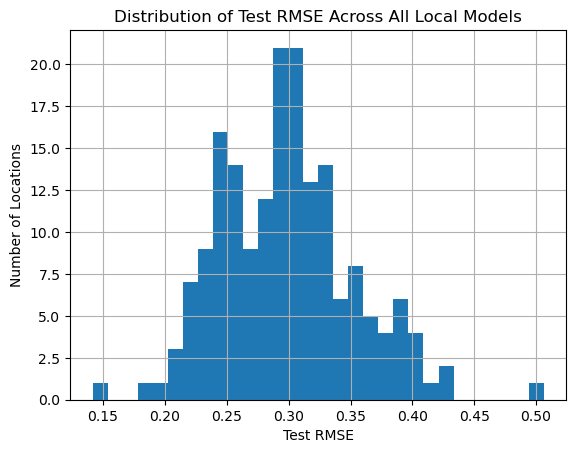

In [6]:
import matplotlib.pyplot as plt
results_df['test_rmse'].hist(bins=30)
plt.title('Distribution of Test RMSE Across All Local Models')
plt.xlabel('Test RMSE')
plt.ylabel('Number of Locations')
plt.show()

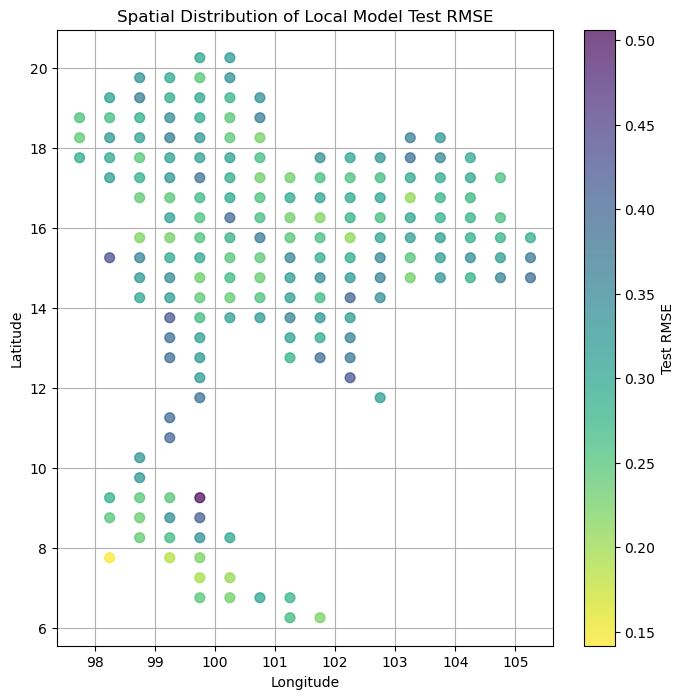

In [7]:
plt.figure(figsize=(8, 8))
plt.scatter(results_df['lon'], results_df['lat'], c=results_df['test_rmse'], cmap='viridis_r', s=50, alpha=0.7)
plt.colorbar(label='Test RMSE')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Spatial Distribution of Local Model Test RMSE')
plt.grid(True)
plt.show()

In [8]:
results_df

,location,lat,lon,test_rmse,test_mae,test_r2,train_rmse,train_mae,train_r2,val_rmose,val_mae,val_r2
0,lat6.25_lon101.25,6.25,101.25,0.267255,0.219353,0.935576,0.056556,0.044259,0.996719,None,None,None
1,lat6.25_lon101.75,6.25,101.75,0.222748,0.163836,0.954236,0.063433,0.049777,0.995898,None,None,None
2,lat6.75_lon99.75,6.75,99.75,0.244372,0.202403,0.926372,0.086054,0.065758,0.992549,None,None,None
3,lat6.75_lon100.25,6.75,100.25,0.226048,0.175001,0.948827,0.079774,0.060880,0.993502,None,None,None
4,lat6.75_lon100.75,6.75,100.75,0.303245,0.243788,0.914517,0.060080,0.047156,0.996298,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...
174,lat19.75_lon99.25,19.75,99.25,0.292763,0.224331,0.894948,0.088053,0.069013,0.992074,None,None,None
175,lat19.75_lon99.75,19.75,99.75,0.244273,0.200202,0.931171,0.071954,0.056513,0.994710,None,None,None
176,lat19.75_lon100.25,19.75,100.25,0.334424,0.269809,0.911731,0.156579,0.117427,0.974807,None,None,None
177,lat20.25_lon99.75,20.25,99.75,0.301803,0.188284,0.893741,0.101934,0.078014,0.989356,None,None,None


In [9]:
plt.figure(figsize=(8, 8))
plt.scatter(results_df['lon'], results_df['lat'], c=results_df['val_rmse'], cmap='viridis_r', s=50, alpha=0.7)
plt.colorbar(label='Test RMSE')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Spatial Distribution of Local Model Val RMSE')
plt.grid(True)
plt.show()

KeyError: 'val_rmse'

<Figure size 800x800 with 0 Axes>